In [26]:
import sys
sys.path.insert(0, '../..')
import copy
import numpy as np
from model.base import CovidModel, SimulationParameters, set_parameters, normal_ci
from utils import BasicStatistics, RemovePolicy, Propaganda, setup_city_layout, AddPolicyInfectedRate, confidence_interval, multiple_runs
from model.utils import SocialPolicy

In [28]:
listeners = []
strings="""[
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_ELEMENTARY_SCHOOL,0.025 ,1],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_MIDDLE_SCHOOL, 0.025 ,1],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_HIGH_SCHOOL, 0.025 ,1],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_RETAIL,0.025 ,1],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_FACTORY, 0.025 ,1],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_OFFICE, 0.025 ,1],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_ELEMENTARY_SCHOOL, 0.025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_MIDDLE_SCHOOL, 0.025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_HIGH_SCHOOL,0.025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_RETAIL, 0.025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_FACTORY, 0.025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_OFFICE,0.025 ,21]
]"""

In [30]:
common_parameters = SimulationParameters(
    mask_user_rate = 0.9, # 0.0,
    mask_efficacy = 0.6, #0.0,
    imune_rate = 0.01,
    initial_infection_rate = 0.01,
    hospitalization_capacity = 0.05,
    latency_period_shape = 3,
    latency_period_scale = 1, 
    incubation_period_shape = 6,
    incubation_period_scale = 1, 
    mild_period_duration_shape = 14,
    mild_period_duration_scale = 1,
    hospitalization_period_duration_shape = 12,
    hospitalization_period_duration_scale = 1,
    symptomatic_isolation_rate = 0.0,
    asymptomatic_contagion_probability = 0.1,
#    asymptomatic_contagion_probability = 0.05,
    risk_tolerance_mean = 0.1,
    risk_tolerance_stdev = 0.1,
    #herding_behavior_mean = 0.7,
    herding_behavior_mean = 0.7,
    herding_behavior_stdev = 0.2,
    allowed_restaurant_capacity = 0.25, #1.0, # valid values: {1.0, 0.50, 0.25}
    spreading_rate = normal_ci(2.41, 3.90, 20),
#    spreading_rate = normal_ci(0.5, 1.5, 20)
    restaurant_count_per_work_district = 40 #100
)

sc = 10

population_size = 1000
simulation_cycles = 360 # days
seed = 31415
np.random.seed(seed)

params = copy.deepcopy(common_parameters)

Save these seeds if you want to rerun a scenario
[3306, 6751, 3378, 8823, 5048, 6925, 2291, 1303, 2744, 5030, 8123, 8952, 1520, 6976, 2839, 9051, 9292, 7875, 6834, 9795]
log initialized
Average similarity between family members is 0.972273782907019 at temperature -1
Average similarity between family and home is 0.9998398183362384 at temperature -1
Average similarity between students and their classroom is 0.7515107996083824 at temperature -1
Average classroom occupancy is 4.420289855072464 and number classrooms is 69
Average similarity between workers is 0.9647252104216057 at temperature -1
Average office occupancy is 3.469945355191257 and number offices is 183
Average friend similarity for adults: 0.8490071174384444 for kids: 0.7369002658743609
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Bui

avg restaurant similarity 0.7021016052245527
avg restaurant similarity 0.6484470105957834
avg restaurant similarity 0.6483615567927825
avg restaurant similarity 0.45285947881087646
avg restaurant similarity 0.6036506828231115
avg restaurant similarity 0.4850639225223612
avg restaurant similarity 0.38176397516755334
avg restaurant similarity 0.420300713240342
avg restaurant similarity 0.9195367750469083
avg restaurant similarity 0.8609028518423716
avg restaurant similarity 0.8213102039207406
avg restaurant similarity 0.5740685629188426
avg restaurant similarity 0.47774784246281776
avg restaurant similarity 0.4532128336918071
avg restaurant similarity 0.7008517782094912
avg restaurant similarity 0.36394557465324895
avg restaurant similarity 0.6857009983809208
avg restaurant similarity 0.7015906129973457
avg restaurant similarity 0.999861866200102
avg restaurant similarity 0.4850386439390323
avg restaurant similarity 0.7026765989287486
avg restaurant similarity 0.4850639225223612
avg rest

avg restaurant similarity 0.6403671356413496
avg restaurant similarity 0.48071596161665425
avg restaurant similarity 0.704392807445756
avg restaurant similarity 0.5882747378473251
avg restaurant similarity 0.6935621963330615
avg restaurant similarity 0.6147094213006976
avg restaurant similarity 0.6699239145135568
avg restaurant similarity 0.7854907426797002
avg restaurant similarity 0.7107424969784657
avg restaurant similarity 0.7147437162752794
avg restaurant similarity 0.5626732776971779
avg restaurant similarity 0.418390208382769
avg restaurant similarity 0.5497441790195867
avg restaurant similarity 0.6368062636906058
avg restaurant similarity 0.3963552256760753
avg restaurant similarity 0.29886861438271245
avg restaurant similarity 0.6716027825646709
avg restaurant similarity 0.710889425115795
avg restaurant similarity 0.561018697338981
avg restaurant similarity 0.5371663098908738
avg restaurant similarity 0.999880398210135
avg restaurant similarity 0.5664002038964845
avg restauran

Average similarity between workers is 0.9654495211765848 at temperature -1
Average office occupancy is 3.587912087912088 and number offices is 182
Average friend similarity for adults: 0.8624290220864878 for kids: 0.7423624174437744
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 peop

avg restaurant similarity 0.6161304068376848
avg restaurant similarity 0.5727037794592954
avg restaurant similarity 0.556013617800698
avg restaurant similarity 0.7192546540201102
avg restaurant similarity 0.46994906773422535
avg restaurant similarity 0.6441975357123547
avg restaurant similarity 0.6493538916311903
avg restaurant similarity 0.4967751217490347
avg restaurant similarity 0.5015666304965473
avg restaurant similarity 0.3477896454624002
avg restaurant similarity 0.4099609147187956
avg restaurant similarity 0.6304853751074515
avg restaurant similarity 0.5525384717749404
avg restaurant similarity 0.30747017781933367
avg restaurant similarity 0.88053653745454
avg restaurant similarity 0.6125203312535457
avg restaurant similarity 0.9997298430761035
avg restaurant similarity 0.5010141348670512
avg restaurant similarity 0.6237675246653425
avg restaurant similarity 0.4818421147578799
avg restaurant similarity 0.591284553038402
avg restaurant similarity 0.6604015429769737
avg restaura

avg restaurant similarity 0.7571998475690388
avg restaurant similarity 0.47466851172616853
avg restaurant similarity 0.5760521703450993
avg restaurant similarity 0.31914114925605036
avg restaurant similarity 0.6182200720047825
avg restaurant similarity 0.35608762454924053
avg restaurant similarity 0.5110848595048852
avg restaurant similarity 0.6220937881162478
avg restaurant similarity 0.9122824593620791
avg restaurant similarity 0.6518935196791236
avg restaurant similarity 0.500346553106453
avg restaurant similarity 0.35608762454924053
avg restaurant similarity 0.6368656362200427
avg restaurant similarity 0.5753391320510948
avg restaurant similarity 0.4992962259501816
avg restaurant similarity 0.7490404822473407
avg restaurant similarity 0.5609316032091533
avg restaurant similarity 0.9998124180954212
avg restaurant similarity 0.5641533271519095
avg restaurant similarity 0.9996640691887639
avg restaurant similarity 0.5930035700186571
avg restaurant similarity 0.5641533271519095
avg res

avg restaurant similarity 0.6978611183475215
avg restaurant similarity 0.9995301024694139
avg restaurant similarity 0.6078455643079048
avg restaurant similarity 0.371122306783003
avg restaurant similarity 0.47048042093463516
avg restaurant similarity 0.6293159982240897
avg restaurant similarity 0.26126978819663194
avg restaurant similarity 0.33471046590256276
avg restaurant similarity 0.6727931058788407
avg restaurant similarity 0.5101023942453412
avg restaurant similarity 0.4805669540013294
avg restaurant similarity 0.8582295091869694
avg restaurant similarity 0.5394337275610923
avg restaurant similarity 0.6682282599649915
avg restaurant similarity 0.5871512939764367
avg restaurant similarity 0.39092656566362244
avg restaurant similarity 0.5409747904744431
avg restaurant similarity 0.4508070511284154
avg restaurant similarity 0.8357554685807835
avg restaurant similarity 0.34525254557727636
avg restaurant similarity 0.8227285853790434
avg restaurant similarity 0.8004559812853684
avg re

avg restaurant similarity 0.7474666520223052
avg restaurant similarity 0.7427708769597432
avg restaurant similarity 0.5576557363736776
avg restaurant similarity 0.5392024183612769
avg restaurant similarity 0.38760307419844914
avg restaurant similarity 0.5964785031265171
avg restaurant similarity 0.802770219691143
avg restaurant similarity 0.6028516400103194
Average similarity between family members is 0.9698325688785958 at temperature -1
Average similarity between family and home is 0.9998501397039935 at temperature -1
Average similarity between students and their classroom is 0.7132046145690629 at temperature -1
Average classroom occupancy is 4.571428571428571 and number classrooms is 63
Average similarity between workers is 0.9676435259863678 at temperature -1
Average office occupancy is 3.4473684210526314 and number offices is 190
Average friend similarity for adults: 0.8552395829749848 for kids: 0.734398832458571
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuil

avg restaurant similarity 0.5621141124840894
avg restaurant similarity 0.49252418452123714
avg restaurant similarity 0.42810702208642093
avg restaurant similarity 0.32530231157436246
avg restaurant similarity 0.770721939697615
avg restaurant similarity 0.5811816431541128
avg restaurant similarity 0.694079077298422
avg restaurant similarity 0.6805285871934181
avg restaurant similarity 0.4171978859946137
avg restaurant similarity 0.8873991797817263
avg restaurant similarity 0.6068693389854705
avg restaurant similarity 0.818785969382402
avg restaurant similarity 0.6311917428054623
avg restaurant similarity 0.5124174754307511
avg restaurant similarity 0.3605641609295117
avg restaurant similarity 0.6113640434260943
avg restaurant similarity 0.4571084442235951
avg restaurant similarity 0.355139740950164
avg restaurant similarity 0.9998539287370118
avg restaurant similarity 0.6560792337052354
avg restaurant similarity 0.8198763775353473
avg restaurant similarity 0.07804661017025977
avg restau

avg restaurant similarity 0.5961901095960482
avg restaurant similarity 0.8804287824305832
avg restaurant similarity 0.7773220760614032
avg restaurant similarity 0.7802696000003551
avg restaurant similarity 0.7374250931704308
avg restaurant similarity 0.7565887361675161
avg restaurant similarity 0.5715259920337927
avg restaurant similarity 0.7771989126433335
avg restaurant similarity 0.8413395473504099
avg restaurant similarity 0.445836440779934
avg restaurant similarity 0.999819515772092
avg restaurant similarity 0.6666659027028409
avg restaurant similarity 0.6709865504523388
avg restaurant similarity 0.8115750354303539
avg restaurant similarity 0.32354910010441235
avg restaurant similarity 0.6742229472494207
avg restaurant similarity 0.9997815767647318
avg restaurant similarity 0.6965877748973978
avg restaurant similarity 0.4303533075490775
avg restaurant similarity 0.582701579916726
avg restaurant similarity 0.9998537796223494
avg restaurant similarity 0.5294291662747517
avg restaura

avg restaurant similarity 0.5991687589002299
avg restaurant similarity 0.6085003783539551
avg restaurant similarity 0.8136976957097048
avg restaurant similarity 0.5936690369354409
avg restaurant similarity 0.2979976412928845
avg restaurant similarity 0.5691357994266549
avg restaurant similarity 0.5530209645274752
avg restaurant similarity 0.20330796265015028
avg restaurant similarity 0.484265139035898
avg restaurant similarity 0.29320107111400207
avg restaurant similarity 0.7689499589465207
avg restaurant similarity 0.7604687057719749
avg restaurant similarity 0.5781616300224741
avg restaurant similarity 0.635501871513954
avg restaurant similarity 0.256206253323365
avg restaurant similarity 0.5091051256961099
avg restaurant similarity 0.8256406356267084
avg restaurant similarity 0.6611981672024536
avg restaurant similarity 0.7448955868779177
avg restaurant similarity 0.7961945191833346
avg restaurant similarity 0.3514995740290585
avg restaurant similarity 0.5284881141796602
avg restaur

avg restaurant similarity 0.7307128765544819
avg restaurant similarity 0.9997799322752638
avg restaurant similarity 0.7860389806362817
Average similarity between family members is 0.9738542033763226 at temperature -1
Average similarity between family and home is 0.999865368837495 at temperature -1
Average similarity between students and their classroom is 0.7529278193586191 at temperature -1
Average classroom occupancy is 4.515151515151516 and number classrooms is 66
Average similarity between workers is 0.9744363155905437 at temperature -1
Average office occupancy is 3.662921348314607 and number offices is 178
Average friend similarity for adults: 0.8591547249436017 for kids: 0.7428421013446433
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with cap

avg restaurant similarity 0.6346709242696928
avg restaurant similarity 0.820209360961808
avg restaurant similarity 0.8458537119356917
avg restaurant similarity 0.9504109103720166
avg restaurant similarity 0.667286951325877
avg restaurant similarity 0.4385059171562418
avg restaurant similarity 0.869573917958603
avg restaurant similarity 0.6744259912765461
avg restaurant similarity 0.9999167352785168
avg restaurant similarity 0.6182072477659357
avg restaurant similarity 0.47357638888594744
avg restaurant similarity 0.8351238286041104
avg restaurant similarity 0.9997858324112784
avg restaurant similarity 0.621766380825433
avg restaurant similarity 0.9997990534117225
avg restaurant similarity 0.9998075263315305
avg restaurant similarity 0.9104955775880759
avg restaurant similarity 0.9257377818434166
avg restaurant similarity 0.3089411186735592
avg restaurant similarity 0.4092411413914242
avg restaurant similarity 0.4057386208880685
avg restaurant similarity 0.9999167352785168
avg restauran

avg restaurant similarity 0.9407219253658082
avg restaurant similarity 0.8562350633506425
avg restaurant similarity 0.5538704719981817
avg restaurant similarity 0.6954345607271066
avg restaurant similarity 0.7022939145064679
avg restaurant similarity 0.807874954266242
avg restaurant similarity 0.43367295692283664
avg restaurant similarity 0.7304843479915121
avg restaurant similarity 0.6021695654851233
avg restaurant similarity 0.5353089083076249
avg restaurant similarity 0.7514386925456732
avg restaurant similarity 0.46668950201803516
avg restaurant similarity 0.6336568542841028
avg restaurant similarity 0.5080349945331623
avg restaurant similarity 0.8562350633506425
avg restaurant similarity 0.5642786258501434
avg restaurant similarity 0.8462532033733864
avg restaurant similarity 0.5033280665458623
avg restaurant similarity 0.7617677232790918
avg restaurant similarity 0.5193385320354409
avg restaurant similarity 0.3967120876411625
avg restaurant similarity 0.230341961970904
avg restau

avg restaurant similarity 0.7708279768047398
avg restaurant similarity 0.713727705976257
avg restaurant similarity 0.759026730742395
avg restaurant similarity 0.45328296144114955
avg restaurant similarity 0.5592462668174345
avg restaurant similarity 0.6048292528216488
avg restaurant similarity 0.6812007821022349
avg restaurant similarity 0.4250293580529293
avg restaurant similarity 0.7140592141628362
avg restaurant similarity 0.1582466458739515
avg restaurant similarity 0.4573287830159539
avg restaurant similarity 0.6313384432085101
avg restaurant similarity 0.495707094698971
avg restaurant similarity 0.6858006710924925
avg restaurant similarity 0.5602128979529211
avg restaurant similarity 0.5974502526463398
avg restaurant similarity 0.56001136709169
avg restaurant similarity 0.4732677629626656
avg restaurant similarity 0.7425296712283893
avg restaurant similarity 0.4423398448127658
avg restaurant similarity 0.5247812522789692
avg restaurant similarity 0.9994944727637873
avg restaurant

Average friend similarity for adults: 0.849163724880844 for kids: 0.7217024645454394
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocate

avg restaurant similarity 0.6357433101165311
avg restaurant similarity 0.578669922303551
avg restaurant similarity 0.5767126867460834
avg restaurant similarity 0.3811744533829678
avg restaurant similarity 0.8269901031295717
avg restaurant similarity 0.9135106281719276
avg restaurant similarity 0.875948846167537
avg restaurant similarity 0.8262319056326828
avg restaurant similarity 0.9136421380142452
avg restaurant similarity 0.9997816405987385
avg restaurant similarity 0.5203809106839878
avg restaurant similarity 0.5466025573338792
avg restaurant similarity 0.8262319056326828
avg restaurant similarity 0.9136421380142452
avg restaurant similarity 0.7411223880939045
avg restaurant similarity 0.7027307744804401
avg restaurant similarity 0.4608560151468206
avg restaurant similarity 0.8575977242463533
avg restaurant similarity 0.5379779353179139
avg restaurant similarity 0.7141872513550352
avg restaurant similarity 0.5280394503829157
avg restaurant similarity 0.5570169622017526
avg restaura

avg restaurant similarity 0.7893028871108151
avg restaurant similarity 0.7878975862443907
avg restaurant similarity 0.5788927641337983
avg restaurant similarity 0.9998333419544172
avg restaurant similarity 0.9083387525536611
avg restaurant similarity 0.7587099471396652
avg restaurant similarity 0.558487422017488
avg restaurant similarity 0.6296437756941051
avg restaurant similarity 0.8275544194742269
avg restaurant similarity 0.7254173715729191
avg restaurant similarity 0.8585466112722937
avg restaurant similarity 0.6579272858953865
avg restaurant similarity 0.6387658568818595
avg restaurant similarity 0.6572547566858076
avg restaurant similarity 0.7271629876029745
avg restaurant similarity 0.8305198152556935
avg restaurant similarity 0.6307078091501959
avg restaurant similarity 0.6911756767428291
avg restaurant similarity 0.6375728537921214
avg restaurant similarity 0.8004464513445088
avg restaurant similarity 0.8312104584738911
avg restaurant similarity 0.6334404902792463
avg restaur

Average similarity between workers is 0.9689851228137811 at temperature -1
Average office occupancy is 3.424731182795699 and number offices is 186
Average friend similarity for adults: 0.850366180463814 for kids: 0.7280018376653976
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 p

avg restaurant similarity 0.43502945664695575
avg restaurant similarity 0.4098455997897257
avg restaurant similarity 0.461474537911532
avg restaurant similarity 0.6407147446822953
avg restaurant similarity 0.5166950471153539
avg restaurant similarity 0.5204163201931589
avg restaurant similarity 0.999979295723957
avg restaurant similarity 0.6243601223977548
avg restaurant similarity 0.347477832084475
avg restaurant similarity 0.40358459188933826
avg restaurant similarity 0.43445188556601644
avg restaurant similarity 0.7920247345606184
avg restaurant similarity 0.4461679062646333
avg restaurant similarity 0.5248392458990893
avg restaurant similarity 0.7420208367234121
avg restaurant similarity 0.4336321296429936
avg restaurant similarity 0.473193497098786
avg restaurant similarity 0.4935222062463237
avg restaurant similarity 0.5501255534976993
avg restaurant similarity 0.32865470984005835
avg restaurant similarity 0.4311524895119988
avg restaurant similarity 0.5499813572222819
avg restau

avg restaurant similarity 0.6068641965735848
avg restaurant similarity 0.6080994819039264
avg restaurant similarity 0.5920699579996171
avg restaurant similarity 0.9998952769216214
avg restaurant similarity 0.5706693644043157
avg restaurant similarity 0.871917791392385
avg restaurant similarity 0.9085484390054328
avg restaurant similarity 0.5920699579996171
avg restaurant similarity 0.43474983030255543
avg restaurant similarity 0.9149175954911908
avg restaurant similarity 0.9995968458182705
avg restaurant similarity 0.612610214369628
avg restaurant similarity 0.706795049959367
avg restaurant similarity 0.7233832888665482
avg restaurant similarity 0.5349585624988582
avg restaurant similarity 0.5778465326989033
avg restaurant similarity 0.6270229158840631
avg restaurant similarity 0.7947523141545522
avg restaurant similarity 0.9539590767024361
avg restaurant similarity 0.48140102454033656
avg restaurant similarity 0.5349585624988582
avg restaurant similarity 0.9997170018574506
avg restaur

avg restaurant similarity 0.6463966098688292
avg restaurant similarity 0.8351048531717367
avg restaurant similarity 0.8203128714317345
avg restaurant similarity 0.892333553813196
avg restaurant similarity 0.39553670144021613
avg restaurant similarity 0.3568614231401236
avg restaurant similarity 0.5747730830816075
avg restaurant similarity 0.9996279490968181
avg restaurant similarity 0.9999035382449623
avg restaurant similarity 0.49933758897656255
avg restaurant similarity 0.9237065367646267
avg restaurant similarity 0.38208982014411613
avg restaurant similarity 0.6597657362247508
avg restaurant similarity 0.6271056391500065
avg restaurant similarity 0.5649941321364941
avg restaurant similarity 0.8053090568120318
avg restaurant similarity 0.40045007368232033
avg restaurant similarity 0.49656105747667995
avg restaurant similarity 0.3682696697577228
avg restaurant similarity 0.344750103525677
avg restaurant similarity 0.4998770171752986
avg restaurant similarity 0.5026535486751812
avg res

avg restaurant similarity 0.6025156245255306
avg restaurant similarity 0.48505786268412365
avg restaurant similarity 0.5404907156503422
avg restaurant similarity 0.5404951796120253
avg restaurant similarity 0.9996373483573395
avg restaurant similarity 0.5373493697786919
avg restaurant similarity 0.5729963020120177
avg restaurant similarity 0.5931144148537582
avg restaurant similarity 0.5865383894887849
avg restaurant similarity 0.8683420280391145
avg restaurant similarity 0.5871996387802403
avg restaurant similarity 0.6517533383051676
avg restaurant similarity 0.5672985887284796
avg restaurant similarity 0.6680852401268831
avg restaurant similarity 0.6173476792644539
avg restaurant similarity 0.9994077343555144
avg restaurant similarity 0.6769321431334993
avg restaurant similarity 0.29683471625735725
avg restaurant similarity 0.8484898045802649
avg restaurant similarity 0.648092556341674
avg restaurant similarity 0.5108639133781934
avg restaurant similarity 0.5555822095934899
avg resta

avg restaurant similarity 0.5312126817126774
avg restaurant similarity 0.5304437440419569
avg restaurant similarity 0.6733312686480648
avg restaurant similarity 0.44514089922784456
avg restaurant similarity 0.5243758128433302
avg restaurant similarity 0.4749669101004036
avg restaurant similarity 0.5650577342120064
avg restaurant similarity 0.4961711563582556
avg restaurant similarity 0.4474438018805932
avg restaurant similarity 0.6601482635802516
avg restaurant similarity 0.40746450342719437
avg restaurant similarity 0.5473719530432688
avg restaurant similarity 0.7117738606190808
avg restaurant similarity 0.8894996133616364
avg restaurant similarity 0.7869932874517601
avg restaurant similarity 0.43778264356108476
avg restaurant similarity 0.9998694663184895
avg restaurant similarity 0.7931190850057789
avg restaurant similarity 0.8792067570209905
avg restaurant similarity 0.5196511797303995
avg restaurant similarity 0.7135143611279605
avg restaurant similarity 0.9995845856932457
avg res

avg restaurant similarity 0.5119329231410474
avg restaurant similarity 0.8421844372310864
avg restaurant similarity 0.6171654137689218
avg restaurant similarity 0.593646460270174
avg restaurant similarity 0.3704150824593255
avg restaurant similarity 0.4832773085279702
avg restaurant similarity 0.8119566991920677
avg restaurant similarity 0.4689534670278866
avg restaurant similarity 0.6170584014945555
avg restaurant similarity 0.8278033726264792
avg restaurant similarity 0.4469854256870739
avg restaurant similarity 0.3697902565292731
avg restaurant similarity 0.5387028512342757
avg restaurant similarity 0.16667078576868105
avg restaurant similarity 0.5921282600588611
avg restaurant similarity 0.17499690820170952
avg restaurant similarity 0.5170730712165128
avg restaurant similarity 0.5803176121017737
avg restaurant similarity 0.6058513101354628
avg restaurant similarity 0.9998390574213138
avg restaurant similarity 0.482055888545305
avg restaurant similarity 0.5156104474135424
avg restau

Average similarity between workers is 0.9758405848817835 at temperature -1
Average office occupancy is 3.808988764044944 and number offices is 178
Average friend similarity for adults: 0.8583180862770554 for kids: 0.7220278211366323
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 11 people.
Total of 11 pe

avg restaurant similarity 0.543845068793491
avg restaurant similarity 0.3702122362320922
avg restaurant similarity 0.5949307231344247
avg restaurant similarity 0.8570329041000977
avg restaurant similarity 0.5071949171050464
avg restaurant similarity 0.597936102824316
avg restaurant similarity 0.45103818628086484
avg restaurant similarity 0.5987017718465599
avg restaurant similarity 0.4623701943815123
avg restaurant similarity 0.5890774902554798
avg restaurant similarity 0.4261152937560663
avg restaurant similarity 0.9208226075484964
avg restaurant similarity 0.8092028039271439
avg restaurant similarity 0.8569941526977871
avg restaurant similarity 0.36276537883019966
avg restaurant similarity 0.7148180132892783
avg restaurant similarity 0.7088311809446162
avg restaurant similarity 0.7148180132892783
avg restaurant similarity 0.7857252648491746
avg restaurant similarity 0.49610709707586476
avg restaurant similarity 0.6200593651430859
avg restaurant similarity 0.7148180132892783
avg resta

(<function dict.items>, <function dict.items>, <function dict.items>)

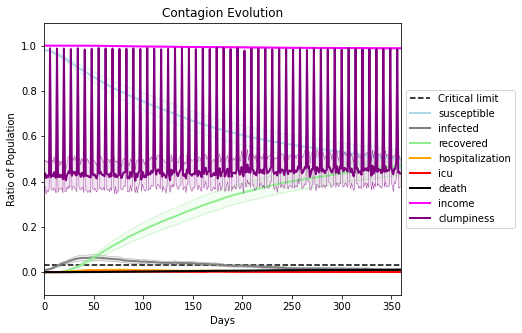

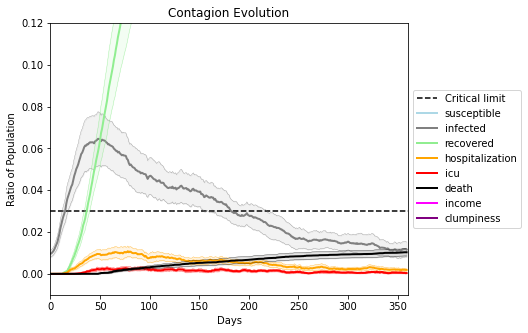

In [4]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -1
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[8805, 3765, 9235, 7843, 521, 8454, 1522, 1590, 1778, 4806, 1947, 4350, 1796, 373, 4557, 4879, 3911, 9101, 2012, 7089]
Average similarity between family members is 0.971801323267987 at temperature -0.999
Average similarity between family and home is 0.9998508917769979 at temperature -1
Average similarity between students and their classroom is 0.7205299440193841 at temperature -0.999
Average classroom occupancy is 4.132352941176471 and number classrooms is 68
Average similarity between workers is 0.9658771653043984 at temperature -0.999
Average office occupancy is 3.5869565217391304 and number offices is 184
Average friend similarity for adults: 0.8488379332153003 for kids: 0.7212808708649799
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Building

avg restaurant similarity 0.42861831116173765
avg restaurant similarity 0.3754454977294496
avg restaurant similarity 0.4539083161740495
avg restaurant similarity 0.6804980028013248
avg restaurant similarity 0.5781283325754805
avg restaurant similarity 0.44618322808788247
avg restaurant similarity 0.5237164804251329
avg restaurant similarity 0.5226650165133476
avg restaurant similarity 0.479614310131727
avg restaurant similarity 0.39500435312848303
avg restaurant similarity 0.651100119048334
avg restaurant similarity 0.8072874676627092
avg restaurant similarity 0.6548367516807113
avg restaurant similarity 0.5256762855476357
avg restaurant similarity 0.7230637163369835
avg restaurant similarity 0.4772261952605803
avg restaurant similarity 0.4490043521811198
avg restaurant similarity 0.4730809852631917
avg restaurant similarity 0.57703613186855
avg restaurant similarity 0.4250790841934412
avg restaurant similarity 0.20620156848701018
avg restaurant similarity 0.4772261952605803
avg restau

avg restaurant similarity 0.5382409091601102
avg restaurant similarity 0.483262143116574
avg restaurant similarity 0.42742281285358674
avg restaurant similarity 0.7069447755557474
avg restaurant similarity 0.5163247568228195
avg restaurant similarity 0.8542688091676951
avg restaurant similarity 0.5693109756530346
avg restaurant similarity 0.7030340801406608
avg restaurant similarity 0.44795784704617914
avg restaurant similarity 0.4797312746551128
avg restaurant similarity 0.852910459847562
avg restaurant similarity 0.6770952718791525
avg restaurant similarity 0.5417615824686696
avg restaurant similarity 0.6919142396624294
avg restaurant similarity 0.515387441557124
avg restaurant similarity 0.4686418935307019
avg restaurant similarity 0.7437454344619823
avg restaurant similarity 0.32759940377441765
avg restaurant similarity 0.4761905127250402
avg restaurant similarity 0.5372106638329758
avg restaurant similarity 0.537892819579026
avg restaurant similarity 0.5652766336507464
avg restaur

avg restaurant similarity 0.519421799496707
avg restaurant similarity 0.5823101265439212
avg restaurant similarity 0.7595507072767245
avg restaurant similarity 0.6117463845309599
avg restaurant similarity 0.7871326955864857
avg restaurant similarity 0.46567545212953504
avg restaurant similarity 0.5350408898890191
avg restaurant similarity 0.7122787491801494
avg restaurant similarity 0.46475424990868186
avg restaurant similarity 0.6096794184817402
avg restaurant similarity 0.5228254867767435
avg restaurant similarity 0.7423082599889741
avg restaurant similarity 0.38348285292612916
avg restaurant similarity 0.5359554544061375
avg restaurant similarity 0.7322272381207873
avg restaurant similarity 0.5817516142564038
avg restaurant similarity 0.6064024713992344
Average similarity between family members is 0.9727083924948445 at temperature -0.999
Average similarity between family and home is 0.9998605562891848 at temperature -1
Average similarity between students and their classroom is 0.727

avg restaurant similarity 0.725689131153489
avg restaurant similarity 0.28408677157646806
avg restaurant similarity 0.5581737621122914
avg restaurant similarity 0.42136966046541785
avg restaurant similarity 0.7187127486203233
avg restaurant similarity 0.6172934887664907
avg restaurant similarity 0.3912797297878351
avg restaurant similarity 0.7788289309518026
avg restaurant similarity 0.5604316399668449
avg restaurant similarity 0.37253964351686353
avg restaurant similarity 0.6732465818648313
avg restaurant similarity 0.6278945920407075
avg restaurant similarity 0.6059967512067441
avg restaurant similarity 0.40567534383026754
avg restaurant similarity 0.28408677157646806
avg restaurant similarity 0.5548916743073846
avg restaurant similarity 0.33340717953743204
avg restaurant similarity 0.4064961089540984
avg restaurant similarity 0.36012706160679786
avg restaurant similarity 0.42534777839317545
avg restaurant similarity 0.8135322600053934
avg restaurant similarity 0.5905366051094456
avg

avg restaurant similarity 0.596590884324351
avg restaurant similarity 0.8122443967077265
avg restaurant similarity 0.7738603691385479
avg restaurant similarity 0.5577488584944723
avg restaurant similarity 0.6369721902118934
avg restaurant similarity 0.5112018832159319
avg restaurant similarity 0.4407875581439785
avg restaurant similarity 0.4612242203474356
avg restaurant similarity 0.5076451399390539
avg restaurant similarity 0.7915822103009982
avg restaurant similarity 0.7181285220336641
avg restaurant similarity 0.4003585983450788
avg restaurant similarity 0.2415110094047332
avg restaurant similarity 0.3988481210821121
avg restaurant similarity 0.8310730270713713
avg restaurant similarity 0.788477440030125
avg restaurant similarity 0.9999115197930923
avg restaurant similarity 0.5478698362090817
avg restaurant similarity 0.27482529993669064
avg restaurant similarity 0.8743999094822801
avg restaurant similarity 0.8331729244417178
avg restaurant similarity 0.999870391199811
avg restaura

avg restaurant similarity 0.8679153480311939
avg restaurant similarity 0.5098622426484429
avg restaurant similarity 0.6288605845491708
avg restaurant similarity 0.6263764807663443
avg restaurant similarity 0.3052778687989728
avg restaurant similarity 0.8333590202542003
avg restaurant similarity 0.8413612979737752
avg restaurant similarity 0.3052778687989728
avg restaurant similarity 0.8894892280476603
avg restaurant similarity 0.9996376949733166
avg restaurant similarity 0.5829353968233665
avg restaurant similarity 0.3026084750202829
avg restaurant similarity 0.8868273849827679
avg restaurant similarity 0.6278926410565183
avg restaurant similarity 0.5321774204026943
avg restaurant similarity 0.4877871862018829
avg restaurant similarity 0.6087360749999466
avg restaurant similarity 0.8137267473696319
avg restaurant similarity 0.9221379792917376
avg restaurant similarity 0.4380881929345556
avg restaurant similarity 0.6503822861495778
avg restaurant similarity 0.48128839016907926
avg resta

avg restaurant similarity 0.5030429618137959
avg restaurant similarity 0.6681463773858538
avg restaurant similarity 0.5742406980761998
avg restaurant similarity 0.583397078095854
avg restaurant similarity 0.5975125237446517
avg restaurant similarity 0.8324254328542688
avg restaurant similarity 0.6135700917496616
avg restaurant similarity 0.7085693502224094
avg restaurant similarity 0.5411747796720787
avg restaurant similarity 0.440054484364785
avg restaurant similarity 0.8695010616132444
avg restaurant similarity 0.9997389446924527
avg restaurant similarity 0.47241492604268776
avg restaurant similarity 0.45301564336016786
avg restaurant similarity 0.4488250029155053
avg restaurant similarity 0.5707739374088354
avg restaurant similarity 0.614234658990957
avg restaurant similarity 0.6834719824852813
avg restaurant similarity 0.999890621812725
avg restaurant similarity 0.7179516847351803
avg restaurant similarity 0.9994479856439458
avg restaurant similarity 0.8242358901078377
avg restaura

avg restaurant similarity 0.8388632143533558
avg restaurant similarity 0.5396852743491282
avg restaurant similarity 0.7423800811384311
avg restaurant similarity 0.8955030927959461
avg restaurant similarity 0.8746353517608934
avg restaurant similarity 0.7646626017777942
avg restaurant similarity 0.6655639479855985
avg restaurant similarity 0.8957451412145989
avg restaurant similarity 0.7077002580813381
avg restaurant similarity 0.48898070144011924
avg restaurant similarity 0.5075091415473
avg restaurant similarity 0.9996398760573045
avg restaurant similarity 0.390485973147549
avg restaurant similarity 0.7597028033561392
avg restaurant similarity 0.6772221419903547
avg restaurant similarity 0.6315452665085164
avg restaurant similarity 0.6151713162696071
avg restaurant similarity 0.390548717285555
avg restaurant similarity 0.47265497695582664
avg restaurant similarity 0.7512606424522206
avg restaurant similarity 0.7743148042090551
avg restaurant similarity 0.5983887353626153
avg restauran

Average similarity between workers is 0.962880802841149 at temperature -0.999
Average office occupancy is 3.764044943820225 and number offices is 178
Average friend similarity for adults: 0.8518834612980916 for kids: 0.7121792219263954
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10

avg restaurant similarity 0.6548701455611711
avg restaurant similarity 0.5022924785611205
avg restaurant similarity 0.6569633038110981
avg restaurant similarity 0.6711791586118018
avg restaurant similarity 0.7924706628921874
avg restaurant similarity 0.4832407100162224
avg restaurant similarity 0.4525617060850616
avg restaurant similarity 0.4471678678960072
avg restaurant similarity 0.7148242057049556
avg restaurant similarity 0.37036233482832703
avg restaurant similarity 0.6144068310739592
avg restaurant similarity 0.43771221862634285
avg restaurant similarity 0.7982059046592458
avg restaurant similarity 0.8983540756651154
avg restaurant similarity 0.6527832442091321
avg restaurant similarity 0.9997852567129053
avg restaurant similarity 0.5810211811687618
avg restaurant similarity 0.8456633224709975
avg restaurant similarity 0.6326251527971538
avg restaurant similarity 0.5830509188565774
avg restaurant similarity 0.4832407100162224
avg restaurant similarity 0.8870139520546776
avg rest

avg restaurant similarity 0.5019034066371716
avg restaurant similarity 0.5592409395118169
avg restaurant similarity 0.7530933852045164
avg restaurant similarity 0.7178909610830359
avg restaurant similarity 0.7277490848097183
avg restaurant similarity 0.6021981916682444
avg restaurant similarity 0.503287631637069
avg restaurant similarity 0.6776053380258993
avg restaurant similarity 0.27586184683110787
avg restaurant similarity 0.22910636690224864
avg restaurant similarity 0.3033804865710046
avg restaurant similarity 0.46406643396094094
avg restaurant similarity 0.8676119278721705
avg restaurant similarity 0.7390027539399229
avg restaurant similarity 0.5990379016962948
avg restaurant similarity 0.30346827533945914
avg restaurant similarity 0.7694027700863606
avg restaurant similarity 0.6028610276098918
avg restaurant similarity 0.5613960662326711
avg restaurant similarity 0.5470355835490315
avg restaurant similarity 0.5325819353319136
avg restaurant similarity 0.6600133524161376
avg res

avg restaurant similarity 0.5038664684110887
avg restaurant similarity 0.631783618207647
avg restaurant similarity 0.7914407055732385
avg restaurant similarity 0.20764481039806773
avg restaurant similarity 0.999709154327886
avg restaurant similarity 0.6454726476829186
avg restaurant similarity 0.17338927542326865
avg restaurant similarity 0.999709154327886
avg restaurant similarity 0.6367936866900504
avg restaurant similarity 0.7196736916738555
avg restaurant similarity 0.9110066241019035
avg restaurant similarity 0.7356706240356088
avg restaurant similarity 0.826159944937814
avg restaurant similarity 0.6510068425660558
avg restaurant similarity 0.6594088913404599
avg restaurant similarity 0.8228564343367863
avg restaurant similarity 0.6464079031466397
avg restaurant similarity 0.5407222237747539
avg restaurant similarity 0.5349989635506422
avg restaurant similarity 0.6421833582990163
avg restaurant similarity 0.4080214799911677
avg restaurant similarity 0.7694004942882092
avg restaura

avg restaurant similarity 0.5346699166107767
avg restaurant similarity 0.8731047261106772
avg restaurant similarity 0.4913462462863665
avg restaurant similarity 0.6563604474412937
avg restaurant similarity 0.5437065328825329
avg restaurant similarity 0.9346571594969797
avg restaurant similarity 0.798725653529035
avg restaurant similarity 0.9996026761488868
avg restaurant similarity 0.5652295569049335
avg restaurant similarity 0.962643054161572
avg restaurant similarity 0.8570933618533378
avg restaurant similarity 0.8516696624047361
avg restaurant similarity 0.4946185027227117
avg restaurant similarity 0.9996211498629627
avg restaurant similarity 0.5036640197015863
avg restaurant similarity 0.5577382935017932
avg restaurant similarity 0.6049352822252672
avg restaurant similarity 0.48725467612605355
avg restaurant similarity 0.5659865541785558
avg restaurant similarity 0.7454354951625527
avg restaurant similarity 0.9428683872989555
avg restaurant similarity 0.6927482939500862
avg restaur

avg restaurant similarity 0.4662607772935957
avg restaurant similarity 0.6614544524718791
avg restaurant similarity 0.7339351557163794
avg restaurant similarity 0.40362727369145024
avg restaurant similarity 0.43510860972915233
avg restaurant similarity 0.6894436174657314
avg restaurant similarity 0.468615691761386
avg restaurant similarity 0.86868221682447
avg restaurant similarity 0.4047990830924033
avg restaurant similarity 0.4078939428636593
avg restaurant similarity 0.4355299301929995
avg restaurant similarity 0.7656872409912658
avg restaurant similarity 0.8687514388255188
avg restaurant similarity 0.4047990830924033
avg restaurant similarity 0.6012730703318799
avg restaurant similarity 0.4600218984417256
avg restaurant similarity 0.4047990830924033
avg restaurant similarity 0.5087431359124914
avg restaurant similarity 0.4102279622708649
avg restaurant similarity 0.43533227318072715
avg restaurant similarity 0.4102279622708649
avg restaurant similarity 0.5067413054344652
avg restau

avg restaurant similarity 0.7796949324300485
avg restaurant similarity 0.9996729887387218
avg restaurant similarity 0.5904816385480531
avg restaurant similarity 0.6588624425883989
avg restaurant similarity 0.7016542800597004
avg restaurant similarity 0.7508940782976952
avg restaurant similarity 0.6253430326906753
avg restaurant similarity 0.8388247294585621
avg restaurant similarity 0.6880276251371577
avg restaurant similarity 0.9214570445193521
avg restaurant similarity 0.7609623760999572
avg restaurant similarity 0.5911054397802951
avg restaurant similarity 0.22076986059738002
avg restaurant similarity 0.46667191616160963
avg restaurant similarity 0.5921477388996186
avg restaurant similarity 0.5020275525271153
avg restaurant similarity 0.7902633605040502
avg restaurant similarity 0.9156955439133274
avg restaurant similarity 0.8393291928162232
avg restaurant similarity 0.8230125301281831
avg restaurant similarity 0.6704261409928387
avg restaurant similarity 0.7338947465773947
avg rest

avg restaurant similarity 0.9998652874374405
avg restaurant similarity 0.8270617765735595
avg restaurant similarity 0.5162476592721489
avg restaurant similarity 0.9998440824166882
avg restaurant similarity 0.8745521546849695
avg restaurant similarity 0.9997904842494922
avg restaurant similarity 0.9212900145618427
avg restaurant similarity 0.6025607038850977
avg restaurant similarity 0.5427941940722314
avg restaurant similarity 0.5020275525271153
avg restaurant similarity 0.6597460512056499
avg restaurant similarity 0.7317613079127379
avg restaurant similarity 0.999862123353022
avg restaurant similarity 0.7310717061932847
avg restaurant similarity 0.542918742254574
avg restaurant similarity 0.8399303597486132
avg restaurant similarity 0.6928909501410304
avg restaurant similarity 0.8204522826258026
avg restaurant similarity 0.5727945844714923
avg restaurant similarity 0.6828781180658297
avg restaurant similarity 0.7331689817095741
avg restaurant similarity 0.7520062024852491
avg restaura

avg restaurant similarity 0.758998929841996
avg restaurant similarity 0.8732241868025296
avg restaurant similarity 0.697983615006897
avg restaurant similarity 0.8471757046557873
avg restaurant similarity 0.8071202642589482
avg restaurant similarity 0.7273662558259149
avg restaurant similarity 0.4385992011025328
avg restaurant similarity 0.916892867358801
avg restaurant similarity 0.9514138870080272
avg restaurant similarity 0.8709167808663343
avg restaurant similarity 0.7603758463147582
avg restaurant similarity 0.35338380324117324
avg restaurant similarity 0.9346602934154465
avg restaurant similarity 0.8058082111307537
avg restaurant similarity 0.9999221986197067
avg restaurant similarity 0.6787598991746421
avg restaurant similarity 0.9998186760413785
avg restaurant similarity 0.7491799814922078
avg restaurant similarity 0.8047819891798229
avg restaurant similarity 0.9026972235471963
avg restaurant similarity 0.8052498108370332
avg restaurant similarity 0.6784775933288942
avg restaura

avg restaurant similarity 0.582287600950897
avg restaurant similarity 0.4639775660235378
avg restaurant similarity 0.7383286580439229
avg restaurant similarity 0.7024710427110596
avg restaurant similarity 0.5372408489233207
avg restaurant similarity 0.41322756923563486
avg restaurant similarity 0.6388173152589609
avg restaurant similarity 0.6540467012027337
avg restaurant similarity 0.6986119290816624
avg restaurant similarity 0.46403402095643775
avg restaurant similarity 0.8688920467389789
avg restaurant similarity 0.8250746352958467
avg restaurant similarity 0.47731243859753214
avg restaurant similarity 0.3046618646803365
avg restaurant similarity 0.3046618646803365
avg restaurant similarity 0.8401992071728933
avg restaurant similarity 0.7131952207107979
avg restaurant similarity 0.6743986721146222
avg restaurant similarity 0.3995893034781234
avg restaurant similarity 0.7627146389694545
avg restaurant similarity 0.4150018027484752
avg restaurant similarity 0.999726698846721
avg resta

avg restaurant similarity 0.5227986679126695
avg restaurant similarity 0.5307204336685087
avg restaurant similarity 0.5702284236665246
avg restaurant similarity 0.6953284303185954
avg restaurant similarity 0.9997400614947576
avg restaurant similarity 0.7609109980287619
avg restaurant similarity 0.8730140217223721
avg restaurant similarity 0.9998200605649772
avg restaurant similarity 0.5377783112997976
avg restaurant similarity 0.6572570095260064
avg restaurant similarity 0.9994167165625194
avg restaurant similarity 0.4010511925429148
avg restaurant similarity 0.7750554271914278
avg restaurant similarity 0.8157420512271213
avg restaurant similarity 0.8188301054370624
avg restaurant similarity 0.6953284303185954
avg restaurant similarity 0.8265647429159554
avg restaurant similarity 0.7530557037514667
avg restaurant similarity 0.41890376918838534
avg restaurant similarity 0.7022340366063393
avg restaurant similarity 0.6953284303185954
avg restaurant similarity 0.45617313567765305
avg rest

avg restaurant similarity 0.535594615171258
avg restaurant similarity 0.4228105921743482
avg restaurant similarity 0.8422640194734223
avg restaurant similarity 0.5754609248026135
avg restaurant similarity 0.8172097208640245
avg restaurant similarity 0.6976354169455514
avg restaurant similarity 0.724667371907604
avg restaurant similarity 0.6274551905759623
avg restaurant similarity 0.9995465309703869
avg restaurant similarity 0.6505241576264511
avg restaurant similarity 0.6081796165547606
avg restaurant similarity 0.8123882832636206
avg restaurant similarity 0.6274551905759623
avg restaurant similarity 0.9995465309703869
avg restaurant similarity 0.999384168372311
avg restaurant similarity 0.9995465309703869
avg restaurant similarity 0.6041156582652988
avg restaurant similarity 0.8123198004887304
avg restaurant similarity 0.4578051857907569
avg restaurant similarity 0.4376337048308847
avg restaurant similarity 0.9995001083025546
avg restaurant similarity 0.8446186270353644
avg restauran

avg restaurant similarity 0.4266940959967126
avg restaurant similarity 0.6258347439835276
avg restaurant similarity 0.6924690019726816
avg restaurant similarity 0.20745836126800138
avg restaurant similarity 0.4844857710661411
avg restaurant similarity 0.6094167286020192
avg restaurant similarity 0.6590099610323386
avg restaurant similarity 0.5420595861683226
avg restaurant similarity 0.5511561164429197
avg restaurant similarity 0.440600204922773
avg restaurant similarity 0.642252879719994
avg restaurant similarity 0.8406215991158492
avg restaurant similarity 0.6776683837947266
avg restaurant similarity 0.8621099932404518
avg restaurant similarity 0.8332648250728195
avg restaurant similarity 0.47856747830217505
avg restaurant similarity 0.4800615201423468
avg restaurant similarity 0.775476652552463
avg restaurant similarity 0.6891051359587624
avg restaurant similarity 0.6675163870024818
avg restaurant similarity 0.4410022612847129
avg restaurant similarity 0.5463072903742197
avg restaur

avg restaurant similarity 0.5677545186792203
avg restaurant similarity 0.5849206875042798
avg restaurant similarity 0.5305481964296787
avg restaurant similarity 0.5183325579736
avg restaurant similarity 0.7356653771939223
avg restaurant similarity 0.37040387405974884
avg restaurant similarity 0.8762489282394923
avg restaurant similarity 0.3919038151279203
avg restaurant similarity 0.8337077681411409
avg restaurant similarity 0.4243402048279139
avg restaurant similarity 0.437246708300727
avg restaurant similarity 0.6067453772493558
avg restaurant similarity 0.7470062217106683
avg restaurant similarity 0.9997579264865901
avg restaurant similarity 0.2508132120836422
avg restaurant similarity 0.5348556455849222
avg restaurant similarity 0.5624270695866317
avg restaurant similarity 0.5844391126828588
avg restaurant similarity 0.65898433928368
avg restaurant similarity 0.6225768423172867
avg restaurant similarity 0.8425223454018567
avg restaurant similarity 0.5779467851508282
avg restaurant 

avg restaurant similarity 0.7526427616205282
avg restaurant similarity 0.6631207834667471
avg restaurant similarity 0.9622247704081115
avg restaurant similarity 0.8237184230758775
avg restaurant similarity 0.2545044619592697
avg restaurant similarity 0.8294828583664846
avg restaurant similarity 0.8384469289022468
avg restaurant similarity 0.47734911496163585
avg restaurant similarity 0.3036141552634137
avg restaurant similarity 0.3829921362530563
avg restaurant similarity 0.013825465879935106
avg restaurant similarity 0.645406455278657
avg restaurant similarity 0.05462082086904679
avg restaurant similarity 0.7805535685003235
avg restaurant similarity 0.6847475276364599
avg restaurant similarity 0.47787521026846047
avg restaurant similarity 0.7876817850363345
avg restaurant similarity 0.3546099204762915
avg restaurant similarity 0.6249426887434117
avg restaurant similarity 0.6787692666564746
avg restaurant similarity 0.42384343761216337
avg restaurant similarity 0.6847475276364599
avg r

(<function dict.items>, <function dict.items>, <function dict.items>)

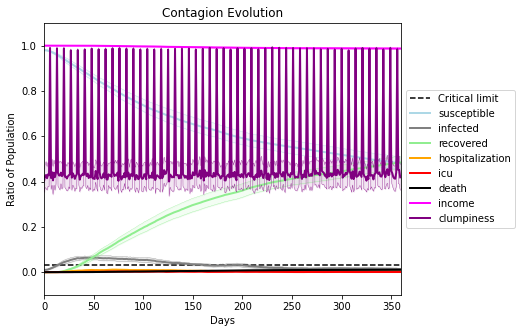

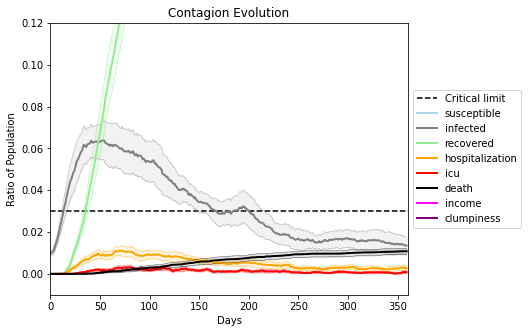

In [5]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.999
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[2309, 4021, 1434, 4697, 7644, 4593, 504, 8841, 1351, 6781, 2929, 8382, 3736, 7727, 9240, 9813, 1941, 760, 2725, 4544]
Average similarity between family members is 0.9724427416874409 at temperature -0.998
Average similarity between family and home is 0.9998412109547823 at temperature -1
Average similarity between students and their classroom is 0.7637850298739537 at temperature -0.998
Average classroom occupancy is 4.121212121212121 and number classrooms is 66
Average similarity between workers is 0.9687206891706794 at temperature -0.998
Average office occupancy is 3.734806629834254 and number offices is 181
Average friend similarity for adults: 0.8548211384587158 for kids: 0.7062961130832952
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Building

avg restaurant similarity 0.6310997990042089
avg restaurant similarity 0.8384952925496757
avg restaurant similarity 0.5591307449013514
avg restaurant similarity 0.6702599659710426
avg restaurant similarity 0.40223577209393024
avg restaurant similarity 0.6509496868493649
avg restaurant similarity 0.6072899999590797
avg restaurant similarity 0.46916097766544884
avg restaurant similarity 0.6118869762315045
avg restaurant similarity 0.3811623489261341
avg restaurant similarity 0.5986801484334896
avg restaurant similarity 0.3456651765853307
avg restaurant similarity 0.46192249491371173
avg restaurant similarity 0.45813076602834235
avg restaurant similarity 0.4331602630184378
avg restaurant similarity 0.46192249491371173
avg restaurant similarity 0.5974323962629045
avg restaurant similarity 0.3167750671713717
avg restaurant similarity 0.40813991845387176
avg restaurant similarity 0.5733878565669279
avg restaurant similarity 0.48230088136769245
avg restaurant similarity 0.83578840545588
avg r

avg restaurant similarity 0.5874729448372042
avg restaurant similarity 0.7025457789646499
avg restaurant similarity 0.6823408895162937
avg restaurant similarity 0.37644336970533954
avg restaurant similarity 0.8533269572652791
avg restaurant similarity 0.7799146722665732
avg restaurant similarity 0.8540907272463072
avg restaurant similarity 0.6474647211605518
avg restaurant similarity 0.8095980610233915
avg restaurant similarity 0.41510582059078743
avg restaurant similarity 0.5183099285373032
avg restaurant similarity 0.5654527295220204
avg restaurant similarity 0.9997170120051646
avg restaurant similarity 0.37916508059941795
avg restaurant similarity 0.5460801086162634
avg restaurant similarity 0.34488655686405756
avg restaurant similarity 0.4991823135102229
avg restaurant similarity 0.47167341336279955
avg restaurant similarity 0.8454123776464608
avg restaurant similarity 0.802777966052448
avg restaurant similarity 0.4492341543839221
avg restaurant similarity 0.5973174409676003
avg re

avg restaurant similarity 0.7855529695981422
avg restaurant similarity 0.7184478101413077
avg restaurant similarity 0.5319581210919606
avg restaurant similarity 0.6048961187564356
avg restaurant similarity 0.39907168494529044
avg restaurant similarity 0.6019549689179959
avg restaurant similarity 0.8832734928041401
avg restaurant similarity 0.4291437655490103
avg restaurant similarity 0.7121251336352871
avg restaurant similarity 0.5440513769901991
avg restaurant similarity 0.7419485354277103
avg restaurant similarity 0.6827010597265879
avg restaurant similarity 0.7124060789142518
avg restaurant similarity 0.8394959419716997
avg restaurant similarity 0.40275090178124706
avg restaurant similarity 0.6049382914222561
avg restaurant similarity 0.6002437530276669
avg restaurant similarity 0.8093942364801942
avg restaurant similarity 0.8211796698886578
avg restaurant similarity 0.45577559662077727
avg restaurant similarity 0.8640432743234701
avg restaurant similarity 0.7152604127393991
avg res

avg restaurant similarity 0.7581078525101224
avg restaurant similarity 0.3412164374634759
avg restaurant similarity 0.7089066033944633
avg restaurant similarity 0.6495072294525677
avg restaurant similarity 0.6326727425044039
avg restaurant similarity 0.3965883785422219
avg restaurant similarity 0.833670505502454
avg restaurant similarity 0.5860071862508298
avg restaurant similarity 0.46625135073156265
avg restaurant similarity 0.4966316515195253
avg restaurant similarity 0.45789263227916843
avg restaurant similarity 0.47063296636865815
avg restaurant similarity 0.48861525528783234
avg restaurant similarity 0.40380149580737207
avg restaurant similarity 0.6301575975075789
avg restaurant similarity 0.41563642923737143
avg restaurant similarity 0.5891324081429781
avg restaurant similarity 0.7135445007273169
avg restaurant similarity 0.4119020462800953
avg restaurant similarity 0.5194390607388522
avg restaurant similarity 0.8257686027611358
avg restaurant similarity 0.5616337631949586
avg r

avg restaurant similarity 0.3953337951397554
avg restaurant similarity 0.8811623265384202
avg restaurant similarity 0.6531254252398468
avg restaurant similarity 0.633174480057387
avg restaurant similarity 0.6164727086403347
avg restaurant similarity 0.8510658422170361
avg restaurant similarity 0.9998033220840923
avg restaurant similarity 0.8510658422170361
Average similarity between family members is 0.9740750042243832 at temperature -0.998
Average similarity between family and home is 0.9998601560770554 at temperature -1
Average similarity between students and their classroom is 0.7782586396759973 at temperature -0.998
Average classroom occupancy is 4.3538461538461535 and number classrooms is 65
Average similarity between workers is 0.9652685036001879 at temperature -0.998
Average office occupancy is 3.556756756756757 and number offices is 185
Average friend similarity for adults: 0.8562706362119994 for kids: 0.7242845172713921
home_districts
[
Home (0,0) district with 1 Buildings
Hom

avg restaurant similarity 0.3927521640030827
avg restaurant similarity 0.6500351639425381
avg restaurant similarity 0.26087710418763904
avg restaurant similarity 0.4906994501287265
avg restaurant similarity 0.6757085138865198
avg restaurant similarity 0.6468174337312407
avg restaurant similarity 0.6802103203571788
avg restaurant similarity 0.6267913949486665
avg restaurant similarity 0.27516315896142374
avg restaurant similarity 0.8237696163614583
avg restaurant similarity 0.3786261491055683
avg restaurant similarity 0.4348802979033614
avg restaurant similarity 0.615738309469076
avg restaurant similarity 0.3397570073771218
avg restaurant similarity 0.7127076592366263
avg restaurant similarity 0.7502793883146552
avg restaurant similarity 0.7006396616046416
avg restaurant similarity 0.4875834028830113
avg restaurant similarity 0.26367688714597676
avg restaurant similarity 0.9994625895837252
avg restaurant similarity 0.6749252034439066
avg restaurant similarity 0.492050812190422
avg resta

avg restaurant similarity 0.7747816842780014
avg restaurant similarity 0.6620779070783314
avg restaurant similarity 0.5556687203659503
avg restaurant similarity 0.8172273611880725
avg restaurant similarity 0.4782972383448007
avg restaurant similarity 0.5568681343737996
avg restaurant similarity 0.4240047828776661
avg restaurant similarity 0.5679109779128032
avg restaurant similarity 0.42158409745564124
avg restaurant similarity 0.6198407376815156
avg restaurant similarity 0.574157962728215
avg restaurant similarity 0.7905623815509132
avg restaurant similarity 0.647036754493629
avg restaurant similarity 0.4389372872322147
avg restaurant similarity 0.871094771939097
avg restaurant similarity 0.4782972383448007
avg restaurant similarity 0.5336507914880038
avg restaurant similarity 0.30338591906206847
avg restaurant similarity 0.47272450890411755
avg restaurant similarity 0.9999088515034419
avg restaurant similarity 0.9996701679457625
avg restaurant similarity 0.9997139149355009
avg restau

avg restaurant similarity 0.6608381340084344
avg restaurant similarity 0.5092209350775733
avg restaurant similarity 0.4840599642490216
avg restaurant similarity 0.6573726971045725
avg restaurant similarity 0.5307151995614576
avg restaurant similarity 0.3373028647971006
avg restaurant similarity 0.808068581515546
avg restaurant similarity 0.561563317731125
avg restaurant similarity 0.5534462410455188
avg restaurant similarity 0.42660399964612905
avg restaurant similarity 0.5661671553435812
avg restaurant similarity 0.47861642414352
avg restaurant similarity 0.6963502446938516
avg restaurant similarity 0.7710380423261032
avg restaurant similarity 0.9087740595921482
avg restaurant similarity 0.3518418467037707
avg restaurant similarity 0.5273796995184135
avg restaurant similarity 0.4292339157713373
avg restaurant similarity 0.5820728823922834
avg restaurant similarity 0.7842296696059635
avg restaurant similarity 0.5296188735838921
avg restaurant similarity 0.4977349459319077
avg restauran

Average similarity between workers is 0.9785221050355912 at temperature -0.998
Average office occupancy is 3.4105263157894736 and number offices is 190
Average friend similarity for adults: 0.8520456290405755 for kids: 0.7180713347711661
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10

avg restaurant similarity 0.5110623243751923
avg restaurant similarity 0.4492120921238696
avg restaurant similarity 0.6156110984366414
avg restaurant similarity 0.5051085043738592
avg restaurant similarity 0.7381097083547828
avg restaurant similarity 0.538955381175688
avg restaurant similarity 0.6022164981180451
avg restaurant similarity 0.4798046342453829
avg restaurant similarity 0.40335143368524073
avg restaurant similarity 0.5477789915291017
avg restaurant similarity 0.5701718420367898
avg restaurant similarity 0.4756964652022594
avg restaurant similarity 0.8303247770413378
avg restaurant similarity 0.7761114045284404
avg restaurant similarity 0.6018291223916598
avg restaurant similarity 0.5897934242878227
avg restaurant similarity 0.8303247770413378
avg restaurant similarity 0.8127227236546504
avg restaurant similarity 0.6890263764024722
avg restaurant similarity 0.5342102489608842
avg restaurant similarity 0.5999138952554285
avg restaurant similarity 0.9998066838364663
avg restau

avg restaurant similarity 0.6280122184459791
avg restaurant similarity 0.6568091966620526
avg restaurant similarity 0.6976121423233754
avg restaurant similarity 0.7200762990662637
avg restaurant similarity 0.7196077142799873
avg restaurant similarity 0.6224694838788375
avg restaurant similarity 0.6464652458629687
avg restaurant similarity 0.7730800257558041
avg restaurant similarity 0.7226587516503635
avg restaurant similarity 0.5674960399101578
avg restaurant similarity 0.5430820708798063
avg restaurant similarity 0.4968079207817576
avg restaurant similarity 0.4285297704514207
avg restaurant similarity 0.4335652179002977
avg restaurant similarity 0.5880373588676924
avg restaurant similarity 0.596782698277997
avg restaurant similarity 0.885763384761784
avg restaurant similarity 0.6422742499009522
avg restaurant similarity 0.5950971919088748
avg restaurant similarity 0.6464652458629687
avg restaurant similarity 0.8504588099049087
avg restaurant similarity 0.5929367228597306
avg restaura

avg restaurant similarity 0.5971486758951827
avg restaurant similarity 0.6631774931174684
avg restaurant similarity 0.6637771392318186
avg restaurant similarity 0.8438057812288613
avg restaurant similarity 0.39267991040756905
avg restaurant similarity 0.8864926171705265
avg restaurant similarity 0.6762892545110321
avg restaurant similarity 0.5148102008892181
avg restaurant similarity 0.8850391369688293
avg restaurant similarity 0.5070263493576551
avg restaurant similarity 0.5832075588796687
avg restaurant similarity 0.4554601091918181
avg restaurant similarity 0.4465329415388947
avg restaurant similarity 0.6627776130074694
avg restaurant similarity 0.5316219365997068
avg restaurant similarity 0.26154773508450696
avg restaurant similarity 0.8145785375885273
avg restaurant similarity 0.580170527910849
avg restaurant similarity 0.8126169985584739
avg restaurant similarity 0.9999389827007361
avg restaurant similarity 0.6758706363359614
avg restaurant similarity 0.26056718111002175
avg rest

avg restaurant similarity 0.6020313144747527
avg restaurant similarity 0.5984533922648431
avg restaurant similarity 0.5310025531889511
avg restaurant similarity 0.6352354540937322
avg restaurant similarity 0.4994259502808418
avg restaurant similarity 0.49709572014309733
avg restaurant similarity 0.5010432457666306
avg restaurant similarity 0.5405580380156931
avg restaurant similarity 0.5363922199757833
avg restaurant similarity 0.4390029746982448
avg restaurant similarity 0.5235540006976502
avg restaurant similarity 0.5666231311768936
avg restaurant similarity 0.3701302591549804
avg restaurant similarity 0.6714207180224698
avg restaurant similarity 0.5235540006976502
avg restaurant similarity 0.4937465112992374
avg restaurant similarity 0.42817138861654913
avg restaurant similarity 0.5618749677662772
avg restaurant similarity 0.45136575724657707
avg restaurant similarity 0.38327072395647377
avg restaurant similarity 0.6427395070024055
avg restaurant similarity 0.9364687412210242
avg re

avg restaurant similarity 0.999710722828711
avg restaurant similarity 0.7535170316997057
avg restaurant similarity 0.5876309454645499
avg restaurant similarity 0.39421954326703224
avg restaurant similarity 0.5251035319447914
avg restaurant similarity 0.6224708518741775
avg restaurant similarity 0.9996296417504218
avg restaurant similarity 0.41917016100010923
avg restaurant similarity 0.4772449691633509
avg restaurant similarity 0.691932459691128
avg restaurant similarity 0.9994502314441666
avg restaurant similarity 0.20414736144294468
avg restaurant similarity 0.4157679631002802
avg restaurant similarity 0.3688587298165049
avg restaurant similarity 0.8461190608726009
avg restaurant similarity 0.4131986570882692
avg restaurant similarity 0.8429183838411314
avg restaurant similarity 0.999654967927914
avg restaurant similarity 0.6831078146552834
avg restaurant similarity 0.412647986893481
avg restaurant similarity 0.5411148601059422
avg restaurant similarity 0.6395627630077125
avg restaur

avg restaurant similarity 0.725675070756781
avg restaurant similarity 0.5576582025224026
avg restaurant similarity 0.5575537418952887
avg restaurant similarity 0.9997121858971465
avg restaurant similarity 0.533777825373869
avg restaurant similarity 0.507316314838048
avg restaurant similarity 0.4212070483228254
avg restaurant similarity 0.7083975548142575
avg restaurant similarity 0.7424950092293412
avg restaurant similarity 0.6059013453979698
avg restaurant similarity 0.8599819107319249
avg restaurant similarity 0.6127655359523919
avg restaurant similarity 0.5190676409228746
avg restaurant similarity 0.9048742633098157
avg restaurant similarity 0.9998585191181626
avg restaurant similarity 0.46780656564578527
avg restaurant similarity 0.7079104517120258
avg restaurant similarity 0.48803564953038947
avg restaurant similarity 0.547575386952875
avg restaurant similarity 0.5461003264989825
avg restaurant similarity 0.32386459214262375
avg restaurant similarity 0.5454385043608038
avg restaur

avg restaurant similarity 0.6423754576571459
avg restaurant similarity 0.785130671080555
avg restaurant similarity 0.8912929378203072
avg restaurant similarity 0.42687233056265356
avg restaurant similarity 0.9050124070983538
avg restaurant similarity 0.9996501490523649
avg restaurant similarity 0.5459791553095901
avg restaurant similarity 0.49475355573221547
avg restaurant similarity 0.5461003264989825
avg restaurant similarity 0.6619593965555596
avg restaurant similarity 0.5492340667040373
avg restaurant similarity 0.7965493999843106
avg restaurant similarity 0.4086770353864626
avg restaurant similarity 0.5081874799147799
avg restaurant similarity 0.6941980776908868
avg restaurant similarity 0.5486883121763417
avg restaurant similarity 0.6078042098100361
avg restaurant similarity 0.7093740658139396
avg restaurant similarity 0.8551411371208942
avg restaurant similarity 0.556612266075794
avg restaurant similarity 0.5461003264989825
avg restaurant similarity 0.8980512766268537
avg restau

avg restaurant similarity 0.5700286133573875
avg restaurant similarity 0.5856314871024254
avg restaurant similarity 0.4854947961480037
avg restaurant similarity 0.5012452465454581
avg restaurant similarity 0.7222139357101999
avg restaurant similarity 0.5069996715281125
avg restaurant similarity 0.6684102724695795
avg restaurant similarity 0.8344092226376475
avg restaurant similarity 0.8333644633597392
avg restaurant similarity 0.3540502075598149
avg restaurant similarity 0.5704658518056025
avg restaurant similarity 0.4065241591946791
avg restaurant similarity 0.6889655756636284
avg restaurant similarity 0.4170313056709131
avg restaurant similarity 0.5882349583046215
avg restaurant similarity 0.4985163206462909
avg restaurant similarity 0.5613859069407552
avg restaurant similarity 0.6654937066884226
avg restaurant similarity 0.4334800306957647
avg restaurant similarity 0.6650409911046125
avg restaurant similarity 0.845137773037226
avg restaurant similarity 0.4854947961480037
avg restaur

avg restaurant similarity 0.5150719213690139
avg restaurant similarity 0.6425597298076613
avg restaurant similarity 0.7152638390897779
avg restaurant similarity 0.4403500379273654
avg restaurant similarity 0.6631352041183206
avg restaurant similarity 0.8519317755819079
avg restaurant similarity 0.6141377748431648
avg restaurant similarity 0.4120178901700829
avg restaurant similarity 0.875168176422168
avg restaurant similarity 0.7180287214388446
avg restaurant similarity 0.9999384306158121
avg restaurant similarity 0.43476830531683425
avg restaurant similarity 0.6559181573028645
avg restaurant similarity 0.43339257734663716
avg restaurant similarity 0.5625398934011909
avg restaurant similarity 0.9202133928225831
avg restaurant similarity 0.6649366860033129
avg restaurant similarity 0.7937706252405095
avg restaurant similarity 0.7180287214388446
avg restaurant similarity 0.12779581112394245
avg restaurant similarity 0.43339257734663716
avg restaurant similarity 0.9997584759944323
avg res

avg restaurant similarity 0.5584314376330044
avg restaurant similarity 0.8417187374551394
avg restaurant similarity 0.6136123880601896
avg restaurant similarity 0.999825134996972
avg restaurant similarity 0.6334049843589042
avg restaurant similarity 0.6163434425650274
avg restaurant similarity 0.850382599808045
avg restaurant similarity 0.6467819393326025
avg restaurant similarity 0.36738886028700024
avg restaurant similarity 0.4717978670814171
avg restaurant similarity 0.6163434425650274
avg restaurant similarity 0.30457615265745147
avg restaurant similarity 0.9996758408293143
avg restaurant similarity 0.7837942708935208
avg restaurant similarity 0.6147537824196099
avg restaurant similarity 0.6180404372083945
avg restaurant similarity 0.11763433232311546
avg restaurant similarity 0.6180404372083945
avg restaurant similarity 0.7789068835604549
avg restaurant similarity 0.8258939165717614
avg restaurant similarity 0.32853675726823933
avg restaurant similarity 0.630819974492565
avg resta

avg restaurant similarity 0.7154652844191413
avg restaurant similarity 0.9998070875607312
avg restaurant similarity 0.859562057143354
avg restaurant similarity 0.7019151849402816
avg restaurant similarity 0.6648746202954942
avg restaurant similarity 0.6048798554896655
avg restaurant similarity 0.8645767829956226
avg restaurant similarity 0.9998151377733671
avg restaurant similarity 0.6156200281019586
avg restaurant similarity 0.7131124585961344
avg restaurant similarity 0.6469091358408221
avg restaurant similarity 0.6416332208315464
avg restaurant similarity 0.3562286667978869
avg restaurant similarity 0.6330043111887766
avg restaurant similarity 0.7775644359692842
avg restaurant similarity 0.6123064560010743
avg restaurant similarity 0.7341334193679544
avg restaurant similarity 0.9998070875607312
avg restaurant similarity 0.8124660922359233
avg restaurant similarity 0.9044354565431016
avg restaurant similarity 0.7890417474841581
avg restaurant similarity 0.6905670882295298
avg restaur

avg restaurant similarity 0.5991220410988854
avg restaurant similarity 0.5016260346249447
avg restaurant similarity 0.6148211766814268
avg restaurant similarity 0.47473626432964083
avg restaurant similarity 0.2106075425984052
avg restaurant similarity 0.2953323566627977
avg restaurant similarity 0.1362572809545661
avg restaurant similarity 0.30388952923385526
avg restaurant similarity 0.49980013798156164
avg restaurant similarity 0.5024369431148761
avg restaurant similarity 0.4723267508839187
avg restaurant similarity 0.590703066760039
avg restaurant similarity 0.6650748656618667
avg restaurant similarity 0.5718524809663658
avg restaurant similarity 0.6101062187711419
avg restaurant similarity 0.542623150584884
avg restaurant similarity 0.40006988198270954
avg restaurant similarity 0.5630567604212047
avg restaurant similarity 0.4649177616973148
avg restaurant similarity 0.854909182265797
avg restaurant similarity 0.7367907632271514
avg restaurant similarity 0.9996352733695844
avg resta

avg restaurant similarity 0.7411181362755587
avg restaurant similarity 0.5639801923957137
avg restaurant similarity 0.8261979511667994
avg restaurant similarity 0.9997628931374938
avg restaurant similarity 0.657970561038022
avg restaurant similarity 0.7203028612404642
avg restaurant similarity 0.8615769085554511
avg restaurant similarity 0.7067330592751109
avg restaurant similarity 0.6563689148484146
avg restaurant similarity 0.5624412919708222
avg restaurant similarity 0.7133409089188723
avg restaurant similarity 0.6038181613124374
avg restaurant similarity 0.5754222900735556
avg restaurant similarity 0.5946547217218594
avg restaurant similarity 0.733046631817325
avg restaurant similarity 0.42783834903875906
avg restaurant similarity 0.8124973224977303
avg restaurant similarity 0.5735874312349127
avg restaurant similarity 0.4104792236853595
avg restaurant similarity 0.6452062818509845
avg restaurant similarity 0.5639199787138838
avg restaurant similarity 0.5398371452008404
avg restaur

avg restaurant similarity 0.7130606628888283
avg restaurant similarity 0.4890867017591418
avg restaurant similarity 0.9997477931911871
avg restaurant similarity 0.5643521569734344
avg restaurant similarity 0.8064766575652804
avg restaurant similarity 0.29592367838931893
avg restaurant similarity 0.6039956705490461
avg restaurant similarity 0.4831116525479708
avg restaurant similarity 0.5075159430007983
avg restaurant similarity 0.5688163752280158
avg restaurant similarity 0.9996465572105391
avg restaurant similarity 0.9167504793879828
avg restaurant similarity 0.4194230280680411
avg restaurant similarity 0.5134979321867391
avg restaurant similarity 0.580390921392556
avg restaurant similarity 0.4810159798188425
avg restaurant similarity 0.9997880113951905
avg restaurant similarity 0.5436779259977047
avg restaurant similarity 0.5882858089811298
avg restaurant similarity 0.5063711112724234
avg restaurant similarity 0.8455222563458631
avg restaurant similarity 0.6158580411759804
avg restau

(<function dict.items>, <function dict.items>, <function dict.items>)

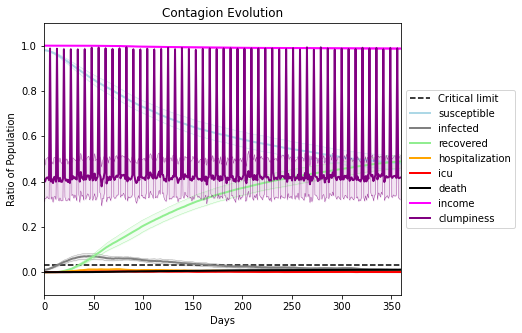

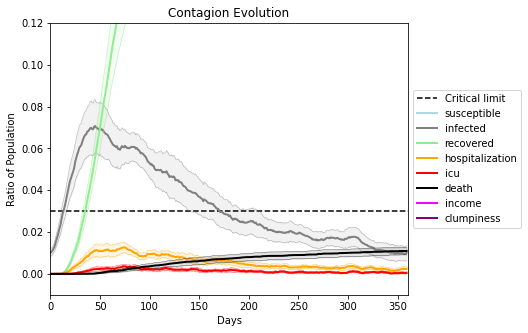

In [6]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.998
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[5214, 2066, 9670, 4266, 8556, 8253, 5962, 6318, 17, 357, 4680, 2673, 5826, 1093, 715, 3556, 718, 2254, 6402, 5398]
Average similarity between family members is 0.9546720723442338 at temperature -0.9975
Average similarity between family and home is 0.999845018454372 at temperature -1
Average similarity between students and their classroom is 0.6788985578976903 at temperature -0.9975
Average classroom occupancy is 4.454545454545454 and number classrooms is 66
Average similarity between workers is 0.9278158222955321 at temperature -0.9975
Average office occupancy is 3.4263157894736844 and number offices is 190
Average friend similarity for adults: 0.8581994917162268 for kids: 0.7175146042669628
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings


avg restaurant similarity 0.6395178242256864
avg restaurant similarity 0.6332129344732378
avg restaurant similarity 0.6473540915469853
avg restaurant similarity 0.36002396661078173
avg restaurant similarity 0.8688349812358701
avg restaurant similarity 0.6282557373698182
avg restaurant similarity 0.5319173747425453
avg restaurant similarity 0.3551305686321391
avg restaurant similarity 0.6033570927045517
avg restaurant similarity 0.6062397048030024
avg restaurant similarity 0.4555893579670466
avg restaurant similarity 0.8413050385065588
avg restaurant similarity 0.4486976701411953
avg restaurant similarity 0.8571843919849554
avg restaurant similarity 0.5883178682098643
avg restaurant similarity 0.4341583556274896
avg restaurant similarity 0.6061940077343443
avg restaurant similarity 0.7531587319330657
avg restaurant similarity 0.7154177633057337
avg restaurant similarity 0.6908903463972388
avg restaurant similarity 0.6170313170359948
avg restaurant similarity 0.578655794816887
avg restau

avg restaurant similarity 0.5253139628746634
avg restaurant similarity 0.8202926668650432
avg restaurant similarity 0.8477222796783275
avg restaurant similarity 0.45533492844532375
avg restaurant similarity 0.35943028471007465
avg restaurant similarity 0.8386611627676722
avg restaurant similarity 0.5776679027838092
avg restaurant similarity 0.568458886742775
avg restaurant similarity 0.42945654279004863
avg restaurant similarity 0.5765058682200147
avg restaurant similarity 0.8792277938105454
avg restaurant similarity 0.40481418182924755
avg restaurant similarity 0.56659964492856
avg restaurant similarity 0.45858605138278885
avg restaurant similarity 0.5663436908872369
avg restaurant similarity 0.5716138242932429
avg restaurant similarity 0.8178924681421966
avg restaurant similarity 0.6927149180004637
avg restaurant similarity 0.8161062030651848
avg restaurant similarity 0.6837825363486774
avg restaurant similarity 0.559819549271682
avg restaurant similarity 0.9130047889348031
avg resta

avg restaurant similarity 0.762429528008711
avg restaurant similarity 0.8488855516167171
avg restaurant similarity 0.7339927388782757
avg restaurant similarity 0.8664685230502347
avg restaurant similarity 0.9334724089152047
avg restaurant similarity 0.6956673460265204
avg restaurant similarity 0.5118865843692869
avg restaurant similarity 0.6632548027539557
avg restaurant similarity 0.669174404936612
avg restaurant similarity 0.4252690667867741
avg restaurant similarity 0.7381109051160345
avg restaurant similarity 0.4105315580044234
avg restaurant similarity 0.5744068578170795
avg restaurant similarity 0.5877411079803262
avg restaurant similarity 0.4967754503183457
avg restaurant similarity 0.654792036258649
avg restaurant similarity 0.5345780008422386
avg restaurant similarity 0.6349335331886757
avg restaurant similarity 0.9998509835262444
avg restaurant similarity 0.7358171792591031
avg restaurant similarity 0.638839707574448
avg restaurant similarity 0.5385396020755079
avg restaurant

avg restaurant similarity 0.5648038398396523
avg restaurant similarity 0.6453984852498635
avg restaurant similarity 0.5308750047655106
avg restaurant similarity 0.8650529818636565
avg restaurant similarity 0.5327042590427551
avg restaurant similarity 0.672221758712331
avg restaurant similarity 0.39110917536981404
avg restaurant similarity 0.42895905967162384
avg restaurant similarity 0.47819287391558607
avg restaurant similarity 0.5334508945298907
avg restaurant similarity 0.7022179381929322
avg restaurant similarity 0.9998293878009649
avg restaurant similarity 0.2546078389172096
avg restaurant similarity 0.3245477643845134
avg restaurant similarity 0.6007851603615595
avg restaurant similarity 0.6441636667808093
avg restaurant similarity 0.44743286797580045
avg restaurant similarity 0.28933652197128823
avg restaurant similarity 0.5547310104871949
avg restaurant similarity 0.38613693661015824
avg restaurant similarity 0.2902059417923242
avg restaurant similarity 0.38127310898020833
avg 

avg restaurant similarity 0.5006745032924469
avg restaurant similarity 0.33667352179270527
avg restaurant similarity 0.7596821113496697
avg restaurant similarity 0.29517449223100845
avg restaurant similarity 0.6671745724493185
avg restaurant similarity 0.28429009290244656
avg restaurant similarity 0.49287745231779057
avg restaurant similarity 0.8774753317175195
avg restaurant similarity 0.3967852321217248
avg restaurant similarity 0.8856934755272801
avg restaurant similarity 0.5353744085922751
avg restaurant similarity 0.6302669547106954
avg restaurant similarity 0.45376195434722677
avg restaurant similarity 0.5924151093633268
avg restaurant similarity 0.45120872381747057
avg restaurant similarity 0.5945360989643627
avg restaurant similarity 0.47982048699775426
avg restaurant similarity 0.9997926832678801
avg restaurant similarity 0.2432596620206645
avg restaurant similarity 0.5598181249576499
avg restaurant similarity 0.47982048699775426
avg restaurant similarity 0.7269755656801007
av

avg restaurant similarity 0.5205215993460122
avg restaurant similarity 0.6279377438625425
avg restaurant similarity 0.5408601725669469
avg restaurant similarity 0.5937084103833468
avg restaurant similarity 0.43234458560978084
avg restaurant similarity 0.7969522233234836
avg restaurant similarity 0.5104094116355444
avg restaurant similarity 0.6593319812841583
avg restaurant similarity 0.8039214141434671
avg restaurant similarity 0.6160399366763212
avg restaurant similarity 0.9026155874110476
avg restaurant similarity 0.3470663775113183
avg restaurant similarity 0.9005176529967617
avg restaurant similarity 0.5563922651384428
avg restaurant similarity 0.3445276632741608
avg restaurant similarity 0.7021722666872662
avg restaurant similarity 0.8039214141434671
avg restaurant similarity 0.8007559763348159
avg restaurant similarity 0.6309676283793682
avg restaurant similarity 0.3495509996120644
avg restaurant similarity 0.8731413513102428
avg restaurant similarity 0.9997970603257562
avg resta

avg restaurant similarity 0.5175145178414939
avg restaurant similarity 0.346181779580637
avg restaurant similarity 0.6032910806370803
avg restaurant similarity 0.8074823655855721
avg restaurant similarity 0.5574459993323185
avg restaurant similarity 0.530124889095162
avg restaurant similarity 0.5750477720309894
avg restaurant similarity 0.45976656356016354
avg restaurant similarity 0.8155331022355515
avg restaurant similarity 0.7517329389050171
avg restaurant similarity 0.3536233077524127
avg restaurant similarity 0.4315229956352004
avg restaurant similarity 0.4299418887122728
avg restaurant similarity 0.8075943504694931
avg restaurant similarity 0.8431352945017301
avg restaurant similarity 0.3669097642818627
avg restaurant similarity 0.5565236497739259
avg restaurant similarity 0.7042984160681823
avg restaurant similarity 0.514188382244438
avg restaurant similarity 0.45976656356016354
avg restaurant similarity 0.7012955804796266
avg restaurant similarity 0.650188650818864
avg restaura

avg restaurant similarity 0.7268038501345714
avg restaurant similarity 0.9098228624880698
avg restaurant similarity 0.999736151901371
avg restaurant similarity 0.29723530950966814
avg restaurant similarity 0.9996675630085324
avg restaurant similarity 0.7169999732938448
avg restaurant similarity 0.45658534211016877
avg restaurant similarity 0.9996675630085324
avg restaurant similarity 0.5869200695794365
avg restaurant similarity 0.6843911612232576
avg restaurant similarity 0.565717083062886
avg restaurant similarity 0.4006931300306882
avg restaurant similarity 0.6570787509085094
avg restaurant similarity 0.6543241005627178
avg restaurant similarity 0.6850037405963575
avg restaurant similarity 0.480866884798814
avg restaurant similarity 0.4924125323464105
avg restaurant similarity 0.8585788982273859
avg restaurant similarity 0.7463556028449513
avg restaurant similarity 0.298247093076218
avg restaurant similarity 0.8958401819248455
avg restaurant similarity 0.6016063369025451
avg restaura

avg restaurant similarity 0.47018290901035076
avg restaurant similarity 0.7814506186328859
avg restaurant similarity 0.5069867358781339
avg restaurant similarity 0.7769951534579367
avg restaurant similarity 0.49127198705431707
avg restaurant similarity 0.6925744749177536
avg restaurant similarity 0.6478017285587024
avg restaurant similarity 0.7021550390225137
avg restaurant similarity 0.9100676250655153
avg restaurant similarity 0.5043711355448643
avg restaurant similarity 0.539309331371723
avg restaurant similarity 0.4703479516031755
avg restaurant similarity 0.610634664998119
avg restaurant similarity 0.5073216654136314
avg restaurant similarity 0.5017164897182507
avg restaurant similarity 0.5385647984762689
avg restaurant similarity 0.663781466132898
avg restaurant similarity 0.6925744749177536
avg restaurant similarity 0.5385647984762689
avg restaurant similarity 0.7731954864538044
avg restaurant similarity 0.5987746577906474
avg restaurant similarity 0.8913633340545103
avg restaur

avg restaurant similarity 0.6457988460265186
avg restaurant similarity 0.6294307642986333
avg restaurant similarity 0.7770806498481839
avg restaurant similarity 0.7036037916893061
avg restaurant similarity 0.8344756621912877
avg restaurant similarity 0.9996446842441965
avg restaurant similarity 0.680484324053694
avg restaurant similarity 0.5090425127461197
avg restaurant similarity 0.48482958218533845
avg restaurant similarity 0.6407738553637897
avg restaurant similarity 0.7324392875081216
avg restaurant similarity 0.5559776277039226
avg restaurant similarity 0.38259109944926434
avg restaurant similarity 0.47094962230986553
avg restaurant similarity 0.6822954644994479
avg restaurant similarity 0.999705192625207
avg restaurant similarity 0.4214608818161436
avg restaurant similarity 0.3648975772362777
avg restaurant similarity 0.6702538495564306
avg restaurant similarity 0.6234641390112631
avg restaurant similarity 0.742692973429242
avg restaurant similarity 0.9998217810527974
avg restau

avg restaurant similarity 0.7896515937855323
avg restaurant similarity 0.4505364095071681
avg restaurant similarity 0.5581591036948828
avg restaurant similarity 0.3333517647060825
avg restaurant similarity 0.5987176455511776
avg restaurant similarity 0.9998953650492662
avg restaurant similarity 0.5511117464612513
avg restaurant similarity 0.42001994323604563
avg restaurant similarity 0.6031874857904745
avg restaurant similarity 0.3623540022105583
avg restaurant similarity 0.5740033389306038
avg restaurant similarity 0.3604331124740179
avg restaurant similarity 0.5263534746681336
avg restaurant similarity 0.8878080974466088
avg restaurant similarity 0.5714950666149287
avg restaurant similarity 0.5285108987719653
avg restaurant similarity 0.42615122676116046
avg restaurant similarity 0.4242103860009405
avg restaurant similarity 0.4639192025733728
avg restaurant similarity 0.3709466805700886
avg restaurant similarity 0.33726549195382943
avg restaurant similarity 0.25262408452302404
avg re

avg restaurant similarity 0.9997666183850396
avg restaurant similarity 0.4810297545085288
avg restaurant similarity 0.9997666183850396
avg restaurant similarity 0.9097955589051491
avg restaurant similarity 0.5057392701932845
avg restaurant similarity 0.47797613554220564
avg restaurant similarity 0.5222375886432593
avg restaurant similarity 0.8275879566692435
avg restaurant similarity 0.7568128792566007
avg restaurant similarity 0.4673407860005292
avg restaurant similarity 0.6303237814453773
avg restaurant similarity 0.48084502885721225
avg restaurant similarity 0.561817707735608
avg restaurant similarity 0.851597443316516
avg restaurant similarity 0.8275537620879503
avg restaurant similarity 0.331229340601354
avg restaurant similarity 0.7986548653405761
avg restaurant similarity 0.47988326270197357
avg restaurant similarity 0.47988326270197357
avg restaurant similarity 0.6279515706441767
avg restaurant similarity 0.6646582065898387
avg restaurant similarity 0.3067828915239043
avg resta

avg restaurant similarity 0.6165156811972763
avg restaurant similarity 0.4310722409638773
avg restaurant similarity 0.49871797259462286
avg restaurant similarity 0.29676017550924916
avg restaurant similarity 0.5929223621954198
avg restaurant similarity 0.3662114135291886
avg restaurant similarity 0.7415482125142824
avg restaurant similarity 0.9101807058101663
avg restaurant similarity 0.3963724830200712
avg restaurant similarity 0.4194002402611863
avg restaurant similarity 0.8643578021955953
avg restaurant similarity 0.28249065679025426
avg restaurant similarity 0.5441153310121758
avg restaurant similarity 0.7251538522965806
avg restaurant similarity 0.4742275434717531
avg restaurant similarity 0.8198331633838376
avg restaurant similarity 0.7266419634351005
avg restaurant similarity 0.9997919224126798
avg restaurant similarity 0.28827184174430504
avg restaurant similarity 0.5019435547521742
avg restaurant similarity 0.6369450741107251
avg restaurant similarity 0.5015563663103775
avg re

avg restaurant similarity 0.5751191559771485
avg restaurant similarity 0.6919342237746445
avg restaurant similarity 0.36522082720821103
avg restaurant similarity 0.8642325242842146
avg restaurant similarity 0.554227146327074
avg restaurant similarity 0.7453240795753115
avg restaurant similarity 0.5675724279502048
avg restaurant similarity 0.5287622283025966
avg restaurant similarity 0.5406328350082794
avg restaurant similarity 0.514741535117293
avg restaurant similarity 0.45981394194135505
avg restaurant similarity 0.5710317946416013
avg restaurant similarity 0.6862274381670779
avg restaurant similarity 0.5645564877452653
avg restaurant similarity 0.6016275877888677
avg restaurant similarity 0.4946100562770551
avg restaurant similarity 0.34834517304818047
avg restaurant similarity 0.540803871886864
avg restaurant similarity 0.3478691305451573
avg restaurant similarity 0.39592324662922684
avg restaurant similarity 0.4946100562770551
avg restaurant similarity 0.5037682919263563
avg resta

avg restaurant similarity 0.46077053550483044
avg restaurant similarity 0.2471932491191868
avg restaurant similarity 0.3702083678280293
avg restaurant similarity 0.26305922406925475
avg restaurant similarity 0.4016761010925181
avg restaurant similarity 0.4459586518448364
avg restaurant similarity 0.4431686915410967
avg restaurant similarity 0.2471932491191868
avg restaurant similarity 0.4459586518448363
avg restaurant similarity 0.6715186304227106
avg restaurant similarity 0.6062894210738127
avg restaurant similarity 0.5767056291727274
avg restaurant similarity 0.4431686915410967
avg restaurant similarity 0.4469297872837399
avg restaurant similarity 0.44660304690948666
avg restaurant similarity 0.4833885464431522
avg restaurant similarity 0.4327272748511425
avg restaurant similarity 0.6374083963760999
avg restaurant similarity 0.5747840841922123
avg restaurant similarity 0.4327272748511425
avg restaurant similarity 0.44754826291453903
avg restaurant similarity 0.4327272748511425
avg re

avg restaurant similarity 0.6027352617384282
avg restaurant similarity 0.4523324906176672
avg restaurant similarity 0.612688720199239
avg restaurant similarity 0.4484691396311712
avg restaurant similarity 0.5005417250470698
avg restaurant similarity 0.9995892083334613
avg restaurant similarity 0.45676613556872725
avg restaurant similarity 0.7108310221751193
avg restaurant similarity 0.6098801963774996
avg restaurant similarity 0.4294314535524302
avg restaurant similarity 0.5251129629555129
avg restaurant similarity 0.5520340763151198
avg restaurant similarity 0.3319196694379929
avg restaurant similarity 0.4212949074956037
avg restaurant similarity 0.47560427954264156
avg restaurant similarity 0.1531476297299336
avg restaurant similarity 0.8479729124431544
avg restaurant similarity 0.45267830865993197
avg restaurant similarity 0.8609078032423225
avg restaurant similarity 0.42031824440086374
avg restaurant similarity 0.6297570115308602
avg restaurant similarity 0.8863098111187342
avg res

avg restaurant similarity 0.6964755493904431
avg restaurant similarity 0.5174348085903449
avg restaurant similarity 0.8626209089911894
avg restaurant similarity 0.7023825015921482
avg restaurant similarity 0.9281797819897062
avg restaurant similarity 0.5006913604982832
avg restaurant similarity 0.41815830466457904
avg restaurant similarity 0.6036841573402432
avg restaurant similarity 0.8819790152535277
avg restaurant similarity 0.6932028905177248
avg restaurant similarity 0.5708544051482499
avg restaurant similarity 0.46107200091979283
avg restaurant similarity 0.6748426056950438
avg restaurant similarity 0.3088357696614938
avg restaurant similarity 0.448179299745473
avg restaurant similarity 0.7335623044217234
avg restaurant similarity 0.6542269637681846
avg restaurant similarity 0.5145704377926191
avg restaurant similarity 0.5755533385465648
avg restaurant similarity 0.9998117264190688
avg restaurant similarity 0.9281797819897062
avg restaurant similarity 0.49681538341958587
avg rest

avg restaurant similarity 0.4413389063167444
avg restaurant similarity 0.6662237447661136
avg restaurant similarity 0.49858064770201904
avg restaurant similarity 0.4317735381107023
avg restaurant similarity 0.7382975206936853
avg restaurant similarity 0.4332703678515927
avg restaurant similarity 0.6366199632282938
avg restaurant similarity 0.5105553263974769
avg restaurant similarity 0.39935820415543
avg restaurant similarity 0.3493577760023565
avg restaurant similarity 0.5290333535950265
avg restaurant similarity 0.41715012237560145
avg restaurant similarity 0.7546443600326527
avg restaurant similarity 0.6827682782154161
avg restaurant similarity 0.7923532139993232
avg restaurant similarity 0.5835675590905989
avg restaurant similarity 0.46645022341044506
avg restaurant similarity 0.7382975206936853
avg restaurant similarity 0.7222116613776627
avg restaurant similarity 0.50207242910201
avg restaurant similarity 0.9997459737844372
avg restaurant similarity 0.5661919576383998
avg restaur

avg restaurant similarity 0.4389126725655071
avg restaurant similarity 0.7248991745232669
avg restaurant similarity 0.5455219309106841
avg restaurant similarity 0.9997772733788004
avg restaurant similarity 0.9997604118114651
avg restaurant similarity 0.5569277828568119
avg restaurant similarity 0.6639724353609224
avg restaurant similarity 0.8318699089029181
avg restaurant similarity 0.5536226919643124
avg restaurant similarity 0.9136645974942377
avg restaurant similarity 0.9997225104768757
avg restaurant similarity 0.609397176788133
avg restaurant similarity 0.672591049307671
avg restaurant similarity 0.556833510235258
avg restaurant similarity 0.7595243509641543
avg restaurant similarity 0.8344958455809013
avg restaurant similarity 0.5448499429645884
avg restaurant similarity 0.5610433008511487
avg restaurant similarity 0.4721260312234349
avg restaurant similarity 0.28351627030194815
avg restaurant similarity 0.8049356481080704
avg restaurant similarity 0.7551586242053572
avg restaura

avg restaurant similarity 0.5913381458861833
avg restaurant similarity 0.3436302394099461
avg restaurant similarity 0.45420222856199294
avg restaurant similarity 0.2974487828530303
avg restaurant similarity 0.451956508107068
avg restaurant similarity 0.7167446776968257
avg restaurant similarity 0.7973778735034984
avg restaurant similarity 0.7033979508828991
avg restaurant similarity 0.4426919254528625
avg restaurant similarity 0.5972707887044759
avg restaurant similarity 0.31128968155397174
avg restaurant similarity 0.4794684314092036
avg restaurant similarity 0.29438043433704836
avg restaurant similarity 0.43447869852979626
avg restaurant similarity 0.378521254880785
avg restaurant similarity 0.543746140943365
avg restaurant similarity 0.4426919254528625
avg restaurant similarity 0.695143092502776
avg restaurant similarity 0.43447869852979626
avg restaurant similarity 0.793492725429894
avg restaurant similarity 0.5483342802191997
avg restaurant similarity 0.44280334012940814
avg resta

(<function dict.items>, <function dict.items>, <function dict.items>)

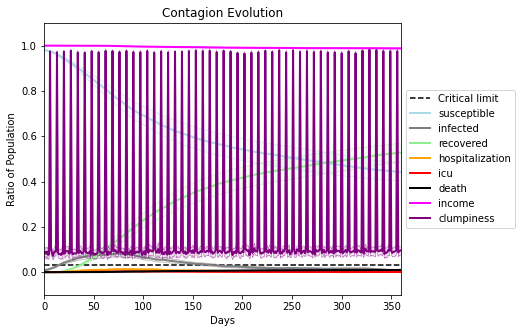

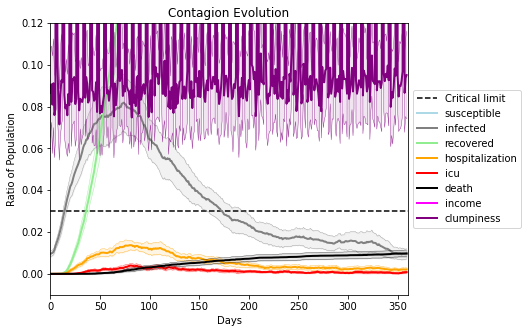

In [7]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.9975
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[4672, 3638, 1551, 6057, 1106, 9663, 8280, 2709, 8962, 1713, 7538, 8785, 2778, 3520, 8008, 9261, 6022, 4466, 2213, 9674]
Average similarity between family members is 0.9553563366561342 at temperature -0.997
Average similarity between family and home is 0.9998462974132574 at temperature -1
Average similarity between students and their classroom is 0.6779281944898904 at temperature -0.997
Average classroom occupancy is 4.084507042253521 and number classrooms is 71
Average similarity between workers is 0.9222789206504561 at temperature -0.997
Average office occupancy is 3.279187817258883 and number offices is 197
Average friend similarity for adults: 0.8581712020407426 for kids: 0.7196829251398703
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildi

avg restaurant similarity 0.49808760213632414
avg restaurant similarity 0.6555103368430492
avg restaurant similarity 0.3825380512676855
avg restaurant similarity 0.5130424176768418
avg restaurant similarity 0.5476396363205527
avg restaurant similarity 0.8436713734783035
avg restaurant similarity 0.4914694671701564
avg restaurant similarity 0.5192117986457495
avg restaurant similarity 0.5199774907109813
avg restaurant similarity 0.47338957306398316
avg restaurant similarity 0.9996267111766146
avg restaurant similarity 0.6059689299077048
avg restaurant similarity 0.4917918833633181
avg restaurant similarity 0.23942451280657423
avg restaurant similarity 0.6067618779738182
avg restaurant similarity 0.5223562703601656
avg restaurant similarity 0.4916968834678805
avg restaurant similarity 0.3825380512676855
avg restaurant similarity 0.49525097389569817
avg restaurant similarity 0.47913765228878713
avg restaurant similarity 0.5016126688834072
avg restaurant similarity 0.5785517384329755
avg r

avg restaurant similarity 0.60946208706731
avg restaurant similarity 0.45022775981018315
avg restaurant similarity 0.6304323530601402
avg restaurant similarity 0.9997150469285381
avg restaurant similarity 0.540221711608885
avg restaurant similarity 0.5093184440164422
avg restaurant similarity 0.7938944927533889
avg restaurant similarity 0.4620623975613577
avg restaurant similarity 0.7943919199480967
avg restaurant similarity 0.49547113386509295
avg restaurant similarity 0.574149461495428
avg restaurant similarity 0.4989621686302583
avg restaurant similarity 0.48815895620232247
avg restaurant similarity 0.32927183285162037
avg restaurant similarity 0.5638573005786243
avg restaurant similarity 0.6023518261889171
avg restaurant similarity 0.7427417219554087
avg restaurant similarity 0.47584250700829595
avg restaurant similarity 0.6287835897000658
avg restaurant similarity 0.37170856699372345
avg restaurant similarity 0.622799511225548
avg restaurant similarity 0.48534876845077257
avg rest

avg restaurant similarity 0.6543667065644391
avg restaurant similarity 0.46435679732121116
avg restaurant similarity 0.7099597195374661
avg restaurant similarity 0.6763285924637649
avg restaurant similarity 0.5881147531140534
avg restaurant similarity 0.7004757781061587
avg restaurant similarity 0.44891682187277276
avg restaurant similarity 0.5583672951295349
avg restaurant similarity 0.8386139173974584
avg restaurant similarity 0.4954370954560237
avg restaurant similarity 0.6317930633272031
avg restaurant similarity 0.4648596018147665
avg restaurant similarity 0.5189566843698861
avg restaurant similarity 0.5580755473084092
avg restaurant similarity 0.5169663212165804
avg restaurant similarity 0.7327616943884968
avg restaurant similarity 0.588462798106646
avg restaurant similarity 0.47148344934280007
avg restaurant similarity 0.7828894822147712
avg restaurant similarity 0.48791582150848695
avg restaurant similarity 0.5825986992678462
avg restaurant similarity 0.6776628742194828
avg res

avg restaurant similarity 0.6640710296876969
avg restaurant similarity 0.48712607320438606
avg restaurant similarity 0.9192869545340476
avg restaurant similarity 0.9998500393772938
avg restaurant similarity 0.7213589136573362
avg restaurant similarity 0.8404038521556038
avg restaurant similarity 0.838885017963872
avg restaurant similarity 0.5949910372638416
avg restaurant similarity 0.791201124829543
avg restaurant similarity 0.7467326269308044
avg restaurant similarity 0.4640163476013211
avg restaurant similarity 0.6742275799792963
avg restaurant similarity 0.5828383517868435
avg restaurant similarity 0.5471584078273755
avg restaurant similarity 0.7912111002181924
avg restaurant similarity 0.49997074637243555
avg restaurant similarity 0.5869631670468023
avg restaurant similarity 0.9998672321885534
avg restaurant similarity 0.9998234523099605
avg restaurant similarity 0.4689713077530944
avg restaurant similarity 0.8212644476159744
Average similarity between family members is 0.95314508

avg restaurant similarity 0.6574068332761442
avg restaurant similarity 0.552176616481111
avg restaurant similarity 0.5709644896921289
avg restaurant similarity 0.7983231213566614
avg restaurant similarity 0.7687837277565409
avg restaurant similarity 0.674777296183259
avg restaurant similarity 0.45525819822453356
avg restaurant similarity 0.5557740799033399
avg restaurant similarity 0.48707334963423765
avg restaurant similarity 0.65593790317106
avg restaurant similarity 0.41153681823810256
avg restaurant similarity 0.850500790336549
avg restaurant similarity 0.660569526474532
avg restaurant similarity 0.67660770964614
avg restaurant similarity 0.4385985605845253
avg restaurant similarity 0.4385985605845253
avg restaurant similarity 0.6266722897063414
avg restaurant similarity 0.5377165896877842
avg restaurant similarity 0.37118262771615756
avg restaurant similarity 0.9996290302220349
avg restaurant similarity 0.44102967364629914
avg restaurant similarity 0.5377165896877842
avg restauran

avg restaurant similarity 0.3691860109518087
avg restaurant similarity 0.6593117054251466
avg restaurant similarity 0.40046412683826627
avg restaurant similarity 0.22901370109862013
avg restaurant similarity 0.5474002235541007
avg restaurant similarity 0.5485920442139989
avg restaurant similarity 0.23040029528080433
avg restaurant similarity 0.5900389288861301
avg restaurant similarity 0.8783936164188737
avg restaurant similarity 0.4271113904834858
avg restaurant similarity 0.784521632977996
avg restaurant similarity 0.2738222135340143
avg restaurant similarity 0.47321149212950486
avg restaurant similarity 0.6923988983454029
avg restaurant similarity 0.2894369910033266
avg restaurant similarity 0.4247805391380267
avg restaurant similarity 0.4305857654792707
avg restaurant similarity 0.5596710378698103
avg restaurant similarity 0.5545112755262163
avg restaurant similarity 0.4870342093087358
avg restaurant similarity 0.48027947604211274
avg restaurant similarity 0.5900335746597447
avg re

avg restaurant similarity 0.5649030373908541
avg restaurant similarity 0.543088573488611
avg restaurant similarity 0.9365285722567611
avg restaurant similarity 0.5120362904600271
avg restaurant similarity 0.5842227132763878
avg restaurant similarity 0.7420029558557386
avg restaurant similarity 0.5022885250162127
avg restaurant similarity 0.5150313686448822
avg restaurant similarity 0.5120362904600271
avg restaurant similarity 0.5231875065519787
avg restaurant similarity 0.877222343080435
avg restaurant similarity 0.7267010854798275
avg restaurant similarity 0.44596612794043633
avg restaurant similarity 0.628414089585335
avg restaurant similarity 0.7569041838232198
avg restaurant similarity 0.45753307531652965
avg restaurant similarity 0.7901149156882439
avg restaurant similarity 0.9998265042796814
avg restaurant similarity 0.16401397622526592
avg restaurant similarity 0.6060174883253313
avg restaurant similarity 0.871155273040072
avg restaurant similarity 0.7933663296337605
avg restaur

avg restaurant similarity 0.6513473673102156
avg restaurant similarity 0.6178174564217822
avg restaurant similarity 0.6030645366791831
avg restaurant similarity 0.6143101934543519
avg restaurant similarity 0.6609551367441675
avg restaurant similarity 0.7428290933914443
avg restaurant similarity 0.510678009639132
avg restaurant similarity 0.6609551367441675
avg restaurant similarity 0.3893851114831672
avg restaurant similarity 0.6629039203755621
avg restaurant similarity 0.26379598674788385
avg restaurant similarity 0.7324009285655548
avg restaurant similarity 0.9995282618494614
avg restaurant similarity 0.8769113048297411
avg restaurant similarity 0.6250496022286167
avg restaurant similarity 0.7078666940103036
avg restaurant similarity 0.6679659498258566
avg restaurant similarity 0.6023357863670032
avg restaurant similarity 0.62295335630301
avg restaurant similarity 0.7343236140062839
avg restaurant similarity 0.6597005363532332
avg restaurant similarity 0.9998312128228708
avg restaura

avg restaurant similarity 0.2518308919007084
avg restaurant similarity 0.5009724917966603
avg restaurant similarity 0.9996324943566686
avg restaurant similarity 0.5705970845622621
avg restaurant similarity 0.4753424151872381
avg restaurant similarity 0.6236542316540405
avg restaurant similarity 0.6219471826174632
avg restaurant similarity 0.4765027707980075
avg restaurant similarity 0.5294396055991691
avg restaurant similarity 0.7642281165822662
avg restaurant similarity 0.7183467851677668
avg restaurant similarity 0.6705564728296949
avg restaurant similarity 0.7526508016066329
avg restaurant similarity 0.5641013914163912
avg restaurant similarity 0.567338920847317
avg restaurant similarity 0.8123142802629871
avg restaurant similarity 0.5039724645485257
avg restaurant similarity 0.843863746956263
avg restaurant similarity 0.4381726708185343
avg restaurant similarity 0.4726106158151494
avg restaurant similarity 0.27282210198507073
avg restaurant similarity 0.37218281287386945
avg restau

avg restaurant similarity 0.6379987309394424
avg restaurant similarity 0.6003858388603561
avg restaurant similarity 0.9994793240214147
avg restaurant similarity 0.43948131307486016
avg restaurant similarity 0.7327816276691701
avg restaurant similarity 0.47417673319855896
avg restaurant similarity 0.43895187385809925
avg restaurant similarity 0.33073277548342056
avg restaurant similarity 0.4416704098636117
avg restaurant similarity 0.5765725666076559
avg restaurant similarity 0.6973212146286443
avg restaurant similarity 0.8332028662169739
avg restaurant similarity 0.8887269969350445
avg restaurant similarity 0.5522427413101446
avg restaurant similarity 0.8868692937712002
avg restaurant similarity 0.744301790409017
avg restaurant similarity 0.4589360488777613
avg restaurant similarity 0.5310781697334013
avg restaurant similarity 0.43895187385809925
avg restaurant similarity 0.6076421733536181
avg restaurant similarity 0.4691540658928176
avg restaurant similarity 0.9998249796852593
avg re

avg restaurant similarity 0.5419250665732521
avg restaurant similarity 0.6051709736779516
avg restaurant similarity 0.4834519771492002
avg restaurant similarity 0.5981088495655151
avg restaurant similarity 0.37971366012341184
avg restaurant similarity 0.6580472591033035
avg restaurant similarity 0.8031265781598722
avg restaurant similarity 0.5090650503246508
avg restaurant similarity 0.6748119054261866
avg restaurant similarity 0.6486525121217326
avg restaurant similarity 0.47442021567305276
avg restaurant similarity 0.5040700572454095
avg restaurant similarity 0.43052812640392213
avg restaurant similarity 0.5290598348379361
avg restaurant similarity 0.6484588403225044
avg restaurant similarity 0.44223563840716673
avg restaurant similarity 0.4988249737755109
avg restaurant similarity 0.11295414650942526
avg restaurant similarity 0.6749076383788462
avg restaurant similarity 0.5913840035571525
avg restaurant similarity 0.32424918333364755
avg restaurant similarity 0.5211538467056589
avg 

avg restaurant similarity 0.3485024635886944
avg restaurant similarity 0.5501697465313767
avg restaurant similarity 0.6376961327046086
avg restaurant similarity 0.5120377601092553
avg restaurant similarity 0.6958111680407164
avg restaurant similarity 0.6392968082979225
avg restaurant similarity 0.5979428984267592
avg restaurant similarity 0.9999611680276517
avg restaurant similarity 0.5107186393874795
avg restaurant similarity 0.5717996142718341
avg restaurant similarity 0.41134951079370446
avg restaurant similarity 0.5129687311256005
avg restaurant similarity 0.6280114919353221
avg restaurant similarity 0.6484588403225044
avg restaurant similarity 0.5382361930553305
avg restaurant similarity 0.5615487871310098
avg restaurant similarity 0.5846812535847521
avg restaurant similarity 0.5368515882616391
avg restaurant similarity 0.8346517871535631
avg restaurant similarity 0.30642592908480804
avg restaurant similarity 0.7518723783309333
avg restaurant similarity 0.6196461509394913
avg rest

avg restaurant similarity 0.9004808669615183
avg restaurant similarity 0.6693626416122723
avg restaurant similarity 0.6018990210150905
avg restaurant similarity 0.5535182087843307
avg restaurant similarity 0.6295179870908093
avg restaurant similarity 0.6976495384867066
avg restaurant similarity 0.649463918012747
avg restaurant similarity 0.5149896481183585
avg restaurant similarity 0.6592937582756508
avg restaurant similarity 0.4818652813849179
avg restaurant similarity 0.9997949702520489
avg restaurant similarity 0.4818652813849179
avg restaurant similarity 0.6646108555973681
avg restaurant similarity 0.8632654070016339
avg restaurant similarity 0.44711105187448597
avg restaurant similarity 0.5435752573777184
avg restaurant similarity 0.6123732316373881
avg restaurant similarity 0.3807239590649644
avg restaurant similarity 0.9998157053226095
avg restaurant similarity 0.47560000384632195
avg restaurant similarity 0.4818652813849179
avg restaurant similarity 0.6502057787042603
avg resta

avg restaurant similarity 0.7784954718941948
avg restaurant similarity 0.593606697731544
avg restaurant similarity 0.28467734567232644
avg restaurant similarity 0.712337556461001
avg restaurant similarity 0.6497950137348885
avg restaurant similarity 0.8467831148144185
avg restaurant similarity 0.9224119133427872
avg restaurant similarity 0.4063496804295421
avg restaurant similarity 0.9996354914200847
avg restaurant similarity 0.2232341669559835
avg restaurant similarity 0.8230906199357704
avg restaurant similarity 0.3139122043588449
avg restaurant similarity 0.9010094439152383
avg restaurant similarity 0.8244489638420747
avg restaurant similarity 0.9032000399338407
avg restaurant similarity 0.591045234078764
avg restaurant similarity 0.27427449093311823
avg restaurant similarity 0.7027239217517287
avg restaurant similarity 0.3873806607886474
avg restaurant similarity 0.8703198309921546
avg restaurant similarity 0.9997929966741053
avg restaurant similarity 0.5941187525762616
avg restaur

avg restaurant similarity 0.817104100223748
avg restaurant similarity 0.6512492767172139
avg restaurant similarity 0.8541095758295998
avg restaurant similarity 0.4804922048071694
avg restaurant similarity 0.7464972907238537
avg restaurant similarity 0.8509554416137401
avg restaurant similarity 0.5919638245041807
avg restaurant similarity 0.48837279143989765
avg restaurant similarity 0.9494176646281142
avg restaurant similarity 0.5919638245041807
avg restaurant similarity 0.8766853624579363
avg restaurant similarity 0.3165268555686974
avg restaurant similarity 0.513574522305615
avg restaurant similarity 0.45011110249011493
avg restaurant similarity 0.6559848559844688
avg restaurant similarity 0.7102634835333032
avg restaurant similarity 0.8520972332771521
avg restaurant similarity 0.5559820229980114
avg restaurant similarity 0.4794460622598825
avg restaurant similarity 0.7083155100141736
avg restaurant similarity 0.45109796808905783
avg restaurant similarity 0.6168451552892524
avg resta

avg restaurant similarity 0.8887025908714647
avg restaurant similarity 0.4139621832565191
avg restaurant similarity 0.43637819086057356
avg restaurant similarity 0.9997607908011135
avg restaurant similarity 0.6266608558959746
avg restaurant similarity 0.509452715713978
avg restaurant similarity 0.47222076111271627
avg restaurant similarity 0.4608785002888892
avg restaurant similarity 0.7341049774650777
avg restaurant similarity 0.5192538104737007
avg restaurant similarity 0.8948571123710006
avg restaurant similarity 0.3216684692425819
avg restaurant similarity 0.6681842851989834
avg restaurant similarity 0.3967262618502585
avg restaurant similarity 0.5155183529272932
avg restaurant similarity 0.733107251161438
avg restaurant similarity 0.608103243428565
avg restaurant similarity 0.5275509285427806
avg restaurant similarity 0.6473537420071926
avg restaurant similarity 0.8434742015719227
avg restaurant similarity 0.5275509285427806
avg restaurant similarity 0.8333325580065112
avg restaur

avg restaurant similarity 0.7424144859724386
avg restaurant similarity 0.7353147589646629
avg restaurant similarity 0.992698596394868
avg restaurant similarity 0.6683277742087309
avg restaurant similarity 0.39666803409597945
avg restaurant similarity 0.499753948362406
avg restaurant similarity 0.4307872997397771
avg restaurant similarity 0.4984167790318845
avg restaurant similarity 0.6674260889700314
avg restaurant similarity 0.999710634657955
avg restaurant similarity 0.9996610972757533
avg restaurant similarity 0.506453761704025
avg restaurant similarity 0.4750230449699133
avg restaurant similarity 0.6687499069940799
avg restaurant similarity 0.9997746607396591
avg restaurant similarity 0.5418272846362966
avg restaurant similarity 0.4784307224886394
avg restaurant similarity 0.6771099665552938
avg restaurant similarity 0.9996789555487227
avg restaurant similarity 0.3323326008794957
avg restaurant similarity 0.46786140289750244
avg restaurant similarity 0.9997076974723962
avg restaura

avg restaurant similarity 0.6507048276892489
avg restaurant similarity 0.5943906128978397
avg restaurant similarity 0.5609705260104537
avg restaurant similarity 0.6341889271998911
avg restaurant similarity 0.7091220399335951
avg restaurant similarity 0.48980765246432156
avg restaurant similarity 0.6204389257599388
avg restaurant similarity 0.4717335333442013
avg restaurant similarity 0.5341815708403699
avg restaurant similarity 0.9997463866041011
avg restaurant similarity 0.5784742101989079
avg restaurant similarity 0.8237033902451968
avg restaurant similarity 0.49672621445661763
avg restaurant similarity 0.9998219275902905
avg restaurant similarity 0.4728724056718775
avg restaurant similarity 0.39218794733707074
avg restaurant similarity 0.6977870117838396
avg restaurant similarity 0.6359991724634397
avg restaurant similarity 0.8487217305308979
avg restaurant similarity 0.6133698968136199
avg restaurant similarity 0.5077228152667712
avg restaurant similarity 0.5638492966971376
avg res

avg restaurant similarity 0.6185025850001364
avg restaurant similarity 0.805269483240991
avg restaurant similarity 0.5642054180236634
avg restaurant similarity 0.4696183341849974
avg restaurant similarity 0.3111932874322197
avg restaurant similarity 0.6452212308394055
avg restaurant similarity 0.6027770369005732
avg restaurant similarity 0.5103546709249489
avg restaurant similarity 0.5113569005539239
avg restaurant similarity 0.641812709720792
avg restaurant similarity 0.3549294078692051
avg restaurant similarity 0.9998454673414601
avg restaurant similarity 0.4187879398369691
avg restaurant similarity 0.35917871009766633
avg restaurant similarity 0.4755542269945985
avg restaurant similarity 0.6205940781174695
avg restaurant similarity 0.4061551828573071
avg restaurant similarity 0.3773415407099595
avg restaurant similarity 0.565253314296049
avg restaurant similarity 0.2474106602903311
avg restaurant similarity 0.42443047198972683
avg restaurant similarity 0.3623760841656617
avg restaur

avg restaurant similarity 0.9996486524168056
avg restaurant similarity 0.6458891328824405
avg restaurant similarity 0.5640240687864201
avg restaurant similarity 0.6074388192765412
avg restaurant similarity 0.4357012990932995
avg restaurant similarity 0.26917335331394465
avg restaurant similarity 0.665930666046861
avg restaurant similarity 0.5108478723506826
avg restaurant similarity 0.5640240687864201
avg restaurant similarity 0.5543763534323305
avg restaurant similarity 0.7921523148787972
avg restaurant similarity 0.439948930232568
avg restaurant similarity 0.7184539045795026
avg restaurant similarity 0.7276292814788724
avg restaurant similarity 0.7308870172447421
avg restaurant similarity 0.8747193587759305
avg restaurant similarity 0.5472475694717962
avg restaurant similarity 0.4349383196196893
avg restaurant similarity 0.439948930232568
avg restaurant similarity 0.9998489217013748
avg restaurant similarity 0.8001922418433595
avg restaurant similarity 0.41184190523411235
avg restaur

avg restaurant similarity 0.7661217329148372
avg restaurant similarity 0.8621851120374884
avg restaurant similarity 0.7242447484785672
avg restaurant similarity 0.668117511085832
avg restaurant similarity 0.9243480150673512
avg restaurant similarity 0.549868509893172
avg restaurant similarity 0.6714207278680022
avg restaurant similarity 0.8483107405775459
avg restaurant similarity 0.39321151781973956
avg restaurant similarity 0.48124560805830685
avg restaurant similarity 0.5209782853361337
avg restaurant similarity 0.570694855845542
avg restaurant similarity 0.8609525517422205
avg restaurant similarity 0.4383704810497281
avg restaurant similarity 0.9253846405583791
avg restaurant similarity 0.6011851053837909
avg restaurant similarity 0.6930640117261604
avg restaurant similarity 0.5591463040057822
avg restaurant similarity 0.5996978880193176
avg restaurant similarity 0.48282682051906783
avg restaurant similarity 0.8134212754207369
avg restaurant similarity 0.4565398402828381
avg restau

avg restaurant similarity 0.6655967879762567
avg restaurant similarity 0.582250006254781
avg restaurant similarity 0.6941409457584204
avg restaurant similarity 0.6326645932959518
avg restaurant similarity 0.8901542822667314
avg restaurant similarity 0.47218050086608593
avg restaurant similarity 0.5794663186330781
avg restaurant similarity 0.8143061563749117
avg restaurant similarity 0.6661316772682055
avg restaurant similarity 0.582250006254781
avg restaurant similarity 0.5057263970015068
avg restaurant similarity 0.6297891956746632
avg restaurant similarity 0.6990881966601067
avg restaurant similarity 0.5830986079213507
avg restaurant similarity 0.4296770223638031
avg restaurant similarity 0.5848439280821036
avg restaurant similarity 0.8225063848253698
avg restaurant similarity 0.5602444232607822
avg restaurant similarity 0.49938322590364637
avg restaurant similarity 0.4965437541724932
avg restaurant similarity 0.9999169688137175
avg restaurant similarity 0.6656198429738853
avg restau

(<function dict.items>, <function dict.items>, <function dict.items>)

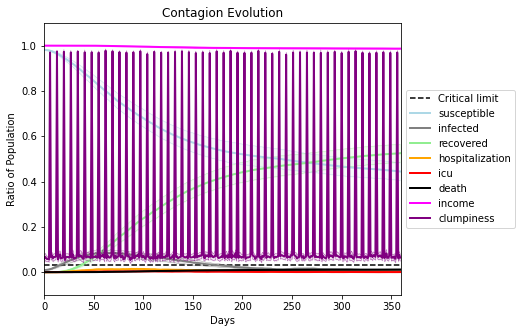

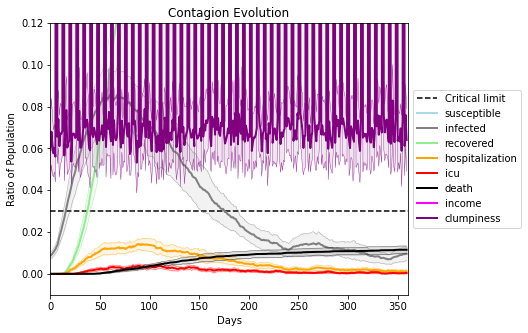

In [8]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.997
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[7373, 2364, 4255, 1177, 4591, 1131, 4241, 3179, 7493, 9639, 721, 4152, 1036, 3926, 4022, 2455, 2216, 4501, 8128, 6093]
Average similarity between family members is 0.9611850164973297 at temperature -0.996
Average similarity between family and home is 0.9998593047693739 at temperature -1
Average similarity between students and their classroom is 0.6773102744578812 at temperature -0.996
Average classroom occupancy is 4.057971014492754 and number classrooms is 69
Average similarity between workers is 0.9250048949599258 at temperature -0.996
Average office occupancy is 3.486910994764398 and number offices is 191
Average friend similarity for adults: 0.8553509235127266 for kids: 0.6949638648345766
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildin

avg restaurant similarity 0.6013577163454104
avg restaurant similarity 0.48033093704730706
avg restaurant similarity 0.42353710958624624
avg restaurant similarity 0.7922701288861436
avg restaurant similarity 0.9995860597747814
avg restaurant similarity 0.6013577163454104
avg restaurant similarity 0.7986724722031253
avg restaurant similarity 0.4941857941182071
avg restaurant similarity 0.9998632032855135
avg restaurant similarity 0.7115803625651788
avg restaurant similarity 0.26216163932794057
avg restaurant similarity 0.2373162484656784
avg restaurant similarity 0.8404320074892206
avg restaurant similarity 0.5149446529096944
avg restaurant similarity 0.4383514789896501
avg restaurant similarity 0.6013577163454104
avg restaurant similarity 0.48486284905580956
avg restaurant similarity 0.5549115187940339
avg restaurant similarity 0.49094852276947476
avg restaurant similarity 0.5202330986374333
avg restaurant similarity 0.7389362625960335
avg restaurant similarity 0.5129809585850824
avg r

avg restaurant similarity 0.40228642456212044
avg restaurant similarity 0.9092441667534423
avg restaurant similarity 0.6368300438453823
avg restaurant similarity 0.7960370480460416
avg restaurant similarity 0.9190548358536527
avg restaurant similarity 0.4980599782216752
avg restaurant similarity 0.9996272611707879
avg restaurant similarity 0.6682335351008635
avg restaurant similarity 0.9997075159136358
avg restaurant similarity 0.6170045004296268
avg restaurant similarity 0.5951844432284723
avg restaurant similarity 0.6261993524339559
avg restaurant similarity 0.9998057314505262
avg restaurant similarity 0.9998057314505262
avg restaurant similarity 0.8190297718211513
avg restaurant similarity 0.8297517802340537
avg restaurant similarity 0.8094287449270265
avg restaurant similarity 0.5026034305153524
avg restaurant similarity 0.5266297595478551
avg restaurant similarity 0.8280281689166813
avg restaurant similarity 0.4989224756517533
avg restaurant similarity 0.5563643455673561
avg resta

avg restaurant similarity 0.4072050937653956
avg restaurant similarity 0.25401564011019057
avg restaurant similarity 0.6432685964384841
avg restaurant similarity 0.589341807759748
avg restaurant similarity 0.6421131985481167
avg restaurant similarity 0.5585432174913683
avg restaurant similarity 0.6432762251584663
avg restaurant similarity 0.6645290729974427
avg restaurant similarity 0.6583028821384892
avg restaurant similarity 0.7782960167991954
avg restaurant similarity 0.4319423214194685
avg restaurant similarity 0.44031528777327994
avg restaurant similarity 0.7377579987660092
avg restaurant similarity 0.9997756268480271
avg restaurant similarity 0.5455142019228055
avg restaurant similarity 0.76505053482176
avg restaurant similarity 0.9997007596786598
avg restaurant similarity 0.25624156930846215
avg restaurant similarity 0.43553333983056736
avg restaurant similarity 0.3830947290672495
avg restaurant similarity 0.4145196040660743
avg restaurant similarity 0.760612181115595
avg restau

avg restaurant similarity 0.5808809194315406
avg restaurant similarity 0.41652631347215036
avg restaurant similarity 0.31141959084276033
avg restaurant similarity 0.8108230830867634
avg restaurant similarity 0.5024606612066779
avg restaurant similarity 0.4149419635295812
avg restaurant similarity 0.9267780021174223
avg restaurant similarity 0.4186900699586296
avg restaurant similarity 0.26620300780413475
avg restaurant similarity 0.6254473989570173
avg restaurant similarity 0.6889149878962083
avg restaurant similarity 0.9998220895291298
avg restaurant similarity 0.4973833154774944
avg restaurant similarity 0.8695760688951273
avg restaurant similarity 0.3930228507183736
avg restaurant similarity 0.8440723566469439
avg restaurant similarity 0.9997119407486161
avg restaurant similarity 0.3144804835444024
avg restaurant similarity 0.4973833154774944
avg restaurant similarity 0.3264178504734644
avg restaurant similarity 0.38587134386902683
avg restaurant similarity 0.9666978769324324
avg re

avg restaurant similarity 0.6482196958197229
avg restaurant similarity 0.712429264933897
avg restaurant similarity 0.7196924152757418
avg restaurant similarity 0.7024475419620918
avg restaurant similarity 0.7693849867942236
avg restaurant similarity 0.8039122949897373
avg restaurant similarity 0.8533547680041079
avg restaurant similarity 0.8603664863973806
avg restaurant similarity 0.7098231206120571
avg restaurant similarity 0.8512183065226817
avg restaurant similarity 0.7740141731937134
avg restaurant similarity 0.6000617715502714
avg restaurant similarity 0.509703634439739
avg restaurant similarity 0.7048164024743238
avg restaurant similarity 0.5113839718003648
avg restaurant similarity 0.7048164024743238
avg restaurant similarity 0.8381882606311843
avg restaurant similarity 0.7048164024743238
avg restaurant similarity 0.49049837939565377
avg restaurant similarity 0.7085881785574601
avg restaurant similarity 0.7048164024743238
avg restaurant similarity 0.5396929073421561
avg restaur

avg restaurant similarity 0.8122958074806594
avg restaurant similarity 0.6286096796913561
avg restaurant similarity 0.627893267163411
avg restaurant similarity 0.5079597031757934
avg restaurant similarity 0.827484206224304
avg restaurant similarity 0.6275606503075019
avg restaurant similarity 0.8916562555468062
avg restaurant similarity 0.6012993446056117
avg restaurant similarity 0.7227430937842838
avg restaurant similarity 0.6003227233284643
avg restaurant similarity 0.8478193097754698
avg restaurant similarity 0.9996736668819355
avg restaurant similarity 0.5624526630497727
avg restaurant similarity 0.6309010667272696
avg restaurant similarity 0.5644886728260647
avg restaurant similarity 0.47461399043043306
avg restaurant similarity 0.6806306093837817
avg restaurant similarity 0.5372448345539618
avg restaurant similarity 0.5839755317751578
avg restaurant similarity 0.6309010667272696
avg restaurant similarity 0.6002221929580024
avg restaurant similarity 0.4207722506791898
avg restaur

avg restaurant similarity 0.38983301047038854
avg restaurant similarity 0.4697817128570683
avg restaurant similarity 0.2571642600116091
avg restaurant similarity 0.9998672903581436
avg restaurant similarity 0.7054350585236524
avg restaurant similarity 0.7977353412184187
Average similarity between family members is 0.9542448148258008 at temperature -0.996
Average similarity between family and home is 0.9998517137241849 at temperature -1
Average similarity between students and their classroom is 0.6435349248464053 at temperature -0.996
Average classroom occupancy is 3.681159420289855 and number classrooms is 69
Average similarity between workers is 0.9287110577123389 at temperature -0.996
Average office occupancy is 3.6455026455026456 and number offices is 189
Average friend similarity for adults: 0.8620986626697955 for kids: 0.6866747904163357
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a t

avg restaurant similarity 0.7133741908394144
avg restaurant similarity 0.27334069861605204
avg restaurant similarity 0.4255277804967834
avg restaurant similarity 0.4600618486725898
avg restaurant similarity 0.28813957211721175
avg restaurant similarity 0.6271764456888242
avg restaurant similarity 0.8042750355466637
avg restaurant similarity 0.3148718246951662
avg restaurant similarity 0.2427383358855748
avg restaurant similarity 0.5507944272257881
avg restaurant similarity 0.9997174317416009
avg restaurant similarity 0.5956048511913887
avg restaurant similarity 0.38172094601239964
avg restaurant similarity 0.40476244051056776
avg restaurant similarity 0.5515894764221967
avg restaurant similarity 0.4731446252084287
avg restaurant similarity 0.3882505952884474
avg restaurant similarity 0.8578342208771847
avg restaurant similarity 0.999914823794418
avg restaurant similarity 0.4285872900688993
avg restaurant similarity 0.37421677168507034
avg restaurant similarity 0.33328784170396386
avg r

avg restaurant similarity 0.7035760987151801
avg restaurant similarity 0.577040496338133
avg restaurant similarity 0.5176180082098829
avg restaurant similarity 0.9621675430307428
avg restaurant similarity 0.5755168655140369
avg restaurant similarity 0.6159538572577151
avg restaurant similarity 0.5615064641082579
avg restaurant similarity 0.5679494161216208
avg restaurant similarity 0.8596614053285057
avg restaurant similarity 0.873584167740461
avg restaurant similarity 0.4952013272535798
avg restaurant similarity 0.5285085960794333
avg restaurant similarity 0.7843740765148599
avg restaurant similarity 0.29272312545761364
avg restaurant similarity 0.8642625487142479
avg restaurant similarity 0.289265754716053
avg restaurant similarity 0.492240325821112
avg restaurant similarity 0.4401103186506966
avg restaurant similarity 0.4104341830155798
avg restaurant similarity 0.668986704624004
avg restaurant similarity 0.5103124503535755
avg restaurant similarity 0.6232957360122809
avg restaurant

avg restaurant similarity 0.7467869406310679
avg restaurant similarity 0.4943986488563908
avg restaurant similarity 0.8511441720100483
avg restaurant similarity 0.85134040809495
avg restaurant similarity 0.5055716384039725
avg restaurant similarity 0.569748413796126
avg restaurant similarity 0.627918166750339
avg restaurant similarity 0.9997982645048857
avg restaurant similarity 0.49679791646672267
avg restaurant similarity 0.5530952708145427
avg restaurant similarity 0.5050139019218253
avg restaurant similarity 0.5659863135282038
avg restaurant similarity 0.8302205264073097
avg restaurant similarity 0.5610534238140813
avg restaurant similarity 0.45029602698029625
avg restaurant similarity 0.49062326716543736
avg restaurant similarity 0.68119142124009
avg restaurant similarity 0.8854801443486076
avg restaurant similarity 0.6782128537585801
avg restaurant similarity 0.461422323330156
avg restaurant similarity 0.8286331744045646
avg restaurant similarity 0.49062326716543736
avg restauran

avg restaurant similarity 0.6628448865834086
avg restaurant similarity 0.7373810269666539
avg restaurant similarity 0.6458395574061002
avg restaurant similarity 0.8414762565456537
avg restaurant similarity 0.6689154539590296
avg restaurant similarity 0.5761209722555054
avg restaurant similarity 0.7373810269666539
avg restaurant similarity 0.4262970525123744
avg restaurant similarity 0.6432815635277378
avg restaurant similarity 0.9163908156399779
avg restaurant similarity 0.7039549408836195
avg restaurant similarity 0.6335237901906687
avg restaurant similarity 0.5381028039623283
avg restaurant similarity 0.6977274309903073
avg restaurant similarity 0.999398398757769
avg restaurant similarity 0.8332598709809104
avg restaurant similarity 0.6643285209472913
avg restaurant similarity 0.6274152014601903
avg restaurant similarity 0.828788710253543
avg restaurant similarity 0.4326541152168698
avg restaurant similarity 0.8927540163033789
avg restaurant similarity 0.7373810269666539
avg restaura

avg restaurant similarity 0.8325806862815948
avg restaurant similarity 0.9154891414744886
avg restaurant similarity 0.8340024392016003
avg restaurant similarity 0.5662045556590325
avg restaurant similarity 0.7158881404324522
avg restaurant similarity 0.8202046231869151
avg restaurant similarity 0.6013103743416217
avg restaurant similarity 0.6395961763278704
avg restaurant similarity 0.5518728446585992
avg restaurant similarity 0.45945318744544617
avg restaurant similarity 0.7564208445052991
avg restaurant similarity 0.37602121420087264
avg restaurant similarity 0.705788719021621
avg restaurant similarity 0.44112382755574686
avg restaurant similarity 0.7081133444531094
avg restaurant similarity 0.44772301049686625
avg restaurant similarity 0.40766804463190465
avg restaurant similarity 0.8201496497415202
avg restaurant similarity 0.7564208445052991
avg restaurant similarity 0.5980917028281363
avg restaurant similarity 0.7828922653122934
avg restaurant similarity 0.5983118015899209
avg re

avg restaurant similarity 0.7253161409602217
avg restaurant similarity 0.6509720474489499
avg restaurant similarity 0.39808386759070885
avg restaurant similarity 0.31841919662576224
avg restaurant similarity 0.539339520299146
avg restaurant similarity 0.5897463566463688
avg restaurant similarity 0.6304647262603986
avg restaurant similarity 0.5999998486212365
avg restaurant similarity 0.5168817483622687
avg restaurant similarity 0.6720894569178008
avg restaurant similarity 0.4382219342358808
avg restaurant similarity 0.4603524413904154
avg restaurant similarity 0.30271555423508967
avg restaurant similarity 0.6123956206167209
avg restaurant similarity 0.5610955613502819
avg restaurant similarity 0.4959290722283547
avg restaurant similarity 0.6304647262603986
avg restaurant similarity 0.5861594355530164
avg restaurant similarity 0.5918233395818476
avg restaurant similarity 0.8228190234635481
avg restaurant similarity 0.42388821921096603
avg restaurant similarity 0.836016493485022
avg rest

avg restaurant similarity 0.6381413919048395
avg restaurant similarity 0.8644245657977108
avg restaurant similarity 0.5975556279553251
avg restaurant similarity 0.6084152482396921
avg restaurant similarity 0.5110691963689263
avg restaurant similarity 0.8653348056060994
avg restaurant similarity 0.9997906871982827
avg restaurant similarity 0.7742109366869572
avg restaurant similarity 0.7186726823620807
avg restaurant similarity 0.7731922871701691
avg restaurant similarity 0.7632051220019016
avg restaurant similarity 0.8826468777508589
avg restaurant similarity 0.5726422877541265
avg restaurant similarity 0.8932921984513418
avg restaurant similarity 0.752312707939045
avg restaurant similarity 0.9008858932291735
avg restaurant similarity 0.7747042088859939
avg restaurant similarity 0.44287795344416836
avg restaurant similarity 0.8838966538814501
avg restaurant similarity 0.8646591584482011
avg restaurant similarity 0.9995928508760183
avg restaurant similarity 0.9994784932438168
avg restau

avg restaurant similarity 0.583201950669274
avg restaurant similarity 0.4609750326987354
avg restaurant similarity 0.7185457075958163
avg restaurant similarity 0.9998134691202514
avg restaurant similarity 0.5463712459241461
avg restaurant similarity 0.48272487785659585
avg restaurant similarity 0.5730504180581117
avg restaurant similarity 0.8298214373581436
avg restaurant similarity 0.6893315510146535
avg restaurant similarity 0.7230375726980347
avg restaurant similarity 0.5753506032514143
avg restaurant similarity 0.5504351391864224
avg restaurant similarity 0.28665217818212313
avg restaurant similarity 0.6465177305676203
avg restaurant similarity 0.40842571859711774
avg restaurant similarity 0.7868248706291643
avg restaurant similarity 0.8591252455004728
avg restaurant similarity 0.7675552584334596
avg restaurant similarity 0.5734277751885481
avg restaurant similarity 0.6202807761630245
avg restaurant similarity 0.7211705608524943
avg restaurant similarity 0.9997427184074573
avg rest

avg restaurant similarity 0.38248992180914143
avg restaurant similarity 0.44597247284696967
avg restaurant similarity 0.5104555597385263
avg restaurant similarity 0.1093651213102294
avg restaurant similarity 0.4649247666342714
avg restaurant similarity 0.4724075969915813
avg restaurant similarity 0.6542135374852541
avg restaurant similarity 0.4564161012135248
avg restaurant similarity 0.8763277796409354
avg restaurant similarity 0.5064047690032925
avg restaurant similarity 0.878937190954475
avg restaurant similarity 0.5284188032966246
avg restaurant similarity 0.3452767863503778
avg restaurant similarity 0.6960973091998999
avg restaurant similarity 0.4544772856386595
avg restaurant similarity 0.5817315750746466
avg restaurant similarity 0.39229556884002315
avg restaurant similarity 0.49449348408192706
avg restaurant similarity 0.6535463529711982
avg restaurant similarity 0.42384006189822593
avg restaurant similarity 0.4522265598530012
avg restaurant similarity 0.7074382719913298
avg re

avg restaurant similarity 0.5691491406341616
avg restaurant similarity 0.8183259920952768
avg restaurant similarity 0.8412800726840648
avg restaurant similarity 0.6453269337020259
avg restaurant similarity 0.7882099845310698
avg restaurant similarity 0.5955637716681135
avg restaurant similarity 0.511989477849453
avg restaurant similarity 0.7021186738197084
avg restaurant similarity 0.6225878389240422
avg restaurant similarity 0.5327551398195804
avg restaurant similarity 0.6014922826573433
avg restaurant similarity 0.4675408457467184
avg restaurant similarity 0.4986324620989877
avg restaurant similarity 0.843068842957506
avg restaurant similarity 0.5229669990417252
avg restaurant similarity 0.5162753590228972
avg restaurant similarity 0.6476388273025566
avg restaurant similarity 0.7296889277096978
avg restaurant similarity 0.9998462699787596
avg restaurant similarity 0.5805239789434775
avg restaurant similarity 0.7418555981881519
avg restaurant similarity 0.5638610883043427
avg restaura

avg restaurant similarity 0.5223889832327222
avg restaurant similarity 0.8468313034166572
avg restaurant similarity 0.6243510179748941
avg restaurant similarity 0.5313478145081627
avg restaurant similarity 0.5724699947822535
avg restaurant similarity 0.43377540964910166
avg restaurant similarity 0.9994288497793591
avg restaurant similarity 0.41874694147726577
avg restaurant similarity 0.4848294077418954
avg restaurant similarity 0.6407501060514001
avg restaurant similarity 0.4321074740286156
avg restaurant similarity 0.47325266083014994
avg restaurant similarity 0.4680795810190802
avg restaurant similarity 0.47946717246810383
avg restaurant similarity 0.2977613433521116
avg restaurant similarity 0.5026705191685585
avg restaurant similarity 0.43190273287107156
avg restaurant similarity 0.5792925206419798
avg restaurant similarity 0.49886691707626163
avg restaurant similarity 0.6340847476163125
avg restaurant similarity 0.6290922459674508
avg restaurant similarity 0.5792925206419798
avg 

avg restaurant similarity 0.6137711823184072
avg restaurant similarity 0.6334446132734202
avg restaurant similarity 0.47950911493818604
avg restaurant similarity 0.6966535701508181
avg restaurant similarity 0.6028942646370647
avg restaurant similarity 0.7165289062569269
avg restaurant similarity 0.29329133658661083
avg restaurant similarity 0.5151649131640601
avg restaurant similarity 0.8821540548723696
avg restaurant similarity 0.539752612926749
avg restaurant similarity 0.5473948402142713
avg restaurant similarity 0.4688823907255362
avg restaurant similarity 0.4739278222023388
avg restaurant similarity 0.7155425457913538
avg restaurant similarity 0.6221311817157567
avg restaurant similarity 0.39047356473982126
avg restaurant similarity 0.5415473372798816
avg restaurant similarity 0.4770220353895751
avg restaurant similarity 0.6869156192138294
avg restaurant similarity 0.5233754547155127
avg restaurant similarity 0.99971067203717
avg restaurant similarity 0.4445687607859615
avg restau

avg restaurant similarity 0.8589488244830478
avg restaurant similarity 0.7808875526271396
avg restaurant similarity 0.532034579838023
avg restaurant similarity 0.5517194200148572
avg restaurant similarity 0.5132548757554846
avg restaurant similarity 0.37137424989175577
avg restaurant similarity 0.5663263870651958
avg restaurant similarity 0.5343408370172311
avg restaurant similarity 0.5644115466622063
avg restaurant similarity 0.8841778621392463
avg restaurant similarity 0.5496092414554224
avg restaurant similarity 0.6337729578048499
avg restaurant similarity 0.5639582581103572
avg restaurant similarity 0.5594523465645249
avg restaurant similarity 0.7996400599720892
avg restaurant similarity 0.5652172246529831
avg restaurant similarity 0.4238329929666832
avg restaurant similarity 0.5294705535127553
avg restaurant similarity 0.9997739124725415
avg restaurant similarity 0.5670639797436567
avg restaurant similarity 0.5391670040935903
avg restaurant similarity 0.5012280136556759
avg restau

avg restaurant similarity 0.6535416241830285
avg restaurant similarity 0.5745966123200853
avg restaurant similarity 0.5166905798037521
avg restaurant similarity 0.8107663012197632
avg restaurant similarity 0.5829515826276204
avg restaurant similarity 0.5656876129687173
avg restaurant similarity 0.6714394233536637
avg restaurant similarity 0.8027899985593417
avg restaurant similarity 0.9998870434036264
avg restaurant similarity 0.676789679585474
avg restaurant similarity 0.49568779395694995
avg restaurant similarity 0.6515425103468285
avg restaurant similarity 0.8265604035840666
avg restaurant similarity 0.6221854825060158
avg restaurant similarity 0.5034751231971463
avg restaurant similarity 0.49928737001826284
avg restaurant similarity 0.572404917030997
avg restaurant similarity 0.572404917030997
avg restaurant similarity 0.6680034979137128
avg restaurant similarity 0.5698388294169581
avg restaurant similarity 0.6379228743433418
avg restaurant similarity 0.6876338527982533
avg restaur

(<function dict.items>, <function dict.items>, <function dict.items>)

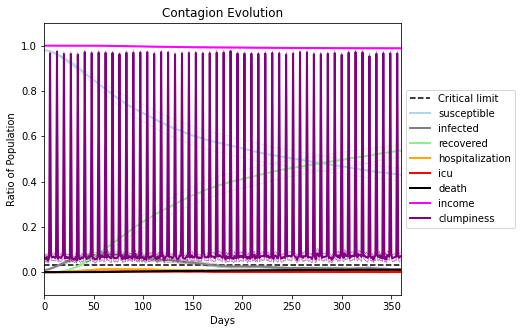

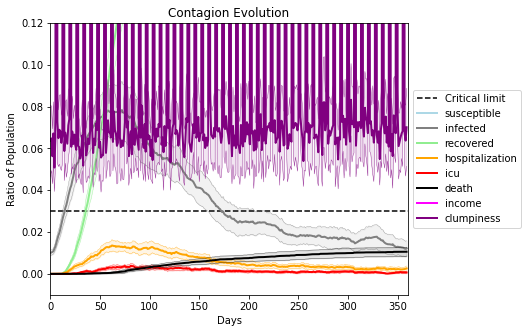

In [9]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.996
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[3992, 590, 9454, 4874, 5475, 6677, 7435, 8808, 1497, 778, 1751, 3328, 3019, 4640, 1499, 8771, 8315, 8017, 5748, 1728]
Average similarity between family members is 0.9352489434392485 at temperature -0.995
Average similarity between family and home is 0.9998407324397172 at temperature -1
Average similarity between students and their classroom is 0.59803530924274 at temperature -0.995
Average classroom occupancy is 4.271428571428571 and number classrooms is 70
Average similarity between workers is 0.8925315910461581 at temperature -0.995
Average office occupancy is 3.2944162436548226 and number offices is 197
Average friend similarity for adults: 0.8554002536895369 for kids: 0.7016873007205934
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
H

avg restaurant similarity 0.8252995080018728
avg restaurant similarity 0.6575255022909088
avg restaurant similarity 0.5766704202495113
avg restaurant similarity 0.28734659774826143
avg restaurant similarity 0.545236852338528
avg restaurant similarity 0.4997980322935872
avg restaurant similarity 0.4648678785464436
avg restaurant similarity 0.2386146072535906
avg restaurant similarity 0.8283956687277967
avg restaurant similarity 0.6582395537437689
avg restaurant similarity 0.5040819591943667
avg restaurant similarity 0.6746750793136281
avg restaurant similarity 0.4779154521666942
avg restaurant similarity 0.8283956687277967
avg restaurant similarity 0.44714254971036316
avg restaurant similarity 0.47969621906346316
avg restaurant similarity 0.466791644296032
avg restaurant similarity 0.9998806695231448
avg restaurant similarity 0.6582395537437689
avg restaurant similarity 0.6172222794580026
avg restaurant similarity 0.7765192729223137
avg restaurant similarity 0.6545964401035367
avg resta

avg restaurant similarity 0.6842769252026775
avg restaurant similarity 0.36213546631982557
avg restaurant similarity 0.9316033094336894
avg restaurant similarity 0.49718569293467263
avg restaurant similarity 0.6369526388861831
avg restaurant similarity 0.5463843739130299
avg restaurant similarity 0.3858930295328275
avg restaurant similarity 0.5869581829986026
avg restaurant similarity 0.4969400794083692
avg restaurant similarity 0.2853116184438514
avg restaurant similarity 0.6862831716274246
avg restaurant similarity 0.46177227558550227
avg restaurant similarity 0.4716105008162847
avg restaurant similarity 0.38605524119044365
avg restaurant similarity 0.6157205078854631
avg restaurant similarity 0.45871386583555585
avg restaurant similarity 0.4426289450865
avg restaurant similarity 0.46045534977011904
avg restaurant similarity 0.9995786184829736
avg restaurant similarity 0.5073376932448973
avg restaurant similarity 0.4812662482963184
avg restaurant similarity 0.3912653275252994
avg res

avg restaurant similarity 0.7381317514803172
avg restaurant similarity 0.6345048177206012
avg restaurant similarity 0.9997991803362831
avg restaurant similarity 0.8126966547444672
avg restaurant similarity 0.5858416421131113
avg restaurant similarity 0.8405277783103007
avg restaurant similarity 0.35749092166234875
avg restaurant similarity 0.6130121982197665
avg restaurant similarity 0.50632357552184
avg restaurant similarity 0.45681120181348017
avg restaurant similarity 0.33645804351548736
avg restaurant similarity 0.36474790306646465
avg restaurant similarity 0.20048862842391854
avg restaurant similarity 0.6345048177206012
avg restaurant similarity 0.6153675739192243
avg restaurant similarity 0.7225246191745538
avg restaurant similarity 0.9997991803362831
avg restaurant similarity 0.48323576952376757
avg restaurant similarity 0.6004967981376736
avg restaurant similarity 0.5731610951233574
avg restaurant similarity 0.3087032598562871
avg restaurant similarity 0.4615313189275333
avg re

avg restaurant similarity 0.4660563637245289
avg restaurant similarity 0.806190037646287
avg restaurant similarity 0.81569406083417
avg restaurant similarity 0.34461087042142313
avg restaurant similarity 0.4192956786936356
avg restaurant similarity 0.9013712956933453
avg restaurant similarity 0.44727879806792403
avg restaurant similarity 0.8157203012094345
avg restaurant similarity 0.7297588597826075
avg restaurant similarity 0.6493762178850695
avg restaurant similarity 0.7048523880202917
avg restaurant similarity 0.49345769488242897
avg restaurant similarity 0.3555925848268221
avg restaurant similarity 0.579418681324481
avg restaurant similarity 0.6244002900431473
avg restaurant similarity 0.4838088157731703
avg restaurant similarity 0.81569406083417
avg restaurant similarity 0.6327193415985533
avg restaurant similarity 0.4525825443560363
avg restaurant similarity 0.634355043307153
avg restaurant similarity 0.4712450940480541
avg restaurant similarity 0.5117922988717682
avg restaurant

avg restaurant similarity 0.37123274206958845
avg restaurant similarity 0.3842360417992263
avg restaurant similarity 0.3676578452384806
avg restaurant similarity 0.5883070238033845
avg restaurant similarity 0.8381293576079224
avg restaurant similarity 0.49600336639395576
avg restaurant similarity 0.5051787029329898
avg restaurant similarity 0.6173323910286411
avg restaurant similarity 0.8454495901052086
avg restaurant similarity 0.2274099024371119
avg restaurant similarity 0.5622267173294204
avg restaurant similarity 0.6258151175833992
avg restaurant similarity 0.9538206046622602
avg restaurant similarity 0.8853365861002919
avg restaurant similarity 0.8170228310949029
avg restaurant similarity 0.7575787301484107
avg restaurant similarity 0.4155914739180694
avg restaurant similarity 0.5897383415618529
avg restaurant similarity 0.3073154361082454
avg restaurant similarity 0.2274099024371119
avg restaurant similarity 0.8868900940232166
avg restaurant similarity 0.9997643535146178
avg rest

avg restaurant similarity 0.5586244923576197
avg restaurant similarity 0.7914322260731453
avg restaurant similarity 0.7036359126709629
avg restaurant similarity 0.6327399858727004
avg restaurant similarity 0.6224737077905536
avg restaurant similarity 0.3275579131118646
avg restaurant similarity 0.886636937782259
avg restaurant similarity 0.5417637285684955
avg restaurant similarity 0.5608380007506847
avg restaurant similarity 0.6356748052028722
avg restaurant similarity 0.6517162863841646
avg restaurant similarity 0.9115823160641537
avg restaurant similarity 0.9996264138079339
avg restaurant similarity 0.4619837546871038
avg restaurant similarity 0.7137263601466777
avg restaurant similarity 0.5844349146554311
avg restaurant similarity 0.5380013714592876
avg restaurant similarity 0.18397382230683032
avg restaurant similarity 0.7944220291229205
avg restaurant similarity 0.3275579131118646
avg restaurant similarity 0.7141789917177228
avg restaurant similarity 0.49855235393732594
avg resta

avg restaurant similarity 0.5353756922225561
avg restaurant similarity 0.8418492349311653
avg restaurant similarity 0.9994049305064665
avg restaurant similarity 0.9997483611036764
avg restaurant similarity 0.477829040287427
avg restaurant similarity 0.4958954897424255
avg restaurant similarity 0.5930897215222612
avg restaurant similarity 0.3285504026289716
avg restaurant similarity 0.7455534783764239
avg restaurant similarity 0.4269129602109597
avg restaurant similarity 0.5375229942625233
avg restaurant similarity 0.5039356155253093
avg restaurant similarity 0.7682224487895994
avg restaurant similarity 0.7945622166900466
avg restaurant similarity 0.5072243745797211
avg restaurant similarity 0.38662440070029946
avg restaurant similarity 0.44766854724707766
avg restaurant similarity 0.7988952731112062
avg restaurant similarity 0.8434305263426278
avg restaurant similarity 0.8893856348206173
avg restaurant similarity 0.3249058251038296
avg restaurant similarity 0.6891061785462149
avg resta

avg restaurant similarity 0.5774315718330436
avg restaurant similarity 0.5772027200260055
avg restaurant similarity 0.5606750170831223
avg restaurant similarity 0.6356522340008728
avg restaurant similarity 0.5650290829337835
avg restaurant similarity 0.3434502169438771
avg restaurant similarity 0.7803055035307631
avg restaurant similarity 0.5992861291414514
avg restaurant similarity 0.7075987183201988
avg restaurant similarity 0.6429067994078722
avg restaurant similarity 0.7384347122846255
avg restaurant similarity 0.5181966602056881
avg restaurant similarity 0.5829771068256347
avg restaurant similarity 0.5307029417497524
avg restaurant similarity 0.40277815993870314
avg restaurant similarity 0.6364027369989897
avg restaurant similarity 0.5307029417497524
avg restaurant similarity 0.8051640561361388
avg restaurant similarity 0.6123099897669063
avg restaurant similarity 0.6364027369989897
avg restaurant similarity 0.5845604939966502
avg restaurant similarity 0.43794440330040796
avg rest

avg restaurant similarity 0.5978203187494444
avg restaurant similarity 0.471373258672323
avg restaurant similarity 0.5450198155630829
avg restaurant similarity 0.679352485678961
avg restaurant similarity 0.6733686524771281
avg restaurant similarity 0.7548645966235438
avg restaurant similarity 0.6434877303089699
avg restaurant similarity 0.49264522217543627
avg restaurant similarity 0.7863997719629349
avg restaurant similarity 0.3587373320020068
avg restaurant similarity 0.6223018174047888
avg restaurant similarity 0.45131202612469484
avg restaurant similarity 0.9994290433789002
avg restaurant similarity 0.7969118176403273
avg restaurant similarity 0.45557041525373954
avg restaurant similarity 0.8420642074484664
avg restaurant similarity 0.28589702241895887
avg restaurant similarity 0.6973038582462767
avg restaurant similarity 0.9095264978130083
avg restaurant similarity 0.7390021774968099
avg restaurant similarity 0.4814696347233099
avg restaurant similarity 0.5462024771735414
avg rest

avg restaurant similarity 0.47533991475030657
avg restaurant similarity 0.345137749122502
avg restaurant similarity 0.8518576754424264
avg restaurant similarity 0.2992977540657855
avg restaurant similarity 0.6310677374734437
avg restaurant similarity 0.8358101581267763
avg restaurant similarity 0.42836377721131447
avg restaurant similarity 0.9255279398932021
avg restaurant similarity 0.1987281054814527
avg restaurant similarity 0.5027811028332653
avg restaurant similarity 0.44816629071122815
avg restaurant similarity 0.4037078660373287
avg restaurant similarity 0.8512221313485345
avg restaurant similarity 0.6690448751031657
avg restaurant similarity 0.8564855378675194
avg restaurant similarity 0.4712857337903872
avg restaurant similarity 0.558645424692126
avg restaurant similarity 0.37505332896588217
avg restaurant similarity 0.8468639564393681
avg restaurant similarity 0.5228035147229907
avg restaurant similarity 0.42859846481447955
avg restaurant similarity 0.2056264614640991
avg res

avg restaurant similarity 0.6393770149384296
avg restaurant similarity 0.5352366808272471
avg restaurant similarity 0.8347378665642118
avg restaurant similarity 0.4673236880557714
avg restaurant similarity 0.5530041506164548
avg restaurant similarity 0.557816849662939
avg restaurant similarity 0.40458619192076056
avg restaurant similarity 0.9252015615950675
avg restaurant similarity 0.881935541964188
avg restaurant similarity 0.4011371370723083
avg restaurant similarity 0.2318141947597038
avg restaurant similarity 0.4678586070327808
avg restaurant similarity 0.5150571780344433
avg restaurant similarity 0.6056356941072244
avg restaurant similarity 0.6858844720964473
avg restaurant similarity 0.800753647079221
avg restaurant similarity 0.3585301667226849
avg restaurant similarity 0.5593217767227787
avg restaurant similarity 0.8611950993159412
avg restaurant similarity 0.9996867948441829
avg restaurant similarity 0.8141871971827355
avg restaurant similarity 0.9997094358947562
avg restaura

avg restaurant similarity 0.661509294793176
avg restaurant similarity 0.5055122229849943
avg restaurant similarity 0.4880888861578908
avg restaurant similarity 0.8537946500412891
avg restaurant similarity 0.6238512919171382
avg restaurant similarity 0.5410786596981851
avg restaurant similarity 0.5537234333950519
avg restaurant similarity 0.41848580750994346
avg restaurant similarity 0.4895824261564264
avg restaurant similarity 0.553066822520335
avg restaurant similarity 0.49044188546628836
avg restaurant similarity 0.43676010397910714
avg restaurant similarity 0.4111201193907543
avg restaurant similarity 0.41792781710206145
avg restaurant similarity 0.18574889493603206
avg restaurant similarity 0.9997547484198757
avg restaurant similarity 0.5010175950552697
avg restaurant similarity 0.5056179072369313
avg restaurant similarity 0.2037371418474598
avg restaurant similarity 0.5016032148609303
avg restaurant similarity 0.3444199551572407
avg restaurant similarity 0.4445926650339095
avg res

avg restaurant similarity 0.727818306200948
avg restaurant similarity 0.39703198973244636
avg restaurant similarity 0.999660512272754
avg restaurant similarity 0.6847130979595926
avg restaurant similarity 0.8460532980807676
avg restaurant similarity 0.6689638218035632
avg restaurant similarity 0.8010543762066535
avg restaurant similarity 0.8446964176853567
avg restaurant similarity 0.2757908056865808
avg restaurant similarity 0.8436983830879906
avg restaurant similarity 0.7718227636853237
avg restaurant similarity 0.6455982705683956
avg restaurant similarity 0.6615061115935443
avg restaurant similarity 0.6139847120570322
avg restaurant similarity 0.9489172140693267
avg restaurant similarity 0.2823014001958785
avg restaurant similarity 0.8349169383426905
avg restaurant similarity 0.4579482982354937
avg restaurant similarity 0.7217104817529338
avg restaurant similarity 0.392687202738089
avg restaurant similarity 0.3668720360492306
avg restaurant similarity 0.8360891219621032
avg restaura

avg restaurant similarity 0.7459828156780588
avg restaurant similarity 0.6071777002974699
avg restaurant similarity 0.4662169828583934
avg restaurant similarity 0.4511468732015345
avg restaurant similarity 0.5937657004914705
avg restaurant similarity 0.42962282599057133
avg restaurant similarity 0.7680759967344885
avg restaurant similarity 0.7493578352206347
avg restaurant similarity 0.7907364766722006
avg restaurant similarity 0.416573426219253
avg restaurant similarity 0.5888531608665457
avg restaurant similarity 0.5191087063980524
avg restaurant similarity 0.5060282428291234
avg restaurant similarity 0.26141470213185597
avg restaurant similarity 0.38490268299484953
avg restaurant similarity 0.5116005909076207
avg restaurant similarity 0.883665960159616
avg restaurant similarity 0.220350615834339
avg restaurant similarity 0.7737333532542555
avg restaurant similarity 0.5398835756190771
avg restaurant similarity 0.46378570790477913
avg restaurant similarity 0.48276837033851866
avg rest

avg restaurant similarity 0.49459784489080005
avg restaurant similarity 0.4330602921664263
avg restaurant similarity 0.49805222761586465
avg restaurant similarity 0.6384781708753313
avg restaurant similarity 0.5350961060175422
avg restaurant similarity 0.4254341090910218
avg restaurant similarity 0.6365686412307621
avg restaurant similarity 0.9996228890953389
avg restaurant similarity 0.3819590242083353
Average similarity between family members is 0.9438112992686548 at temperature -0.995
Average similarity between family and home is 0.9998479305973422 at temperature -1
Average similarity between students and their classroom is 0.5839181821954621 at temperature -0.995
Average classroom occupancy is 4.115942028985507 and number classrooms is 69
Average similarity between workers is 0.8976694188819362 at temperature -0.995
Average office occupancy is 3.308457711442786 and number offices is 201
Average friend similarity for adults: 0.8553162096260379 for kids: 0.6967669840547607
home_distr

avg restaurant similarity 0.635511101040963
avg restaurant similarity 0.6477874999444997
avg restaurant similarity 0.6712324775828545
avg restaurant similarity 0.6395330313989049
avg restaurant similarity 0.5418574654480142
avg restaurant similarity 0.6827401077231419
avg restaurant similarity 0.43483808187650363
avg restaurant similarity 0.6612940711435822
avg restaurant similarity 0.3982464627602505
avg restaurant similarity 0.5431666730373553
avg restaurant similarity 0.5337694659032156
avg restaurant similarity 0.5850863686540584
avg restaurant similarity 0.5275901918259858
avg restaurant similarity 0.47092530535597016
avg restaurant similarity 0.37717983670755606
avg restaurant similarity 0.6473202408875222
avg restaurant similarity 0.473340325873679
avg restaurant similarity 0.47092530535597016
avg restaurant similarity 0.3986602346255585
avg restaurant similarity 0.9381359293799636
avg restaurant similarity 0.5092501342942402
avg restaurant similarity 0.5908473741286538
avg rest

avg restaurant similarity 0.7199894211512144
avg restaurant similarity 0.693115080633922
avg restaurant similarity 0.5044239363517634
avg restaurant similarity 0.9998220957485469
avg restaurant similarity 0.6231156047531486
avg restaurant similarity 0.8207511389902016
avg restaurant similarity 0.5733911481819836
avg restaurant similarity 0.5031535857378007
avg restaurant similarity 0.9997357667348692
avg restaurant similarity 0.4562772091269752
avg restaurant similarity 0.9998576433506854
avg restaurant similarity 0.42431465228095744
avg restaurant similarity 0.7000163492493428
avg restaurant similarity 0.6306395514035189
avg restaurant similarity 0.8368173724267425
avg restaurant similarity 0.6410548300262664
avg restaurant similarity 0.5424243907126794
avg restaurant similarity 0.5546507268625039
avg restaurant similarity 0.6436836765607279
avg restaurant similarity 0.8051046842061123
avg restaurant similarity 0.35523646835539235
avg restaurant similarity 0.2989809337074778
avg resta

avg restaurant similarity 0.8208537107401237
Average similarity between family members is 0.9386400580414289 at temperature -0.995
Average similarity between family and home is 0.9998497557460926 at temperature -1
Average similarity between students and their classroom is 0.5966415064772619 at temperature -0.995
Average classroom occupancy is 4.522388059701493 and number classrooms is 67
Average similarity between workers is 0.8778723222648873 at temperature -0.995
Average office occupancy is 3.301507537688442 and number offices is 199
Average friend similarity for adults: 0.8393518340735372 for kids: 0.683159664348774
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 

avg restaurant similarity 0.613384923983306
avg restaurant similarity 0.7498490168953611
avg restaurant similarity 0.3585525691149544
avg restaurant similarity 0.3251396390966498
avg restaurant similarity 0.42561861802573775
avg restaurant similarity 0.4462011766928135
avg restaurant similarity 0.6540583189319228
avg restaurant similarity 0.4199607003332141
avg restaurant similarity 0.9229122144488513
avg restaurant similarity 0.38336710939756324
avg restaurant similarity 0.5175611548639656
avg restaurant similarity 0.48438929695263505
avg restaurant similarity 0.2645605835063882
avg restaurant similarity 0.4918771118690258
avg restaurant similarity 0.6085512833687909
avg restaurant similarity 0.6918170516952376
avg restaurant similarity 0.5275334508243847
avg restaurant similarity 0.6116854147099426
avg restaurant similarity 0.3656211047754466
avg restaurant similarity 0.3708716311546743
avg restaurant similarity 0.9997405243563496
avg restaurant similarity 0.44843125476767737
avg res

avg restaurant similarity 0.8707857759225012
avg restaurant similarity 0.4840335628585639
avg restaurant similarity 0.6987519767343047
avg restaurant similarity 0.28187447134884935
avg restaurant similarity 0.4865788412881465
avg restaurant similarity 0.5847361795595079
avg restaurant similarity 0.44036829756054524
avg restaurant similarity 0.5523942563267101
avg restaurant similarity 0.5319094778648706
avg restaurant similarity 0.5523942563267101
avg restaurant similarity 0.5523942563267101
avg restaurant similarity 0.7238570529365713
avg restaurant similarity 0.505630000585382
avg restaurant similarity 0.5523942563267101
avg restaurant similarity 0.7092902025397742
avg restaurant similarity 0.6856748887344994
avg restaurant similarity 0.4699645602994666
avg restaurant similarity 0.4069297677948489
avg restaurant similarity 0.7044784706962748
avg restaurant similarity 0.693586381225325
avg restaurant similarity 0.5483916344478148
avg restaurant similarity 0.45198660208913716
avg resta

avg restaurant similarity 0.6696218700861699
avg restaurant similarity 0.4642220380255756
avg restaurant similarity 0.6426973162957416
avg restaurant similarity 0.7001974955293979
avg restaurant similarity 0.3517441476425721
avg restaurant similarity 0.6345976298683379
avg restaurant similarity 0.9998370902869798
avg restaurant similarity 0.4828440251108545
avg restaurant similarity 0.5728151318264736
avg restaurant similarity 0.6726231140700524
avg restaurant similarity 0.4233026082682846
avg restaurant similarity 0.4394956243194892
avg restaurant similarity 0.5241936561760541
avg restaurant similarity 0.6781220789743809
avg restaurant similarity 0.6447561337212486
avg restaurant similarity 0.491565459813889
avg restaurant similarity 0.646836704898517
avg restaurant similarity 0.47682134815113775
avg restaurant similarity 0.4212584542296457
avg restaurant similarity 0.75132703560338
avg restaurant similarity 0.5821671518602165
avg restaurant similarity 0.5536007854499629
avg restauran

avg restaurant similarity 0.5845317029194905
avg restaurant similarity 0.8050730071114152
avg restaurant similarity 0.6483086828617394
avg restaurant similarity 0.8558803674217943
avg restaurant similarity 0.47645196462846373
avg restaurant similarity 0.4343338040133322
avg restaurant similarity 0.8560753017399845
avg restaurant similarity 0.7393395952397164
avg restaurant similarity 0.7925031127234838
avg restaurant similarity 0.7472854970709941
avg restaurant similarity 0.41391168850569665
avg restaurant similarity 0.6907354786598445
avg restaurant similarity 0.6562128878678286
avg restaurant similarity 0.6456676487928106
avg restaurant similarity 0.5190776812519503
avg restaurant similarity 0.7114823042177486
avg restaurant similarity 0.4992499331026072
avg restaurant similarity 0.7031262706543493
avg restaurant similarity 0.6676476099775606
avg restaurant similarity 0.5674105550739477
avg restaurant similarity 0.9996450276996941
avg restaurant similarity 0.5920100255529939
avg rest

avg restaurant similarity 0.8038922468145495
avg restaurant similarity 0.48429859611318915
avg restaurant similarity 0.42980832903301336
avg restaurant similarity 0.544434819601209
avg restaurant similarity 0.46249011978103277
avg restaurant similarity 0.4296964816591452
avg restaurant similarity 0.6474125124388556
avg restaurant similarity 0.7830266051312469
avg restaurant similarity 0.7240191079315503
avg restaurant similarity 0.5502418166777641
avg restaurant similarity 0.581637958257836
avg restaurant similarity 0.6200341610694136
avg restaurant similarity 0.6424783490291701
avg restaurant similarity 0.5079838942164537
avg restaurant similarity 0.6530888559822313
avg restaurant similarity 0.5768250171349975
avg restaurant similarity 0.5482915221148861
avg restaurant similarity 0.7046199908614043
avg restaurant similarity 0.7569405408946472
avg restaurant similarity 0.5998080246932531
avg restaurant similarity 0.35154809264989245
avg restaurant similarity 0.7242905580171016
avg rest

(<function dict.items>, <function dict.items>, <function dict.items>)

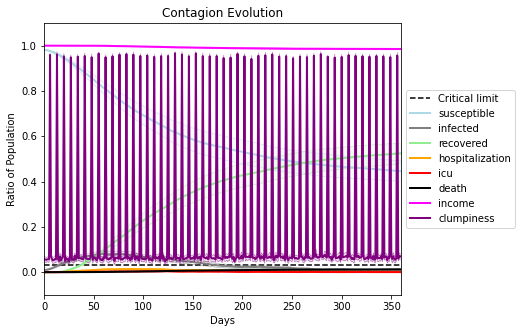

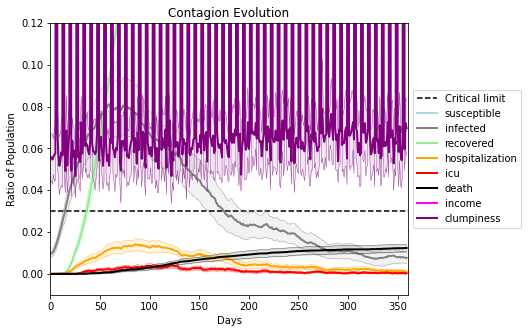

In [10]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.995
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[3172, 4950, 4553, 6314, 7994, 3690, 4180, 7555, 1149, 2381, 5756, 8080, 9831, 829, 3477, 2910, 38, 1047, 4195, 2357]
Average similarity between family members is 0.933489486053521 at temperature -0.994
Average similarity between family and home is 0.9998608335511776 at temperature -1
Average similarity between students and their classroom is 0.564343949889893 at temperature -0.994
Average classroom occupancy is 4 and number classrooms is 68
Average similarity between workers is 0.8806000158303642 at temperature -0.994
Average office occupancy is 3.3267326732673266 and number offices is 202
Average friend similarity for adults: 0.8464881740563124 for kids: 0.6678260714466875
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuild

avg restaurant similarity 0.5500465527332474
avg restaurant similarity 0.676835901450639
avg restaurant similarity 0.7413811330078713
avg restaurant similarity 0.4539670895940915
avg restaurant similarity 0.7179024762621029
avg restaurant similarity 0.8688375771267125
avg restaurant similarity 0.36292282114707286
avg restaurant similarity 0.5979196648648236
avg restaurant similarity 0.6801841390523626
avg restaurant similarity 0.6216245387635961
avg restaurant similarity 0.8589944680025532
avg restaurant similarity 0.561812677053221
avg restaurant similarity 0.6319475355534295
avg restaurant similarity 0.5024079868872176
avg restaurant similarity 0.5992443736728099
avg restaurant similarity 0.6357141114615026
avg restaurant similarity 0.6712710087574388
avg restaurant similarity 0.43454906541302724
avg restaurant similarity 0.8200484491912876
avg restaurant similarity 0.5886596995118276
avg restaurant similarity 0.5437969297491705
avg restaurant similarity 0.5184695172667166
avg restau

avg restaurant similarity 0.4602168885465039
avg restaurant similarity 0.5130263687172354
avg restaurant similarity 0.4459717876721434
avg restaurant similarity 0.49498785337919105
avg restaurant similarity 0.42479686532987715
avg restaurant similarity 0.5241474002139537
avg restaurant similarity 0.5638452647870321
avg restaurant similarity 0.578394136320032
avg restaurant similarity 0.6968326924118594
avg restaurant similarity 0.6427692334282396
avg restaurant similarity 0.6826229883836044
avg restaurant similarity 0.5783854372223725
avg restaurant similarity 0.5648755689995523
avg restaurant similarity 0.4413266735899949
avg restaurant similarity 0.39369974024784293
avg restaurant similarity 0.6238615482813408
avg restaurant similarity 0.6234545562533199
avg restaurant similarity 0.5217091140615202
avg restaurant similarity 0.2264757678530132
avg restaurant similarity 0.9998263886788703
avg restaurant similarity 0.20154929581059255
avg restaurant similarity 0.5896109131351559
avg res

avg restaurant similarity 0.4926376350241629
avg restaurant similarity 0.5022901125250657
avg restaurant similarity 0.7493990503288595
avg restaurant similarity 0.3267205017548615
avg restaurant similarity 0.6260124073349631
avg restaurant similarity 0.5674554427993025
avg restaurant similarity 0.3695509066830533
Average similarity between family members is 0.935567589011866 at temperature -0.994
Average similarity between family and home is 0.9998515734259061 at temperature -1
Average similarity between students and their classroom is 0.5911408433639892 at temperature -0.994
Average classroom occupancy is 4.291666666666667 and number classrooms is 72
Average similarity between workers is 0.8774926510016215 at temperature -0.994
Average office occupancy is 3.3419689119170983 and number offices is 193
Average friend similarity for adults: 0.8497412191858729 for kids: 0.6893897176433469
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacit

avg restaurant similarity 0.4428483027305843
avg restaurant similarity 0.7879482920007672
avg restaurant similarity 0.9997349992367996
avg restaurant similarity 0.4530161326165715
avg restaurant similarity 0.6586796833432738
avg restaurant similarity 0.39117302010276517
avg restaurant similarity 0.7228531257476756
avg restaurant similarity 0.34993906760028193
avg restaurant similarity 0.7662138185226341
avg restaurant similarity 0.5043222222000313
avg restaurant similarity 0.41520677592497524
avg restaurant similarity 0.3224920728836501
avg restaurant similarity 0.5470725895557437
avg restaurant similarity 0.39803090961413845
avg restaurant similarity 0.42016627977450527
avg restaurant similarity 0.9200706353839436
avg restaurant similarity 0.4483598049966279
avg restaurant similarity 0.9995100031400037
avg restaurant similarity 0.9387763965265192
avg restaurant similarity 0.4205648711831832
avg restaurant similarity 0.6628686003816027
avg restaurant similarity 0.6644368965364769
avg r

avg restaurant similarity 0.7532322607563057
avg restaurant similarity 0.31225596036121467
avg restaurant similarity 0.6818442504063977
avg restaurant similarity 0.31225596036121467
avg restaurant similarity 0.5185340260774957
avg restaurant similarity 0.8036566999312219
avg restaurant similarity 0.9061146045005026
avg restaurant similarity 0.7550604749046526
avg restaurant similarity 0.5778638298231252
avg restaurant similarity 0.9997974678663308
avg restaurant similarity 0.4360876268885938
avg restaurant similarity 0.39099094797399614
Average similarity between family members is 0.9358147708649052 at temperature -0.994
Average similarity between family and home is 0.9998544661895796 at temperature -1
Average similarity between students and their classroom is 0.5786699645435915 at temperature -0.994
Average classroom occupancy is 4.114285714285714 and number classrooms is 70
Average similarity between workers is 0.8875323076958355 at temperature -0.994
Average office occupancy is 3.43

avg restaurant similarity 0.6247688907932574
avg restaurant similarity 0.7428102875658809
avg restaurant similarity 0.3094162032216307
avg restaurant similarity 0.5160846371356218
avg restaurant similarity 0.45403244263062237
avg restaurant similarity 0.31059070108590203
avg restaurant similarity 0.8382722864525847
avg restaurant similarity 0.45636333751710334
avg restaurant similarity 0.5914531269659824
avg restaurant similarity 0.6082420658680254
avg restaurant similarity 0.31549558636441283
avg restaurant similarity 0.30161810631256003
avg restaurant similarity 0.706386223983487
avg restaurant similarity 0.5113560591184088
avg restaurant similarity 0.6592607198916044
avg restaurant similarity 0.6201782706827476
avg restaurant similarity 0.5336124336235867
avg restaurant similarity 0.5477789448894752
avg restaurant similarity 0.4094295490918229
avg restaurant similarity 0.5551749207593686
avg restaurant similarity 0.5331445904067694
avg restaurant similarity 0.5941580364185636
avg re

avg restaurant similarity 0.6487692115292173
avg restaurant similarity 0.6203509628953526
avg restaurant similarity 0.49490108190170357
avg restaurant similarity 0.3854904698302748
avg restaurant similarity 0.38519395330940354
avg restaurant similarity 0.48532942431528336
avg restaurant similarity 0.43916753910446443
avg restaurant similarity 0.40052850239272103
avg restaurant similarity 0.4970124257190385
avg restaurant similarity 0.44107555496504924
avg restaurant similarity 0.3415617770625123
avg restaurant similarity 0.8634578683568739
avg restaurant similarity 0.19248317233084064
avg restaurant similarity 0.9998341323409455
avg restaurant similarity 0.42503428405358923
avg restaurant similarity 0.3825578023881735
avg restaurant similarity 0.5469126778635333
avg restaurant similarity 0.4651490899648503
avg restaurant similarity 0.5519316038072279
avg restaurant similarity 0.3442542536923283
avg restaurant similarity 0.633868849555733
avg restaurant similarity 0.4125052272898641
avg

avg restaurant similarity 0.6604087479733264
avg restaurant similarity 0.4140057239251172
avg restaurant similarity 0.4045412751536739
avg restaurant similarity 0.7153514542951654
avg restaurant similarity 0.395493433433427
avg restaurant similarity 0.3391086899339734
avg restaurant similarity 0.8614914680671983
avg restaurant similarity 0.43768067516629555
Average similarity between family members is 0.9385119907884507 at temperature -0.994
Average similarity between family and home is 0.9998483972870957 at temperature -1
Average similarity between students and their classroom is 0.5414354181375263 at temperature -0.994
Average classroom occupancy is 4.514285714285714 and number classrooms is 70
Average similarity between workers is 0.8889993123538992 at temperature -0.994
Average office occupancy is 3.287179487179487 and number offices is 195
Average friend similarity for adults: 0.8463455643308166 for kids: 0.6790911406593606
home_districts
[
Home (0,0) district with 1 Buildings
Hom

avg restaurant similarity 0.605284567642353
avg restaurant similarity 0.3262067110382462
avg restaurant similarity 0.654149323756508
avg restaurant similarity 0.5952716373214471
avg restaurant similarity 0.49433555255181405
avg restaurant similarity 0.3580163911581211
avg restaurant similarity 0.5066125046855047
avg restaurant similarity 0.6024316476878411
avg restaurant similarity 0.4535430075108414
avg restaurant similarity 0.39851685859516817
avg restaurant similarity 0.3821175211559965
avg restaurant similarity 0.2171092944357237
avg restaurant similarity 0.605284567642353
avg restaurant similarity 0.6063537179077925
avg restaurant similarity 0.2564673667083489
avg restaurant similarity 0.6078882510664056
avg restaurant similarity 0.6024316476878411
avg restaurant similarity 0.605284567642353
avg restaurant similarity 0.5712318835913492
avg restaurant similarity 0.8556345842568394
avg restaurant similarity 0.27008689249798706
avg restaurant similarity 0.4537238428460353
avg restaur

avg restaurant similarity 0.4532874420717553
avg restaurant similarity 0.6012864515908478
avg restaurant similarity 0.5264895474148608
avg restaurant similarity 0.3518704890947305
avg restaurant similarity 0.8303238377230298
avg restaurant similarity 0.5087857018917875
avg restaurant similarity 0.6846726370654874
avg restaurant similarity 0.9523899789384349
avg restaurant similarity 0.660138805406953
avg restaurant similarity 0.5449664656617315
avg restaurant similarity 0.4446932340100356
avg restaurant similarity 0.7237471473046742
avg restaurant similarity 0.47465947488287263
avg restaurant similarity 0.5229037490359261
avg restaurant similarity 0.6048074599912157
avg restaurant similarity 0.9998312881981335
avg restaurant similarity 0.7686532414588233
avg restaurant similarity 0.9993690510009885
avg restaurant similarity 0.8201459655380248
avg restaurant similarity 0.8229151411549307
avg restaurant similarity 0.9997544512967198
avg restaurant similarity 0.5454238556303017
avg restau

avg restaurant similarity 0.5516459614533545
avg restaurant similarity 0.43008915397040565
avg restaurant similarity 0.7198813334618284
Average similarity between family members is 0.9358950568437886 at temperature -0.994
Average similarity between family and home is 0.9998653062342386 at temperature -1
Average similarity between students and their classroom is 0.5757844819746814 at temperature -0.994
Average classroom occupancy is 4.098591549295775 and number classrooms is 71
Average similarity between workers is 0.8774530428869853 at temperature -0.994
Average office occupancy is 3.3333333333333335 and number offices is 201
Average friend similarity for adults: 0.8524525557368833 for kids: 0.6788585088740233
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units

avg restaurant similarity 0.6372193152918532
avg restaurant similarity 0.4846943808885966
avg restaurant similarity 0.48778465631636353
avg restaurant similarity 0.6205522349682399
avg restaurant similarity 0.5213657425008024
avg restaurant similarity 0.6782212410346621
avg restaurant similarity 0.5379000627914813
avg restaurant similarity 0.35013135662461925
avg restaurant similarity 0.5069999485247447
avg restaurant similarity 0.4815738032453001
avg restaurant similarity 0.647718404196394
avg restaurant similarity 0.5490300281663042
avg restaurant similarity 0.6143753441910613
avg restaurant similarity 0.6166075975682972
avg restaurant similarity 0.3137067648510123
avg restaurant similarity 0.5742620353095222
avg restaurant similarity 0.30892969441888285
avg restaurant similarity 0.5901050493418913
avg restaurant similarity 0.4534312080191799
avg restaurant similarity 0.5068884248879079
avg restaurant similarity 0.5937307079064325
avg restaurant similarity 0.6972337422197955
avg rest

avg restaurant similarity 0.49647221642862127
avg restaurant similarity 0.5181678515743436
avg restaurant similarity 0.5814979128545513
avg restaurant similarity 0.5476071191086399
avg restaurant similarity 0.8649777964094492
avg restaurant similarity 0.6273439785274673
avg restaurant similarity 0.5536864620925888
avg restaurant similarity 0.4531437712393633
avg restaurant similarity 0.6563737317530567
avg restaurant similarity 0.4836845683501538
avg restaurant similarity 0.804117502869713
avg restaurant similarity 0.5044755197376256
avg restaurant similarity 0.6106867937622777
avg restaurant similarity 0.3985374273619606
avg restaurant similarity 0.6378995365515392
avg restaurant similarity 0.6752154670340157
avg restaurant similarity 0.7228265445489097
avg restaurant similarity 0.3985374273619606
avg restaurant similarity 0.48499647358558146
avg restaurant similarity 0.6068215438465847
avg restaurant similarity 0.4855894183029802
avg restaurant similarity 0.7287188427789344
avg resta

avg restaurant similarity 0.6407966128056287
avg restaurant similarity 0.7373884844582137
avg restaurant similarity 0.6820453958399862
avg restaurant similarity 0.47233998719229653
avg restaurant similarity 0.681498963316902
avg restaurant similarity 0.7350743600729294
avg restaurant similarity 0.8214887275895014
avg restaurant similarity 0.18470772947554798
avg restaurant similarity 0.43215491238138626
avg restaurant similarity 0.6339752989780312
avg restaurant similarity 0.7620266412911482
avg restaurant similarity 0.739196563189811
avg restaurant similarity 0.815734384380327
avg restaurant similarity 0.747629686837438
avg restaurant similarity 0.9998283013880254
avg restaurant similarity 0.8894485548758297
avg restaurant similarity 0.7983879840832919
avg restaurant similarity 0.6171595491490312
avg restaurant similarity 0.5389805159932831
avg restaurant similarity 0.43865754252493455
avg restaurant similarity 0.7932469307045229
avg restaurant similarity 0.9086664680092325
avg restau

avg restaurant similarity 0.5685883758509676
avg restaurant similarity 0.6846811190932397
avg restaurant similarity 0.41581436463478505
avg restaurant similarity 0.39946837465650653
avg restaurant similarity 0.49853246508908866
avg restaurant similarity 0.5695447288342332
avg restaurant similarity 0.8303205851354738
avg restaurant similarity 0.5533014566803259
avg restaurant similarity 0.5756622267850613
avg restaurant similarity 0.37837551003854547
avg restaurant similarity 0.5533379647809293
avg restaurant similarity 0.5228244606896552
avg restaurant similarity 0.6607620538114024
avg restaurant similarity 0.9997435514478349
avg restaurant similarity 0.39185933169310366
avg restaurant similarity 0.5356925806083269
avg restaurant similarity 0.45676921752127314
avg restaurant similarity 0.5067694794213334
avg restaurant similarity 0.6779202519208478
avg restaurant similarity 0.4013020386522266
avg restaurant similarity 0.48534078331076236
avg restaurant similarity 0.999589401059729
avg 

avg restaurant similarity 0.3950010241971542
avg restaurant similarity 0.6058414981053568
avg restaurant similarity 0.8204501346848136
avg restaurant similarity 0.7351324504321608
avg restaurant similarity 0.7182081957826791
avg restaurant similarity 0.533535370839125
avg restaurant similarity 0.520711347103355
avg restaurant similarity 0.9998855854909279
avg restaurant similarity 0.756269500869176
avg restaurant similarity 0.4307971049738352
avg restaurant similarity 0.7384662469057082
avg restaurant similarity 0.829986242868471
avg restaurant similarity 0.3040364290682357
avg restaurant similarity 0.6478453236744229
avg restaurant similarity 0.32543201706564495
avg restaurant similarity 0.5562115640944157
avg restaurant similarity 0.7627933396520845
avg restaurant similarity 0.9999316195921422
avg restaurant similarity 0.5558443006130853
avg restaurant similarity 0.7905000661314858
avg restaurant similarity 0.8719403033221469
avg restaurant similarity 0.8665181809442453
avg restauran

avg restaurant similarity 0.7108988434584023
avg restaurant similarity 0.9999431094955085
avg restaurant similarity 0.6143356673734852
avg restaurant similarity 0.6410191150687757
avg restaurant similarity 0.916336414876474
avg restaurant similarity 0.7690199097021135
avg restaurant similarity 0.4303583111101419
avg restaurant similarity 0.5163799414478112
avg restaurant similarity 0.425584461110624
avg restaurant similarity 0.5522759264646653
avg restaurant similarity 0.6495188216218939
avg restaurant similarity 0.5027331197313614
avg restaurant similarity 0.867342248901176
avg restaurant similarity 0.48710130923188044
avg restaurant similarity 0.9998461918068272
avg restaurant similarity 0.4665884291312953
avg restaurant similarity 0.38079662067140313
avg restaurant similarity 0.641823803262388
avg restaurant similarity 0.3326636759816366
avg restaurant similarity 0.6845401891127157
avg restaurant similarity 0.46325417324031093
avg restaurant similarity 0.8462122162737883
avg restaur

avg restaurant similarity 0.4698819836345549
avg restaurant similarity 0.5159826540103538
avg restaurant similarity 0.5695898852936794
avg restaurant similarity 0.44028102011987
avg restaurant similarity 0.36832583527494084
avg restaurant similarity 0.9996633432011696
avg restaurant similarity 0.6544561396430918
avg restaurant similarity 0.6279831214682221
avg restaurant similarity 0.9996382247807363
avg restaurant similarity 0.19172213824371737
avg restaurant similarity 0.5727640061372534
avg restaurant similarity 0.5960483773660723
avg restaurant similarity 0.502095889654074
avg restaurant similarity 0.6499515064280308
avg restaurant similarity 0.4381534703812916
avg restaurant similarity 0.6317486080935862
avg restaurant similarity 0.48766546165401703
avg restaurant similarity 0.25626641210491696
avg restaurant similarity 0.5501169043861895
avg restaurant similarity 0.4625639460557134
avg restaurant similarity 0.9998113683921992
avg restaurant similarity 0.6723572096590424
avg resta

avg restaurant similarity 0.8158399125140006
avg restaurant similarity 0.7600672323677088
avg restaurant similarity 0.42418400290943653
avg restaurant similarity 0.6960359712275133
avg restaurant similarity 0.6066279577847171
avg restaurant similarity 0.7338961692109354
avg restaurant similarity 0.7023337750009693
avg restaurant similarity 0.6273298298638619
avg restaurant similarity 0.4794955355149616
avg restaurant similarity 0.3272914567216915
avg restaurant similarity 0.6334102617158077
avg restaurant similarity 0.7674894201752966
avg restaurant similarity 0.27296123535934996
avg restaurant similarity 0.6334102617158077
avg restaurant similarity 0.25095158083554364
avg restaurant similarity 0.6492334590403457
avg restaurant similarity 0.36040889590350894
avg restaurant similarity 0.3938331676956772
avg restaurant similarity 0.46007391885549953
avg restaurant similarity 0.49463998623262395
avg restaurant similarity 0.40313428515617744
avg restaurant similarity 0.4055650878290948
avg

avg restaurant similarity 0.7761967563030927
avg restaurant similarity 0.9154638845321591
avg restaurant similarity 0.7242142859983043
avg restaurant similarity 0.6781280361221195
avg restaurant similarity 0.5779555269654557
avg restaurant similarity 0.6711854234235493
avg restaurant similarity 0.46805520111892773
avg restaurant similarity 0.508510285946995
avg restaurant similarity 0.400376607943304
avg restaurant similarity 0.8247133279015186
avg restaurant similarity 0.5615140569271115
avg restaurant similarity 0.5122781246610084
avg restaurant similarity 0.5158131362787445
avg restaurant similarity 0.5327057958122097
avg restaurant similarity 0.5760930313914208
avg restaurant similarity 0.5212986865203567
avg restaurant similarity 0.4816452473638449
avg restaurant similarity 0.43320816851067356
avg restaurant similarity 0.4709339286620734
avg restaurant similarity 0.23402722571181098
avg restaurant similarity 0.5562129038473609
avg restaurant similarity 0.9119806026653431
avg resta

avg restaurant similarity 0.6537269790611127
avg restaurant similarity 0.42903851558446543
avg restaurant similarity 0.46403881818628046
avg restaurant similarity 0.732172568319945
avg restaurant similarity 0.6561987509317555
avg restaurant similarity 0.7423774649784183
avg restaurant similarity 0.6601378250619907
avg restaurant similarity 0.46792297613413236
avg restaurant similarity 0.7152624829584984
avg restaurant similarity 0.7605269138082558
avg restaurant similarity 0.9604571884187822
avg restaurant similarity 0.36155445658851315
avg restaurant similarity 0.6462167272650572
avg restaurant similarity 0.6036737418767651
avg restaurant similarity 0.6918857380923804
avg restaurant similarity 0.6563097040304191
avg restaurant similarity 0.6573707821746233
avg restaurant similarity 0.6291679230356098
avg restaurant similarity 0.3583432062387649
avg restaurant similarity 0.6143400419246832
avg restaurant similarity 0.6308660533117963
avg restaurant similarity 0.5502218768920251
avg res

avg restaurant similarity 0.8049080503712256
avg restaurant similarity 0.9996627130059791
avg restaurant similarity 0.5254935910299162
avg restaurant similarity 0.7144136603307285
avg restaurant similarity 0.767620426021872
avg restaurant similarity 0.6959504042654118
avg restaurant similarity 0.47251739218939737
avg restaurant similarity 0.4647649385790683
avg restaurant similarity 0.9113042763641443
avg restaurant similarity 0.6851034618239192
avg restaurant similarity 0.8561003771616063
avg restaurant similarity 0.9102285260984434
avg restaurant similarity 0.705680766675864
avg restaurant similarity 0.5599377040801679
avg restaurant similarity 0.5693673012245527
avg restaurant similarity 0.9102782637324028
avg restaurant similarity 0.8465371672972861
avg restaurant similarity 0.8048409922911768
avg restaurant similarity 0.5707757883294167
avg restaurant similarity 0.8048067713465654
avg restaurant similarity 0.5330959865226029
avg restaurant similarity 0.9997103521300947
avg restaur

avg restaurant similarity 0.42362858352381094
avg restaurant similarity 0.9321159814558786
avg restaurant similarity 0.6144504417077893
avg restaurant similarity 0.45871394809207255
avg restaurant similarity 0.6111046212402804
avg restaurant similarity 0.5603756334764587
avg restaurant similarity 0.43976629009215945
avg restaurant similarity 0.4602231276025979
avg restaurant similarity 0.4625541270555264
avg restaurant similarity 0.6023617551754626
avg restaurant similarity 0.6017922063805424
avg restaurant similarity 0.6125832229586141
avg restaurant similarity 0.6905470213698175
avg restaurant similarity 0.49339779970203823
avg restaurant similarity 0.7911932711253866
avg restaurant similarity 0.39852386956278263
avg restaurant similarity 0.5841846456642179
avg restaurant similarity 0.9998981321819782
avg restaurant similarity 0.6029006250236995
avg restaurant similarity 0.7567051532289516
avg restaurant similarity 0.6431681302429002
avg restaurant similarity 0.6580576470755475
avg r

avg restaurant similarity 0.6328225520452521
avg restaurant similarity 0.6628049287385893
avg restaurant similarity 0.6189132645969615
avg restaurant similarity 0.7714706810048066
avg restaurant similarity 0.7716073126447831
avg restaurant similarity 0.4534379469956452
avg restaurant similarity 0.4748471709712635
avg restaurant similarity 0.5503226110350439
avg restaurant similarity 0.7301825230549844
avg restaurant similarity 0.5078392455253955
avg restaurant similarity 0.5418192087650329
avg restaurant similarity 0.49467637429385675
avg restaurant similarity 0.8019670469510467
avg restaurant similarity 0.8409716455396494
avg restaurant similarity 0.5449056446555931
avg restaurant similarity 0.765890939009798
avg restaurant similarity 0.4340287864047266
avg restaurant similarity 0.6523866858077556
avg restaurant similarity 0.6864040739410997
avg restaurant similarity 0.649494611160755
avg restaurant similarity 0.5550986967985645
avg restaurant similarity 0.5488765528713838
avg restaur

(<function dict.items>, <function dict.items>, <function dict.items>)

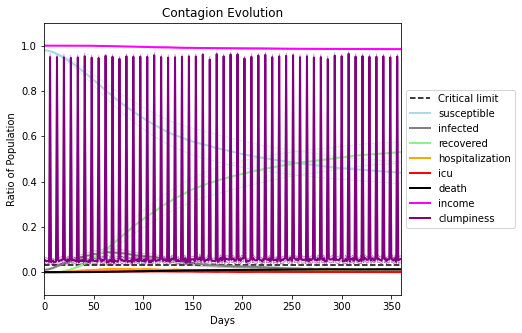

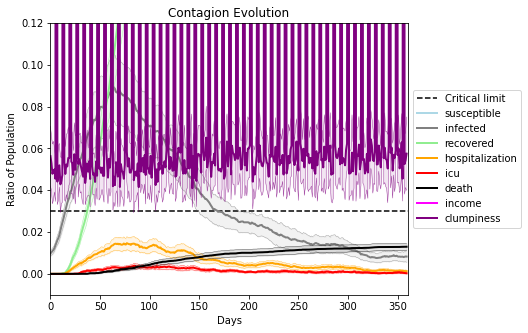

In [11]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.994
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[6255, 8332, 1918, 4850, 6615, 7160, 8474, 4932, 9091, 1473, 2151, 1921, 8290, 8712, 2258, 5370, 3795, 4505, 316, 9392]
Average similarity between family members is 0.9280151604911415 at temperature -0.993
Average similarity between family and home is 0.9998570096703433 at temperature -1
Average similarity between students and their classroom is 0.5487259281377808 at temperature -0.993
Average classroom occupancy is 4.142857142857143 and number classrooms is 70
Average similarity between workers is 0.8651605999407075 at temperature -0.993
Average office occupancy is 3.3846153846153846 and number offices is 195
Average friend similarity for adults: 0.8447110135532981 for kids: 0.6730649277918784
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildi

avg restaurant similarity 0.504470048250029
avg restaurant similarity 0.07822521565826854
avg restaurant similarity 0.047383448366210834
avg restaurant similarity 0.7031169408637031
avg restaurant similarity 0.5085260067907267
avg restaurant similarity 0.8716869356956298
avg restaurant similarity 0.12664503274393993
avg restaurant similarity 0.9998466274653708
avg restaurant similarity 0.7958212406128957
avg restaurant similarity 0.6386673803167919
avg restaurant similarity 0.9995823465956446
avg restaurant similarity 0.7022640759012972
avg restaurant similarity 0.3425126871576351
avg restaurant similarity 0.4769196012620721
avg restaurant similarity 0.5919070591481537
avg restaurant similarity 0.2508775272402995
avg restaurant similarity 0.2636083477683291
avg restaurant similarity 0.3766170543194347
avg restaurant similarity 0.8474951674798299
avg restaurant similarity 0.27311285291974974
avg restaurant similarity 0.8470161977093806
avg restaurant similarity 0.6358925471333641
avg re

avg restaurant similarity 0.4072802728651996
avg restaurant similarity 0.484647567594406
avg restaurant similarity 0.4169933758714491
avg restaurant similarity 0.3900867779833759
avg restaurant similarity 0.9998735671785361
avg restaurant similarity 0.28768563073406017
avg restaurant similarity 0.42539156628792013
avg restaurant similarity 0.5676199629271643
avg restaurant similarity 0.32826756726757134
avg restaurant similarity 0.5409954650067326
avg restaurant similarity 0.5725565152102368
avg restaurant similarity 0.5928548333853714
avg restaurant similarity 0.9998707939353317
avg restaurant similarity 0.26490943709970044
avg restaurant similarity 0.6430294293346098
avg restaurant similarity 0.5051453191264575
avg restaurant similarity 0.3386678828381643
avg restaurant similarity 0.9997220544362556
avg restaurant similarity 0.8775535570493789
avg restaurant similarity 0.5937357753228396
avg restaurant similarity 0.9995694144180404
avg restaurant similarity 0.5705873584810324
avg res

Average similarity between family and home is 0.9998433687839878 at temperature -1
Average similarity between students and their classroom is 0.5521976017731712 at temperature -0.993
Average classroom occupancy is 4.03030303030303 and number classrooms is 66
Average similarity between workers is 0.8619553590247473 at temperature -0.993
Average office occupancy is 3.641711229946524 and number offices is 187
Average friend similarity for adults: 0.8501132882846679 for kids: 0.674726395380429
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 peo

avg restaurant similarity 0.3190601221081777
avg restaurant similarity 0.5051131638205685
avg restaurant similarity 0.43317450077061237
avg restaurant similarity 0.5485529589380338
avg restaurant similarity 0.8307481626807489
avg restaurant similarity 0.4658635852576647
avg restaurant similarity 0.4299690828907437
avg restaurant similarity 0.6111954460748725
avg restaurant similarity 0.6689661354588881
avg restaurant similarity 0.7215870048621441
avg restaurant similarity 0.48025396701885975
avg restaurant similarity 0.7181878249127226
avg restaurant similarity 0.3068077883159478
avg restaurant similarity 0.4985940448017454
avg restaurant similarity 0.8441465228529567
avg restaurant similarity 0.999874984142759
avg restaurant similarity 0.3946072829421303
avg restaurant similarity 0.25158216930368577
avg restaurant similarity 0.35751145366890613
avg restaurant similarity 0.45959968808303914
avg restaurant similarity 0.29429787552350034
avg restaurant similarity 0.4921499203461748
avg r

avg restaurant similarity 0.6819146189737825
avg restaurant similarity 0.3311243716499106
avg restaurant similarity 0.6238499425491786
avg restaurant similarity 0.5031754528860186
avg restaurant similarity 0.45956769474497355
avg restaurant similarity 0.38987277233787887
avg restaurant similarity 0.6408524539894696
avg restaurant similarity 0.8934040649621768
avg restaurant similarity 0.5697147181450644
avg restaurant similarity 0.4579705738646703
avg restaurant similarity 0.45380954385799305
avg restaurant similarity 0.2713837766259395
avg restaurant similarity 0.516491904534387
avg restaurant similarity 0.40676213698506924
avg restaurant similarity 0.4384192094201649
avg restaurant similarity 0.542297991614338
avg restaurant similarity 0.45717453245309364
avg restaurant similarity 0.47140150878743875
avg restaurant similarity 0.273263974715564
avg restaurant similarity 0.4555951513181989
avg restaurant similarity 0.6283153644844086
avg restaurant similarity 0.3871103605487207
avg res

avg restaurant similarity 0.693466908421574
avg restaurant similarity 0.5679749656504642
avg restaurant similarity 0.7321256307530436
avg restaurant similarity 0.8227495626498444
avg restaurant similarity 0.8308924199463261
avg restaurant similarity 0.9998694101825139
avg restaurant similarity 0.5468252585318966
avg restaurant similarity 0.20563535099149344
avg restaurant similarity 0.5822888768346582
avg restaurant similarity 0.6137313281848187
avg restaurant similarity 0.5534762356889936
avg restaurant similarity 0.7167014934612077
avg restaurant similarity 0.6228204248778184
avg restaurant similarity 0.436498156916554
avg restaurant similarity 0.7567916672230384
avg restaurant similarity 0.29819987587685637
avg restaurant similarity 0.6735205210725306
avg restaurant similarity 0.9995456737916439
avg restaurant similarity 0.57159852859102
avg restaurant similarity 0.4447557456422876
avg restaurant similarity 0.4726168869885615
avg restaurant similarity 0.9997321716192964
avg restaura

avg restaurant similarity 0.48520871840600976
avg restaurant similarity 0.8254606564256102
avg restaurant similarity 0.6006320376490998
avg restaurant similarity 0.32420463132140775
avg restaurant similarity 0.21477663982143502
avg restaurant similarity 0.6274813285179455
avg restaurant similarity 0.42301507764859947
avg restaurant similarity 0.41011583360221826
avg restaurant similarity 0.42005493961141416
avg restaurant similarity 0.3864319481112585
avg restaurant similarity 0.4284174521050148
avg restaurant similarity 0.5363602529086741
avg restaurant similarity 0.87918925746671
avg restaurant similarity 0.6662347214386484
avg restaurant similarity 0.4128825083704163
avg restaurant similarity 0.9997255094435589
avg restaurant similarity 0.40898639040738993
avg restaurant similarity 0.4574556893831613
avg restaurant similarity 0.5766874644075105
avg restaurant similarity 0.5432904729493879
avg restaurant similarity 0.7196609989699829
avg restaurant similarity 0.41871570257994856
avg 

avg restaurant similarity 0.4675348915654544
avg restaurant similarity 0.5040672119301607
avg restaurant similarity 0.3010551823510957
avg restaurant similarity 0.4125488506182846
avg restaurant similarity 0.43552323886408106
avg restaurant similarity 0.43508825302250836
avg restaurant similarity 0.12895231253946265
avg restaurant similarity 0.5649029859340909
avg restaurant similarity 0.6552390134240872
avg restaurant similarity 0.4406079503471373
avg restaurant similarity 0.30104123952295786
avg restaurant similarity 0.4071325299590785
avg restaurant similarity 0.5893452091350525
avg restaurant similarity 0.43639516128177347
avg restaurant similarity 0.504337254908455
avg restaurant similarity 0.5591028283100088
avg restaurant similarity 0.3030147591405524
avg restaurant similarity 0.4143271661441503
avg restaurant similarity 0.41184795518139755
avg restaurant similarity 0.31266698789664044
avg restaurant similarity 0.325076110111486
avg restaurant similarity 0.5729866520130313
avg r

avg restaurant similarity 0.5761651341316681
avg restaurant similarity 0.6040492724022999
avg restaurant similarity 0.5454657416699819
avg restaurant similarity 0.6112752429582171
avg restaurant similarity 0.22713953750591956
avg restaurant similarity 0.611189531192663
avg restaurant similarity 0.4590444913899723
avg restaurant similarity 0.28734055353620724
avg restaurant similarity 0.552915662964837
avg restaurant similarity 0.5503566394194335
avg restaurant similarity 0.46260484559783704
avg restaurant similarity 0.46784194330754586
avg restaurant similarity 0.4667475043905242
avg restaurant similarity 0.5827234965530755
avg restaurant similarity 0.203904715765989
avg restaurant similarity 0.8849366458108825
avg restaurant similarity 0.5692362938440867
avg restaurant similarity 0.7052713683724473
avg restaurant similarity 0.3259205276708868
avg restaurant similarity 0.6391435865943937
avg restaurant similarity 0.4675818084002066
avg restaurant similarity 0.6391435865943937
avg resta

avg restaurant similarity 0.5411676499086603
avg restaurant similarity 0.9999264325643442
avg restaurant similarity 0.626902192794179
avg restaurant similarity 0.8446600489671166
avg restaurant similarity 0.5352070574739916
avg restaurant similarity 0.6683397504643791
avg restaurant similarity 0.5660266015625746
avg restaurant similarity 0.5411162326216252
avg restaurant similarity 0.26346271158537116
avg restaurant similarity 0.847519958943633
avg restaurant similarity 0.44115838054303674
avg restaurant similarity 0.9998561949140226
avg restaurant similarity 0.660622882353076
avg restaurant similarity 0.6972267539342245
avg restaurant similarity 0.3616873687888327
avg restaurant similarity 0.5278061136413642
avg restaurant similarity 0.8106454142971009
avg restaurant similarity 0.5238565265645775
avg restaurant similarity 0.5249207709615754
avg restaurant similarity 0.4519673431857505
avg restaurant similarity 0.6012855984538242
avg restaurant similarity 0.5697769377573484
avg restaur

avg restaurant similarity 0.8929458941672641
avg restaurant similarity 0.5877291595618676
avg restaurant similarity 0.6894305499565588
avg restaurant similarity 0.606523863655273
avg restaurant similarity 0.3443370983695202
avg restaurant similarity 0.5531376188727524
avg restaurant similarity 0.4920344275608014
avg restaurant similarity 0.8444288015717434
avg restaurant similarity 0.2280149163211673
avg restaurant similarity 0.5257884625401308
avg restaurant similarity 0.31688190037676167
avg restaurant similarity 0.3144444930784612
avg restaurant similarity 0.5725969349683184
avg restaurant similarity 0.27446272804262856
avg restaurant similarity 0.32225611429351897
avg restaurant similarity 0.22032951873497883
avg restaurant similarity 0.5151048087195935
avg restaurant similarity 0.7842863176320589
avg restaurant similarity 0.5920723543002051
avg restaurant similarity 0.5471243678588902
avg restaurant similarity 0.430989732794087
avg restaurant similarity 0.7943685737418665
avg rest

avg restaurant similarity 0.4522269256608794
avg restaurant similarity 0.2551833739273479
avg restaurant similarity 0.3963484507883729
avg restaurant similarity 0.8431113308691646
avg restaurant similarity 0.6743461308899836
avg restaurant similarity 0.6126089538825714
avg restaurant similarity 0.8437596161070644
avg restaurant similarity 0.8455033190381394
avg restaurant similarity 0.3944094288055944
avg restaurant similarity 0.449912744847874
avg restaurant similarity 0.335301927228207
avg restaurant similarity 0.9997377682142831
avg restaurant similarity 0.4397915320226885
avg restaurant similarity 0.3291598539211224
avg restaurant similarity 0.22887949870332305
avg restaurant similarity 0.6438845205266912
avg restaurant similarity 0.5668708309335049
avg restaurant similarity 0.564933118861032
avg restaurant similarity 0.907075975551858
avg restaurant similarity 0.27208975471215663
avg restaurant similarity 0.5378325102923857
avg restaurant similarity 0.33882238060427994
avg restaur

avg restaurant similarity 0.6316679931306665
avg restaurant similarity 0.4953217888752564
avg restaurant similarity 0.3843978455726371
avg restaurant similarity 0.7244284960161075
avg restaurant similarity 0.5729066915192096
avg restaurant similarity 0.7612387952406424
avg restaurant similarity 0.4777888066908126
avg restaurant similarity 0.8409741154713746
avg restaurant similarity 0.417115498713864
avg restaurant similarity 0.604769231295396
avg restaurant similarity 0.38694518867507527
avg restaurant similarity 0.4314389951899253
avg restaurant similarity 0.7222202037356819
avg restaurant similarity 0.7826539366667359
avg restaurant similarity 0.830244231150076
avg restaurant similarity 0.46772229719457453
avg restaurant similarity 0.42962204343138644
avg restaurant similarity 0.5395473991722787
avg restaurant similarity 0.6814279031496377
avg restaurant similarity 0.46368014901250554
avg restaurant similarity 0.5359371859820072
avg restaurant similarity 0.544000483699827
avg restau

Average similarity between workers is 0.8706077819250386 at temperature -0.993
Average office occupancy is 3.336734693877551 and number offices is 196
Average friend similarity for adults: 0.8408262618531948 for kids: 0.6617389412183254
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 

avg restaurant similarity 0.38824093509270324
avg restaurant similarity 0.4292763453262717
avg restaurant similarity 0.5614931547046379
avg restaurant similarity 0.3799885011510946
avg restaurant similarity 0.5426244265970419
avg restaurant similarity 0.4357020815774928
avg restaurant similarity 0.517735695816752
avg restaurant similarity 0.44576863024533475
avg restaurant similarity 0.3146603013655773
avg restaurant similarity 0.36195613484742756
avg restaurant similarity 0.7775816250700477
avg restaurant similarity 0.4161875791234524
avg restaurant similarity 0.887706693391855
avg restaurant similarity 0.16824335682244884
avg restaurant similarity 0.46297731694772304
avg restaurant similarity 0.999784073769935
avg restaurant similarity 0.3018801570729757
avg restaurant similarity 0.5058113537673778
avg restaurant similarity 0.5228020972729173
avg restaurant similarity 0.5903791554675639
avg restaurant similarity 0.7143148226260059
avg restaurant similarity 0.4282716214093035
avg rest

avg restaurant similarity 0.5439610380801809
avg restaurant similarity 0.5299436169737775
avg restaurant similarity 0.7516376110454964
avg restaurant similarity 0.6511105268454176
avg restaurant similarity 0.6652939045096058
avg restaurant similarity 0.6139076564464211
avg restaurant similarity 0.5488946304493144
avg restaurant similarity 0.5272250920726033
avg restaurant similarity 0.8627374540907424
avg restaurant similarity 0.5862338975624543
avg restaurant similarity 0.6129651169755544
avg restaurant similarity 0.6052644329523009
avg restaurant similarity 0.875548233617618
avg restaurant similarity 0.19532943603018577
avg restaurant similarity 0.8348346082436116
avg restaurant similarity 0.6782166847142557
avg restaurant similarity 0.5193430375406441
avg restaurant similarity 0.8212787739034496
avg restaurant similarity 0.5214427140891014
avg restaurant similarity 0.5773385558839251
avg restaurant similarity 0.7536395288824531
avg restaurant similarity 0.8755857400323503
avg restau

avg restaurant similarity 0.3883241884803739
avg restaurant similarity 0.7974030283417168
avg restaurant similarity 0.5545584458136372
avg restaurant similarity 0.3999377264327124
avg restaurant similarity 0.546741608436271
avg restaurant similarity 0.4214296979346407
avg restaurant similarity 0.30818783018028706
avg restaurant similarity 0.5905473909749341
avg restaurant similarity 0.8042186166364695
avg restaurant similarity 0.5256031421402361
avg restaurant similarity 0.4480464074277944
avg restaurant similarity 0.08251379085777205
avg restaurant similarity 0.5308565017199638
avg restaurant similarity 0.7883757459578332
avg restaurant similarity 0.8501636481641346
avg restaurant similarity 0.4122127699056497
avg restaurant similarity 0.17707868754631503
avg restaurant similarity 0.2852969416854327
avg restaurant similarity 0.2736041614623759
avg restaurant similarity 0.5602156846013637
avg restaurant similarity 0.667670289984719
avg restaurant similarity 0.42993633920005525
avg rest

avg restaurant similarity 0.4277157526387787
avg restaurant similarity 0.1317836928181713
avg restaurant similarity 0.3706023495044317
avg restaurant similarity 0.5892993553787748
avg restaurant similarity 0.5900407292855563
avg restaurant similarity 0.5599858724807738
avg restaurant similarity 0.3330406368028657
avg restaurant similarity 0.6404048529252417
avg restaurant similarity 0.37606934992039626
avg restaurant similarity 0.2392704121140113
avg restaurant similarity 0.45337206168852645
avg restaurant similarity 0.5423543943222355
avg restaurant similarity 0.4221473343998412
avg restaurant similarity 0.48696245800238863
avg restaurant similarity 0.49351611974272647
avg restaurant similarity 0.4910955961594855
avg restaurant similarity 0.5571559875097599
avg restaurant similarity 0.7252809455458019
avg restaurant similarity 0.7614545796343497
avg restaurant similarity 0.3774252332215957
avg restaurant similarity 0.49319754233504814
avg restaurant similarity 0.660042871834638
avg re

Average friend similarity for adults: 0.8347823565480501 for kids: 0.6756933383440761
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocat

avg restaurant similarity 0.41169829665695945
avg restaurant similarity 0.694220943723433
avg restaurant similarity 0.6065740466832904
avg restaurant similarity 0.5523999838566381
avg restaurant similarity 0.30726330988339184
avg restaurant similarity 0.4339074657912303
avg restaurant similarity 0.48922958284151596
avg restaurant similarity 0.9327203644016755
avg restaurant similarity 0.43133441927568333
avg restaurant similarity 0.7927288008381967
avg restaurant similarity 0.5249402441156245
avg restaurant similarity 0.671279072311461
avg restaurant similarity 0.4552189925116574
avg restaurant similarity 0.04230504511820175
avg restaurant similarity 0.5746920246468497
avg restaurant similarity 0.44539640298061123
avg restaurant similarity 0.6705687981868214
avg restaurant similarity 0.2683601569218551
avg restaurant similarity 0.9064467909817069
avg restaurant similarity 0.392473173139981
avg restaurant similarity 0.4085648411605354
avg restaurant similarity 0.4339074657912303
avg res

avg restaurant similarity 0.5503041412377576
avg restaurant similarity 0.8738187470741352
avg restaurant similarity 0.7024745710187197
avg restaurant similarity 0.4633199181972598
avg restaurant similarity 0.6400710708252135
avg restaurant similarity 0.49596669193034737
avg restaurant similarity 0.5668190540165455
avg restaurant similarity 0.4843110223261892
avg restaurant similarity 0.9311773732055346
avg restaurant similarity 0.6372475165066763
avg restaurant similarity 0.8496758629301513
avg restaurant similarity 0.2660427604175087
avg restaurant similarity 0.5439571273684416
avg restaurant similarity 0.44515983966355227
avg restaurant similarity 0.36109389875384157
avg restaurant similarity 0.4839523999584334
avg restaurant similarity 0.7495424083935979
avg restaurant similarity 0.460154886739066
avg restaurant similarity 0.6145420398093615
avg restaurant similarity 0.5017503772631502
avg restaurant similarity 0.6511972361588484
avg restaurant similarity 0.5440765242631365
avg rest

avg restaurant similarity 0.3378795072644176
avg restaurant similarity 0.3776158002589083
avg restaurant similarity 0.568768947361617
avg restaurant similarity 0.5691475965516333
avg restaurant similarity 0.5384833019912726
avg restaurant similarity 0.6638635323319734
avg restaurant similarity 0.3381043703991008
avg restaurant similarity 0.5256708254292417
avg restaurant similarity 0.49952689034100706
avg restaurant similarity 0.34929416197746943
avg restaurant similarity 0.5599144767441397
avg restaurant similarity 0.5605823224900115
avg restaurant similarity 0.6950812393323684
avg restaurant similarity 0.7087239630783745
avg restaurant similarity 0.5884039890339539
avg restaurant similarity 0.8406105659975147
avg restaurant similarity 0.3863604511722809
avg restaurant similarity 0.6089640349711223
avg restaurant similarity 0.8222679892645495
avg restaurant similarity 0.4049425057174938
avg restaurant similarity 0.48040284649416776
avg restaurant similarity 0.6280250149450681
avg rest

avg restaurant similarity 0.6852398439139629
avg restaurant similarity 0.3292118509552424
avg restaurant similarity 0.5252462865977732
avg restaurant similarity 0.2570074670728859
avg restaurant similarity 0.3292118509552424
avg restaurant similarity 0.4613040688547655
avg restaurant similarity 0.8379264402497285
avg restaurant similarity 0.5034639809689703
avg restaurant similarity 0.6361326556064847
avg restaurant similarity 0.6358555324955832
avg restaurant similarity 0.4468408516700977
avg restaurant similarity 0.4376662159009659
avg restaurant similarity 0.7841292522827044
avg restaurant similarity 0.4659387207721698
avg restaurant similarity 0.5722361740994154
avg restaurant similarity 0.37620613377677425
avg restaurant similarity 0.49728092101274624
avg restaurant similarity 0.3944443703931954
avg restaurant similarity 0.33595122977375663
avg restaurant similarity 0.7020849168648402
avg restaurant similarity 0.47266750523285395
avg restaurant similarity 0.7841292522827044
avg re

(<function dict.items>, <function dict.items>, <function dict.items>)

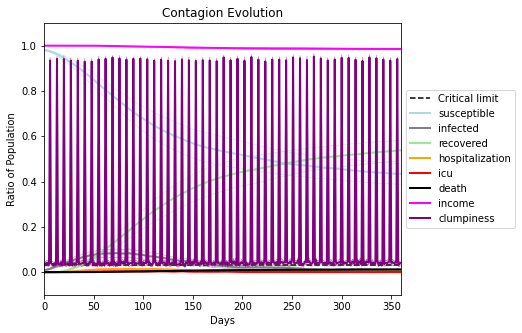

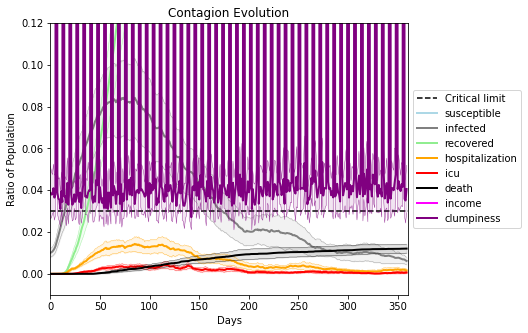

In [12]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.993
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[5768, 1010, 7616, 4716, 3013, 6033, 5517, 9186, 2355, 3256, 9911, 2306, 945, 3184, 2949, 9354, 5966, 7703, 9864, 4840]
Average similarity between family members is 0.9301355480971626 at temperature -0.992
Average similarity between family and home is 0.9998536295049634 at temperature -1
Average similarity between students and their classroom is 0.5356824245542653 at temperature -0.992
Average classroom occupancy is 3.8450704225352115 and number classrooms is 71
Average similarity between workers is 0.8454458247048802 at temperature -0.992
Average office occupancy is 3.4060913705583755 and number offices is 197
Average friend similarity for adults: 0.8391657773065438 for kids: 0.6601263214683561
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Build

avg restaurant similarity 0.28620472152908344
avg restaurant similarity 0.39039610154350807
avg restaurant similarity 0.3632418813029073
avg restaurant similarity 0.893770284399305
avg restaurant similarity 0.5326937751394017
avg restaurant similarity 0.6236418283976275
avg restaurant similarity 0.7098425734192984
avg restaurant similarity 0.409586910251838
avg restaurant similarity 0.6917038898981329
avg restaurant similarity 0.2980498898710569
avg restaurant similarity 0.4820626368167291
avg restaurant similarity 0.5870015801264152
avg restaurant similarity 0.40688623192989604
avg restaurant similarity 0.4250858399830612
avg restaurant similarity 0.6602485729639835
avg restaurant similarity 0.7116982941444501
avg restaurant similarity 0.4210342899037862
avg restaurant similarity 0.20586428640117316
avg restaurant similarity 0.7248147893365064
avg restaurant similarity 0.7333466157600309
avg restaurant similarity 0.5581083477492808
avg restaurant similarity 0.6911844643351481
avg rest

avg restaurant similarity 0.4679658895185916
avg restaurant similarity 0.3902520397794273
avg restaurant similarity 0.6448044181002683
avg restaurant similarity 0.7875268007367683
avg restaurant similarity 0.4655141626539771
avg restaurant similarity 0.4416848459054043
avg restaurant similarity 0.5282131455089971
avg restaurant similarity 0.588563886267039
avg restaurant similarity 0.7073653787793701
avg restaurant similarity 0.5031687244826055
avg restaurant similarity 0.601227206887505
avg restaurant similarity 0.590871088523009
avg restaurant similarity 0.5543679722197741
avg restaurant similarity 0.4210342899037862
avg restaurant similarity 0.4895713188265335
avg restaurant similarity 0.7634181524751973
avg restaurant similarity 0.44947875271560706
avg restaurant similarity 0.2922732455552663
avg restaurant similarity 0.53130722229688
avg restaurant similarity 0.6467246591066068
avg restaurant similarity 0.514091356890254
avg restaurant similarity 0.6031709384814712
Average similar

avg restaurant similarity 0.5071882334861763
avg restaurant similarity 0.5010498618168362
avg restaurant similarity 0.11693037238735846
avg restaurant similarity 0.37637501469418444
avg restaurant similarity 0.5114083059902961
avg restaurant similarity 0.5056849555034533
avg restaurant similarity 0.13478904207917652
avg restaurant similarity 0.5059549689191389
avg restaurant similarity 0.35603971916471655
avg restaurant similarity 0.9003550652664002
avg restaurant similarity 0.5886337644267374
avg restaurant similarity 0.21913333364599538
avg restaurant similarity 0.6431776122395025
avg restaurant similarity 0.31434789845880734
avg restaurant similarity 0.6931459713796491
avg restaurant similarity 0.6754561667894032
avg restaurant similarity 0.3912049422156776
avg restaurant similarity 0.54164468468145
avg restaurant similarity 0.6163993908930979
avg restaurant similarity 0.36352594626225543
avg restaurant similarity 0.5847360272176902
avg restaurant similarity 0.6979379428645449
avg r

avg restaurant similarity 0.5902275979863347
avg restaurant similarity 0.2777723215823021
avg restaurant similarity 0.4479880396989341
avg restaurant similarity 0.4595534675167151
avg restaurant similarity 0.6267198289750745
avg restaurant similarity 0.46334119231253246
avg restaurant similarity 0.6144878225443524
avg restaurant similarity 0.6925693680039041
avg restaurant similarity 0.5198269616295694
avg restaurant similarity 0.5089763920244224
avg restaurant similarity 0.20869661999300054
avg restaurant similarity 0.4399518112653702
avg restaurant similarity 0.3257526788185644
avg restaurant similarity 0.45240630268515425
avg restaurant similarity 0.42880533013930133
avg restaurant similarity 0.6373462138552946
avg restaurant similarity 0.601087493703752
avg restaurant similarity 0.516823020020919
avg restaurant similarity 0.5070143413658552
avg restaurant similarity 0.9508825114503974
avg restaurant similarity 0.6474321951244775
avg restaurant similarity 0.13593679926065044
avg res

Average friend similarity for adults: 0.8343525604901469 for kids: 0.6635186304675298
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocat

avg restaurant similarity 0.5128503816273158
avg restaurant similarity 0.5316255572249307
avg restaurant similarity 0.9433145347769023
avg restaurant similarity 0.25765512084092423
avg restaurant similarity 0.6390705165436384
avg restaurant similarity 0.6350761041355234
avg restaurant similarity 0.5962145305692155
avg restaurant similarity 0.5212322969913827
avg restaurant similarity 0.331786758342222
avg restaurant similarity 0.4123327941872602
avg restaurant similarity 0.6118528430086456
avg restaurant similarity 0.36877266133605296
avg restaurant similarity 0.42753492974307045
avg restaurant similarity 0.48016031035751483
avg restaurant similarity 0.42796266763724017
avg restaurant similarity 0.3686540889021908
avg restaurant similarity 0.1772960031186584
avg restaurant similarity 0.5557566918724939
avg restaurant similarity 0.4798584609271277
avg restaurant similarity 0.5573915653225763
avg restaurant similarity 0.5559587516902138
avg restaurant similarity 0.3962618996791076
avg re

Average similarity between workers is 0.8495333083408627 at temperature -0.992
Average office occupancy is 3.5076142131979697 and number offices is 197
Average friend similarity for adults: 0.849614692587561 for kids: 0.6509834607157201
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 

avg restaurant similarity 0.17156849406273156
avg restaurant similarity 0.5154607533055757
avg restaurant similarity 0.4957264746717438
avg restaurant similarity 0.6047925081580448
avg restaurant similarity 0.5532187529690685
avg restaurant similarity 0.999687266583867
avg restaurant similarity 0.40108507625531037
avg restaurant similarity 0.5903515938704016
avg restaurant similarity 0.47859753749691913
avg restaurant similarity 0.17223199197500694
avg restaurant similarity 0.3265342789215317
avg restaurant similarity 0.40009243504146574
avg restaurant similarity 0.38192662459904586
avg restaurant similarity 0.5286573960509613
avg restaurant similarity 0.48282322571179753
avg restaurant similarity 0.4917209259906956
avg restaurant similarity 0.6282243003932959
avg restaurant similarity 0.4964665715185386
avg restaurant similarity 0.554595098889511
avg restaurant similarity 0.40562262845261204
avg restaurant similarity 0.4153099239296257
avg restaurant similarity 0.42609714529082354
avg

avg restaurant similarity 0.4570109387493305
avg restaurant similarity 0.3944520325453992
avg restaurant similarity 0.2881897889438869
avg restaurant similarity 0.42647698249961064
avg restaurant similarity 0.48860244113037676
avg restaurant similarity 0.8102812132091997
avg restaurant similarity 0.36437427019614177
avg restaurant similarity 0.6384802420700735
avg restaurant similarity 0.36121474845666157
avg restaurant similarity 0.5396431140681015
avg restaurant similarity 0.5544495565743294
avg restaurant similarity 0.5332592299519159
avg restaurant similarity 0.16994556307037473
avg restaurant similarity 0.8191996720258046
avg restaurant similarity 0.2881897889438869
avg restaurant similarity 0.40685938246575365
avg restaurant similarity 0.7889235750056567
avg restaurant similarity 0.5332592299519159
avg restaurant similarity 0.18298934386527071
avg restaurant similarity 0.5755166110117729
avg restaurant similarity 0.8773469939425502
avg restaurant similarity 0.44416708851547393
av

avg restaurant similarity 0.6126883554372136
avg restaurant similarity 0.8554389088188816
avg restaurant similarity 0.2892798181872985
avg restaurant similarity 0.17878439220351214
avg restaurant similarity 0.46388725612951476
avg restaurant similarity 0.16003091347471662
avg restaurant similarity 0.4138037428069822
avg restaurant similarity 0.367898962501079
avg restaurant similarity 0.4623858605238166
avg restaurant similarity 0.32440914916849656
avg restaurant similarity 0.5311525478464816
avg restaurant similarity 0.706476240037258
avg restaurant similarity 0.49201168888926616
avg restaurant similarity 0.36513587732385866
avg restaurant similarity 0.47086759419829727
avg restaurant similarity 0.5291547746572023
avg restaurant similarity 0.5901597921652308
avg restaurant similarity 0.31393499789546364
avg restaurant similarity 0.5291547746572023
avg restaurant similarity 0.47997299258566106
avg restaurant similarity 0.18142234668872845
avg restaurant similarity 0.8395814296917503
av

avg restaurant similarity 0.5393958109956498
avg restaurant similarity 0.28671624747387725
avg restaurant similarity 0.6762365196047817
avg restaurant similarity 0.4838364954123761
avg restaurant similarity 0.6559794160348853
avg restaurant similarity 0.49126811637566636
avg restaurant similarity 0.6297709399948019
avg restaurant similarity 0.6559794160348853
avg restaurant similarity 0.44581930263892944
avg restaurant similarity 0.7085423120838463
avg restaurant similarity 0.615687299622073
avg restaurant similarity 0.47386334091628884
avg restaurant similarity 0.7092455364910752
avg restaurant similarity 0.9997513599870231
avg restaurant similarity 0.35313941319779985
avg restaurant similarity 0.6038587017701862
avg restaurant similarity 0.7805936119196333
avg restaurant similarity 0.6480227369349701
avg restaurant similarity 0.8282749840199876
avg restaurant similarity 0.6949243033895838
avg restaurant similarity 0.8231551410894111
avg restaurant similarity 0.6405909056471955
avg re

avg restaurant similarity 0.8041711081671311
avg restaurant similarity 0.4638221386720265
avg restaurant similarity 0.4844023332300935
avg restaurant similarity 0.42743604102108207
avg restaurant similarity 0.20948182250769318
avg restaurant similarity 0.9995269408311743
avg restaurant similarity 0.1737443444073374
avg restaurant similarity 0.47197221810867573
avg restaurant similarity 0.3621705226722699
avg restaurant similarity 0.8162351721190819
avg restaurant similarity 0.868183583310739
avg restaurant similarity 0.566505789018006
avg restaurant similarity 0.6125685512417317
avg restaurant similarity 0.2958236441368593
avg restaurant similarity 0.6244448128956894
avg restaurant similarity 0.5488040242018728
avg restaurant similarity 0.5143176547502684
avg restaurant similarity 0.6480793936312884
avg restaurant similarity 0.6237237005153558
avg restaurant similarity 0.45409954386157386
avg restaurant similarity 0.38415842431316305
avg restaurant similarity 0.41628867085839305
avg re

avg restaurant similarity 0.5558987412120121
avg restaurant similarity 0.5469648763460326
avg restaurant similarity 0.5343061974717118
avg restaurant similarity 0.5436506944505917
avg restaurant similarity 0.6284818957720446
avg restaurant similarity 0.3940629743084459
avg restaurant similarity 0.9993585557201894
avg restaurant similarity 0.3828793958128616
avg restaurant similarity 0.6284818957720446
avg restaurant similarity 0.42574182342450695
avg restaurant similarity 0.4518418452694939
avg restaurant similarity 0.9996242190083684
avg restaurant similarity 0.3309374364739091
avg restaurant similarity 0.5150510855488188
avg restaurant similarity 0.3329667032030896
avg restaurant similarity 0.6101806330171152
avg restaurant similarity 0.5376921599492941
avg restaurant similarity 0.59480248989101
avg restaurant similarity 0.4612676201804836
avg restaurant similarity 0.28035320498666455
avg restaurant similarity 0.4058590017189293
avg restaurant similarity 0.6085598358094328
avg restau

avg restaurant similarity 0.6367159731375295
avg restaurant similarity 0.4824731218391604
avg restaurant similarity 0.3761911002631071
avg restaurant similarity 0.6121695424687627
avg restaurant similarity 0.5441792812172387
avg restaurant similarity 0.5498891260773324
avg restaurant similarity 0.5732298172879002
avg restaurant similarity 0.6435671178793485
avg restaurant similarity 0.6385869969778408
avg restaurant similarity 0.4663974671033818
avg restaurant similarity 0.3505690267227515
avg restaurant similarity 0.19425802454774674
avg restaurant similarity 0.4632322030261633
avg restaurant similarity 0.31346768837251215
avg restaurant similarity 0.571332798926927
avg restaurant similarity 0.5361367204004027
avg restaurant similarity 0.4190108708173458
avg restaurant similarity 0.7186211858024061
avg restaurant similarity 0.6076620910606242
avg restaurant similarity 0.6039265661850877
avg restaurant similarity 0.44004789949655465
avg restaurant similarity 0.5854616749181714
avg rest

avg restaurant similarity 0.608007209285965
avg restaurant similarity 0.6198003219077025
avg restaurant similarity 0.8149447661036726
avg restaurant similarity 0.6349834276531501
avg restaurant similarity 0.1357031302253089
avg restaurant similarity 0.6108531858744755
avg restaurant similarity 0.8975993055967582
avg restaurant similarity 0.5336701436918136
avg restaurant similarity 0.25725174030155956
avg restaurant similarity 0.9996443493231635
avg restaurant similarity 0.4597037723947895
avg restaurant similarity 0.4920612672185125
avg restaurant similarity 0.6349834276531501
avg restaurant similarity 0.3179170398023296
avg restaurant similarity 0.4920612672185125
avg restaurant similarity 0.4920612672185125
avg restaurant similarity 0.42783433969363066
avg restaurant similarity 0.45933731176397863
avg restaurant similarity 0.5590186145714054
avg restaurant similarity 0.8668869969345907
avg restaurant similarity 0.4584165849132196
avg restaurant similarity 0.9994962859068297
avg rest

avg restaurant similarity 0.39922666274433993
avg restaurant similarity 0.9997921360352977
avg restaurant similarity 0.9535834076707991
avg restaurant similarity 0.26691044272623254
avg restaurant similarity 0.49252581273383667
avg restaurant similarity 0.138551705737508
avg restaurant similarity 0.37676252427750617
avg restaurant similarity 0.5263338362420722
avg restaurant similarity 0.43153822273769077
avg restaurant similarity 0.7799233803968334
avg restaurant similarity 0.5263338362420722
avg restaurant similarity 0.8281142482351923
avg restaurant similarity 0.24307969275712688
avg restaurant similarity 0.5403159792444318
avg restaurant similarity 0.2828622404114252
avg restaurant similarity 0.4811431146773959
avg restaurant similarity 0.6265331635349065
avg restaurant similarity 0.6729038593543131
avg restaurant similarity 0.42934460395452234
avg restaurant similarity 0.39635389819264455
avg restaurant similarity 0.5695722401192571
avg restaurant similarity 0.6994289958372781
avg

Average similarity between family and home is 0.9998518834870775 at temperature -1
Average similarity between students and their classroom is 0.5208748285976217 at temperature -0.992
Average classroom occupancy is 3.9411764705882355 and number classrooms is 68
Average similarity between workers is 0.844043740828261 at temperature -0.992
Average office occupancy is 3.36734693877551 and number offices is 196
Average friend similarity for adults: 0.8397614784311114 for kids: 0.6575925411609589
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 pe

avg restaurant similarity 0.4207508328916368
avg restaurant similarity 0.5737953944000989
avg restaurant similarity 0.5632164772135752
avg restaurant similarity 0.5278309479247179
avg restaurant similarity 0.35740586942259633
avg restaurant similarity 0.9996972585090647
avg restaurant similarity 0.45771379165706594
avg restaurant similarity 0.2306403620727061
avg restaurant similarity 0.49840427895330697
avg restaurant similarity 0.5818945366805957
avg restaurant similarity 0.3603033565934403
avg restaurant similarity 0.2396350355912136
avg restaurant similarity 0.5372789757944995
avg restaurant similarity 0.6537319510664249
avg restaurant similarity 0.5258953057739749
avg restaurant similarity 0.3555413490003535
avg restaurant similarity 0.6602290338027663
avg restaurant similarity 0.34358647555734567
avg restaurant similarity 0.3087409093572437
avg restaurant similarity 0.8730073915171812
avg restaurant similarity 0.2287001918416045
avg restaurant similarity 0.45541152808651
avg rest

avg restaurant similarity 0.5510229441812778
avg restaurant similarity 0.4376680952963876
avg restaurant similarity 0.5937048425140771
avg restaurant similarity 0.41773402965684203
avg restaurant similarity 0.4448734705715556
avg restaurant similarity 0.5030220556970544
avg restaurant similarity 0.30106239896494297
avg restaurant similarity 0.5157475757967119
avg restaurant similarity 0.49324045788575754
avg restaurant similarity 0.30106239896494297
avg restaurant similarity 0.5954978759608829
avg restaurant similarity 0.060433734676349785
avg restaurant similarity 0.43487497170427764
avg restaurant similarity 0.23478933604731864
avg restaurant similarity 0.30106239896494297
avg restaurant similarity 0.3822810143234144
avg restaurant similarity 0.16060888544766647
avg restaurant similarity 0.6581110833847033
avg restaurant similarity 0.11267399925924326
avg restaurant similarity 0.5008866392168835
avg restaurant similarity 0.4092090975195316
avg restaurant similarity 0.4637991461044858

avg restaurant similarity 0.35859205821334206
avg restaurant similarity 0.6938208998835561
avg restaurant similarity 0.690570005433785
avg restaurant similarity 0.9994546394486881
avg restaurant similarity 0.5092117660532908
avg restaurant similarity 0.5303340247703267
avg restaurant similarity 0.8118302846386929
avg restaurant similarity 0.4268748144800483
avg restaurant similarity 0.742013456867395
avg restaurant similarity 0.6168974424875248
avg restaurant similarity 0.5870138409029373
avg restaurant similarity 0.41331549789522715
avg restaurant similarity 0.523014968868531
avg restaurant similarity 0.3116850695002773
avg restaurant similarity 0.4447401489473946
avg restaurant similarity 0.6622940183645974
avg restaurant similarity 0.3795345576976489
avg restaurant similarity 0.8103008800972316
avg restaurant similarity 0.467269859400011
avg restaurant similarity 0.8862289732646392
avg restaurant similarity 0.3101848853224557
avg restaurant similarity 0.5518269915697646
avg restaura

avg restaurant similarity 0.6015495476001714
avg restaurant similarity 0.6934153646876189
avg restaurant similarity 0.905567516198099
avg restaurant similarity 0.9050569564297315
avg restaurant similarity 0.6017659397994934
avg restaurant similarity 0.8799882737799565
avg restaurant similarity 0.4405156381190073
avg restaurant similarity 0.5529255999198547
avg restaurant similarity 0.6615709174449123
avg restaurant similarity 0.573888297871843
avg restaurant similarity 0.6178223279125041
avg restaurant similarity 0.3868733217815189
avg restaurant similarity 0.43021898702001016
avg restaurant similarity 0.6188963999161845
avg restaurant similarity 0.39506106983433426
avg restaurant similarity 0.4438546196494977
avg restaurant similarity 0.27850121706773223
avg restaurant similarity 0.3333004527881987
avg restaurant similarity 0.4490143354490077
avg restaurant similarity 0.3181316990111022
avg restaurant similarity 0.3136424011564476
avg restaurant similarity 0.4436328501355663
avg resta

avg restaurant similarity 0.7304861254966774
avg restaurant similarity 0.3467592344625452
avg restaurant similarity 0.4897716986026415
avg restaurant similarity 0.8323474018738395
avg restaurant similarity 0.5053805798018227
avg restaurant similarity 0.8047868501100857
avg restaurant similarity 0.4730718436296808
avg restaurant similarity 0.5345033512504196
avg restaurant similarity 0.2327313660746873
avg restaurant similarity 0.6776997373036167
avg restaurant similarity 0.38240889701886516
avg restaurant similarity 0.6679295660455064
avg restaurant similarity 0.49736472485298544
avg restaurant similarity 0.3204679607840336
avg restaurant similarity 0.29308361821149065
avg restaurant similarity 0.8189392308136203
avg restaurant similarity 0.3516277622773373
avg restaurant similarity 0.5091165359161555
avg restaurant similarity 0.9177965778749085
avg restaurant similarity 0.6655117845136096
avg restaurant similarity 0.6196421596692114
avg restaurant similarity 0.4863168623013465
avg res

avg restaurant similarity 0.7355450500092423
avg restaurant similarity 0.5640265494165997
avg restaurant similarity 0.5447027516847439
avg restaurant similarity 0.9997769702109849
avg restaurant similarity 0.522041158246902
avg restaurant similarity 0.5235436519826047
avg restaurant similarity 0.2780693771196575
avg restaurant similarity 0.6773269152177922
avg restaurant similarity 0.5227740056064061
avg restaurant similarity 0.3198810397183329
avg restaurant similarity 0.5708673302622143
avg restaurant similarity 0.41920695933513424
avg restaurant similarity 0.31445066377372266
avg restaurant similarity 0.44596399523908914
avg restaurant similarity 0.3891677023476814
avg restaurant similarity 0.5129581295012602
avg restaurant similarity 0.5829571538816258
avg restaurant similarity 0.4425891219989525
avg restaurant similarity 0.39796377526014415
avg restaurant similarity 0.4135063093171734
avg restaurant similarity 0.5204779714887555
avg restaurant similarity 0.44265131055876517
avg re

avg restaurant similarity 0.6494545587366831
avg restaurant similarity 0.7157370597195296
avg restaurant similarity 0.6042406147712044
avg restaurant similarity 0.600869670311367
avg restaurant similarity 0.6789749918064703
avg restaurant similarity 0.492763207897911
avg restaurant similarity 0.5418587955860303
avg restaurant similarity 0.31749500147363385
avg restaurant similarity 0.2596557376118609
avg restaurant similarity 0.5499903357821219
avg restaurant similarity 0.5942527285179892
avg restaurant similarity 0.3573280838727257
avg restaurant similarity 0.7172259697728987
avg restaurant similarity 0.34256167254695835
avg restaurant similarity 0.44076965044382777
avg restaurant similarity 0.4370712963585338
avg restaurant similarity 0.21745793219791915
avg restaurant similarity 0.5418587955860303
avg restaurant similarity 0.3154187845084347
avg restaurant similarity 0.4067331304249113
avg restaurant similarity 0.3154187845084347
avg restaurant similarity 0.43812429280375415
avg res

(<function dict.items>, <function dict.items>, <function dict.items>)

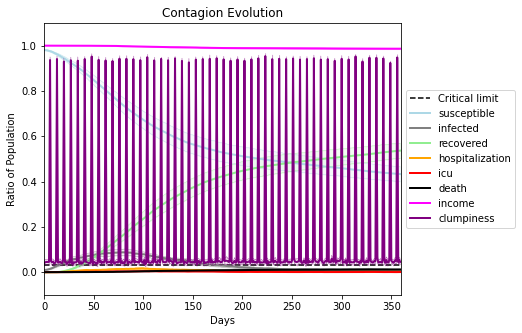

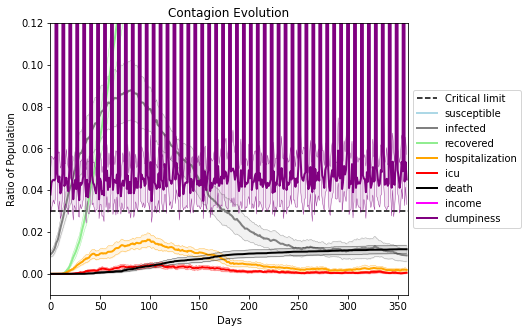

In [13]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.992
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[3448, 1080, 6038, 5027, 7046, 9173, 1135, 9883, 4790, 5758, 9611, 9325, 2370, 6682, 5101, 9483, 7128, 3857, 4905, 9747]
Average similarity between family members is 0.9115134482029714 at temperature -0.991
Average similarity between family and home is 0.9998497295967107 at temperature -1
Average similarity between students and their classroom is 0.5223896648124229 at temperature -0.991
Average classroom occupancy is 4.470588235294118 and number classrooms is 68
Average similarity between workers is 0.831590308320938 at temperature -0.991
Average office occupancy is 3.345360824742268 and number offices is 194
Average friend similarity for adults: 0.8376584455612024 for kids: 0.6609752234583559
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildin

avg restaurant similarity 0.5026302922883231
avg restaurant similarity 0.4071824767600294
avg restaurant similarity 0.46420593955709877
avg restaurant similarity 0.27895933955023294
avg restaurant similarity 0.682121513330001
avg restaurant similarity 0.4301996132116564
avg restaurant similarity 0.4265807324025525
avg restaurant similarity 0.4357569979575028
avg restaurant similarity 0.5272175556762535
avg restaurant similarity 0.6905451355007843
avg restaurant similarity 0.3563591720980643
avg restaurant similarity 0.618201629786636
avg restaurant similarity -0.025595735995831953
avg restaurant similarity 0.5040238869338318
avg restaurant similarity 0.27564723942485736
avg restaurant similarity 0.5930131917727597
avg restaurant similarity 0.3441504480814962
avg restaurant similarity 0.43601415741038185
avg restaurant similarity 0.5471798672866293
avg restaurant similarity 0.6317085502168813
avg restaurant similarity 0.3402288510925282
avg restaurant similarity 0.41272724541602696
avg 

avg restaurant similarity 0.4280148398188681
avg restaurant similarity 0.6675905129299713
avg restaurant similarity 0.8020622089683724
avg restaurant similarity 0.3508470078239788
avg restaurant similarity 0.5168215264500915
avg restaurant similarity 0.43534657421238754
avg restaurant similarity 0.5274001905350623
avg restaurant similarity 0.5007411385295744
avg restaurant similarity 0.3083228312297922
avg restaurant similarity 0.7203126875087458
avg restaurant similarity 0.3889144430795135
avg restaurant similarity 0.4947343811588019
avg restaurant similarity 0.5293420945536156
avg restaurant similarity 0.5705091894795774
avg restaurant similarity 0.5389944897234444
avg restaurant similarity 0.5325071802479164
avg restaurant similarity 0.7140951581977996
avg restaurant similarity 0.5702949936082109
avg restaurant similarity 0.5600655658755048
avg restaurant similarity 0.45585383821883735
avg restaurant similarity 0.999576526397822
avg restaurant similarity 0.4949575659237425
avg resta

avg restaurant similarity 0.6106219338919991
avg restaurant similarity 0.7882932239938504
avg restaurant similarity 0.8243737706467205
avg restaurant similarity 0.6272703857433889
avg restaurant similarity 0.5153625422041828
avg restaurant similarity 0.4834114390934558
avg restaurant similarity 0.44357195651427656
avg restaurant similarity 0.5918011435787456
avg restaurant similarity 0.6957591997909646
avg restaurant similarity 0.4294865326955182
avg restaurant similarity 0.9996145840526979
avg restaurant similarity 0.4635934292486098
avg restaurant similarity 0.2824895548940637
avg restaurant similarity 0.37739720366390594
avg restaurant similarity 0.5332342181705705
avg restaurant similarity 0.559877343926251
avg restaurant similarity 0.5297906989315436
avg restaurant similarity 0.19957192188613937
avg restaurant similarity 0.37858402636268834
avg restaurant similarity 0.408798127741216
avg restaurant similarity 0.9998895074715727
avg restaurant similarity 0.517174062935986
avg resta

avg restaurant similarity 0.4750190720346662
avg restaurant similarity 0.510300767810179
avg restaurant similarity 0.6386373525762847
avg restaurant similarity 0.45086234312690054
avg restaurant similarity 0.7293636493528313
avg restaurant similarity 0.8981462666016766
avg restaurant similarity 0.5554565502113087
avg restaurant similarity 0.33537474091624697
avg restaurant similarity 0.5115228331430043
avg restaurant similarity 0.683175047754103
avg restaurant similarity 0.6764871001029534
avg restaurant similarity 0.6618202215851214
avg restaurant similarity 0.45086234312690054
avg restaurant similarity 0.8019090065054215
avg restaurant similarity 0.5271860839693596
avg restaurant similarity 0.40157227648139915
avg restaurant similarity 0.6564795373569378
avg restaurant similarity 0.4991832282344525
avg restaurant similarity 0.4551040982377956
avg restaurant similarity 0.5913982833643119
avg restaurant similarity 0.4607455192904835
avg restaurant similarity 0.8308508764332422
avg rest

avg restaurant similarity 0.7498785379050077
avg restaurant similarity 0.5571049136469038
avg restaurant similarity 0.8199605712391489
avg restaurant similarity 0.3963129829013847
avg restaurant similarity 0.5582320069094054
avg restaurant similarity 0.6860460508673748
avg restaurant similarity 0.5331537723282148
avg restaurant similarity 0.23383394855576659
avg restaurant similarity 0.582117641561922
avg restaurant similarity 0.6371739620643027
avg restaurant similarity 0.24857409926068535
avg restaurant similarity 0.35418283866011163
avg restaurant similarity 0.663892258597276
avg restaurant similarity 0.24962530075550712
avg restaurant similarity 0.840618660034422
avg restaurant similarity 0.31801261610751363
avg restaurant similarity 0.2503353165432737
avg restaurant similarity 0.41080458076016124
avg restaurant similarity 0.6671550061265291
avg restaurant similarity 0.5284003623233686
avg restaurant similarity 0.4122154649292127
avg restaurant similarity 0.6062755623938935
avg res

avg restaurant similarity 0.6304791657245571
avg restaurant similarity 0.9056761266315012
avg restaurant similarity 0.4283147092390809
avg restaurant similarity 0.4038142281381034
avg restaurant similarity 0.6722008568084932
avg restaurant similarity 0.1484264495105429
avg restaurant similarity 0.6639661570736988
avg restaurant similarity 0.5607386159163462
avg restaurant similarity 0.3139082384924529
avg restaurant similarity 0.4021823348119745
avg restaurant similarity 0.8775333879217883
avg restaurant similarity 0.6397178337365348
avg restaurant similarity 0.23107719878152103
avg restaurant similarity 0.77267279888321
avg restaurant similarity 0.41913584298196727
avg restaurant similarity 0.4868287825383016
avg restaurant similarity 0.8258884101393427
avg restaurant similarity 0.77267279888321
avg restaurant similarity 0.6754584296178414
avg restaurant similarity 0.7909916549981206
avg restaurant similarity 0.3493138726417446
avg restaurant similarity 0.5195597639845322
avg restaura

avg restaurant similarity 0.67669797053533
avg restaurant similarity 0.2226732656916194
avg restaurant similarity 0.4898402762685219
avg restaurant similarity 0.44267554105391993
avg restaurant similarity 0.4004890352267361
avg restaurant similarity 0.5426847681460233
avg restaurant similarity 0.43354052411241706
avg restaurant similarity 0.3302880680964332
avg restaurant similarity 0.34771329864476547
avg restaurant similarity 0.41258021571687176
avg restaurant similarity 0.6672235486062957
avg restaurant similarity 0.5083647281289728
avg restaurant similarity 0.2143494079384862
avg restaurant similarity 0.8129549938063478
avg restaurant similarity 0.5467826888931493
avg restaurant similarity 0.44323694197326985
avg restaurant similarity 0.39854293774989796
avg restaurant similarity 0.3770001617651845
avg restaurant similarity 0.9995055942622306
avg restaurant similarity 0.384789320829642
avg restaurant similarity 0.8112105497454412
avg restaurant similarity 0.4392048473558517
avg res

avg restaurant similarity 0.6772143088065792
avg restaurant similarity 0.9997774839246436
avg restaurant similarity 0.9074098327003235
avg restaurant similarity 0.6893589300309997
avg restaurant similarity 0.8540004134809798
avg restaurant similarity 0.2865856967315061
avg restaurant similarity 0.6409303142814198
avg restaurant similarity 0.5751996887313254
avg restaurant similarity 0.39855850877154536
avg restaurant similarity 0.43503660316434584
avg restaurant similarity 0.8453164185397154
avg restaurant similarity 0.46274862419803175
avg restaurant similarity 0.8215481601454085
avg restaurant similarity 0.5912262630649504
avg restaurant similarity 0.817444568000028
avg restaurant similarity 0.44828653388687845
avg restaurant similarity 0.445631758211042
avg restaurant similarity 0.23695759686917986
avg restaurant similarity 0.4310344532319649
avg restaurant similarity 0.5804986134530792
avg restaurant similarity 0.3280900061572077
avg restaurant similarity 0.12312207646597155
avg re

avg restaurant similarity 0.84034061785971
avg restaurant similarity 0.41962987433385107
avg restaurant similarity 0.5879455706198901
avg restaurant similarity 0.24761717214610124
avg restaurant similarity 0.3249203033269651
avg restaurant similarity 0.20840843755495714
avg restaurant similarity 0.8283642666948288
avg restaurant similarity 0.36811042750319345
avg restaurant similarity 0.38213062123437325
avg restaurant similarity 0.03269024126819642
avg restaurant similarity 0.6619655440428653
avg restaurant similarity 0.5803397398615032
avg restaurant similarity 0.272487631793506
avg restaurant similarity 0.40726382226848884
avg restaurant similarity 0.678577443209549
avg restaurant similarity 0.4236550100265184
avg restaurant similarity 0.2144847136812918
avg restaurant similarity 0.2555871886417759
avg restaurant similarity 0.5618599880163088
avg restaurant similarity 0.25875576812129475
avg restaurant similarity 0.922886323896376
avg restaurant similarity 0.659783322530894
avg rest

avg restaurant similarity 0.4402473545231981
avg restaurant similarity 0.8248769987605866
avg restaurant similarity 0.5290088773696039
avg restaurant similarity 0.5577390960617212
avg restaurant similarity 0.4199177390171129
avg restaurant similarity 0.4455143815266864
avg restaurant similarity 0.8272719760111988
avg restaurant similarity 0.301240476635174
avg restaurant similarity 0.8874508683853208
avg restaurant similarity 0.4273712337378114
avg restaurant similarity 0.5632864710788106
avg restaurant similarity 0.49331520497989817
avg restaurant similarity 0.3036528472552349
avg restaurant similarity 0.44586116548071697
avg restaurant similarity 0.42184598722689365
avg restaurant similarity 0.28773468272634606
avg restaurant similarity 0.7082284059510385
avg restaurant similarity 0.5094772430544519
avg restaurant similarity 0.3209106261437148
avg restaurant similarity 0.64817134166767
avg restaurant similarity 0.39932683862193674
avg restaurant similarity 0.4650041863698487
avg rest

avg restaurant similarity 0.5172289267768895
avg restaurant similarity 0.5205892332489839
avg restaurant similarity 0.40749773524563637
avg restaurant similarity 0.35148210753506426
avg restaurant similarity 0.39613992350157445
avg restaurant similarity 0.113007762598245
avg restaurant similarity 0.9998419386824955
avg restaurant similarity 0.44589734762785327
avg restaurant similarity 0.6190783595804955
avg restaurant similarity 0.5879590029339583
avg restaurant similarity 0.32399544486545623
avg restaurant similarity 0.20934336297610995
avg restaurant similarity 0.4482983152384301
avg restaurant similarity 0.582622859096402
avg restaurant similarity 0.41959307587375183
avg restaurant similarity 0.5498156793178093
avg restaurant similarity 0.4497145875929253
avg restaurant similarity 0.4734140292497307
avg restaurant similarity 0.6104339444515952
avg restaurant similarity 0.7126439076724268
avg restaurant similarity 0.21856617572164627
avg restaurant similarity 0.39152629280771045
avg

avg restaurant similarity 0.622039898652093
avg restaurant similarity 0.5799539689379299
avg restaurant similarity 0.15287508756215074
avg restaurant similarity 0.3817217571088162
avg restaurant similarity 0.4409236918192716
avg restaurant similarity 0.4440260057498826
avg restaurant similarity 0.435840527925513
avg restaurant similarity 0.46341675027286244
avg restaurant similarity 0.43451844344057655
avg restaurant similarity 0.6032539291855736
avg restaurant similarity 0.37505679058218944
avg restaurant similarity 0.587122242285716
avg restaurant similarity 0.16262753598401436
avg restaurant similarity 0.6252265424368887
avg restaurant similarity 0.38279530487529406
avg restaurant similarity 0.3998330968453849
avg restaurant similarity 0.3615295928157206
avg restaurant similarity 0.3182093065527684
avg restaurant similarity 0.4100182035779555
avg restaurant similarity 0.9309640892787635
avg restaurant similarity 0.3998330968453849
avg restaurant similarity 0.49455253450834014
avg re

avg restaurant similarity 0.5415326097938408
avg restaurant similarity 0.708569986618446
avg restaurant similarity 0.6372922624199882
avg restaurant similarity 0.6776747082586808
avg restaurant similarity 0.9996083324005594
avg restaurant similarity 0.5478246349457953
avg restaurant similarity 0.7721002231651395
avg restaurant similarity 0.4341546837159153
avg restaurant similarity 0.9996654199457153
avg restaurant similarity 0.3643958958362761
avg restaurant similarity 0.9999028238841322
avg restaurant similarity 0.37257648465876786
avg restaurant similarity 0.46125907563652485
avg restaurant similarity 0.3917673245587844
avg restaurant similarity 0.49224473766893984
avg restaurant similarity 0.36602995596805743
avg restaurant similarity 0.3831928089766038
avg restaurant similarity 0.3850209589850668
avg restaurant similarity 0.2840659182001752
avg restaurant similarity 0.22697679849965688
avg restaurant similarity 0.40830945004597047
avg restaurant similarity 0.3142187575770872
avg r

avg restaurant similarity 0.006735861172310731
avg restaurant similarity 0.6162126670628165
avg restaurant similarity 0.43694628183312595
avg restaurant similarity 0.5240988028139814
avg restaurant similarity 0.5007634912996973
avg restaurant similarity 0.5793786544071331
avg restaurant similarity 0.27347729223312633
avg restaurant similarity 0.45510640488188203
avg restaurant similarity 0.4821817245283558
avg restaurant similarity 0.389111580618574
avg restaurant similarity 0.8660530968527924
avg restaurant similarity 0.32655732196750575
avg restaurant similarity 0.561916459155128
avg restaurant similarity 0.34679775411824443
avg restaurant similarity 0.48667015397142455
avg restaurant similarity 0.3340060157577539
avg restaurant similarity 0.4169974241754928
avg restaurant similarity 0.3263220750991769
avg restaurant similarity 0.38338329744351407
avg restaurant similarity 0.3117793985000865
avg restaurant similarity 0.5091069090416442
avg restaurant similarity 0.726952710142852
avg 

avg restaurant similarity 0.9991397868646748
avg restaurant similarity 0.3746724074977291
avg restaurant similarity 0.6961786968864323
avg restaurant similarity 0.35125763037136504
avg restaurant similarity 0.6159078246236946
avg restaurant similarity 0.7020346811156677
avg restaurant similarity 0.3801065585161663
avg restaurant similarity 0.2621271392804411
avg restaurant similarity 0.2732447147205006
avg restaurant similarity 0.38292748526438103
avg restaurant similarity 0.2972209999233375
avg restaurant similarity 0.41663735450529815
avg restaurant similarity 0.6878513689175914
avg restaurant similarity 0.41667156449010917
avg restaurant similarity 0.35125763037136504
avg restaurant similarity 0.5314048221358791
avg restaurant similarity 0.27912874933633375
avg restaurant similarity 0.8504973226869629
avg restaurant similarity 0.3830410932367873
avg restaurant similarity 0.47103960055169214
avg restaurant similarity 0.35125763037136504
avg restaurant similarity 0.6738844432213815
av

avg restaurant similarity 0.5453941905288722
avg restaurant similarity 0.5429078541259382
avg restaurant similarity 0.6811956665685837
avg restaurant similarity 0.4430537352117381
avg restaurant similarity 0.42518766195407426
avg restaurant similarity 0.6075081364074085
avg restaurant similarity 0.4183636651273454
avg restaurant similarity 0.5315074344358017
avg restaurant similarity 0.5491585979558556
avg restaurant similarity 0.5392268946257579
avg restaurant similarity 0.6075081364074085
avg restaurant similarity 0.5277879979532539
avg restaurant similarity 0.5785567186958185
avg restaurant similarity 0.5404593649663265
avg restaurant similarity 0.44328933246715174
avg restaurant similarity 0.7874064721554296
avg restaurant similarity 0.5665982291858334
avg restaurant similarity 0.7881606134186627
avg restaurant similarity 0.4392536072747385
avg restaurant similarity 0.46799602132194684
avg restaurant similarity 0.23831951093761294
avg restaurant similarity 0.18184029381074296
avg r

avg restaurant similarity 0.5770968748858623
avg restaurant similarity 0.4004191267383627
avg restaurant similarity 0.7142667432720567
avg restaurant similarity -0.03642375373113693
avg restaurant similarity 0.38270153153868
avg restaurant similarity 0.576320226210794
avg restaurant similarity 0.8531551668163287
avg restaurant similarity 0.858402008320037
avg restaurant similarity 0.514586696772349
avg restaurant similarity 0.5560710363043271
avg restaurant similarity 0.49796166279772414
avg restaurant similarity 0.9997660353612661
avg restaurant similarity 0.6200596780891884
avg restaurant similarity 0.39661031358715243
avg restaurant similarity 0.4430401015496951
avg restaurant similarity 0.615359445518249
avg restaurant similarity 0.61991497049034
avg restaurant similarity 0.5789910442704356
avg restaurant similarity 0.5278870508718211
avg restaurant similarity 0.22283208072067834
avg restaurant similarity 0.4073431574327633
avg restaurant similarity 0.3261679110097582
avg restauran

avg restaurant similarity 0.9997058513010624
avg restaurant similarity 0.58271100166757
avg restaurant similarity 0.51989705721108
avg restaurant similarity 0.5789910442704356
avg restaurant similarity 0.4151135906003485
avg restaurant similarity 0.40058564633388377
avg restaurant similarity 0.5534633057833482
avg restaurant similarity 0.6268312832949615
avg restaurant similarity 0.705336689712587
avg restaurant similarity 0.5361665402489697
avg restaurant similarity 0.4821108657620368
avg restaurant similarity 0.5308977815891855
avg restaurant similarity 0.3654564145262319
Average similarity between family members is 0.9124466903984197 at temperature -0.991
Average similarity between family and home is 0.9998457166396406 at temperature -1
Average similarity between students and their classroom is 0.5011885620453992 at temperature -0.991
Average classroom occupancy is 4.185714285714286 and number classrooms is 70
Average similarity between workers is 0.8252463884548036 at temperature -

avg restaurant similarity 0.3275032206001345
avg restaurant similarity 0.3270808626411796
avg restaurant similarity 0.7687065938630256
avg restaurant similarity 0.5945360759919667
avg restaurant similarity 0.43253008673015314
avg restaurant similarity 0.34011249602226534
avg restaurant similarity 0.2729806643320438
avg restaurant similarity 0.5058654872342829
avg restaurant similarity 0.497252151880225
avg restaurant similarity 0.44063823605735386
avg restaurant similarity 0.5195106654468724
avg restaurant similarity 0.8841657125151483
avg restaurant similarity 0.5045308483954852
avg restaurant similarity 0.5207742480055064
avg restaurant similarity 0.4956434518114282
avg restaurant similarity 0.36283794127161634
avg restaurant similarity 0.5302416160560879
avg restaurant similarity 0.48658933084666367
avg restaurant similarity 0.204370174106698
avg restaurant similarity 0.48849763570961285
avg restaurant similarity 0.5083283728152472
avg restaurant similarity 0.4701762663357342
avg re

avg restaurant similarity 0.5560708575634458
avg restaurant similarity 0.7524278846502936
avg restaurant similarity 0.44406260010117243
avg restaurant similarity 0.28770985772495467
avg restaurant similarity 0.3270534426402054
avg restaurant similarity 0.4216188297953015
avg restaurant similarity 0.25972775721530095
avg restaurant similarity 0.3418511284305148
avg restaurant similarity 0.4096912509009863
avg restaurant similarity 0.503324252828073
avg restaurant similarity 0.4208754145324226
avg restaurant similarity 0.3996687962365564
avg restaurant similarity 0.39337016609802117
avg restaurant similarity 0.33962252604996557
avg restaurant similarity 0.5739589668446057
avg restaurant similarity 0.6387233100755536
avg restaurant similarity 0.3659095091797817
avg restaurant similarity 0.6312248020304877
avg restaurant similarity 0.804506222890159
avg restaurant similarity 0.8757776951626673
avg restaurant similarity 0.29483639903372083
avg restaurant similarity 0.6093627914271871
avg re

avg restaurant similarity 0.8179817478186427
avg restaurant similarity 0.36382592736800307
avg restaurant similarity 0.44457869537446915
avg restaurant similarity 0.34670229763526145
avg restaurant similarity 0.39212126219536597
avg restaurant similarity 0.5440302536736925
avg restaurant similarity 0.6186208882601696
avg restaurant similarity 0.5130347408743805
avg restaurant similarity 0.45826898749392725
avg restaurant similarity 0.33820374461970715
avg restaurant similarity 0.6158021360973135
avg restaurant similarity 0.45018395951164036
avg restaurant similarity 0.37514217018199303
avg restaurant similarity 0.3357071406696876
avg restaurant similarity 0.2232937929173514
avg restaurant similarity 0.19244999486100728
avg restaurant similarity 0.7913578999583593
avg restaurant similarity 0.3893136474062851
avg restaurant similarity 0.48259988129518894
avg restaurant similarity 0.6715171131759238
avg restaurant similarity 0.7913578999583593
avg restaurant similarity 0.4941648617471679


(<function dict.items>, <function dict.items>, <function dict.items>)

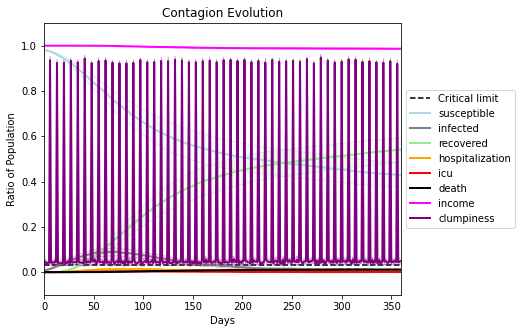

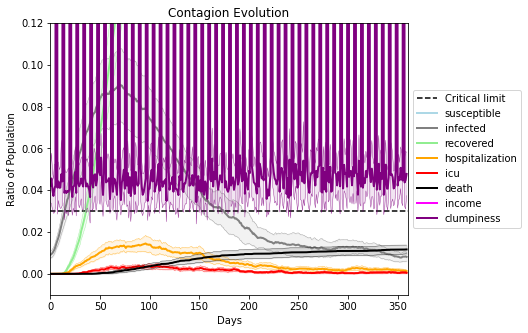

In [14]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.991
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[6157, 1086, 935, 933, 2803, 9194, 2031, 1303, 8840, 5174, 8173, 748, 9517, 3092, 2756, 3741, 7447, 2769, 64, 5198]
Average similarity between family members is 0.9087042694265307 at temperature -0.99
Average similarity between family and home is 0.9998612502069287 at temperature -1
Average similarity between students and their classroom is 0.44950059693810906 at temperature -0.99
Average classroom occupancy is 4.114285714285714 and number classrooms is 70
Average similarity between workers is 0.812447058705686 at temperature -0.99
Average office occupancy is 3.314720812182741 and number offices is 197
Average friend similarity for adults: 0.8374886590087843 for kids: 0.6481053175423844
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homoge

avg restaurant similarity 0.548482357576273
avg restaurant similarity 0.6321139507405716
avg restaurant similarity 0.330276727603183
avg restaurant similarity 0.6134353988588851
avg restaurant similarity 0.22233920758451992
avg restaurant similarity 0.3796972444963492
avg restaurant similarity 0.4375561474469364
avg restaurant similarity 0.29733817458513584
avg restaurant similarity 0.29335108215482486
avg restaurant similarity 0.6712930191805639
avg restaurant similarity 0.6697136578719199
avg restaurant similarity 0.37128242760874275
avg restaurant similarity 0.4277369706468418
avg restaurant similarity 0.5822341945257169
avg restaurant similarity 0.6757175607333962
avg restaurant similarity 0.8467927999849634
avg restaurant similarity 0.7415508112122423
avg restaurant similarity 0.5472745092673175
avg restaurant similarity 0.47543357243921086
avg restaurant similarity 0.4869985328869898
avg restaurant similarity 0.6586211914067126
avg restaurant similarity 0.7709682970473001
avg res

avg restaurant similarity 0.45866491776492246
avg restaurant similarity 0.3276514627677385
avg restaurant similarity 0.41567435028188765
avg restaurant similarity 0.616935265949254
avg restaurant similarity 0.6405923206004596
avg restaurant similarity 0.38739842114484063
avg restaurant similarity 0.38812888562244136
avg restaurant similarity 0.7945838506087625
avg restaurant similarity 0.5732130333003544
avg restaurant similarity 0.21195309500842907
avg restaurant similarity 0.5704791883873327
avg restaurant similarity 0.6320234511668401
avg restaurant similarity 0.3526643608174135
avg restaurant similarity 0.5677045844243793
avg restaurant similarity 0.25698702308147636
avg restaurant similarity 0.28862683212331375
avg restaurant similarity 0.6339294850603823
avg restaurant similarity 0.22047909791642437
avg restaurant similarity 0.5127611480218316
avg restaurant similarity 0.38994831585110523
avg restaurant similarity 0.5090962097904728
avg restaurant similarity 0.43597403259740997
a

avg restaurant similarity 0.21267719811999367
avg restaurant similarity 0.3888605489658493
avg restaurant similarity 0.5793743461149907
avg restaurant similarity 0.748735367534672
avg restaurant similarity 0.41245625250468254
avg restaurant similarity 0.3074313262710716
avg restaurant similarity 0.2958177872222903
avg restaurant similarity 0.7636285148564471
avg restaurant similarity 0.667998767946248
avg restaurant similarity 0.5515428388227119
avg restaurant similarity 0.5114161818869738
avg restaurant similarity 0.8362857475217578
avg restaurant similarity 0.4498351648930896
avg restaurant similarity 0.7478427636112177
avg restaurant similarity 0.4868215466985632
avg restaurant similarity 0.3378756728977188
avg restaurant similarity 0.4775734572446326
avg restaurant similarity 0.7136691539131839
avg restaurant similarity 0.6602947745038403
avg restaurant similarity 0.33850867641363513
avg restaurant similarity 0.14747256628794375
avg restaurant similarity 0.27731085454873344
avg res

avg restaurant similarity 0.8716794472432438
avg restaurant similarity 0.5196110429326931
avg restaurant similarity 0.3525971516261127
avg restaurant similarity 0.9998101794884744
avg restaurant similarity 0.5378956630852723
avg restaurant similarity 0.41810322460193616
avg restaurant similarity 0.3338202550075799
avg restaurant similarity 0.32214175346960927
avg restaurant similarity 0.5681521759086351
avg restaurant similarity 0.5522435283885194
avg restaurant similarity 0.8292478900526057
avg restaurant similarity 0.32214175346960927
avg restaurant similarity 0.5054417167031361
avg restaurant similarity 0.3262819073553654
avg restaurant similarity 0.45061456792159993
avg restaurant similarity 0.892722685905569
avg restaurant similarity 0.19351206729661635
avg restaurant similarity 0.5723747851757395
avg restaurant similarity 0.42183928083691047
avg restaurant similarity 0.3628853722220938
avg restaurant similarity 0.4223568405227578
avg restaurant similarity 0.4909635528265649
avg r

avg restaurant similarity 0.9373561958196496
avg restaurant similarity 0.49023946189506923
avg restaurant similarity 0.4641527437797793
avg restaurant similarity 0.6042354892299989
avg restaurant similarity 0.6025802611120848
avg restaurant similarity 0.46510894692707516
avg restaurant similarity 0.33031468910112727
avg restaurant similarity 0.5531804852309944
avg restaurant similarity 0.8568804760391409
avg restaurant similarity 0.3115171063120939
avg restaurant similarity 0.6710977413021436
avg restaurant similarity 0.38969733508273663
avg restaurant similarity 0.5139453495080363
avg restaurant similarity 0.22168540361237854
avg restaurant similarity 0.7470746751889492
avg restaurant similarity 0.35928629527303946
avg restaurant similarity 0.9998234830355872
avg restaurant similarity 0.6485261140746735
avg restaurant similarity 0.36337091569746055
avg restaurant similarity 0.4559543158892024
avg restaurant similarity 0.846208337620785
avg restaurant similarity 0.3771554487147961
avg 

avg restaurant similarity 0.4891636819440376
avg restaurant similarity 0.4284479255216063
avg restaurant similarity 0.4215192005519374
avg restaurant similarity 0.4142721441980364
avg restaurant similarity 0.272684529946572
avg restaurant similarity 0.3840557582922723
avg restaurant similarity 0.8127451445325073
avg restaurant similarity 0.3721940549950307
avg restaurant similarity 0.5845739189481852
avg restaurant similarity 0.5318479927438102
avg restaurant similarity 0.5141420381805542
avg restaurant similarity 0.5439104565093577
avg restaurant similarity 0.2858402407247458
avg restaurant similarity 0.5241134649739365
avg restaurant similarity 0.46486605988436647
avg restaurant similarity 0.6234762785811117
avg restaurant similarity 0.3712374269637623
avg restaurant similarity 0.3549271067397858
avg restaurant similarity 0.4215509219496865
avg restaurant similarity 0.448650600121068
avg restaurant similarity 0.6221401977121299
avg restaurant similarity 0.27344866911564825
avg restau

avg restaurant similarity 0.4013165915236596
avg restaurant similarity 0.5357808149705063
avg restaurant similarity 0.4633182505990944
avg restaurant similarity 0.43131666197753943
avg restaurant similarity 0.3182163585994971
avg restaurant similarity 0.35990447943694526
avg restaurant similarity 0.5092632585352683
avg restaurant similarity 0.5041861723014742
avg restaurant similarity 0.999766781291408
avg restaurant similarity 0.5159553249373807
avg restaurant similarity 0.6900870591367954
avg restaurant similarity 0.4560916576855064
avg restaurant similarity 0.521361093461018
avg restaurant similarity 0.7433265052327723
avg restaurant similarity 0.9234086748029843
avg restaurant similarity 0.5007448314884965
avg restaurant similarity 0.5172109336130912
avg restaurant similarity 0.4797741555035913
avg restaurant similarity 0.47566048147243634
avg restaurant similarity 0.9233652442926954
avg restaurant similarity 0.24601214719087675
avg restaurant similarity 0.9995760159035743
avg rest

avg restaurant similarity 0.9990109689679649
avg restaurant similarity 0.3683032120267897
avg restaurant similarity 0.402439112935432
avg restaurant similarity 0.3651460849883375
avg restaurant similarity 0.5521538962425597
avg restaurant similarity 0.2577586021087098
avg restaurant similarity 0.5274665724640477
avg restaurant similarity 0.8631085764234321
avg restaurant similarity 0.7749579879416242
avg restaurant similarity 0.2278611516658069
avg restaurant similarity 0.3255069880387331
avg restaurant similarity 0.5845399260132567
avg restaurant similarity 0.48946459246442
avg restaurant similarity 0.3852148754900474
avg restaurant similarity 0.5189770468047997
avg restaurant similarity 0.5050488333254567
avg restaurant similarity 0.22794045250889905
avg restaurant similarity 0.40851669641855054
avg restaurant similarity 0.3716668631416957
avg restaurant similarity 0.4440793891878291
avg restaurant similarity 0.29125981886936836
avg restaurant similarity 0.5198409769757653
avg restau

Average similarity between family members is 0.9081017561191597 at temperature -0.99
Average similarity between family and home is 0.9998676245712317 at temperature -1
Average similarity between students and their classroom is 0.5126485109722079 at temperature -0.99
Average classroom occupancy is 3.887323943661972 and number classrooms is 71
Average similarity between workers is 0.821564212036956 at temperature -0.99
Average office occupancy is 3.3668341708542715 and number offices is 199
Average friend similarity for adults: 0.8331622157746026 for kids: 0.6596845131495316
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) 

avg restaurant similarity 0.456220004012113
avg restaurant similarity 0.05711333794667846
avg restaurant similarity 0.36850898630550216
avg restaurant similarity 0.5330430982115034
avg restaurant similarity 0.45629994211589797
avg restaurant similarity 0.5756498690476528
avg restaurant similarity 0.8772957046745937
avg restaurant similarity 0.8772957046745937
avg restaurant similarity 0.7134752927998723
avg restaurant similarity 0.37784065863059135
avg restaurant similarity 0.5903302078261494
avg restaurant similarity 0.48339762220489
avg restaurant similarity 0.5443599971011948
avg restaurant similarity 0.4677675755994303
avg restaurant similarity 0.5619801668156958
avg restaurant similarity 0.6222221630436735
avg restaurant similarity 0.49898991437685664
avg restaurant similarity 0.35036312949145204
avg restaurant similarity 0.6989469958962298
avg restaurant similarity 0.244282064297934
avg restaurant similarity 0.6416715427850541
avg restaurant similarity 0.5981680411637018
avg rest

avg restaurant similarity 0.9996725745090398
avg restaurant similarity 0.31440073872498103
avg restaurant similarity 0.28920308964658803
avg restaurant similarity 0.4147005430751477
avg restaurant similarity 0.8715508270282525
avg restaurant similarity 0.9237610066255668
avg restaurant similarity 0.3150093048134647
avg restaurant similarity 0.7424145467781791
Average similarity between family members is 0.8958033043169383 at temperature -0.99
Average similarity between family and home is 0.999852364008527 at temperature -1
Average similarity between students and their classroom is 0.47069896418285107 at temperature -0.99
Average classroom occupancy is 4.202898550724638 and number classrooms is 69
Average similarity between workers is 0.8064424836221781 at temperature -0.99
Average office occupancy is 3.4278350515463916 and number offices is 194
Average friend similarity for adults: 0.8258517735719254 for kids: 0.6374357215976653
home_districts
[
Home (0,0) district with 1 Buildings
Hom

avg restaurant similarity 0.7213394898705712
avg restaurant similarity 0.6366999645620893
avg restaurant similarity 0.13412493605062376
avg restaurant similarity 0.35055917813477266
avg restaurant similarity 0.5012772006974393
avg restaurant similarity 0.5608704487129964
avg restaurant similarity 0.5754013611033473
avg restaurant similarity 0.5265435927653622
avg restaurant similarity 0.4265996345156391
avg restaurant similarity 0.5086331765205928
avg restaurant similarity 0.2558005018197633
avg restaurant similarity 0.4090456967456076
avg restaurant similarity 0.9998334431636313
avg restaurant similarity 0.26824815816730324
avg restaurant similarity 0.7848319534829832
avg restaurant similarity 0.9994287619635769
avg restaurant similarity 0.6573526856736999
avg restaurant similarity 0.4400464966890139
avg restaurant similarity 0.6509547486053585
avg restaurant similarity 0.9996760644771627
avg restaurant similarity 0.7450007703988268
avg restaurant similarity 0.45467005739290733
avg re

avg restaurant similarity 0.35061807946794366
avg restaurant similarity 0.4722199019779989
avg restaurant similarity 0.6588605466927561
avg restaurant similarity 0.3386014172093979
avg restaurant similarity 0.5605717022997162
avg restaurant similarity 0.6057558452948837
avg restaurant similarity 0.39025795539733227
avg restaurant similarity 0.6642380172012214
avg restaurant similarity 0.49613045025133085
avg restaurant similarity 0.3759408054959825
avg restaurant similarity 0.4192561291415333
avg restaurant similarity 0.5671135323270053
avg restaurant similarity 0.5626253893816702
avg restaurant similarity 0.21514929589551976
avg restaurant similarity 0.3832354293049819
avg restaurant similarity 0.32634168736498614
avg restaurant similarity 0.3150509946542274
avg restaurant similarity 0.9173513514534926
avg restaurant similarity 0.3150509946542274
avg restaurant similarity 0.5779330467070708
avg restaurant similarity 0.4036628807730798
avg restaurant similarity 0.5911111674393512
avg r

avg restaurant similarity 0.6802177661245897
avg restaurant similarity 0.4302253401436834
avg restaurant similarity 0.3034302371312686
avg restaurant similarity 0.4811535400811572
avg restaurant similarity 0.4380049967670224
avg restaurant similarity 0.22970888569802472
avg restaurant similarity 0.5355250045096227
avg restaurant similarity 0.2531856766384257
avg restaurant similarity 0.5984113654848779
avg restaurant similarity 0.7634612555897775
avg restaurant similarity 0.4987763949234254
avg restaurant similarity 0.43819819331183374
avg restaurant similarity 0.5191874525531041
avg restaurant similarity 0.577093095503758
avg restaurant similarity 0.8756809119687148
avg restaurant similarity 0.4627158693590131
avg restaurant similarity 0.43508777925583475
avg restaurant similarity 0.5322303261522134
avg restaurant similarity 0.47823176109489846
avg restaurant similarity 0.5319248227465341
avg restaurant similarity 0.5355250045096227
avg restaurant similarity 0.38635690984837756
avg re

avg restaurant similarity 0.5055079505714812
avg restaurant similarity 0.3598778299088169
avg restaurant similarity 0.5991054392981812
avg restaurant similarity 0.41142102428792743
avg restaurant similarity 0.3071621207715737
avg restaurant similarity 0.38530544574349945
avg restaurant similarity 0.3783309745593738
avg restaurant similarity 0.6024683227744245
avg restaurant similarity 0.6433216613638352
avg restaurant similarity 0.5000730398577966
avg restaurant similarity 0.3251660845393594
avg restaurant similarity 0.8158676129705312
avg restaurant similarity 0.7942643694510295
avg restaurant similarity 0.5120552285864577
avg restaurant similarity 0.5961097788831272
avg restaurant similarity 0.35325349608565626
avg restaurant similarity 0.8157647881266895
avg restaurant similarity 0.3469368867968389
avg restaurant similarity 0.41320963147821993
avg restaurant similarity 0.452744039786913
avg restaurant similarity 0.7864394076601633
avg restaurant similarity 0.5887322524451092
avg res

avg restaurant similarity 0.5776675593077538
avg restaurant similarity 0.2871863086429666
avg restaurant similarity 0.26539223266728845
avg restaurant similarity 0.2614212141820558
avg restaurant similarity 0.32999591732968925
avg restaurant similarity 0.3826365634873725
avg restaurant similarity 0.9052085031157391
avg restaurant similarity 0.6573418009505341
avg restaurant similarity 0.5474482532986196
avg restaurant similarity 0.3495239618670485
avg restaurant similarity 0.3713868303916582
avg restaurant similarity 0.9273473230741247
avg restaurant similarity 0.8176516841317956
avg restaurant similarity 0.5864949906192904
avg restaurant similarity 0.26539223266728845
avg restaurant similarity 0.46320947112049987
avg restaurant similarity 0.3231949827157037
avg restaurant similarity 0.5791802037115534
avg restaurant similarity 0.41159809583197743
avg restaurant similarity 0.5184807764122812
avg restaurant similarity 0.2785762573564661
avg restaurant similarity 0.42107398990216227
avg 

Average similarity between family and home is 0.9998619690415682 at temperature -1
Average similarity between students and their classroom is 0.4802274591002102 at temperature -0.99
Average classroom occupancy is 4.071428571428571 and number classrooms is 70
Average similarity between workers is 0.8242954579291886 at temperature -0.99
Average office occupancy is 3.445026178010471 and number offices is 191
Average friend similarity for adults: 0.8353209015019385 for kids: 0.6469856118945269
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 peo

avg restaurant similarity 0.3265273167757781
avg restaurant similarity 0.496219981534152
avg restaurant similarity 0.513627558395199
avg restaurant similarity 0.43709711840505605
avg restaurant similarity 0.6235025175356468
avg restaurant similarity 0.4325768171352119
avg restaurant similarity 0.3991402932594496
avg restaurant similarity 0.5715720779613802
avg restaurant similarity 0.3274244729854737
avg restaurant similarity 0.22757480755905973
avg restaurant similarity 0.40185658253696876
avg restaurant similarity 0.5583004204308057
avg restaurant similarity 0.7981851935150509
avg restaurant similarity 0.5601181038132574
avg restaurant similarity 0.08236692797771417
avg restaurant similarity 0.27426776720796825
avg restaurant similarity 0.4931799199131176
avg restaurant similarity 0.6435302149905431
avg restaurant similarity 0.6292267423868433
avg restaurant similarity 0.6246549402930613
avg restaurant similarity 0.8668896895170916
avg restaurant similarity 0.8918862693879008
avg res

avg restaurant similarity 0.4120177964942636
avg restaurant similarity 0.24107577671948752
avg restaurant similarity 0.4101944656624382
avg restaurant similarity 0.6386796085870208
avg restaurant similarity 0.3467509749681403
avg restaurant similarity 0.3863683967299358
avg restaurant similarity 0.820186862822562
avg restaurant similarity 0.21592464427057068
avg restaurant similarity 0.4819799788590414
avg restaurant similarity 0.4299256197900738
avg restaurant similarity 0.37963119452972605
avg restaurant similarity 0.8463401750095167
avg restaurant similarity 0.5504109154250025
avg restaurant similarity 0.4814925086012811
avg restaurant similarity 0.5474549616195648
avg restaurant similarity 0.4955546276253316
avg restaurant similarity 0.438074157847728
avg restaurant similarity 0.23989020999571314
avg restaurant similarity 0.43580387835147677
avg restaurant similarity 0.527133852196129
avg restaurant similarity 0.527133852196129
avg restaurant similarity 0.4514867101480243
avg resta

avg restaurant similarity 0.28907902187942625
avg restaurant similarity 0.5058573376047865
avg restaurant similarity 0.4502279997798671
avg restaurant similarity 0.530479927549408
avg restaurant similarity 0.54401024278541
avg restaurant similarity 0.3648222774773545
avg restaurant similarity 0.32050697456063226
avg restaurant similarity 0.4375374586105464
avg restaurant similarity 0.27195846052119355
avg restaurant similarity 0.8272380690625838
avg restaurant similarity 0.2205300252371394
avg restaurant similarity 0.38174056181605764
avg restaurant similarity 0.4676285819172869
avg restaurant similarity 0.3493282585912024
avg restaurant similarity 0.5396932946349371
avg restaurant similarity 0.827090927042573
avg restaurant similarity 0.4344519638315202
avg restaurant similarity 0.6569882335343429
avg restaurant similarity 0.5666253284226547
avg restaurant similarity 0.2900633983592137
avg restaurant similarity 0.49013182095275554
avg restaurant similarity 0.3283376756515074
avg resta

avg restaurant similarity 0.5162845102326667
avg restaurant similarity 0.57475026398096
avg restaurant similarity 0.46364054112445124
avg restaurant similarity 0.3623619471594268
avg restaurant similarity 0.672531695546712
avg restaurant similarity -0.09699310482667253
avg restaurant similarity 0.4181147142735395
avg restaurant similarity 0.35701615461754144
avg restaurant similarity 0.821234208407225
avg restaurant similarity 0.4678856401613369
avg restaurant similarity 0.8444138012132261
avg restaurant similarity 0.9992532521728251
avg restaurant similarity 0.9995508128535464
avg restaurant similarity 0.8069422975985957
avg restaurant similarity 0.8176359177612369
avg restaurant similarity 0.48154409409297144
avg restaurant similarity 0.5175695328453674
avg restaurant similarity 0.4833523309460699
avg restaurant similarity 0.507497552032112
avg restaurant similarity 0.4829711185566018
avg restaurant similarity 0.3928130655323624
avg restaurant similarity 0.517912749066981
avg restaur

avg restaurant similarity 0.49845800944014984
avg restaurant similarity 0.2844248315539436
avg restaurant similarity 0.6027430355593464
avg restaurant similarity 0.6777085330021907
avg restaurant similarity 0.5138072659000001
avg restaurant similarity 0.46281534637388416
avg restaurant similarity 0.3802477753961714
avg restaurant similarity 0.8668120491269302
avg restaurant similarity 0.3963304866638255
avg restaurant similarity 0.220167750101389
avg restaurant similarity 0.33461233991711964
avg restaurant similarity 0.7276940951663519
avg restaurant similarity 0.531875775660798
avg restaurant similarity 0.4595744509458715
Average similarity between family members is 0.9067674777601509 at temperature -0.99
Average similarity between family and home is 0.9998412563226903 at temperature -1
Average similarity between students and their classroom is 0.49087451037768404 at temperature -0.99
Average classroom occupancy is 4.264705882352941 and number classrooms is 68
Average similarity betwe

avg restaurant similarity 0.3358496397447882
avg restaurant similarity 0.6857384747486227
avg restaurant similarity 0.39500332857803533
avg restaurant similarity 0.5391594339478006
avg restaurant similarity 0.7869100158229847
avg restaurant similarity 0.5346180605614406
avg restaurant similarity 0.41300746378999537
avg restaurant similarity 0.7284094925948619
avg restaurant similarity 0.39430291195441464
avg restaurant similarity 0.3672671078099785
avg restaurant similarity 0.6594578964205884
avg restaurant similarity 0.59449511381637
avg restaurant similarity 0.3167261512840752
avg restaurant similarity 0.3311998463239674
avg restaurant similarity 0.5494488643490347
avg restaurant similarity 0.4249282950967578
avg restaurant similarity 0.3248826200784652
avg restaurant similarity 0.312869220287728
avg restaurant similarity 0.5411403337319927
avg restaurant similarity 0.9005310146787386
avg restaurant similarity 0.09935852178638632
avg restaurant similarity 0.555031950200201
avg restau

avg restaurant similarity 0.5594685806196354
avg restaurant similarity 0.3570384150961442
avg restaurant similarity 0.44336941439939875
avg restaurant similarity 0.6375776483583908
avg restaurant similarity 0.4385272205637615
avg restaurant similarity 0.5139452221475584
avg restaurant similarity 0.44401862200320275
avg restaurant similarity 0.480316417822747
avg restaurant similarity 0.30301641999040035
avg restaurant similarity 0.3481527221131143
avg restaurant similarity 0.34803996506921037
avg restaurant similarity 0.3459392959142406
avg restaurant similarity 0.46755530046879074
avg restaurant similarity 0.6124549898516968
avg restaurant similarity 0.3544725240414717
avg restaurant similarity 0.5370571579418466
avg restaurant similarity 0.5896157320480558
avg restaurant similarity 0.3606034697396545
avg restaurant similarity 0.7085374845997019
avg restaurant similarity 0.5694756550998558
avg restaurant similarity 0.5111086265370419
avg restaurant similarity 0.7129914267818096
avg re

avg restaurant similarity 0.6506766427331987
avg restaurant similarity 0.6580858302341721
avg restaurant similarity 0.4534621649159477
avg restaurant similarity 0.4540295636468985
avg restaurant similarity 0.6172481026222938
avg restaurant similarity 0.4985145130589217
avg restaurant similarity 0.28941752672074333
avg restaurant similarity 0.39750056542150575
avg restaurant similarity 0.86356384372828
avg restaurant similarity 0.39254406625477467
avg restaurant similarity 0.5366135873140941
avg restaurant similarity 0.42830906876467156
avg restaurant similarity 0.4231628939163527
avg restaurant similarity 0.502232992209533
avg restaurant similarity 0.5806625402243787
avg restaurant similarity 0.6110654302931454
avg restaurant similarity 0.47921498240109284
avg restaurant similarity 0.4033745898740147
avg restaurant similarity 0.5538902718428217
avg restaurant similarity 0.5383772837313723
avg restaurant similarity 0.6981400386125636
using average of time series:
stats on susceptible:
d

(<function dict.items>, <function dict.items>, <function dict.items>)

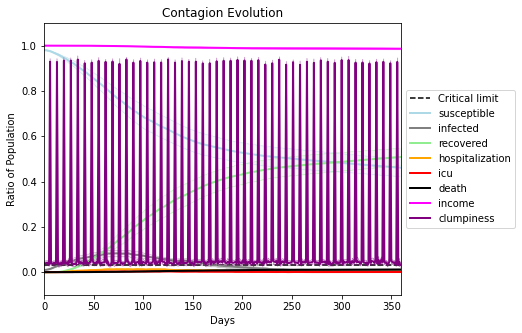

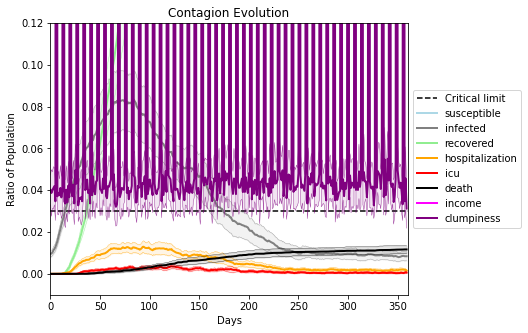

In [32]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.99
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
              [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
], work_home_list = [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
], listeners = listeners)

Save these seeds if you want to rerun a scenario
[9650, 8338, 2534, 6807, 995, 3154, 3678, 964, 3526, 9713, 957, 1059, 5798, 543, 9789, 707, 7341, 8320, 5833, 8983]
Average similarity between family members is 0.5482995044808825 at temperature -0.9
Average similarity between family and home is 0.9998548116607668 at temperature -1
Average similarity between students and their classroom is 0.20286699220862095 at temperature -0.9
Average classroom occupancy is 4.072463768115942 and number classrooms is 69
Average similarity between workers is 0.445774218256898 at temperature -0.9
Average office occupancy is 3.3654822335025383 and number offices is 197
Average friend similarity for adults: 0.5947404991954975 for kids: 0.4458491100718641
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homogene

avg restaurant similarity 0.21537015575702587
avg restaurant similarity 0.16542606623160333
avg restaurant similarity -0.38237868573443556
avg restaurant similarity 0.0006392378537002918
avg restaurant similarity 0.09570657760349328
avg restaurant similarity 0.3661994893431476
avg restaurant similarity 0.09570657760349328
avg restaurant similarity -0.03395908996174666
avg restaurant similarity -0.05366441921991712
avg restaurant similarity -0.26357712432738256
avg restaurant similarity -0.15450330487022215
avg restaurant similarity -0.3804618915155449
avg restaurant similarity -0.03395908996174666
avg restaurant similarity -0.2605233834265958
avg restaurant similarity -0.1565227990608007
avg restaurant similarity -0.42669839586120784
avg restaurant similarity 0.49454659401939843
avg restaurant similarity 0.3744399771121787
avg restaurant similarity -0.1195747281152109
avg restaurant similarity 0.2094595964889463
avg restaurant similarity 0.2093234989159134
avg restaurant similarity 0.1

avg restaurant similarity 0.21379549560824204
avg restaurant similarity 0.7767144051186305
avg restaurant similarity 0.3480040159950171
avg restaurant similarity 0.22785533147153647
avg restaurant similarity -0.028602386070883678
avg restaurant similarity 0.35760101433900227
avg restaurant similarity 0.06125788412485036
avg restaurant similarity 0.31901202926789185
avg restaurant similarity 0.07111227948299698
avg restaurant similarity 0.23286195057453962
avg restaurant similarity 0.7857715778609837
avg restaurant similarity -0.15850870713682375
avg restaurant similarity -0.21438309554893112
avg restaurant similarity 0.26540614538588847
avg restaurant similarity 0.20998025844015697
avg restaurant similarity 0.6614920805371994
avg restaurant similarity 0.31976376830568065
avg restaurant similarity -0.1833582274539256
avg restaurant similarity 0.28493947651117735
avg restaurant similarity -0.02597163342692302
avg restaurant similarity 0.6056629204991615
avg restaurant similarity -0.19186

avg restaurant similarity 0.13428446604199692
avg restaurant similarity 0.4996701260331743
avg restaurant similarity -0.04374315826185163
avg restaurant similarity 0.3124299249914507
avg restaurant similarity 0.14629905736505175
avg restaurant similarity -0.11437269687307847
avg restaurant similarity -0.06196948698861603
avg restaurant similarity 0.4396471529155356
avg restaurant similarity 0.47553853836121773
avg restaurant similarity 0.3291716599171412
avg restaurant similarity 0.13486037204095916
avg restaurant similarity 0.3260822934361586
avg restaurant similarity -0.4307185574563015
avg restaurant similarity 0.21808874750909313
avg restaurant similarity -0.08851098972495919
avg restaurant similarity 0.30807176348980625
avg restaurant similarity -0.06616163987948484
avg restaurant similarity -0.08705422401823068
avg restaurant similarity 0.1262697499734801
avg restaurant similarity -0.07629310654073254
avg restaurant similarity -0.05439474113361639
avg restaurant similarity 0.0232

avg restaurant similarity 0.047088215143717936
avg restaurant similarity -0.3043616746358151
avg restaurant similarity 0.23201617567496896
avg restaurant similarity -0.3079636251709158
avg restaurant similarity 0.434771832230708
avg restaurant similarity -0.023980207472671267
avg restaurant similarity 0.10220799429478829
avg restaurant similarity -0.11200482327219485
avg restaurant similarity 0.16270319445810302
avg restaurant similarity 0.5237552135287585
avg restaurant similarity -0.4651227669536735
avg restaurant similarity -0.3756469305749143
avg restaurant similarity 0.025554250585473375
avg restaurant similarity 0.11834743987175911
avg restaurant similarity 0.06705021504760006
avg restaurant similarity -0.05103116440728887
avg restaurant similarity 0.09314381388544421
avg restaurant similarity 0.1968499911067446
avg restaurant similarity 0.08362281140350226
avg restaurant similarity 0.6725012707780036
avg restaurant similarity 0.09684239826097661
avg restaurant similarity 0.20212

avg restaurant similarity 0.3867807342733153
avg restaurant similarity 0.5237552135287585
avg restaurant similarity 0.29245488200750624
avg restaurant similarity 0.19391753635089287
avg restaurant similarity 0.22509448342638042
avg restaurant similarity -0.09665137272950872
avg restaurant similarity 0.2018926575259643
avg restaurant similarity -0.034219580938601904
avg restaurant similarity 0.4047896171658779
avg restaurant similarity 0.3167244395504352
avg restaurant similarity 0.20212838776427908
avg restaurant similarity 0.6955767476064132
avg restaurant similarity -0.41840556608351603
avg restaurant similarity 0.40765974059250076
avg restaurant similarity -0.10300669642176534
avg restaurant similarity 0.39969333570250676
avg restaurant similarity 0.2109842665228495
avg restaurant similarity -0.03186844854553539
avg restaurant similarity 0.2445579407736201
avg restaurant similarity 0.17196971302823644
avg restaurant similarity 0.06907005273738182
avg restaurant similarity 0.06705021

avg restaurant similarity 0.3099489425563698
avg restaurant similarity 0.07445219717663078
avg restaurant similarity 0.05372480986448849
avg restaurant similarity 0.2753899708479989
avg restaurant similarity 0.042881456481883407
avg restaurant similarity 0.5663163293218373
avg restaurant similarity 0.26720578919586735
avg restaurant similarity -0.18423877185536508
avg restaurant similarity 0.07131039693010899
avg restaurant similarity 0.15665499410382486
avg restaurant similarity 0.10724199683922962
avg restaurant similarity -0.05087538869826744
avg restaurant similarity 0.19150244294345578
avg restaurant similarity 0.33220582049128206
avg restaurant similarity -0.2588242872168419
avg restaurant similarity -0.019329412205308656
avg restaurant similarity -0.16714358868456575
avg restaurant similarity 0.16317607879889506
avg restaurant similarity -0.16174590706670475
avg restaurant similarity 0.34012169238947115
avg restaurant similarity -0.060655998020311755
avg restaurant similarity 0.

avg restaurant similarity -0.26736065444451335
avg restaurant similarity 0.3923845741048748
avg restaurant similarity 0.31077885019610524
avg restaurant similarity 0.2844989905167523
avg restaurant similarity 0.11506374026559438
avg restaurant similarity 0.22238988928661424
avg restaurant similarity 0.11269993284374236
avg restaurant similarity 0.2904842328763579
avg restaurant similarity -0.01832058452690375
avg restaurant similarity 0.046495413826327395
avg restaurant similarity 0.014073966080917408
avg restaurant similarity -0.11746287759162377
avg restaurant similarity 0.12111495405585418
avg restaurant similarity 0.051379959608624834
avg restaurant similarity 0.013521842191187579
avg restaurant similarity 0.2517187698478998
Average similarity between family members is 0.5553734053305263 at temperature -0.9
Average similarity between family and home is 0.9998435036618415 at temperature -1
Average similarity between students and their classroom is 0.16522718586177607 at temperature 

avg restaurant similarity 0.07130339353939767
avg restaurant similarity 0.07967009483145425
avg restaurant similarity 0.03152615300544684
avg restaurant similarity 0.3316883336604176
avg restaurant similarity 0.5816929032087623
avg restaurant similarity 0.025231788040422875
avg restaurant similarity -0.15175014928692232
avg restaurant similarity 0.3312371087828946
avg restaurant similarity 0.4199892282526282
avg restaurant similarity 0.35670739177217736
avg restaurant similarity -0.024526932802229423
avg restaurant similarity 0.25636711476882457
avg restaurant similarity -0.03170167632177043
avg restaurant similarity -0.21357684102259833
avg restaurant similarity 0.2158802716394931
avg restaurant similarity 0.771521411154519
avg restaurant similarity -0.15906576750107315
avg restaurant similarity 0.07914653644040912
avg restaurant similarity 0.33095343483077444
avg restaurant similarity -0.15816524635334403
avg restaurant similarity 0.3368407158689594
avg restaurant similarity 0.242949

avg restaurant similarity 0.010072557039913582
avg restaurant similarity 0.23167742101294275
avg restaurant similarity 0.6252401807795308
avg restaurant similarity 0.23167742101294275
avg restaurant similarity 0.15476047156096776
avg restaurant similarity -0.09019951091095937
avg restaurant similarity -0.023242829705159947
avg restaurant similarity 0.22550450200458733
avg restaurant similarity 0.4795458839402379
avg restaurant similarity 0.41136342237455015
avg restaurant similarity 0.27873965427000624
avg restaurant similarity -0.07142732882200004
avg restaurant similarity -0.08407351308180319
avg restaurant similarity 0.22930002766647337
avg restaurant similarity 0.21452564365020108
avg restaurant similarity -0.14609340843803298
avg restaurant similarity 0.38184570713385846
avg restaurant similarity 0.08811468283592575
avg restaurant similarity 0.11607194871997614
avg restaurant similarity -0.2712258990932266
avg restaurant similarity 0.33057189951895244
avg restaurant similarity 0.5

avg restaurant similarity 0.10547144452067071
avg restaurant similarity 0.1416935509325837
avg restaurant similarity -0.26870686489506224
avg restaurant similarity 0.6474600488247751
avg restaurant similarity 0.4133649588316814
avg restaurant similarity -0.03500682418478087
avg restaurant similarity -0.027124416300859502
avg restaurant similarity -0.25216637295388544
avg restaurant similarity -0.26870686489506224
avg restaurant similarity -0.11237140236961454
avg restaurant similarity 0.3046327578177593
avg restaurant similarity -0.03500682418478087
avg restaurant similarity -0.25533124573661914
avg restaurant similarity -0.004866401943487253
avg restaurant similarity 0.44169352379780624
avg restaurant similarity 0.10626769790853775
avg restaurant similarity -0.013279144189762324
avg restaurant similarity -0.2508060186612809
avg restaurant similarity -0.09272125014659136
avg restaurant similarity 0.18711575016602777
avg restaurant similarity 0.5878006755258989
avg restaurant similarity

avg restaurant similarity 0.0941461184763429
avg restaurant similarity 0.7300804145497126
avg restaurant similarity 0.3293421719264978
avg restaurant similarity 0.4981410062984737
avg restaurant similarity 0.04808281483388952
avg restaurant similarity 0.2485773144262306
avg restaurant similarity 0.42038320442945354
avg restaurant similarity 0.04536518724767894
avg restaurant similarity 0.08726770744635041
avg restaurant similarity 0.19804997766160093
avg restaurant similarity -0.17801140323339493
avg restaurant similarity -0.1614754237995105
avg restaurant similarity -0.16581270547239094
avg restaurant similarity 0.17391765600947098
avg restaurant similarity 0.13181073091344356
avg restaurant similarity 0.10016132671332498
avg restaurant similarity 0.11799665002477676
avg restaurant similarity 0.5923245208173648
avg restaurant similarity -0.2439086004167964
avg restaurant similarity 0.09282829803229796
avg restaurant similarity -0.16581270547239094
avg restaurant similarity 0.886622945

Average friend similarity for adults: 0.6064674496031713 for kids: 0.4521815092616504
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocat

avg restaurant similarity 0.22517961790159394
avg restaurant similarity 0.052376069623487884
avg restaurant similarity 0.03054502879066781
avg restaurant similarity 0.2973091022656794
avg restaurant similarity 0.286575387255398
avg restaurant similarity 0.08790391194031297
avg restaurant similarity 0.2634733280677473
avg restaurant similarity 0.28122254631446714
avg restaurant similarity 0.437135363538562
avg restaurant similarity 0.346489704217927
avg restaurant similarity 0.42257652160069675
avg restaurant similarity 0.3035810237407324
avg restaurant similarity 0.4255803496378845
avg restaurant similarity -0.04144808606242795
avg restaurant similarity 0.06425987944068653
avg restaurant similarity -0.3289182765464136
avg restaurant similarity 0.03766593473378847
avg restaurant similarity 0.10343050462489156
avg restaurant similarity 0.07362841913740979
avg restaurant similarity 0.4164331693176722
avg restaurant similarity 0.24437954231883396
avg restaurant similarity 0.442553787033578

avg restaurant similarity 0.13959525193403588
avg restaurant similarity 0.6628362803627019
avg restaurant similarity 0.06425999987276988
avg restaurant similarity -0.17729656401832838
avg restaurant similarity 0.23023831972631303
avg restaurant similarity 0.4100459902040523
avg restaurant similarity -0.09953213584569091
avg restaurant similarity 0.28765664177786293
avg restaurant similarity 0.43507404091836127
avg restaurant similarity -0.06022903008962135
avg restaurant similarity -0.3471495985777549
avg restaurant similarity -0.021543907564067363
avg restaurant similarity 0.3950623263718325
avg restaurant similarity -0.36286058921001557
avg restaurant similarity -0.0414394756759176
avg restaurant similarity 0.08535888943063871
avg restaurant similarity 0.08549420223957646
avg restaurant similarity -0.13339408606387165
avg restaurant similarity 0.10266145290207042
avg restaurant similarity 0.6045502820921678
avg restaurant similarity 0.07078781340822038
avg restaurant similarity 0.256

avg restaurant similarity 0.2582129703719044
avg restaurant similarity 0.4650392506367975
avg restaurant similarity -0.15653055276800082
avg restaurant similarity 0.06647024697480704
avg restaurant similarity -0.08624876826754335
avg restaurant similarity 0.514717502822588
avg restaurant similarity -0.038923890119323845
avg restaurant similarity 0.28525882965953375
avg restaurant similarity 0.5272941168155677
avg restaurant similarity 0.28525882965953375
avg restaurant similarity -0.07031171699884851
avg restaurant similarity 0.42747213626434677
avg restaurant similarity -0.07934953614321183
avg restaurant similarity 0.06917509573301296
avg restaurant similarity 0.148258204434529
avg restaurant similarity 0.22610730742211538
avg restaurant similarity 0.1966406451235378
avg restaurant similarity 0.07450329235270645
avg restaurant similarity 0.28525882965953375
avg restaurant similarity 0.08559130839785298
avg restaurant similarity 0.4673478148207099
avg restaurant similarity -0.05839938

Average friend similarity for adults: 0.5946000706965777 for kids: 0.4580552511862889
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 20 people.
Total of 20 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 0 allocated units with a total of 0 people.
Total of 0 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocat

avg restaurant similarity 0.06091762253976977
avg restaurant similarity -0.07634899620083789
avg restaurant similarity 0.27327268774335983
avg restaurant similarity 0.13800900304376704
avg restaurant similarity -0.05728740294583341
avg restaurant similarity 0.2469148868119868
avg restaurant similarity -0.24552118113434906
avg restaurant similarity -0.1181889305334567
avg restaurant similarity 0.6120874292749627
avg restaurant similarity -0.3868374246638765
avg restaurant similarity 0.26899386307285994
avg restaurant similarity -0.15511995965994746
avg restaurant similarity 0.18727318805706916
avg restaurant similarity 0.027070062278610432
avg restaurant similarity 0.4703066877968152
avg restaurant similarity -0.052561629101038024
avg restaurant similarity 0.23781553904560884
avg restaurant similarity 0.14713264258205086
avg restaurant similarity -0.017602147891860098
avg restaurant similarity 0.007921229870046717
avg restaurant similarity -0.11269023550866504
avg restaurant similarity 

avg restaurant similarity 0.24208481140976215
avg restaurant similarity -0.19260263958356166
avg restaurant similarity 0.22734052231106583
avg restaurant similarity -0.20733544094590395
avg restaurant similarity 0.06464277245589678
avg restaurant similarity 0.19429760119659112
avg restaurant similarity 0.41271067616098256
avg restaurant similarity -0.10064794434428712
avg restaurant similarity -0.21057024650019918
avg restaurant similarity 0.29704238833588864
avg restaurant similarity 0.3336874693398215
avg restaurant similarity 0.2730733148458674
avg restaurant similarity -0.2088080646163975
avg restaurant similarity 0.42657774353976174
avg restaurant similarity -0.11923628452903315
avg restaurant similarity 0.048888312860550925
avg restaurant similarity 0.2643229401017477
avg restaurant similarity 0.15459066087712803
avg restaurant similarity -0.362688164202176
avg restaurant similarity 0.287229174431344
avg restaurant similarity 0.13791118429093813
avg restaurant similarity 0.045843

Average similarity between workers is 0.45431769633181013 at temperature -0.9
Average office occupancy is 3.3434343434343434 and number offices is 198
Average friend similarity for adults: 0.5967047672772477 for kids: 0.4459897449806719
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 8 allocated units with a total of 18 people.
Total of 18 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 

avg restaurant similarity 0.1047575418500297
avg restaurant similarity 0.09571428254621316
avg restaurant similarity 0.3127597480757266
avg restaurant similarity -0.09669043508847054
avg restaurant similarity 0.5164833015266106
avg restaurant similarity 0.007355902652306026
avg restaurant similarity 0.12399961038142909
avg restaurant similarity 0.3717018058956512
avg restaurant similarity 0.3152673758926148
avg restaurant similarity 0.020053645278287072
avg restaurant similarity 0.26791515494807855
avg restaurant similarity 0.20195034462020467
avg restaurant similarity 0.12275084509124226
avg restaurant similarity -0.04002335277454826
avg restaurant similarity 0.12262039344680488
avg restaurant similarity 0.0776329841044959
avg restaurant similarity -0.021578808396853444
avg restaurant similarity -0.11632753644311715
avg restaurant similarity 0.1172405935927152
avg restaurant similarity -0.0403920238299008
avg restaurant similarity 0.15436953389590963
avg restaurant similarity -0.07079

avg restaurant similarity 0.3369023669770291
avg restaurant similarity 0.12729932306431563
avg restaurant similarity 0.3343478392602111
avg restaurant similarity 0.3028488213543546
avg restaurant similarity 0.13285301457854237
avg restaurant similarity 0.10835908945902623
avg restaurant similarity -0.30687488227466736
avg restaurant similarity 0.03449887465415141
avg restaurant similarity 0.21290054910693595
avg restaurant similarity 0.7442279752199896
avg restaurant similarity 0.021970068382756974
avg restaurant similarity 0.4627107656963445
avg restaurant similarity 0.03449887465415141
avg restaurant similarity -0.04403686994825823
avg restaurant similarity -0.13118139563674946
avg restaurant similarity -0.10040097571815841
avg restaurant similarity -0.0848104701728448
avg restaurant similarity 0.03755472529736306
avg restaurant similarity -0.06224676399448091
avg restaurant similarity 0.3105324253008271
avg restaurant similarity -0.02259051361644375
avg restaurant similarity -0.3666

avg restaurant similarity -0.20689401601489893
avg restaurant similarity 0.3190492208418386
avg restaurant similarity 0.09184975618117804
avg restaurant similarity -0.13198646206904016
avg restaurant similarity -0.3604825855265095
avg restaurant similarity 0.3429391305981462
avg restaurant similarity 0.08848003003658336
avg restaurant similarity -0.10062888248663829
avg restaurant similarity -0.1613163793507362
avg restaurant similarity -0.08916140857476192
avg restaurant similarity 0.20283169326310352
avg restaurant similarity 0.24653374026348313
avg restaurant similarity 0.24653374026348313
avg restaurant similarity -0.11852654780256779
avg restaurant similarity -0.07311173072216265
avg restaurant similarity 0.0265055476038992
avg restaurant similarity 0.3312901709954977
avg restaurant similarity -0.08341425785522791
avg restaurant similarity 0.05933475798074886
avg restaurant similarity -0.4280618425311963
avg restaurant similarity -0.11991827870334798
avg restaurant similarity 0.17

avg restaurant similarity 0.16434099665779697
avg restaurant similarity 0.27466873347643656
avg restaurant similarity -0.0036642191310876093
avg restaurant similarity 0.052393390131028963
avg restaurant similarity 0.3974722678049129
avg restaurant similarity -0.06886197802364427
avg restaurant similarity -0.39905382412393064
avg restaurant similarity 0.03140615305927398
avg restaurant similarity 0.5248872500088364
avg restaurant similarity -0.04459453594773895
avg restaurant similarity 0.4198047346965792
avg restaurant similarity 0.1472951776438136
avg restaurant similarity 0.11055244452479046
avg restaurant similarity 0.36511165928882444
avg restaurant similarity 0.18319453523538476
avg restaurant similarity 0.5676349893769003
avg restaurant similarity 0.2541205484495104
avg restaurant similarity -0.1392703873224525
avg restaurant similarity -0.2777515472303679
avg restaurant similarity 0.34392942660882575
avg restaurant similarity 0.0960952547467801
avg restaurant similarity -0.28070

avg restaurant similarity 0.4918271922999531
avg restaurant similarity -0.05550402457338566
avg restaurant similarity -0.024808605075148177
avg restaurant similarity 0.3669570407461288
avg restaurant similarity 0.3794342283364737
avg restaurant similarity 0.4498334911312739
avg restaurant similarity 0.7933245352722735
avg restaurant similarity -0.01846806391828874
avg restaurant similarity 0.19720852572017422
avg restaurant similarity 0.27183002294753694
Average similarity between family members is 0.5536077699120479 at temperature -0.9
Average similarity between family and home is 0.9998532786838409 at temperature -1
Average similarity between students and their classroom is 0.19184772619662607 at temperature -0.9
Average classroom occupancy is 4.194444444444445 and number classrooms is 72
Average similarity between workers is 0.4510342457587306 at temperature -0.9
Average office occupancy is 3.2167487684729066 and number offices is 203
Average friend similarity for adults: 0.60694029

avg restaurant similarity 0.1294075970563184
avg restaurant similarity -0.03159231268561816
avg restaurant similarity 0.3437687827532314
avg restaurant similarity -0.06744193610074925
avg restaurant similarity 0.11627719160281128
avg restaurant similarity 0.37497661471783605
avg restaurant similarity 0.737154665803453
avg restaurant similarity -0.5447917555777317
avg restaurant similarity -0.05341560966597046
avg restaurant similarity -0.1920856791573749
avg restaurant similarity 0.23206395007325148
avg restaurant similarity -0.1601627466292029
avg restaurant similarity 0.3350648652475305
avg restaurant similarity 0.2976724240585645
avg restaurant similarity 0.09859520001928027
avg restaurant similarity 0.28380462010953017
avg restaurant similarity 0.11378357981039634
avg restaurant similarity 0.1716813015554646
avg restaurant similarity -0.11004006429884161
avg restaurant similarity -0.008144222777421078
avg restaurant similarity 0.3158294667427437
avg restaurant similarity 0.12444705

avg restaurant similarity 0.3471408045700601
avg restaurant similarity 0.016689084505604936
avg restaurant similarity 0.7412575614234784
avg restaurant similarity 0.41289446226006843
avg restaurant similarity 0.13590202500715498
avg restaurant similarity 0.0887680336901273
avg restaurant similarity -0.060666410796451964
avg restaurant similarity 0.32502859464791495
avg restaurant similarity -0.246596104289645
avg restaurant similarity 0.2329963707966183
avg restaurant similarity 0.044917016924362625
avg restaurant similarity -0.443934465919281
avg restaurant similarity -0.2594614899193907
avg restaurant similarity 0.2801667336427833
avg restaurant similarity 0.19425659976364357
avg restaurant similarity 0.03549847392119082
avg restaurant similarity 0.19387962640668058
avg restaurant similarity 0.35593376154020595
avg restaurant similarity 0.07852077531647977
avg restaurant similarity 0.07928416336875088
avg restaurant similarity -0.17595244969985507
avg restaurant similarity 0.08816404

(<function dict.items>, <function dict.items>, <function dict.items>)

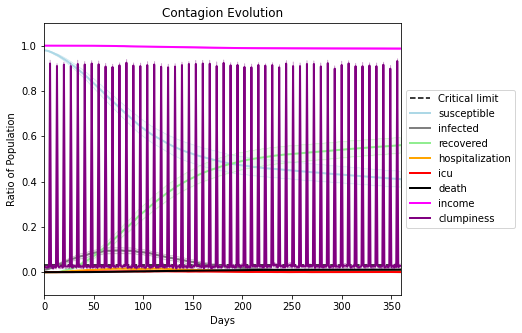

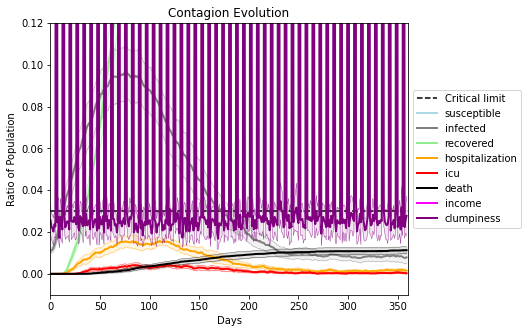

In [33]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.9
params.params['num_communities'] = 100
seeds = [2252]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs=20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],
              work_home_list = 
            
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[5196, 2750, 9571, 3171, 5940, 6237, 8403, 2484, 4744, 6340, 3059, 8301, 3978, 3019, 2863, 7177, 4665, 6467, 1899, 3795]
Average similarity between family members is 0.44050842929743783 at temperature -0.8
Average similarity between family and home is 0.9998646119876846 at temperature -1
Average similarity between students and their classroom is 0.15353558108717655 at temperature -0.8
Average classroom occupancy is 4.352941176470588 and number classrooms is 68
Average similarity between workers is 0.296427263534766 at temperature -0.8
Average office occupancy is 3.189054726368159 and number offices is 201
Average friend similarity for adults: 0.4932336029727934 for kids: 0.3526106344514435
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
H

avg restaurant similarity 0.15361646442098345
avg restaurant similarity 0.6287755011360778
avg restaurant similarity 0.0946213031291768
avg restaurant similarity 0.2039787648474766
avg restaurant similarity 0.32664402522716984
avg restaurant similarity 0.2703739047511724
avg restaurant similarity -0.2664092217394576
avg restaurant similarity 0.19599262932323794
avg restaurant similarity -0.09317305668134515
avg restaurant similarity 0.21309283752827846
avg restaurant similarity 0.12430132542128108
avg restaurant similarity 0.2620490887538232
avg restaurant similarity -0.015174994466087768
avg restaurant similarity 0.08427943296778634
avg restaurant similarity 0.33565883061722335
avg restaurant similarity -0.019910963027553366
avg restaurant similarity -0.053624101738313064
avg restaurant similarity 0.06975013695720475
avg restaurant similarity -0.02123543802880932
avg restaurant similarity -0.007687573307378848
avg restaurant similarity 0.1943264103970459
avg restaurant similarity 0.19

avg restaurant similarity 0.02491210699818043
avg restaurant similarity -0.06738985904710212
avg restaurant similarity -0.36613663498342086
avg restaurant similarity 0.056171254541025874
avg restaurant similarity 0.6119609002980172
avg restaurant similarity -0.22093163725679532
avg restaurant similarity 0.3964108148705904
avg restaurant similarity -0.18684480696515435
avg restaurant similarity 0.21745843687064426
avg restaurant similarity 0.14350931925666577
avg restaurant similarity 0.49561279773082
avg restaurant similarity -0.42311205204515767
avg restaurant similarity -0.16013120947924678
avg restaurant similarity 0.2325110342109002
avg restaurant similarity 0.44134895474101343
avg restaurant similarity 0.2744850912412716
avg restaurant similarity 0.106656117779203
avg restaurant similarity -0.026608262026669965
avg restaurant similarity -0.36613663498342086
avg restaurant similarity 0.11325291303088406
avg restaurant similarity 0.02263330348369985
avg restaurant similarity 0.01708

avg restaurant similarity 0.15559176082132276
avg restaurant similarity -0.05131942278361992
avg restaurant similarity 0.17797078062009913
avg restaurant similarity 0.40495529894259447
avg restaurant similarity -0.023401700252894876
avg restaurant similarity 0.10893329357873519
avg restaurant similarity 0.04630708982958755
avg restaurant similarity -0.008482639058812394
avg restaurant similarity 0.1651887587325253
avg restaurant similarity 0.47694259670414435
avg restaurant similarity -0.03130943191645677
avg restaurant similarity -0.13177871210063205
avg restaurant similarity 0.17218718179197562
avg restaurant similarity -0.26323466550004165
avg restaurant similarity 0.5331582008869102
avg restaurant similarity 0.17359395248534623
avg restaurant similarity -0.13299238220306894
avg restaurant similarity 0.22321518813109256
avg restaurant similarity 0.42664058084242884
avg restaurant similarity -0.059745680707857005
avg restaurant similarity -0.15389230368473658
avg restaurant similarit

avg restaurant similarity 0.1611338065624013
avg restaurant similarity 0.08555774598479353
avg restaurant similarity -0.06818176896067028
avg restaurant similarity 0.0729981791358642
avg restaurant similarity 0.41548559260947426
avg restaurant similarity 0.16248261531619798
avg restaurant similarity -0.12023838087955743
avg restaurant similarity 0.06861255897536231
avg restaurant similarity 0.7512025388976975
avg restaurant similarity -0.068399120783516
avg restaurant similarity 0.03089826575043745
avg restaurant similarity 0.278940769165251
avg restaurant similarity 0.047166799981560335
avg restaurant similarity 0.279310092217938
avg restaurant similarity 0.37109968521594583
avg restaurant similarity 0.26372597852866997
avg restaurant similarity 0.7512025388976975
avg restaurant similarity -0.05696649289915119
avg restaurant similarity 0.17972701958407122
avg restaurant similarity -0.06002390134567243
avg restaurant similarity 0.0729981791358642
avg restaurant similarity 0.12611883279

avg restaurant similarity 0.4996539539559145
avg restaurant similarity -0.1085006840663939
avg restaurant similarity 0.1468853899454366
avg restaurant similarity 0.16544305298142514
avg restaurant similarity 0.2831963380083257
avg restaurant similarity 0.4996539539559145
avg restaurant similarity 0.11458727346034923
avg restaurant similarity 0.16419556950778594
avg restaurant similarity 0.21462402820885956
avg restaurant similarity 0.2970219471972655
avg restaurant similarity 0.02309128953496787
avg restaurant similarity 0.15913839801039273
avg restaurant similarity 0.13521489838530812
avg restaurant similarity -0.05311648804746319
avg restaurant similarity -0.11974058673117888
avg restaurant similarity 0.12557207001405976
avg restaurant similarity 0.052105400228199324
avg restaurant similarity 0.2115479974978591
avg restaurant similarity 0.1990619856059938
avg restaurant similarity 0.9212877119893018
avg restaurant similarity 0.09212279428460458
avg restaurant similarity -0.0895305087

avg restaurant similarity 0.13277322075491754
avg restaurant similarity 0.6615678574965669
avg restaurant similarity 0.0777458073847486
avg restaurant similarity -0.300487614712574
avg restaurant similarity -0.2489194496222799
avg restaurant similarity 0.14905401542241925
avg restaurant similarity 0.2834955380412499
avg restaurant similarity -0.1297534696229326
avg restaurant similarity 0.001186493782026718
avg restaurant similarity 0.07912944627504123
avg restaurant similarity 0.24254261378911213
avg restaurant similarity 0.19716787199950975
avg restaurant similarity -0.383141885927041
avg restaurant similarity 0.12079802545804413
avg restaurant similarity 0.10872589988265575
avg restaurant similarity -0.08763978565132992
avg restaurant similarity 0.3227220248133993
avg restaurant similarity 0.047053750360178066
avg restaurant similarity 0.02168425670730198
avg restaurant similarity 0.06420044196267574
avg restaurant similarity 0.3958403728983441
avg restaurant similarity 0.1107981414

avg restaurant similarity 0.3085648513970507
avg restaurant similarity 0.21089238023722995
avg restaurant similarity 0.10865377243087998
avg restaurant similarity 0.04953173293925033
avg restaurant similarity -0.026502114592127313
avg restaurant similarity -0.07156161345123226
avg restaurant similarity 0.4350824587840737
avg restaurant similarity 0.2684507217379925
avg restaurant similarity -0.11759689881045274
avg restaurant similarity 0.04901294343463168
avg restaurant similarity 0.11428646358085004
avg restaurant similarity 0.18815475133029824
avg restaurant similarity 0.2675636433501193
avg restaurant similarity -0.04259650752274716
avg restaurant similarity -0.1643384467956582
avg restaurant similarity 0.17348205953057788
avg restaurant similarity -0.1570658680862525
avg restaurant similarity 0.07186184547224622
avg restaurant similarity -0.11759689881045274
avg restaurant similarity 0.34436749658218707
avg restaurant similarity -0.02215475534755983
avg restaurant similarity 0.311

avg restaurant similarity -0.23277147629823797
avg restaurant similarity -0.22447250268965147
avg restaurant similarity 0.15870277394126725
avg restaurant similarity 0.23212801317491236
avg restaurant similarity 0.005997427466995386
avg restaurant similarity 0.1226744157886383
avg restaurant similarity 0.7696598265486214
avg restaurant similarity 0.22222744305472558
avg restaurant similarity -0.06791512752789022
avg restaurant similarity 0.47739525832805085
avg restaurant similarity -0.0780266132336237
avg restaurant similarity 0.3507747635859125
avg restaurant similarity 0.13339433542852688
avg restaurant similarity 0.03742044848041203
avg restaurant similarity 0.0422512113756262
avg restaurant similarity 0.07596915753027998
avg restaurant similarity -0.03495862183429829
avg restaurant similarity 0.2812091579716986
avg restaurant similarity -0.036939817865053175
avg restaurant similarity 0.6824004879834765
avg restaurant similarity 0.6097819024807208
avg restaurant similarity 0.358820

avg restaurant similarity 0.011798940123666217
avg restaurant similarity 0.018873765610264992
avg restaurant similarity 0.40609862660613666
avg restaurant similarity 0.476013764615025
avg restaurant similarity 0.07230753565621062
avg restaurant similarity 0.22017920117120943
avg restaurant similarity 0.21945081608749148
avg restaurant similarity -0.0057214986295042874
avg restaurant similarity -0.2543001613182151
avg restaurant similarity -0.11117133008560211
avg restaurant similarity 0.32048110311596706
avg restaurant similarity 0.26302937405216115
avg restaurant similarity 0.6713203773871437
avg restaurant similarity 0.13810962437105265
avg restaurant similarity 0.46153203401708986
avg restaurant similarity 0.017611216953682958
avg restaurant similarity 0.48137959641505035
avg restaurant similarity 0.1472129245825557
avg restaurant similarity 0.09429373506177828
avg restaurant similarity -0.13225271207986472
avg restaurant similarity 0.4625181311346457
avg restaurant similarity 0.384

Average similarity between students and their classroom is 0.19588890047519036 at temperature -0.8
Average classroom occupancy is 4.0285714285714285 and number classrooms is 70
Average similarity between workers is 0.2787266400676859 at temperature -0.8
Average office occupancy is 3.255 and number offices is 200
Average friend similarity for adults: 0.490875346830236 for kids: 0.3517605735350163
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.


avg restaurant similarity -0.04159244029667544
avg restaurant similarity -0.05929147472893059
avg restaurant similarity 0.5471423622821133
avg restaurant similarity -0.36519647060439997
avg restaurant similarity -0.37383912021200943
avg restaurant similarity 0.7248600224937147
avg restaurant similarity -0.02544010282217688
avg restaurant similarity 0.18744845292379447
avg restaurant similarity 0.08870966338138203
avg restaurant similarity 0.24724459522005124
avg restaurant similarity 0.12699822000837127
avg restaurant similarity -0.04116537578457994
avg restaurant similarity 0.2441707492380897
avg restaurant similarity -0.2961468656704553
avg restaurant similarity -0.16241344772042143
avg restaurant similarity 0.31191434453470646
avg restaurant similarity -0.23126192004240628
avg restaurant similarity 0.1189789510954184
avg restaurant similarity 0.015335423943262066
avg restaurant similarity -0.06408563695443911
avg restaurant similarity -0.16641185575899087
avg restaurant similarity -

avg restaurant similarity 0.11506354479557186
avg restaurant similarity 0.09525010898116681
avg restaurant similarity 0.1933225668147216
avg restaurant similarity 0.015107397404889228
avg restaurant similarity -0.4371735130931474
avg restaurant similarity -0.03912439563262461
avg restaurant similarity 0.19564774332259463
avg restaurant similarity 0.28638798888955513
avg restaurant similarity 0.20826524774167077
avg restaurant similarity 0.4987981820252726
avg restaurant similarity 0.2575753386010081
avg restaurant similarity 0.37457932818134343
avg restaurant similarity 0.19724391193619956
avg restaurant similarity 0.5982197965414273
avg restaurant similarity 0.018469629393748535
avg restaurant similarity -0.402796987865864
avg restaurant similarity 0.39565176395323337
avg restaurant similarity -0.2421182158748618
avg restaurant similarity -0.20019774856669612
avg restaurant similarity -0.4646226424794313
avg restaurant similarity 0.33855208561506533
avg restaurant similarity -0.134114

avg restaurant similarity 0.05612802656510482
avg restaurant similarity 0.16272723355369878
avg restaurant similarity 0.18074632595197054
avg restaurant similarity -0.12013755910599515
avg restaurant similarity -0.12013755910599515
avg restaurant similarity 0.16546041999991914
avg restaurant similarity 0.06402103271889524
avg restaurant similarity -0.005197227361797313
avg restaurant similarity 0.1641185121543263
avg restaurant similarity -0.12991338022010987
avg restaurant similarity -0.2303166607923677
avg restaurant similarity 0.056696285899832756
avg restaurant similarity 0.1413267132835772
avg restaurant similarity 0.5921729638184312
avg restaurant similarity 0.3764597646592081
avg restaurant similarity -0.12013755910599515
avg restaurant similarity 0.7391319584017283
avg restaurant similarity -0.008351155986702254
avg restaurant similarity 0.07913529521965415
avg restaurant similarity 0.0894706158522958
avg restaurant similarity 0.2588486256262596
avg restaurant similarity 0.1699

avg restaurant similarity 0.02168193312108842
avg restaurant similarity 0.8694074239771277
avg restaurant similarity -0.18231105243330045
avg restaurant similarity 0.13991313355768692
avg restaurant similarity -0.09021536801199141
avg restaurant similarity 0.358738799106001
Average similarity between family members is 0.44941076649690037 at temperature -0.8
Average similarity between family and home is 0.9998585152391127 at temperature -1
Average similarity between students and their classroom is 0.19288841844085636 at temperature -0.8
Average classroom occupancy is 3.9859154929577465 and number classrooms is 71
Average similarity between workers is 0.2979927461247416 at temperature -0.8
Average office occupancy is 3.2610837438423643 and number offices is 203
Average friend similarity for adults: 0.49963348224347265 for kids: 0.35256446576123524
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with 

avg restaurant similarity 0.6030928439715626
avg restaurant similarity 0.24704544969181488
avg restaurant similarity 0.16003607877508283
avg restaurant similarity 0.10045174596132153
avg restaurant similarity 0.12543660296690676
avg restaurant similarity 0.28529751737969206
avg restaurant similarity 0.16788278554494812
avg restaurant similarity -0.05175773364298207
avg restaurant similarity 0.283235569632704
avg restaurant similarity 0.32332292995291956
avg restaurant similarity 0.10425537029787224
avg restaurant similarity 0.09228263268603266
avg restaurant similarity 0.0958376715722089
avg restaurant similarity -0.20358950274003204
avg restaurant similarity 0.32332292995291956
avg restaurant similarity 0.2885728231870892
avg restaurant similarity 0.03276134318550597
avg restaurant similarity -0.25736317029601224
avg restaurant similarity -0.22217091683887608
avg restaurant similarity 0.2936929666024686
avg restaurant similarity 0.11403769572934863
avg restaurant similarity 0.03319834

avg restaurant similarity 0.32219136389682984
avg restaurant similarity 0.10710296088900506
avg restaurant similarity 0.15834121117419994
avg restaurant similarity 0.181649898108937
avg restaurant similarity -0.04047950704689445
avg restaurant similarity -0.435939325190117
avg restaurant similarity -0.14622704560593872
avg restaurant similarity -0.0456443731577197
avg restaurant similarity -0.3061695656202204
avg restaurant similarity 0.11933509628850003
avg restaurant similarity 0.38341220635201934
avg restaurant similarity 0.12747278946576307
avg restaurant similarity 0.32074300763135155
avg restaurant similarity -0.49001330921413977
avg restaurant similarity 0.3075678219574561
avg restaurant similarity 0.040385455535294795
avg restaurant similarity 0.515829963090376
avg restaurant similarity -0.0002997035908673465
avg restaurant similarity -0.1429332129654506
avg restaurant similarity 0.04441675472954858
avg restaurant similarity 0.1305308981870743
avg restaurant similarity 0.367299

avg restaurant similarity 0.11878502412287524
avg restaurant similarity 0.39786566165776527
avg restaurant similarity -0.08421144220095
avg restaurant similarity 0.1812615589385501
avg restaurant similarity -0.18119739299037063
avg restaurant similarity -0.24473655351400395
avg restaurant similarity -0.44578281731072256
avg restaurant similarity -0.052176624096282945
avg restaurant similarity 0.2860419603970335
avg restaurant similarity 0.021802815059727945
avg restaurant similarity 0.11536852913466139
avg restaurant similarity 0.4360902827200451
avg restaurant similarity 0.12069153148788174
avg restaurant similarity 0.10602858989370517
avg restaurant similarity 0.12287493599630435
avg restaurant similarity 0.036753826477026574
avg restaurant similarity 0.20234467610978635
avg restaurant similarity 0.32079261628047145
avg restaurant similarity 0.04597893696737358
avg restaurant similarity 0.09708949954494844
avg restaurant similarity -0.19246825896493813
avg restaurant similarity -0.10

avg restaurant similarity 0.04442729071428223
avg restaurant similarity 0.12298789746396059
avg restaurant similarity 0.15074266240330367
avg restaurant similarity 0.15253496934474847
avg restaurant similarity 0.2749274147980356
avg restaurant similarity 0.0008103582540810034
avg restaurant similarity -0.13083728787037657
avg restaurant similarity 0.06824738510905362
avg restaurant similarity 0.4981973981788759
avg restaurant similarity -0.0008543793007259881
avg restaurant similarity 0.15203031719735055
avg restaurant similarity 0.13885498353319842
avg restaurant similarity 0.26959866118430803
avg restaurant similarity 0.027846321303125164
avg restaurant similarity -0.08969575487392029
avg restaurant similarity 0.14398776045770995
avg restaurant similarity 0.06703269150491922
avg restaurant similarity 0.08993238471795462
avg restaurant similarity -0.04041470582885316
avg restaurant similarity -0.03819688621113895
avg restaurant similarity -0.04478126144951103
avg restaurant similarity

avg restaurant similarity 0.008233420497785223
avg restaurant similarity 0.3408555611411142
avg restaurant similarity 0.06887914176398022
avg restaurant similarity -0.2931410120869449
avg restaurant similarity 0.04286489218951085
avg restaurant similarity 0.0491253865558422
avg restaurant similarity 0.12510790531097712
avg restaurant similarity -0.022512484727080395
avg restaurant similarity 0.25523250062543623
avg restaurant similarity -0.014285830303318897
avg restaurant similarity 0.5234202761794313
avg restaurant similarity 0.3979138733419232
avg restaurant similarity 0.013905523153021071
avg restaurant similarity 0.2685001663157535
avg restaurant similarity -0.26014056441021777
avg restaurant similarity 0.2224196829155144
avg restaurant similarity -0.40163005134719293
avg restaurant similarity -0.3849108621721004
avg restaurant similarity -0.042147945155444566
avg restaurant similarity 0.0030604183129724627
avg restaurant similarity 0.010481028080392252
avg restaurant similarity 0

avg restaurant similarity 0.08431388641673632
avg restaurant similarity 0.2504349965882728
avg restaurant similarity 0.01500340252119997
avg restaurant similarity 0.3573985343620888
avg restaurant similarity 0.04141526511092216
avg restaurant similarity -0.18743230381832857
avg restaurant similarity -0.14333081984990168
avg restaurant similarity -0.15088687998131628
avg restaurant similarity 0.11736254062915995
avg restaurant similarity 0.4688376257999609
avg restaurant similarity -0.05925481735605639
avg restaurant similarity 0.16908267866674537
avg restaurant similarity 0.21337634499303665
avg restaurant similarity 0.27660516703414184
avg restaurant similarity -0.41332352329301963
avg restaurant similarity 0.3825058328842804
avg restaurant similarity 0.3103468003993575
avg restaurant similarity 0.15601794623888915
avg restaurant similarity -0.1048919473163106
avg restaurant similarity 0.4009130638221141
avg restaurant similarity -0.07013416510329834
avg restaurant similarity 0.650439

avg restaurant similarity 0.18195531554222674
avg restaurant similarity 0.24239133263311308
avg restaurant similarity 0.21587509574569402
avg restaurant similarity 0.22804626307310383
avg restaurant similarity 0.04763644365225418
avg restaurant similarity 0.784141151821093
avg restaurant similarity -0.0071493409824691136
avg restaurant similarity 0.11775469625906182
avg restaurant similarity -0.19863110913831494
avg restaurant similarity 0.3318412761849753
avg restaurant similarity -0.19384861624361832
avg restaurant similarity -0.20326783416351302
avg restaurant similarity 0.3199382286076737
avg restaurant similarity 0.48130063545200163
avg restaurant similarity -0.34077614996625294
avg restaurant similarity 0.44487409892247176
avg restaurant similarity 0.38489626197405336
avg restaurant similarity 0.12123830095469415
avg restaurant similarity 0.03557988102001526
avg restaurant similarity 0.19883930486706541
avg restaurant similarity -0.007843186981896386
avg restaurant similarity 0.3

avg restaurant similarity 0.05892160595736845
avg restaurant similarity 0.3188604136195152
avg restaurant similarity 0.09461757975582563
avg restaurant similarity -0.02535769783205923
avg restaurant similarity 0.1128301345347266
avg restaurant similarity 0.4398552447270522
avg restaurant similarity -0.07502999866969644
avg restaurant similarity 0.8695799065107539
avg restaurant similarity 0.19851600872207895
avg restaurant similarity 0.06931436279499628
avg restaurant similarity 0.33764744982281353
avg restaurant similarity 0.216785044451073
avg restaurant similarity 0.2709519348530268
avg restaurant similarity -0.24015192343185232
avg restaurant similarity 0.010486173938761565
avg restaurant similarity -0.434621245789945
avg restaurant similarity 0.1098105907382454
avg restaurant similarity 0.20616168404303403
avg restaurant similarity 0.07315893269082031
avg restaurant similarity 0.45691499898012716
avg restaurant similarity 0.2879131464084997
avg restaurant similarity 0.144548356258

avg restaurant similarity 0.07687186438535941
avg restaurant similarity -0.21361419506661034
avg restaurant similarity -0.16279786324777512
avg restaurant similarity 0.20130847981487932
avg restaurant similarity 0.14652089046791686
avg restaurant similarity 0.2447940045863974
avg restaurant similarity 0.16541420489276637
avg restaurant similarity -0.02190068003773639
avg restaurant similarity -0.14579277148877473
avg restaurant similarity 0.1293825732431227
avg restaurant similarity -0.207009592317794
avg restaurant similarity 0.468133695948223
avg restaurant similarity 0.21769080352701814
avg restaurant similarity 0.1466365178447415
avg restaurant similarity -0.2724945504653953
avg restaurant similarity 0.03974670969250492
avg restaurant similarity 0.18888197330620415
avg restaurant similarity 0.20616874330466273
avg restaurant similarity 0.23376905262379044
avg restaurant similarity 0.468133695948223
avg restaurant similarity 0.24607891256387648
avg restaurant similarity 0.3650367747

(<function dict.items>, <function dict.items>, <function dict.items>)

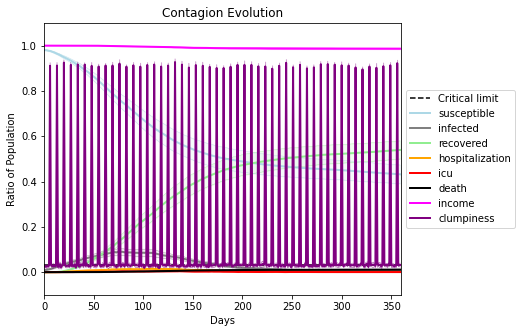

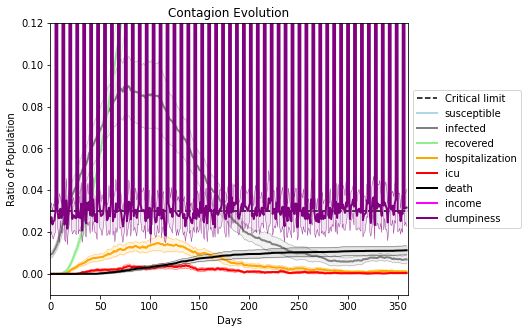

In [34]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.8
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[8784, 9420, 3566, 7820, 6997, 7465, 634, 760, 671, 7657, 1312, 7600, 6132, 4246, 3083, 7222, 6623, 5367, 6558, 5274]
Average similarity between family members is 0.3461128318780587 at temperature -0.7
Average similarity between family and home is 0.999858063670928 at temperature -1
Average similarity between students and their classroom is 0.15189430698785314 at temperature -0.7
Average classroom occupancy is 4.128571428571429 and number classrooms is 70
Average similarity between workers is 0.16870947169162098 at temperature -0.7
Average office occupancy is 3.15609756097561 and number offices is 205
Average friend similarity for adults: 0.42481752934603584 for kids: 0.2634425391426661
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homo

avg restaurant similarity -0.10279798903370951
avg restaurant similarity 0.14491618541872156
avg restaurant similarity 0.3938962770357405
avg restaurant similarity 0.675298436461487
avg restaurant similarity -0.25058172399996953
avg restaurant similarity 0.6426170079029028
avg restaurant similarity -0.12750402335949543
avg restaurant similarity 0.29063393864788806
avg restaurant similarity 0.3845473720677205
avg restaurant similarity 0.126646448857818
avg restaurant similarity 0.23060233217468434
avg restaurant similarity 0.2125253304396695
avg restaurant similarity 0.06288174258023743
avg restaurant similarity -0.2036327026159642
avg restaurant similarity 0.020275716259004983
avg restaurant similarity -0.14393891453304586
avg restaurant similarity -0.04989255792635722
avg restaurant similarity 0.3708354161406538
avg restaurant similarity 0.030817099305439234
avg restaurant similarity -0.15218676088016264
avg restaurant similarity -0.249748226852816
avg restaurant similarity -0.0237953

avg restaurant similarity -0.11656360723833888
avg restaurant similarity 0.5491475630016193
avg restaurant similarity 0.18921127571352658
avg restaurant similarity 0.40310512782586727
avg restaurant similarity 0.37605998976581856
avg restaurant similarity 0.5305920504284034
avg restaurant similarity -0.23352110199233184
avg restaurant similarity 0.24253785282157309
avg restaurant similarity 0.3854458167541345
avg restaurant similarity -0.00706393948418419
avg restaurant similarity -0.035109142023218465
avg restaurant similarity -0.08860537945230731
avg restaurant similarity 0.2515354495658642
avg restaurant similarity 0.5333606680156668
avg restaurant similarity -0.2582633434249959
avg restaurant similarity 0.2119776476641563
avg restaurant similarity 0.14450006190470985
avg restaurant similarity 0.4918078472489613
avg restaurant similarity 0.577204074960854
avg restaurant similarity 0.12017010354096343
avg restaurant similarity 0.4918078472489613
avg restaurant similarity -0.035109142

avg restaurant similarity -0.027713650748469647
avg restaurant similarity 0.10866260846111149
avg restaurant similarity 0.28526742646761577
avg restaurant similarity -0.02210892219280097
avg restaurant similarity 0.29162665329134174
avg restaurant similarity 0.008205983745019553
avg restaurant similarity 0.10017759376868456
avg restaurant similarity 0.2268423917958819
avg restaurant similarity 0.1637078842527797
avg restaurant similarity 0.12260291043171948
avg restaurant similarity -0.11682431383418898
avg restaurant similarity -0.05726616413161427
avg restaurant similarity -0.23518374920105692
avg restaurant similarity 0.12815523863082232
avg restaurant similarity -0.15287220308762778
avg restaurant similarity -0.1829050710461801
avg restaurant similarity -0.02029364015295338
avg restaurant similarity -0.049010374436050747
avg restaurant similarity 0.05767015053376077
avg restaurant similarity 0.05738216180477207
avg restaurant similarity -0.05341978927409256
avg restaurant similarit

avg restaurant similarity 0.13669443355258115
avg restaurant similarity 0.0768902976856809
avg restaurant similarity 0.3494686587083608
avg restaurant similarity 0.21726473822609887
avg restaurant similarity -0.06342665770111508
avg restaurant similarity 0.3291236685350772
avg restaurant similarity 0.27936281298880744
avg restaurant similarity -0.04201386942651622
avg restaurant similarity -0.12617357236478396
avg restaurant similarity 0.38192260029878927
avg restaurant similarity 0.32266379579160875
avg restaurant similarity 0.11206927918783735
avg restaurant similarity 0.1657577521170765
avg restaurant similarity -0.10062053801701049
avg restaurant similarity 0.28639133782680265
avg restaurant similarity 0.24313124339450315
avg restaurant similarity 0.21256611238186202
avg restaurant similarity 0.17112386490700746
avg restaurant similarity 0.06666730571678955
avg restaurant similarity 0.45361605763909807
avg restaurant similarity 0.08445740864253926
avg restaurant similarity -0.17981

avg restaurant similarity -0.06944871542779735
Average similarity between family members is 0.3427401329982407 at temperature -0.7
Average similarity between family and home is 0.9998631821346748 at temperature -1
Average similarity between students and their classroom is 0.15370036270625448 at temperature -0.7
Average classroom occupancy is 3.9014084507042255 and number classrooms is 71
Average similarity between workers is 0.17513155680557824 at temperature -0.7
Average office occupancy is 3.36318407960199 and number offices is 201
Average friend similarity for adults: 0.4299872096812806 for kids: 0.2614857693907372
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 peo

avg restaurant similarity -0.053065229138918944
avg restaurant similarity 0.5135269550538654
avg restaurant similarity 0.1522078992076798
avg restaurant similarity 0.17153753928022708
avg restaurant similarity -0.05349908545503309
avg restaurant similarity -0.022872534894774713
avg restaurant similarity 0.41875393258664745
avg restaurant similarity 0.06485509464883465
avg restaurant similarity -0.10105146853092634
avg restaurant similarity -0.20207476066761118
avg restaurant similarity 0.24200534217501982
avg restaurant similarity 0.3355253917502829
avg restaurant similarity -0.07099357930286024
avg restaurant similarity 0.07104756595940082
avg restaurant similarity 0.054331067723420876
avg restaurant similarity 0.24464717925088478
avg restaurant similarity 0.3253140149226822
avg restaurant similarity -0.09047318061724002
avg restaurant similarity 0.28385387090566
avg restaurant similarity 0.15377904910605647
avg restaurant similarity 0.4250910687770918
avg restaurant similarity 0.3933

avg restaurant similarity 0.07028713676871713
avg restaurant similarity -0.366306563312906
avg restaurant similarity -0.12356127398991187
avg restaurant similarity -0.48256892919738503
avg restaurant similarity -0.13508520082473507
avg restaurant similarity -0.48447108354774104
avg restaurant similarity 0.023456815125073926
avg restaurant similarity -0.5335444101102261
avg restaurant similarity 0.09923608773577906
avg restaurant similarity -0.01377546296989586
avg restaurant similarity -0.25638129277040034
avg restaurant similarity -0.21357118706789213
avg restaurant similarity -0.10516839896031613
avg restaurant similarity 0.12839047455448466
avg restaurant similarity -0.1364734495313097
avg restaurant similarity -0.1344108681003485
avg restaurant similarity 0.005910482575444159
avg restaurant similarity -0.32146888778881694
avg restaurant similarity -0.48256892919738503
avg restaurant similarity 0.02967655296063554
avg restaurant similarity 0.26701830668332727
avg restaurant similari

avg restaurant similarity -0.03098354143698679
avg restaurant similarity 0.056550507915778064
Average similarity between family members is 0.36313146944299735 at temperature -0.7
Average similarity between family and home is 0.9998635159497271 at temperature -1
Average similarity between students and their classroom is 0.143129623520376 at temperature -0.7
Average classroom occupancy is 3.971830985915493 and number classrooms is 71
Average similarity between workers is 0.19696740100390867 at temperature -0.7
Average office occupancy is 3.2549019607843137 and number offices is 204
Average friend similarity for adults: 0.43737510414422254 for kids: 0.2737090457704547
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocate

avg restaurant similarity 0.05312822432298594
avg restaurant similarity -0.14899427729069253
avg restaurant similarity -0.11745097017239353
avg restaurant similarity 0.33792938351279245
avg restaurant similarity 0.6724013210621256
avg restaurant similarity 0.01778682901910797
avg restaurant similarity 0.3151460067826899
avg restaurant similarity -0.28747561913144837
avg restaurant similarity -0.13689662175789472
avg restaurant similarity -0.07952873715764344
avg restaurant similarity 0.8059170917899869
avg restaurant similarity -0.09991783453919953
avg restaurant similarity 0.03903634540978072
avg restaurant similarity 0.2612810762590033
avg restaurant similarity 0.03340287671184522
avg restaurant similarity -0.42886221807525904
avg restaurant similarity 0.10769128480428725
avg restaurant similarity -0.14520160056497694
avg restaurant similarity 0.12496990169264471
avg restaurant similarity -0.0558556679473688
avg restaurant similarity -0.0036178742855360164
avg restaurant similarity 0

Average similarity between students and their classroom is 0.13876522848377848 at temperature -0.7
Average classroom occupancy is 4.23943661971831 and number classrooms is 71
Average similarity between workers is 0.19853700824071077 at temperature -0.7
Average office occupancy is 3.2964824120603016 and number offices is 199
Average friend similarity for adults: 0.4181865493220171 for kids: 0.27069611160035834
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in

avg restaurant similarity 0.04535393424373232
avg restaurant similarity 0.45373890417065993
avg restaurant similarity -0.042837681398335214
avg restaurant similarity -0.19322950862262958
avg restaurant similarity -0.2674634981324174
avg restaurant similarity 0.41880538473456014
avg restaurant similarity -0.0181240131983086
avg restaurant similarity 0.06563082737394851
avg restaurant similarity 0.3581144850261738
avg restaurant similarity 0.19474698752481318
avg restaurant similarity 0.42311674086916473
avg restaurant similarity 0.12367195482319368
avg restaurant similarity -0.06756312656830614
avg restaurant similarity -0.03142614428957616
avg restaurant similarity 0.16399124715787802
avg restaurant similarity -0.4854504641849575
avg restaurant similarity -0.3517822432424501
avg restaurant similarity -0.12997278297466147
avg restaurant similarity 0.3916931710336861
avg restaurant similarity -0.19134714166104633
avg restaurant similarity -0.3035586125022078
avg restaurant similarity 0.0

avg restaurant similarity -0.09348846856286294
avg restaurant similarity 0.14893269156685157
avg restaurant similarity 0.1418756692065233
avg restaurant similarity 0.03467232069383591
avg restaurant similarity 0.5667653103967434
avg restaurant similarity -0.21052805050373768
avg restaurant similarity -0.04096834033740859
avg restaurant similarity 0.32091058932535876
avg restaurant similarity 0.028194833074794777
avg restaurant similarity 0.5363452484049052
avg restaurant similarity -0.20479321890011376
avg restaurant similarity -0.11585625476164026
avg restaurant similarity -0.28087400489282344
avg restaurant similarity -0.10785084512637323
Average similarity between family members is 0.3617353958510978 at temperature -0.7
Average similarity between family and home is 0.9998640667009211 at temperature -1
Average similarity between students and their classroom is 0.15174848291629395 at temperature -0.7
Average classroom occupancy is 3.763888888888889 and number classrooms is 72
Average 

avg restaurant similarity 0.20800056376666648
avg restaurant similarity 0.24579313096069674
avg restaurant similarity 0.12182306820762452
avg restaurant similarity 0.5514238895287016
avg restaurant similarity -0.04770331761490918
avg restaurant similarity 0.2512767139602051
avg restaurant similarity 0.19636380099829684
avg restaurant similarity 0.0577220814624725
avg restaurant similarity -0.13434128578296195
avg restaurant similarity 0.028011092990628914
avg restaurant similarity 0.09769923621492252
avg restaurant similarity 0.0008097386652735766
avg restaurant similarity 0.06467297218137753
avg restaurant similarity 0.32035011708253647
avg restaurant similarity 0.09226656175562395
avg restaurant similarity 0.02711142429502191
avg restaurant similarity 0.41645714454965904
avg restaurant similarity 0.1570360853854842
avg restaurant similarity 0.42926779021406725
avg restaurant similarity 0.32035011708253647
avg restaurant similarity 0.06667818108776047
avg restaurant similarity 0.01064

avg restaurant similarity 0.09757835870486001
avg restaurant similarity 0.24262338020245958
avg restaurant similarity 0.02749504204079487
avg restaurant similarity -0.11854849791347506
avg restaurant similarity 0.36248518075328434
avg restaurant similarity -0.03917103635514198
avg restaurant similarity 0.16468710459115365
avg restaurant similarity 0.41765179805340014
avg restaurant similarity 0.2573311041177893
avg restaurant similarity -0.5431567361063303
avg restaurant similarity 0.018431721167644438
avg restaurant similarity -0.10169541108143831
avg restaurant similarity -0.020377468491246706
avg restaurant similarity 0.4891479960301498
avg restaurant similarity -0.28894991587811425
avg restaurant similarity -0.154860651311845
avg restaurant similarity 0.5085912318885766
avg restaurant similarity 0.48236632280505676
avg restaurant similarity 0.05178362697855726
avg restaurant similarity 0.7157711704450705
avg restaurant similarity -0.028386230302341338
avg restaurant similarity 0.24

avg restaurant similarity 0.6297604670814416
avg restaurant similarity 0.33696856905301265
avg restaurant similarity -0.027155099870701388
avg restaurant similarity 0.23844310166437302
avg restaurant similarity 0.06603967248450225
avg restaurant similarity -0.030412794193436517
avg restaurant similarity 0.02893429893721622
avg restaurant similarity -0.22037238626243427
avg restaurant similarity 0.22765144651516145
avg restaurant similarity 0.126620820022546
avg restaurant similarity 0.1383392616158804
avg restaurant similarity 0.3433213435496425
avg restaurant similarity 0.20750064621919603
avg restaurant similarity 0.31941151290175057
avg restaurant similarity 0.6279273795827001
avg restaurant similarity -0.12942228469023603
avg restaurant similarity 0.3067339142235733
avg restaurant similarity 0.29820824255572803
avg restaurant similarity 0.11130184696208997
avg restaurant similarity 0.4561153979022164
avg restaurant similarity 0.32318629253797426
avg restaurant similarity 0.27997649

avg restaurant similarity 0.5101143030248538
avg restaurant similarity 0.0811004152576306
avg restaurant similarity 0.14943021929553346
avg restaurant similarity 0.15594918363329618
avg restaurant similarity 0.4207391287040924
avg restaurant similarity -0.25808468427927805
avg restaurant similarity -0.07348170646834978
avg restaurant similarity 0.269090891285003
avg restaurant similarity 0.05774651908471719
avg restaurant similarity 0.3915849267261415
avg restaurant similarity 0.2027343972600363
avg restaurant similarity 0.22237009888604495
avg restaurant similarity 0.11359278444000595
avg restaurant similarity 0.35103783527674287
avg restaurant similarity 0.17646414851390563
avg restaurant similarity -0.19176768971983432
avg restaurant similarity -0.009576484150313772
avg restaurant similarity 0.5288781661272198
avg restaurant similarity 0.08655206170321675
avg restaurant similarity -0.2691126390129277
avg restaurant similarity 0.05783531652490488
avg restaurant similarity 0.290776644

avg restaurant similarity 0.4200750147848671
avg restaurant similarity 0.021546332681101343
avg restaurant similarity 0.10485969511191717
avg restaurant similarity 0.4733194608424578
avg restaurant similarity 0.10485969511191717
avg restaurant similarity 0.07835378297097763
avg restaurant similarity 0.3581212475947499
avg restaurant similarity 0.03368594923454816
avg restaurant similarity 0.12187478891890194
avg restaurant similarity -0.24950049431306118
avg restaurant similarity -0.19160280736948954
avg restaurant similarity -0.31511992904070124
avg restaurant similarity 0.09579748642058941
avg restaurant similarity 0.1547882799051427
avg restaurant similarity 0.2045743684409931
avg restaurant similarity 0.17988259299706041
avg restaurant similarity 0.5587370101881451
avg restaurant similarity 0.35085860644339384
avg restaurant similarity -0.14523366601594512
avg restaurant similarity -0.14985810846155484
avg restaurant similarity -0.04392563853754877
avg restaurant similarity 0.17260

avg restaurant similarity -0.027301274294300723
avg restaurant similarity 0.44557159708706473
avg restaurant similarity -0.20676531080121588
avg restaurant similarity 0.14878644461741486
avg restaurant similarity -0.36719442799000085
avg restaurant similarity -0.20676531080121588
avg restaurant similarity 0.11891763781488335
avg restaurant similarity -0.19473448348705666
avg restaurant similarity -0.09532413080809388
avg restaurant similarity 0.11727458663178607
avg restaurant similarity 0.12523233414529747
avg restaurant similarity -0.03433440947471724
avg restaurant similarity 0.19688019444706933
avg restaurant similarity 0.23945375502524355
avg restaurant similarity 0.10826008202898078
avg restaurant similarity 0.08394967953086063
avg restaurant similarity 0.03265245899352028
avg restaurant similarity 0.09583134399604776
avg restaurant similarity 0.3707353829827388
avg restaurant similarity 0.1994237206925038
avg restaurant similarity 0.1571792261312592
avg restaurant similarity -0.

avg restaurant similarity 0.11447578956198476
avg restaurant similarity -0.04767352018517031
avg restaurant similarity 0.09381724056356139
avg restaurant similarity 0.12756036557943873
Average similarity between family members is 0.3494903764040026 at temperature -0.7
Average similarity between family and home is 0.9998510122826919 at temperature -1
Average similarity between students and their classroom is 0.16814347826404302 at temperature -0.7
Average classroom occupancy is 3.9722222222222223 and number classrooms is 72
Average similarity between workers is 0.19175837164016066 at temperature -0.7
Average office occupancy is 3.297979797979798 and number offices is 198
Average friend similarity for adults: 0.4243649972387519 for kids: 0.27347794302045253
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district 

avg restaurant similarity 0.8300124002203512
avg restaurant similarity 0.9062612048183762
avg restaurant similarity 0.27932837710740516
avg restaurant similarity -0.012843070429682302
avg restaurant similarity -0.04275544629152914
avg restaurant similarity 0.6534311397427581
avg restaurant similarity -0.3970266035059376
avg restaurant similarity -0.21911446607795976
avg restaurant similarity -0.016321555358292498
avg restaurant similarity 0.2211123652930953
avg restaurant similarity -0.27207890078659724
avg restaurant similarity -0.05864765247513179
avg restaurant similarity -0.20968480084171146
avg restaurant similarity 0.154848553164898
avg restaurant similarity 0.008612582598665347
avg restaurant similarity -0.32119178981353214
avg restaurant similarity -0.27389083582318896
avg restaurant similarity 0.008612582598665347
avg restaurant similarity 0.13399941757527914
avg restaurant similarity -0.3970266035059376
avg restaurant similarity -0.0768781409727945
avg restaurant similarity -

avg restaurant similarity 0.06595651788529508
avg restaurant similarity 0.6853810411286453
avg restaurant similarity -0.5283412004375375
avg restaurant similarity 0.10260407948076267
avg restaurant similarity -0.07537128350433178
avg restaurant similarity 0.24496981767240242
avg restaurant similarity -0.16623822205226574
avg restaurant similarity -0.2533238665973461
avg restaurant similarity 0.2148065167792254
avg restaurant similarity 0.04113067895494938
avg restaurant similarity 0.8399281366928926
avg restaurant similarity 0.17708324449690593
avg restaurant similarity 0.41869641901254534
avg restaurant similarity 0.2505905213640031
avg restaurant similarity 0.04481959804801172
avg restaurant similarity 0.06639613829682828
avg restaurant similarity 0.33151528454850165
avg restaurant similarity 0.028721357540661144
avg restaurant similarity 0.18628957761330633
avg restaurant similarity -0.06505694235288455
avg restaurant similarity 0.09923370015075282
avg restaurant similarity 0.130033

Average friend similarity for adults: 0.42407799601338086 for kids: 0.27626548053247907
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocat

avg restaurant similarity -0.017355362287729992
avg restaurant similarity 0.12119977507037161
avg restaurant similarity 0.32625254497142875
avg restaurant similarity -0.12910181035146115
avg restaurant similarity 0.17810545330677402
avg restaurant similarity -0.2782732377818886
avg restaurant similarity 0.20373219568618756
avg restaurant similarity 0.06331915479829503
avg restaurant similarity -0.0021628369806234032
avg restaurant similarity 0.01946859788372874
avg restaurant similarity 0.01999628096324448
avg restaurant similarity 0.0562634981521181
avg restaurant similarity 0.3118375495051216
avg restaurant similarity 0.12211214226676853
avg restaurant similarity 0.038595801473504526
avg restaurant similarity 0.043495412589085625
avg restaurant similarity -0.1010731551111662
avg restaurant similarity 0.14597581298774026
avg restaurant similarity 0.18281617075999174
avg restaurant similarity 0.1408727580937757
avg restaurant similarity -0.41002808021791226
avg restaurant similarity 0.

avg restaurant similarity 0.1048893920849272
avg restaurant similarity 0.11065337039567391
avg restaurant similarity 0.08401308135925957
avg restaurant similarity 0.07931778258442745
avg restaurant similarity 0.10847082719031961
avg restaurant similarity 0.15835219411511564
avg restaurant similarity 0.22424218406822835
avg restaurant similarity -0.11943388922148364
avg restaurant similarity 0.03531533151569833
avg restaurant similarity 0.21727949612067404
avg restaurant similarity 0.060515706388505876
avg restaurant similarity 0.3312723325159034
avg restaurant similarity -0.02819747331474619
avg restaurant similarity 0.40654336038007943
avg restaurant similarity -0.34230176329642914
avg restaurant similarity 0.2772022785654643
avg restaurant similarity 0.028330299812299207
avg restaurant similarity -0.09153327713178636
avg restaurant similarity 0.04542288984245597
avg restaurant similarity -0.14482062248081878
avg restaurant similarity 0.15917953746080443
avg restaurant similarity -0.0

avg restaurant similarity -0.015377870091134171
avg restaurant similarity 0.16044138589088952
avg restaurant similarity 0.11368445409982893
avg restaurant similarity 0.28595365423672503
avg restaurant similarity 0.12786965967470887
avg restaurant similarity -0.1191387595281867
avg restaurant similarity -0.011613557959197399
avg restaurant similarity -0.029116460584302555
avg restaurant similarity 0.0032843779345075458
avg restaurant similarity 0.30461668744154946
avg restaurant similarity 0.05420229182869753
avg restaurant similarity 0.3991933081895417
avg restaurant similarity -0.031420925441141036
avg restaurant similarity 0.2878218190082469
avg restaurant similarity -0.15779534354766717
avg restaurant similarity 0.44966852940812235
avg restaurant similarity 0.4679248571044521
avg restaurant similarity 0.10740272063675528
avg restaurant similarity 0.05612307629835207
avg restaurant similarity 0.1084897205689806
avg restaurant similarity 0.1525770726789953
avg restaurant similarity -0

avg restaurant similarity 0.17470060666793516
avg restaurant similarity 0.07018213304779491
avg restaurant similarity 0.2859551374335918
avg restaurant similarity 0.1745290789487896
avg restaurant similarity 0.31470284108611113
avg restaurant similarity 0.37188671801941675
avg restaurant similarity 0.07018213304779491
avg restaurant similarity 0.31470284108611113
avg restaurant similarity 0.09145101293567229
avg restaurant similarity 0.6499759323925749
avg restaurant similarity 0.40522777742670807
avg restaurant similarity -0.33462383056399203
avg restaurant similarity 0.6352598573026932
avg restaurant similarity 0.3195088904209776
avg restaurant similarity 0.3085064052717963
avg restaurant similarity 0.5290642311732165
avg restaurant similarity 0.26346716031913653
avg restaurant similarity 0.12898564189298023
avg restaurant similarity -0.02043353753181589
avg restaurant similarity 0.187355868927769
avg restaurant similarity 0.31508254790772794
avg restaurant similarity 0.5290642311732

(<function dict.items>, <function dict.items>, <function dict.items>)

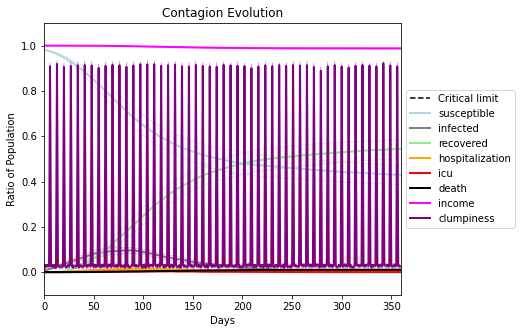

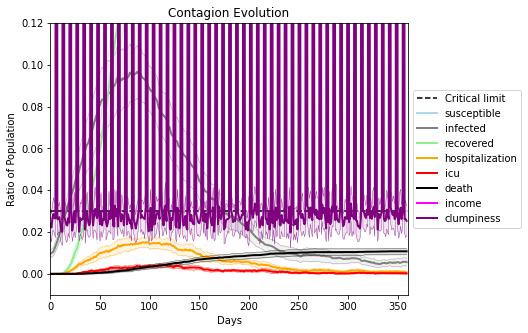

In [35]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.7
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
              [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
], listeners = listeners)

Save these seeds if you want to rerun a scenario
[1715, 611, 4887, 1398, 4754, 4955, 108, 3437, 4346, 5702, 9939, 5882, 2364, 9849, 7950, 5639, 7028, 5472, 190, 8885]
Average similarity between family members is 0.31051461658173285 at temperature -0.6
Average similarity between family and home is 0.9998490743247659 at temperature -1
Average similarity between students and their classroom is 0.18783920180267277 at temperature -0.6
Average classroom occupancy is 4.084507042253521 and number classrooms is 71
Average similarity between workers is 0.16832296278446765 at temperature -0.6
Average office occupancy is 3.15609756097561 and number offices is 205
Average friend similarity for adults: 0.38124834718701583 for kids: 0.22234781615963678
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Hom

avg restaurant similarity 0.06328756408324106
avg restaurant similarity 0.5120763749714582
avg restaurant similarity 0.2592960703698004
avg restaurant similarity -0.3013384287275748
avg restaurant similarity 0.31680547927140007
avg restaurant similarity -0.36705728653893377
avg restaurant similarity -0.14152026635825665
avg restaurant similarity 0.11186768480090152
avg restaurant similarity 0.1466052629939579
avg restaurant similarity -0.021608596022264642
avg restaurant similarity 0.49446078537342153
avg restaurant similarity 0.24441587660502342
avg restaurant similarity 0.5205595322473328
avg restaurant similarity 0.244684068883253
avg restaurant similarity 0.4811646483115948
avg restaurant similarity -0.45660578845160604
avg restaurant similarity 0.5837000845615181
avg restaurant similarity 0.23505469544524138
avg restaurant similarity -0.08349782373826745
avg restaurant similarity -0.07174168475725821
avg restaurant similarity 0.23516082691590878
avg restaurant similarity 0.0185301

avg restaurant similarity 0.022251848383921156
avg restaurant similarity 0.33128204564203656
avg restaurant similarity 0.05256467118493974
avg restaurant similarity 0.2600272031880299
avg restaurant similarity -0.22127985981199214
avg restaurant similarity 0.36175683229209904
avg restaurant similarity 0.3319681875208087
avg restaurant similarity 0.4297212017653503
avg restaurant similarity -0.010133422141694076
avg restaurant similarity -0.23171785821554397
avg restaurant similarity 0.012922050059718589
avg restaurant similarity 0.2653600380300627
avg restaurant similarity -0.21223144492592005
avg restaurant similarity 0.0995915180022502
avg restaurant similarity 0.25583112867943514
avg restaurant similarity 0.011291430922788968
avg restaurant similarity 0.0014680378871423762
avg restaurant similarity -0.3257178730941729
avg restaurant similarity -0.1284992662682906
avg restaurant similarity 0.18570930197243102
avg restaurant similarity -0.18007090760654454
avg restaurant similarity 0.

avg restaurant similarity 0.2976917024189679
avg restaurant similarity 0.3162684501953579
avg restaurant similarity -0.018234551507307517
avg restaurant similarity 0.3613557702394473
avg restaurant similarity -0.08852017047787958
avg restaurant similarity -0.5240234013167429
avg restaurant similarity 0.34169350267104226
avg restaurant similarity 0.22639569746875965
avg restaurant similarity -0.5736636217409046
avg restaurant similarity 0.3176691196126662
avg restaurant similarity -0.1429160155735798
avg restaurant similarity 0.06445848170958539
avg restaurant similarity 0.26373645977350707
avg restaurant similarity 0.7026976583904534
avg restaurant similarity 0.1385152658743239
avg restaurant similarity 0.045969945470841975
avg restaurant similarity -0.05623470950651702
avg restaurant similarity 0.2359647096869252
avg restaurant similarity -0.08852017047787958
avg restaurant similarity 0.17573977612731076
avg restaurant similarity -0.05623470950651702
avg restaurant similarity -0.20817

avg restaurant similarity 0.05841915487012016
avg restaurant similarity 0.28243363631067053
avg restaurant similarity 0.028413311196238168
avg restaurant similarity 0.1935708575063077
avg restaurant similarity 0.12040226264110164
avg restaurant similarity -0.01481396003504822
avg restaurant similarity -0.0633788511273114
avg restaurant similarity 0.17148246123693295
avg restaurant similarity -0.07088947353144517
avg restaurant similarity -0.2225019923126592
avg restaurant similarity 0.3720066349392188
avg restaurant similarity 0.1107383492809906
avg restaurant similarity 0.14013382279249498
avg restaurant similarity 0.2511388002606502
avg restaurant similarity -0.09746517093759527
avg restaurant similarity -0.21269661053824543
avg restaurant similarity -0.027255032517630923
avg restaurant similarity 0.01623080682258429
avg restaurant similarity 0.29133765093445313
avg restaurant similarity 0.2422203187389555
avg restaurant similarity 0.02006628943784933
avg restaurant similarity 0.1347

Average similarity between workers is 0.1340304774810112 at temperature -0.6
Average office occupancy is 3.343137254901961 and number offices is 204
Average friend similarity for adults: 0.3808687584211008 for kids: 0.2072965869808357
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 4 people.
Total of 4 pe

avg restaurant similarity 0.033658215948359396
avg restaurant similarity 0.10524720614817648
avg restaurant similarity -0.24649904177085985
avg restaurant similarity 0.2386351142816452
avg restaurant similarity -0.26435015346946444
avg restaurant similarity -0.29206404052263507
avg restaurant similarity 0.1174709126918694
avg restaurant similarity 0.2132250686590053
avg restaurant similarity -0.25775426568399484
avg restaurant similarity 0.40425283405346935
avg restaurant similarity 0.08486008462399189
avg restaurant similarity 0.45122433209859814
avg restaurant similarity -0.026614076184333396
avg restaurant similarity 0.3778036820080207
avg restaurant similarity 0.37275550811133057
avg restaurant similarity 0.6412267317095885
avg restaurant similarity -0.10418183133421109
avg restaurant similarity 0.2907963193016164
avg restaurant similarity 0.10465645575317285
avg restaurant similarity 0.5442926832759234
avg restaurant similarity 0.09947681827808538
avg restaurant similarity 0.37853

avg restaurant similarity 0.13737109698792963
avg restaurant similarity 0.053813787626501325
avg restaurant similarity 0.37465414624313836
avg restaurant similarity 0.26733783528485766
avg restaurant similarity -0.45806432449533413
avg restaurant similarity 0.2672800462172893
avg restaurant similarity -0.08186568562188987
avg restaurant similarity -0.06217498809380598
avg restaurant similarity 0.21686422266662458
avg restaurant similarity -0.11571539031907563
avg restaurant similarity -0.16111751039887579
avg restaurant similarity 0.15903743355688155
avg restaurant similarity 0.3320550817971699
avg restaurant similarity 0.22754366871276974
avg restaurant similarity -0.022189620569950566
avg restaurant similarity -0.11908023265219773
avg restaurant similarity -0.05031251368162371
avg restaurant similarity 0.23824237658224526
avg restaurant similarity -0.23355331477388067
avg restaurant similarity 0.11481057828547175
avg restaurant similarity -0.45806432449533413
avg restaurant similarit

avg restaurant similarity 0.18680021652207063
avg restaurant similarity 0.09171223989621338
avg restaurant similarity -0.09868818891608867
avg restaurant similarity 0.08687154166587438
avg restaurant similarity 0.14696620502279653
avg restaurant similarity 0.11846161916339748
avg restaurant similarity 0.19588517761534685
avg restaurant similarity 0.1993102424536827
avg restaurant similarity 0.1188927527257487
avg restaurant similarity 0.15525059826826795
avg restaurant similarity 0.032507555907336214
avg restaurant similarity 0.0564648138453645
avg restaurant similarity 0.34841600617003765
avg restaurant similarity -0.24542832139852844
avg restaurant similarity 0.3187583798328048
avg restaurant similarity 0.5131086954436925
avg restaurant similarity 0.31179740182905125
avg restaurant similarity 0.14874315573126495
avg restaurant similarity 0.02565359760499938
avg restaurant similarity 0.3749592323078268
avg restaurant similarity 0.031640068502305885
avg restaurant similarity 0.03641789

avg restaurant similarity 0.3371309362634196
avg restaurant similarity -0.24662004780440122
avg restaurant similarity -0.03926911924486415
avg restaurant similarity 0.407229532033751
avg restaurant similarity 0.04644382765462901
avg restaurant similarity 0.04165083804936931
avg restaurant similarity 0.23122876400203168
avg restaurant similarity -0.2668336866207603
avg restaurant similarity -0.00789938570877452
avg restaurant similarity -0.10410418675674855
avg restaurant similarity -0.10092493893468314
avg restaurant similarity -0.07984436959492411
avg restaurant similarity 0.29703475298533455
avg restaurant similarity -0.2734179678440658
avg restaurant similarity 0.2167960958696275
avg restaurant similarity -0.22808466816983153
avg restaurant similarity 0.15051900071841723
avg restaurant similarity 0.2401348670533872
avg restaurant similarity 0.5082589013740532
avg restaurant similarity 0.22856631800476634
avg restaurant similarity 0.06826976688180969
avg restaurant similarity -0.1770

avg restaurant similarity 0.16081915384754633
avg restaurant similarity -0.023435848738029175
avg restaurant similarity 0.10789729970050414
avg restaurant similarity 0.31169011629859567
avg restaurant similarity 0.5162795666127957
avg restaurant similarity -0.11224389145358618
avg restaurant similarity 0.16918427532303154
avg restaurant similarity 0.540794415610622
avg restaurant similarity 0.3695986613804236
avg restaurant similarity -0.14303884327069075
avg restaurant similarity 0.03597091493991649
avg restaurant similarity 0.14647415636679675
avg restaurant similarity 0.32023925823978916
avg restaurant similarity 0.4363429496987477
avg restaurant similarity 0.22370891841079246
avg restaurant similarity 0.15057607482242302
avg restaurant similarity -0.1322669535510691
avg restaurant similarity -0.09333908860968405
avg restaurant similarity 0.0716513064695988
avg restaurant similarity 0.19969372614238967
avg restaurant similarity 0.20943937724437683
avg restaurant similarity 0.0612937

avg restaurant similarity -0.09602310644142323
avg restaurant similarity -0.06158451121928927
avg restaurant similarity 0.0007332163576616209
avg restaurant similarity 0.08601137340270716
avg restaurant similarity 0.2291145991790301
avg restaurant similarity 0.3518404832660493
avg restaurant similarity 0.41260120574590675
avg restaurant similarity -0.021969949912631417
avg restaurant similarity 0.18007520318652862
avg restaurant similarity -0.0239239088564505
avg restaurant similarity 0.26490929479352243
avg restaurant similarity 0.2831709722343782
avg restaurant similarity -0.22416857226649373
avg restaurant similarity 0.012198747124873746
avg restaurant similarity 0.043407640488423806
avg restaurant similarity -0.06158451121928927
avg restaurant similarity 0.06364548596180844
avg restaurant similarity -0.0019971458164090867
avg restaurant similarity 0.17795303683761415
avg restaurant similarity 0.15708423696359816
avg restaurant similarity 0.33236219611814594
avg restaurant similarit

avg restaurant similarity 0.15581238784006315
avg restaurant similarity 0.032977991171636266
avg restaurant similarity 0.18293085525537608
avg restaurant similarity 0.12331656784496257
avg restaurant similarity 0.08072751167886467
avg restaurant similarity -0.0947101311478737
avg restaurant similarity 0.06470545703588773
avg restaurant similarity 0.2934138560238244
avg restaurant similarity -0.10402905009510553
avg restaurant similarity -0.05123730126361979
avg restaurant similarity 0.1702372270686583
avg restaurant similarity 0.019127068315282554
avg restaurant similarity 0.10534631898317315
avg restaurant similarity 0.4966826424004939
avg restaurant similarity -0.07276384881002501
avg restaurant similarity 0.1026125333371159
avg restaurant similarity 0.1528389863918473
avg restaurant similarity 0.05615646027613645
avg restaurant similarity 0.04354652646464961
avg restaurant similarity -0.07354069073430888
avg restaurant similarity 0.05210871270730002
avg restaurant similarity 0.26494

avg restaurant similarity -0.18118821440786942
avg restaurant similarity 0.21642269677166542
avg restaurant similarity 0.27136343528544254
avg restaurant similarity 0.07653937532918134
avg restaurant similarity 0.1221138152204713
avg restaurant similarity -0.07648376012723605
avg restaurant similarity 0.04938799400670519
avg restaurant similarity 0.06857690238383705
avg restaurant similarity 0.05411969654865562
avg restaurant similarity 0.04994572396919974
avg restaurant similarity 0.06240966539960653
avg restaurant similarity 0.043493440413196145
avg restaurant similarity -0.3960651692016953
avg restaurant similarity 0.20461415670300448
avg restaurant similarity 0.49558198207264165
avg restaurant similarity -0.05645122795879541
avg restaurant similarity -0.047949551463052936
avg restaurant similarity -0.055335691469207034
avg restaurant similarity -0.09030397843484975
avg restaurant similarity 0.4599482585646717
avg restaurant similarity -0.014094216857543737
avg restaurant similarity

avg restaurant similarity 0.262477502260081
avg restaurant similarity 0.03725346151231485
avg restaurant similarity 0.5026616213251476
avg restaurant similarity 0.17659873952143593
avg restaurant similarity 0.19758071929327067
avg restaurant similarity 0.4734459341391347
avg restaurant similarity 0.3562289029816127
avg restaurant similarity 0.06310334820787687
avg restaurant similarity 0.018564211433186983
avg restaurant similarity 0.38188867781702357
avg restaurant similarity -0.03837431395429863
avg restaurant similarity -0.5352214211501041
avg restaurant similarity 0.38188867781702357
avg restaurant similarity -0.007187902946452371
avg restaurant similarity 0.007071264454728422
avg restaurant similarity 0.3292292631052794
avg restaurant similarity -0.18979587061642494
avg restaurant similarity 0.16577154946403852
avg restaurant similarity -0.0558846572874778
avg restaurant similarity 0.49113882036268297
avg restaurant similarity 0.004158080992088253
avg restaurant similarity 0.22797

avg restaurant similarity 0.14717335413039656
avg restaurant similarity 0.1009599383679728
avg restaurant similarity 0.38223485729179113
avg restaurant similarity 0.23586609524169827
avg restaurant similarity 0.018077451209775677
avg restaurant similarity 0.1985537631859761
avg restaurant similarity 0.5763304448238443
avg restaurant similarity 0.1695446781039933
avg restaurant similarity 0.05029123677812256
avg restaurant similarity 0.6025240614492133
avg restaurant similarity 0.018568151560881752
avg restaurant similarity -0.4597541029155432
avg restaurant similarity 0.12744449565881064
avg restaurant similarity 0.2656093745206154
avg restaurant similarity -0.5769973131749958
avg restaurant similarity -0.4597541029155432
avg restaurant similarity 0.36742597863900806
avg restaurant similarity -0.09351533434912628
avg restaurant similarity 0.24860555020365804
avg restaurant similarity -0.1909069931716803
avg restaurant similarity 0.04738360470420231
avg restaurant similarity 0.130175976

avg restaurant similarity 0.17642136819550866
avg restaurant similarity 0.23246858037180776
avg restaurant similarity 0.19950780850884592
avg restaurant similarity -0.03171566825880224
avg restaurant similarity 0.1387461697268964
avg restaurant similarity -0.23437424394604586
avg restaurant similarity 0.05914152892772359
avg restaurant similarity -0.05023463587648984
avg restaurant similarity -0.06952392948101474
avg restaurant similarity 0.2141032540410236
avg restaurant similarity 0.5458040167538837
avg restaurant similarity -0.0422990738028545
avg restaurant similarity 0.14088721361712242
avg restaurant similarity 0.09289519818398506
avg restaurant similarity 0.2749936534745655
avg restaurant similarity 0.44838319039606545
avg restaurant similarity 0.4469677940586162
avg restaurant similarity 0.14193869196298203
avg restaurant similarity 0.23149678804229773
avg restaurant similarity -0.010523965566365256
avg restaurant similarity -0.12617441711017294
avg restaurant similarity 0.1625

avg restaurant similarity 0.23780946807504388
avg restaurant similarity -0.0536390906005646
avg restaurant similarity 0.24247720948219506
avg restaurant similarity 0.40560176361144973
avg restaurant similarity 0.9998486126069595
avg restaurant similarity -0.09506432443878872
avg restaurant similarity 0.3364008140258556
avg restaurant similarity 0.6912977475280548
avg restaurant similarity 0.35794757113783304
avg restaurant similarity 0.4366444227942634
avg restaurant similarity 0.2819142494417866
avg restaurant similarity -0.18896618175132918
avg restaurant similarity -0.0052630044455092145
avg restaurant similarity 0.11727994718523913
avg restaurant similarity 0.3737502685193705
avg restaurant similarity -0.10153647401998885
avg restaurant similarity -0.014140248435634824
avg restaurant similarity 0.05659595156528581
avg restaurant similarity 0.2736955726981407
avg restaurant similarity -0.04642202282260407
avg restaurant similarity -0.0031688980477033585
avg restaurant similarity 0.3

avg restaurant similarity 0.007500340353908397
avg restaurant similarity 0.43141097710142073
avg restaurant similarity 0.1079624789392019
avg restaurant similarity -0.17312929624754955
avg restaurant similarity 0.47390222701216683
avg restaurant similarity -0.054097082151112474
avg restaurant similarity -0.1134901048691794
Average similarity between family members is 0.3040262909157573 at temperature -0.6
Average similarity between family and home is 0.9998497112927431 at temperature -1
Average similarity between students and their classroom is 0.1528943747503388 at temperature -0.6
Average classroom occupancy is 3.9577464788732395 and number classrooms is 71
Average similarity between workers is 0.15679322368020945 at temperature -0.6
Average office occupancy is 3.3118811881188117 and number offices is 202
Average friend similarity for adults: 0.3745415464409901 for kids: 0.20098324011776536
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with

avg restaurant similarity -0.016556420058939522
avg restaurant similarity 0.13752583434720506
avg restaurant similarity -0.09679642871302097
avg restaurant similarity 0.07241462401031888
avg restaurant similarity 0.21117285920098328
avg restaurant similarity 0.3251450582297871
avg restaurant similarity -0.20022685405111607
avg restaurant similarity 0.25471242925457105
avg restaurant similarity -0.05746941056247863
avg restaurant similarity -0.06025358418212133
avg restaurant similarity 0.0158599430408851
avg restaurant similarity 0.33660535728951624
avg restaurant similarity 0.06589658807634363
avg restaurant similarity 0.16824782745153566
avg restaurant similarity -0.26620717542247113
avg restaurant similarity -0.0028796739607506727
avg restaurant similarity -0.11252665012892996
avg restaurant similarity -0.2993795676333207
avg restaurant similarity -0.19074317671755192
avg restaurant similarity -0.173219326015996
avg restaurant similarity -0.013094839639155422
avg restaurant similari

avg restaurant similarity -0.013050031281666534
avg restaurant similarity 0.13401164293569165
avg restaurant similarity 0.12823172868070515
avg restaurant similarity 0.2161979789841058
avg restaurant similarity 0.4626529141850348
avg restaurant similarity 0.21165887771787212
avg restaurant similarity 0.4204795296790414
avg restaurant similarity 0.08688302947221588
avg restaurant similarity 0.6834776312372861
avg restaurant similarity 0.051749567767146565
avg restaurant similarity 0.3048586760886427
avg restaurant similarity 0.25676433482968897
avg restaurant similarity 0.37892210143298244
avg restaurant similarity 0.017649992038708776
avg restaurant similarity 0.1318854780886246
avg restaurant similarity 0.10439316747724153
avg restaurant similarity 0.12156351816916289
avg restaurant similarity -0.1428346860868869
avg restaurant similarity -0.11747698912784363
avg restaurant similarity 0.06871002265168731
avg restaurant similarity 0.033730103115378066
avg restaurant similarity 0.243875

Average similarity between workers is 0.14478660472685786 at temperature -0.6
Average office occupancy is 3.287878787878788 and number offices is 198
Average friend similarity for adults: 0.3779386071390305 for kids: 0.2083014159905487
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 18 people.
Total of 18 p

avg restaurant similarity -0.038809046636673936
avg restaurant similarity 0.17843429010963047
avg restaurant similarity 0.01543303570590765
avg restaurant similarity 0.012995112444735876
avg restaurant similarity 0.4939379808731006
avg restaurant similarity 0.013078063919228534
avg restaurant similarity -0.383171049925355
avg restaurant similarity -0.0782717923309014
avg restaurant similarity 0.16888502057362062
avg restaurant similarity 0.10641588573131011
avg restaurant similarity 0.15711945699472663
avg restaurant similarity 0.31073643852035393
avg restaurant similarity -0.06190770428867137
avg restaurant similarity -0.08254915965580988
avg restaurant similarity -0.039231575743696755
avg restaurant similarity 0.609536350254352
avg restaurant similarity 0.022586236589903913
avg restaurant similarity -0.04461868641780726
avg restaurant similarity -0.383171049925355
avg restaurant similarity 0.19146412383517966
avg restaurant similarity 0.0025743989476061623
avg restaurant similarity 0

Average friend similarity for adults: 0.37259589821961303 for kids: 0.20422973026094834
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 alloc

avg restaurant similarity 0.017829537487104453
avg restaurant similarity 0.04404084740525904
avg restaurant similarity -0.1820208369754318
avg restaurant similarity -0.008272237856885342
avg restaurant similarity -0.2781348924640573
avg restaurant similarity 0.16667903003717013
avg restaurant similarity 0.021318196239750037
avg restaurant similarity 0.19902883883082767
avg restaurant similarity -0.07233176378139931
avg restaurant similarity -0.18834764893312228
avg restaurant similarity 0.0849625557876668
avg restaurant similarity 0.5664270592197371
avg restaurant similarity 0.29305297774280825
avg restaurant similarity 0.2867020963061153
avg restaurant similarity 0.026739365910188148
avg restaurant similarity 0.10429586326470086
avg restaurant similarity 0.23299752809539398
avg restaurant similarity 0.091844289843169
avg restaurant similarity 0.25128345478723896
avg restaurant similarity -0.3501072274143333
avg restaurant similarity -0.1089965527272084
avg restaurant similarity 0.0438

avg restaurant similarity 0.45994375826352296
avg restaurant similarity 0.2549747194551614
avg restaurant similarity 0.030323019407432913
avg restaurant similarity 0.23038635204603336
avg restaurant similarity 0.18347037516035852
avg restaurant similarity 0.3652946112068211
avg restaurant similarity -0.026073431457503043
avg restaurant similarity -0.2955116577542505
avg restaurant similarity -0.12146065622957143
avg restaurant similarity 0.062157849005566305
avg restaurant similarity 0.01398996847639792
avg restaurant similarity 0.1973351393791935
avg restaurant similarity 0.2735022666815094
avg restaurant similarity 0.35323929341786336
avg restaurant similarity 0.2707189078596162
avg restaurant similarity 0.4541458629728986
avg restaurant similarity 0.006436090638732669
avg restaurant similarity 0.08742105900612218
avg restaurant similarity 0.39249432964232556
avg restaurant similarity 0.03942490514968527
avg restaurant similarity -0.09165113839825553
avg restaurant similarity 0.45994

(<function dict.items>, <function dict.items>, <function dict.items>)

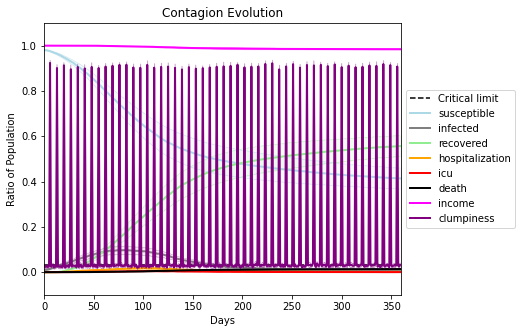

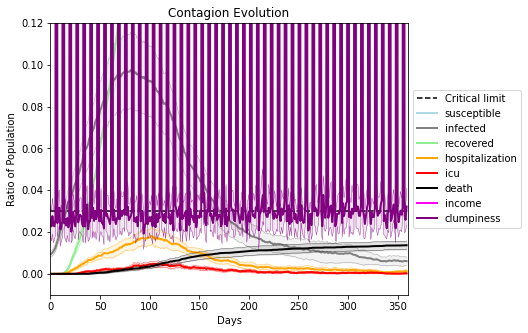

In [36]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.6
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[1131, 8588, 793, 6648, 3456, 5068, 7692, 3836, 7438, 989, 2754, 5886, 9829, 3644, 767, 6167, 2198, 3299, 721, 884]
Average similarity between family members is 0.23307421742915455 at temperature -0.5
Average similarity between family and home is 0.9998578891023769 at temperature -1
Average similarity between students and their classroom is 0.1723995339284074 at temperature -0.5
Average classroom occupancy is 3.888888888888889 and number classrooms is 72
Average similarity between workers is 0.16499060321575978 at temperature -0.5
Average office occupancy is 3.463917525773196 and number offices is 194
Average friend similarity for adults: 0.33523550160244814 for kids: 0.21470878429421056
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Hom

avg restaurant similarity 0.1486884437113135
avg restaurant similarity -0.33339445821426344
avg restaurant similarity 0.2099219886148552
avg restaurant similarity 0.4474704669467805
avg restaurant similarity 0.19406181938841027
avg restaurant similarity -0.08409422288572549
avg restaurant similarity -0.23987017810299527
avg restaurant similarity -0.10302630005903254
avg restaurant similarity -0.06713911828153922
avg restaurant similarity -0.03329422510269192
avg restaurant similarity 0.24972506734579736
avg restaurant similarity 0.11249684030781829
avg restaurant similarity 0.12326249421806273
avg restaurant similarity 0.4634363002943821
avg restaurant similarity -0.1395238519099224
avg restaurant similarity 0.2577058488006864
avg restaurant similarity 0.24452167973533215
avg restaurant similarity 0.012958145063412394
avg restaurant similarity -0.2670013880856065
avg restaurant similarity -0.005900343512823758
avg restaurant similarity 0.06266119649359445
avg restaurant similarity 0.69

Average similarity between workers is 0.1317969310785857 at temperature -0.5
Average office occupancy is 3.245 and number offices is 200
Average friend similarity for adults: 0.3169645173660674 for kids: 0.20617776063602403
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 7 people.
Total of 7 people allocate

avg restaurant similarity 0.07737746042665795
avg restaurant similarity 0.2519496252332946
avg restaurant similarity 0.17391565144213567
avg restaurant similarity 0.2671583289480086
avg restaurant similarity -0.15157430200556
avg restaurant similarity 0.33531517292718416
avg restaurant similarity -0.2216059501248687
avg restaurant similarity 0.02711732549936295
avg restaurant similarity 0.05316125593703942
avg restaurant similarity 0.009189666801393943
avg restaurant similarity 0.25319472184168995
avg restaurant similarity -0.15588135482330504
avg restaurant similarity -0.041443875025687645
avg restaurant similarity 0.10186222480363051
avg restaurant similarity -0.3433843123220043
avg restaurant similarity 0.14420561527039807
avg restaurant similarity 0.23518371442961464
avg restaurant similarity -0.004537476435401533
avg restaurant similarity 0.3383999169007015
avg restaurant similarity -0.04093305752440195
avg restaurant similarity 0.2724567771895991
avg restaurant similarity 0.17970

avg restaurant similarity 0.23592607520149017
avg restaurant similarity -0.45813179460682013
avg restaurant similarity 0.6966552703548067
avg restaurant similarity 0.05166328084306486
avg restaurant similarity 0.03158601267146385
avg restaurant similarity -0.1626551700381152
avg restaurant similarity 0.03598300757781202
avg restaurant similarity -0.2871669601489423
avg restaurant similarity 0.2343930953372365
avg restaurant similarity -0.25752921193994927
avg restaurant similarity 0.3417944091924796
avg restaurant similarity 0.030605735925026575
avg restaurant similarity 0.17323609141313187
avg restaurant similarity 0.1337777788474794
avg restaurant similarity -0.03407469140504759
avg restaurant similarity 0.10444650553520765
avg restaurant similarity -0.19869706940660373
avg restaurant similarity -0.04878526276441507
avg restaurant similarity -0.1603830109303546
avg restaurant similarity 0.06629195577924217
avg restaurant similarity 0.29088758153771094
avg restaurant similarity 0.0662

avg restaurant similarity 0.4240828153497385
avg restaurant similarity -0.15774403197023015
avg restaurant similarity 0.23167329128885514
avg restaurant similarity -0.12652549499588706
avg restaurant similarity -0.17878514158575712
avg restaurant similarity 0.1920950098301492
avg restaurant similarity -0.1992358495728856
avg restaurant similarity 0.8256086915626304
avg restaurant similarity 0.05149056622473375
avg restaurant similarity 0.05552907922523409
avg restaurant similarity -0.03650328882052861
avg restaurant similarity -0.1801311917990548
avg restaurant similarity -0.12652549499588706
avg restaurant similarity -0.1287710241701994
avg restaurant similarity 0.06417305763277417
avg restaurant similarity -0.10358623839186151
avg restaurant similarity 0.0824960434948525
avg restaurant similarity -0.14848247975735843
avg restaurant similarity 0.01807433736073797
avg restaurant similarity 0.21299232061708817
avg restaurant similarity 0.5073582267105068
avg restaurant similarity -0.425

avg restaurant similarity 0.10847549389073313
avg restaurant similarity 0.4224068268912906
avg restaurant similarity 0.13929178853394752
avg restaurant similarity 0.11211544447526953
avg restaurant similarity 0.0988552841256561
avg restaurant similarity -0.09116370607571506
avg restaurant similarity -0.11290012725558402
avg restaurant similarity 0.12020716829713529
avg restaurant similarity 0.30822986705765504
avg restaurant similarity -0.2518388188416136
avg restaurant similarity -0.014953433540132123
avg restaurant similarity 0.08056557575207218
avg restaurant similarity -0.2175681447219605
avg restaurant similarity 0.09762037036869112
avg restaurant similarity 0.2604072929243325
avg restaurant similarity 0.21232222987200286
avg restaurant similarity -0.07408339947307947
avg restaurant similarity -0.20725931974319597
avg restaurant similarity -0.04197307214444823
avg restaurant similarity 0.12576819618478435
avg restaurant similarity 0.3737653914502971
avg restaurant similarity -0.14

avg restaurant similarity -0.09393221228100136
avg restaurant similarity 0.2830983599050969
avg restaurant similarity 0.7102402447994283
avg restaurant similarity 0.2665275377093746
avg restaurant similarity -0.28135187245273585
avg restaurant similarity 0.2807230998050711
avg restaurant similarity 0.06022602250316564
avg restaurant similarity 0.2229644001229517
avg restaurant similarity 0.11991534919367593
avg restaurant similarity 0.21530347479258138
avg restaurant similarity 0.3819531048301157
avg restaurant similarity -0.3887968401609736
avg restaurant similarity -0.135748620700557
avg restaurant similarity 0.10604935851949795
avg restaurant similarity 0.35929626102917733
avg restaurant similarity 0.15583409141398158
avg restaurant similarity 0.33418574133560186
avg restaurant similarity 0.42358498238716036
avg restaurant similarity 0.35313113578786964
avg restaurant similarity -0.17387628587731657
avg restaurant similarity 0.21874300798853658
avg restaurant similarity -0.237352787

avg restaurant similarity 0.01244402410012127
avg restaurant similarity 0.5035772332679601
avg restaurant similarity -0.0023212990480136766
avg restaurant similarity 0.12849434855025785
avg restaurant similarity 0.42468392877509625
avg restaurant similarity 0.06026808963909938
avg restaurant similarity -0.3081689072096528
avg restaurant similarity 0.04132477509027295
avg restaurant similarity 0.05671643964633423
avg restaurant similarity -0.10970741891959981
avg restaurant similarity 0.46666898964379216
avg restaurant similarity 0.0029748218143818977
avg restaurant similarity -0.07671387143109543
avg restaurant similarity -0.10970741891959981
avg restaurant similarity -0.16494617114892393
avg restaurant similarity -0.05859432941594848
avg restaurant similarity 0.36409301156093615
avg restaurant similarity -0.08898573490121048
avg restaurant similarity 0.44819463569774354
avg restaurant similarity 0.20445622101176464
avg restaurant similarity 0.4346468932468839
avg restaurant similarity

avg restaurant similarity 0.23816652221195153
avg restaurant similarity -0.16731569239612312
avg restaurant similarity -0.1723250851695784
avg restaurant similarity -0.41254894161353817
avg restaurant similarity -0.12395879926759365
avg restaurant similarity -0.28095381188182167
avg restaurant similarity 0.683584146483073
avg restaurant similarity -0.11163023818782668
avg restaurant similarity 0.13594204990742037
avg restaurant similarity 0.016675764020093173
avg restaurant similarity -0.23578354482182817
avg restaurant similarity -0.3580579400682477
avg restaurant similarity 0.28478380628876676
avg restaurant similarity 0.1105289145096342
avg restaurant similarity -0.6204159035636445
avg restaurant similarity 0.21160684018572326
avg restaurant similarity -0.15163748076632272
avg restaurant similarity 0.14047846456997942
avg restaurant similarity 0.4312385479464991
avg restaurant similarity 0.13594204990742037
avg restaurant similarity -0.003184110647357921
avg restaurant similarity -0

avg restaurant similarity -0.002856036321404929
avg restaurant similarity 0.225689651628304
avg restaurant similarity 0.03484227799683499
avg restaurant similarity 0.2473455812252695
avg restaurant similarity -0.12919204233480885
avg restaurant similarity 0.10217663651299494
avg restaurant similarity 0.28849256845689697
avg restaurant similarity 0.3350646920082231
avg restaurant similarity 0.46600007642356067
avg restaurant similarity 0.36682900586978995
avg restaurant similarity 0.4022009310634987
avg restaurant similarity -0.10141123269550185
avg restaurant similarity 0.14044576466371897
avg restaurant similarity 0.012686588586798248
avg restaurant similarity -0.20707585103781154
avg restaurant similarity 0.29655677850998957
avg restaurant similarity -0.005296404276113706
avg restaurant similarity -0.2875834876355102
avg restaurant similarity 0.07935086796095506
avg restaurant similarity -0.25901327635432525
avg restaurant similarity -0.4633598494355114
avg restaurant similarity 0.38

avg restaurant similarity 0.027378203938914915
avg restaurant similarity 0.28284184592143613
avg restaurant similarity 0.01342237115529761
avg restaurant similarity 0.28284184592143613
avg restaurant similarity 0.040322383215330826
avg restaurant similarity 0.3350435703348659
avg restaurant similarity -0.008840351245994513
avg restaurant similarity -0.07879333461902478
avg restaurant similarity -0.06854680204498924
avg restaurant similarity 0.2834748308829057
avg restaurant similarity -0.3879937514175161
avg restaurant similarity 0.14785144446786783
avg restaurant similarity 0.13211973396903545
avg restaurant similarity 0.11172705830047774
avg restaurant similarity 0.13596325158057526
avg restaurant similarity 0.09649698458641356
avg restaurant similarity 0.33263641823356926
avg restaurant similarity 0.26266020229295806
avg restaurant similarity 0.18691365147821032
avg restaurant similarity 0.12093113647575754
avg restaurant similarity 0.28284184592143613
avg restaurant similarity 0.06

Average similarity between workers is 0.1596345065595272 at temperature -0.5
Average office occupancy is 3.3137254901960786 and number offices is 204
Average friend similarity for adults: 0.332611571275921 for kids: 0.19016968254750208
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 5 people.
Total of 5 peo

avg restaurant similarity 0.12585389081845133
avg restaurant similarity 0.551332888199459
avg restaurant similarity 0.15990952583798654
avg restaurant similarity -0.05531056665635417
avg restaurant similarity -0.12385548566219022
avg restaurant similarity 0.2577117645220801
avg restaurant similarity -0.03983957529863092
avg restaurant similarity 0.14160384219726405
avg restaurant similarity 0.11682277485930673
avg restaurant similarity 0.24223529679540828
avg restaurant similarity 0.26000996223037354
avg restaurant similarity 0.052451091902231545
avg restaurant similarity 0.24937607237277304
avg restaurant similarity 0.2717156969433424
avg restaurant similarity -0.02372333780461463
avg restaurant similarity -0.10374441511943544
avg restaurant similarity 0.20621921254819825
avg restaurant similarity 0.180102802292336
avg restaurant similarity 0.26160514675009855
avg restaurant similarity -0.24444174229534069
avg restaurant similarity 0.3934428393603923
avg restaurant similarity -0.10949

avg restaurant similarity -0.02336640640354392
avg restaurant similarity 0.3477262003780809
avg restaurant similarity 0.3074668003469847
avg restaurant similarity -0.0013214668041896577
avg restaurant similarity 0.025257108947068282
avg restaurant similarity 0.23005208752680914
avg restaurant similarity 0.5638073446950567
avg restaurant similarity 0.135296179781735
avg restaurant similarity 0.4313146046563333
avg restaurant similarity 0.3907580214569374
avg restaurant similarity 0.20159836736738193
avg restaurant similarity 0.298502153899512
avg restaurant similarity -0.15303355498730992
avg restaurant similarity -0.05064800617046325
avg restaurant similarity 0.1257119091360516
avg restaurant similarity 0.390206331883441
avg restaurant similarity -0.163873972216899
avg restaurant similarity 0.26756066097093045
avg restaurant similarity 0.17338868044197903
avg restaurant similarity 0.1600696402144625
avg restaurant similarity 0.1909095092188122
avg restaurant similarity -0.1644197511172

avg restaurant similarity -0.05753312860854197
avg restaurant similarity -0.12706028480810846
avg restaurant similarity 0.06520391595204984
avg restaurant similarity 0.0827305704677178
avg restaurant similarity 0.146228845190278
avg restaurant similarity 0.5773102860330483
avg restaurant similarity 0.0424579181626176
avg restaurant similarity 0.10811990061556809
avg restaurant similarity 0.03042247827608957
avg restaurant similarity 0.07456374057700862
avg restaurant similarity 0.2603436183889399
avg restaurant similarity 0.1669082026358224
avg restaurant similarity 0.25962999452728397
avg restaurant similarity 0.06263475052794018
avg restaurant similarity -0.09282375458768449
avg restaurant similarity -0.07529625212742706
avg restaurant similarity 0.2003859586479783
avg restaurant similarity -0.13887064114951275
avg restaurant similarity 0.2514455691476725
avg restaurant similarity -0.007880582809293137
avg restaurant similarity 0.12283464814121309
avg restaurant similarity 0.03042247

avg restaurant similarity 0.19197176431495533
avg restaurant similarity -0.19032386877896104
avg restaurant similarity 0.22910337127797104
avg restaurant similarity 0.2722965076340706
avg restaurant similarity 0.002807869329472449
avg restaurant similarity -0.17311990285603845
avg restaurant similarity 0.23094949674072635
avg restaurant similarity 0.036110567985159714
avg restaurant similarity 0.30279930976230274
avg restaurant similarity 0.13972426256178383
avg restaurant similarity -0.11106849157845458
avg restaurant similarity 0.2085126973850713
avg restaurant similarity 0.29182341470137685
avg restaurant similarity 0.17121303696685877
avg restaurant similarity -0.18896974866059954
avg restaurant similarity -0.07865702393000285
avg restaurant similarity -0.14346549910602377
avg restaurant similarity 0.23596891297761938
avg restaurant similarity 0.008142030993684796
avg restaurant similarity 0.23094949674072635
avg restaurant similarity 0.12511593950974853
avg restaurant similarity -

avg restaurant similarity 0.1083199221416441
avg restaurant similarity 0.5310659855012287
avg restaurant similarity 0.2593610959624951
avg restaurant similarity 0.4742836294923648
avg restaurant similarity 0.6221745177900307
avg restaurant similarity 0.16002176430819137
avg restaurant similarity 0.2429838648999054
avg restaurant similarity 0.00413691631504326
avg restaurant similarity -0.1108458207351936
avg restaurant similarity 0.4609713430645839
avg restaurant similarity -0.1273778356187326
avg restaurant similarity 0.4270113416918636
avg restaurant similarity 0.14811532020331022
avg restaurant similarity 0.10950100593785458
avg restaurant similarity 0.14498377135990267
avg restaurant similarity 0.40907306994088166
avg restaurant similarity 0.035076504820815035
avg restaurant similarity 0.42267341806442044
avg restaurant similarity -0.2056446044530243
avg restaurant similarity 0.07792842202363906
avg restaurant similarity 0.1915399439991159
avg restaurant similarity 0.44699076111748

avg restaurant similarity -0.06359038759683946
avg restaurant similarity 0.8076645553401156
avg restaurant similarity 0.11660355595894417
avg restaurant similarity 0.3609320299868842
avg restaurant similarity 0.8076645553401156
avg restaurant similarity -0.20990219869030274
avg restaurant similarity 0.02265865162769795
avg restaurant similarity 0.32898571462026127
avg restaurant similarity -0.30490821691018216
avg restaurant similarity -0.05138234590651032
avg restaurant similarity 0.11120218213249075
avg restaurant similarity 0.4448417353962465
avg restaurant similarity -0.521070956734052
avg restaurant similarity -0.007242880733963605
avg restaurant similarity 0.4360041461496844
avg restaurant similarity 0.29382963003740203
avg restaurant similarity 0.14481288412539406
avg restaurant similarity 0.30626256905394594
avg restaurant similarity -0.30022735403770373
avg restaurant similarity 0.028456760588330274
avg restaurant similarity -0.1322552320991582
avg restaurant similarity -0.140

avg restaurant similarity 0.12893835258906056
avg restaurant similarity -0.157832103635935
avg restaurant similarity -0.1309427465913759
avg restaurant similarity 0.04011466022011421
avg restaurant similarity 0.23009912756821332
avg restaurant similarity 0.16044913486086426
avg restaurant similarity 0.009986782623653295
avg restaurant similarity 0.03598702366923698
avg restaurant similarity 0.30605173437417954
avg restaurant similarity 0.17566622808178667
avg restaurant similarity -0.0005230575482669612
avg restaurant similarity 0.07627830361705962
avg restaurant similarity -0.1867941966643638
avg restaurant similarity 0.02116885883968876
avg restaurant similarity 0.41539850783270993
avg restaurant similarity 0.02116885883968876
avg restaurant similarity 0.06708984385604488
avg restaurant similarity -0.23638864389781108
avg restaurant similarity 0.28454034243117604
avg restaurant similarity 0.07312819754538212
avg restaurant similarity -0.22982374802266242
avg restaurant similarity 0.1

avg restaurant similarity 0.19740370217426073
avg restaurant similarity -0.11352521720785863
avg restaurant similarity -0.019950727459614237
avg restaurant similarity 0.23995906056394536
avg restaurant similarity -0.03970113874099147
avg restaurant similarity 0.3207442379350167
avg restaurant similarity -0.2046759190736116
avg restaurant similarity 0.20916320263066338
avg restaurant similarity -0.028915310016522894
avg restaurant similarity -0.19372349764157826
avg restaurant similarity 0.2375751656237091
avg restaurant similarity 0.22594440226518098
avg restaurant similarity -0.005212547656581634
avg restaurant similarity -0.07073253468088077
avg restaurant similarity 0.19083128134415156
avg restaurant similarity 0.19657575449915038
avg restaurant similarity 0.10889149431292715
avg restaurant similarity 0.2363939076199707
avg restaurant similarity 0.43561783285314865
avg restaurant similarity 0.19119642459865202
avg restaurant similarity 0.1113336773651511
avg restaurant similarity 0.

avg restaurant similarity 0.10775443275217812
avg restaurant similarity -0.04480642398181798
avg restaurant similarity 0.10825760745646996
avg restaurant similarity -0.13545914822092509
avg restaurant similarity 0.29433511747386776
avg restaurant similarity -0.19472272290359618
avg restaurant similarity 0.21498947711416672
avg restaurant similarity 0.27217079774955316
avg restaurant similarity -0.007667426163143684
avg restaurant similarity -0.2012312985393167
avg restaurant similarity 0.029014002422174556
avg restaurant similarity -0.2923545755366026
avg restaurant similarity -0.0469385198831236
avg restaurant similarity 0.02011579592463687
avg restaurant similarity 0.2437847463854989
avg restaurant similarity 0.012944163230907017
avg restaurant similarity -0.05927841499371442
avg restaurant similarity 0.12333383122084371
avg restaurant similarity -0.09638267309903122
avg restaurant similarity 0.08542866163080391
avg restaurant similarity 0.4010500262027165
avg restaurant similarity 0

avg restaurant similarity 0.17374224579822448
avg restaurant similarity -0.08268987129576974
avg restaurant similarity -0.21588628719612682
avg restaurant similarity 0.19922533463671532
avg restaurant similarity 0.013817981058398654
avg restaurant similarity -0.16427320086776076
avg restaurant similarity 0.21842298546313352
avg restaurant similarity 0.23485667046278047
avg restaurant similarity -0.3760934555009401
avg restaurant similarity 0.05003115070938724
avg restaurant similarity 0.34880484621135016
avg restaurant similarity 0.10305993616011176
avg restaurant similarity 0.4709895381349267
avg restaurant similarity 0.7838268387999091
avg restaurant similarity 0.4250617091302744
avg restaurant similarity -0.0023069244378958673
avg restaurant similarity 0.10734853023645007
avg restaurant similarity -0.12965598481161433
avg restaurant similarity -0.14021024488704154
avg restaurant similarity -0.1919970729407632
avg restaurant similarity 0.37044984036367673
avg restaurant similarity 0.

avg restaurant similarity -0.06641125007448713
avg restaurant similarity 0.1729712018505811
avg restaurant similarity -0.01439244109320208
avg restaurant similarity 0.1464811591306695
avg restaurant similarity -0.1828694048288155
avg restaurant similarity -0.1341876424190826
avg restaurant similarity -0.016801605729748124
avg restaurant similarity 0.009977569608810959
avg restaurant similarity 0.21766263208367376
avg restaurant similarity 0.23235015742804394
avg restaurant similarity 0.09587472823775448
avg restaurant similarity -0.3522901885606319
avg restaurant similarity -0.07782697728204184
avg restaurant similarity -0.2970897579044148
avg restaurant similarity 0.08606253335295912
avg restaurant similarity -0.11419616488269722
avg restaurant similarity -0.10669006294152278
avg restaurant similarity 0.07085549501039047
avg restaurant similarity 0.5350069787643951
avg restaurant similarity 0.020494033257685694
avg restaurant similarity -0.5019435305905815
avg restaurant similarity 0.

(<function dict.items>, <function dict.items>, <function dict.items>)

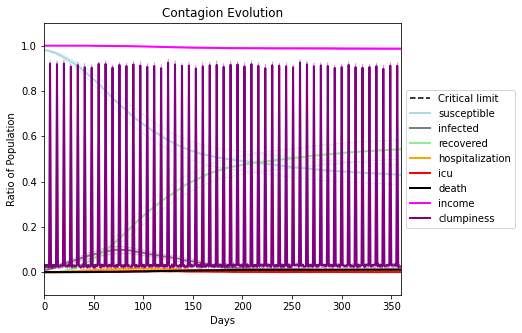

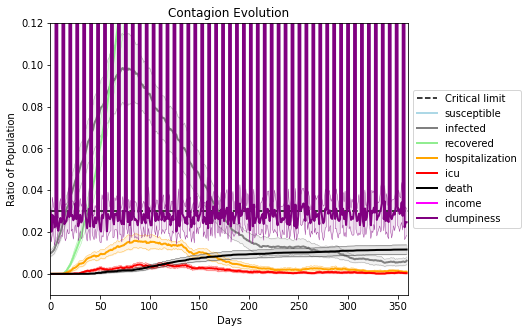

In [37]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.5
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[9240, 8894, 3670, 7699, 4534, 2467, 7174, 4385, 9992, 4095, 6070, 9884, 9890, 1897, 4173, 4426, 436, 4260, 6427, 5092]
Average similarity between family members is 0.2088851900112813 at temperature -0.4
Average similarity between family and home is 0.9998577240539208 at temperature -1
Average similarity between students and their classroom is 0.15763791199408358 at temperature -0.4
Average classroom occupancy is 4.180555555555555 and number classrooms is 72
Average similarity between workers is 0.13577443092476163 at temperature -0.4
Average office occupancy is 3.18407960199005 and number offices is 201
Average friend similarity for adults: 0.2809159326517594 for kids: 0.1938575784655778
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Ho

avg restaurant similarity -0.3811431426505787
avg restaurant similarity 0.06306843879892392
avg restaurant similarity 0.3408368834525231
avg restaurant similarity -0.30817442524431715
avg restaurant similarity 0.6245327854599884
avg restaurant similarity -0.03979982622321805
avg restaurant similarity 0.043636690591053164
avg restaurant similarity -0.15268382880482076
avg restaurant similarity 0.11060074767086404
avg restaurant similarity 0.2726125078866979
avg restaurant similarity 0.3512635786748353
avg restaurant similarity 0.16635085526885382
avg restaurant similarity 0.3219634479935812
avg restaurant similarity 0.1262038879821759
avg restaurant similarity 0.4305045034466972
avg restaurant similarity -0.06188876012341288
avg restaurant similarity -7.559561599389253e-06
avg restaurant similarity -0.10915344101484573
avg restaurant similarity 0.41095139646076784
avg restaurant similarity 0.06454714554341492
avg restaurant similarity -0.07532909460590616
avg restaurant similarity 0.091

avg restaurant similarity 0.10371752627659936
avg restaurant similarity 0.3279113325050416
avg restaurant similarity -0.1554678898698851
avg restaurant similarity 0.22438250375224075
avg restaurant similarity 0.07695802842479274
avg restaurant similarity 0.03526375609024068
avg restaurant similarity 0.07166689589509508
avg restaurant similarity 0.40336977720482714
avg restaurant similarity 0.4475597750867013
avg restaurant similarity 0.33740565611819673
avg restaurant similarity -0.16539025849903444
avg restaurant similarity 0.18721276659294708
avg restaurant similarity -0.009966563598113709
avg restaurant similarity 0.5567406933511037
avg restaurant similarity 0.12788689511352425
avg restaurant similarity -0.015235008616064971
avg restaurant similarity 0.055892063551990744
avg restaurant similarity 0.22438250375224075
avg restaurant similarity -0.11457910532854305
avg restaurant similarity 0.37024869127220866
avg restaurant similarity 0.5176023561552728
avg restaurant similarity -0.16

avg restaurant similarity 0.024187569782783358
avg restaurant similarity 0.3494750360422689
avg restaurant similarity -0.11001564153495315
avg restaurant similarity 0.1268926819592489
avg restaurant similarity 0.20969989771019423
avg restaurant similarity 0.33152590080211114
avg restaurant similarity 0.05994981691095172
avg restaurant similarity -0.22810469673492134
avg restaurant similarity 0.17023723739098756
avg restaurant similarity 0.4174954307683819
avg restaurant similarity 0.25462770451109595
avg restaurant similarity 0.1800548879322981
avg restaurant similarity 0.19239306407160348
avg restaurant similarity 0.1462493384905053
avg restaurant similarity -0.3353122107998737
avg restaurant similarity 0.038463339544524716
avg restaurant similarity -0.2912012607503737
avg restaurant similarity 0.41926704664379233
avg restaurant similarity -0.02173945236565343
avg restaurant similarity 0.4374273270353495
avg restaurant similarity -0.11211167049486095
avg restaurant similarity 0.038463

avg restaurant similarity -0.1372666072335623
avg restaurant similarity 0.26573964825001195
avg restaurant similarity -0.17863079565053197
avg restaurant similarity 0.050902150215114045
avg restaurant similarity 0.24845133849465012
avg restaurant similarity -0.2261085602141722
avg restaurant similarity -0.2876398257139867
avg restaurant similarity 0.04080864826817898
avg restaurant similarity 0.13118662627958005
avg restaurant similarity 0.0051724357553937575
avg restaurant similarity -0.25452097742313506
avg restaurant similarity -0.14206770622443843
avg restaurant similarity 0.02050209048625327
avg restaurant similarity 0.020661687619220742
avg restaurant similarity 0.02433090452502618
avg restaurant similarity 0.5553911777985124
avg restaurant similarity -0.09684411121067876
avg restaurant similarity -0.05862278914590234
avg restaurant similarity -0.28009617172493273
avg restaurant similarity -0.09641014595464996
avg restaurant similarity 0.07755321027451871
avg restaurant similarit

avg restaurant similarity 0.18438967389855013
avg restaurant similarity 0.19225575658104024
avg restaurant similarity 0.06003404149241846
avg restaurant similarity -0.18834459045501095
avg restaurant similarity 0.1455414228885939
avg restaurant similarity 0.05577813042797723
avg restaurant similarity 0.1521908431469551
avg restaurant similarity -0.027996894872372752
avg restaurant similarity -0.14188604492791337
avg restaurant similarity 0.2712526641622327
avg restaurant similarity 0.2520138883680185
avg restaurant similarity 0.058964051598829226
avg restaurant similarity 0.42663753089243495
avg restaurant similarity 0.33710081401632663
avg restaurant similarity 0.1455414228885939
avg restaurant similarity 0.011924170775209401
avg restaurant similarity -0.16146328674831723
avg restaurant similarity 0.031166869178703028
avg restaurant similarity -0.33545697763928384
avg restaurant similarity 0.12152298053736946
avg restaurant similarity 0.4668275684102807
avg restaurant similarity 0.283

avg restaurant similarity 0.20645471285705752
avg restaurant similarity 0.5051320871744461
avg restaurant similarity 0.282569557663436
avg restaurant similarity 0.10153602736194699
avg restaurant similarity 0.20021389140934956
avg restaurant similarity 0.26606362759906055
avg restaurant similarity 0.3121387050272183
avg restaurant similarity -0.09519086653973449
avg restaurant similarity -0.045660374234882145
avg restaurant similarity 0.10143264056090011
avg restaurant similarity 0.0200812533575642
avg restaurant similarity -0.1911698971814034
avg restaurant similarity 0.17273978447161065
avg restaurant similarity 0.1253875650088408
avg restaurant similarity 0.03490703679042312
avg restaurant similarity -0.08392052227200718
avg restaurant similarity 0.3312540735782802
avg restaurant similarity 0.24675084971232358
avg restaurant similarity 0.10732898047923423
avg restaurant similarity 0.2730961725284065
avg restaurant similarity 0.41443611995639557
avg restaurant similarity 0.1645825188

avg restaurant similarity 0.5272320999506307
avg restaurant similarity -0.07454364873087081
avg restaurant similarity -0.13361561652390339
avg restaurant similarity 0.17273978447161065
avg restaurant similarity 0.3166916590866702
avg restaurant similarity 0.12738570933882457
avg restaurant similarity 0.2547413015314922
avg restaurant similarity 0.3956938230929242
avg restaurant similarity 0.1526466954505528
avg restaurant similarity 0.017221368677704782
avg restaurant similarity -0.33764205698374855
avg restaurant similarity 0.08515864532388773
avg restaurant similarity 0.5763554740243215
avg restaurant similarity 0.17061777675254358
avg restaurant similarity -0.02183595247462159
avg restaurant similarity -0.17878323769689808
avg restaurant similarity 0.011058456645275161
avg restaurant similarity 0.30429052562432335
avg restaurant similarity -0.0756043914702288
avg restaurant similarity -0.14601456242559438
avg restaurant similarity -0.07454364873087081
avg restaurant similarity 0.556

avg restaurant similarity 0.26731984107959955
avg restaurant similarity 0.18298072307764665
avg restaurant similarity 0.379158481652465
avg restaurant similarity 0.19621619629850529
avg restaurant similarity -0.10253802306984414
avg restaurant similarity 0.22002502516944372
avg restaurant similarity -0.018524885623016157
avg restaurant similarity 0.3867507871830603
avg restaurant similarity 0.6738577754553156
avg restaurant similarity 0.08206282660342934
avg restaurant similarity 0.3293257181865527
avg restaurant similarity 0.282807392478328
avg restaurant similarity -0.019125888280121118
avg restaurant similarity 0.5256344832031385
avg restaurant similarity -0.7649060253874869
avg restaurant similarity 0.18362660179804197
avg restaurant similarity 0.17425189815124686
avg restaurant similarity 0.2099200361933682
avg restaurant similarity -0.04425481741773923
avg restaurant similarity 0.24259219479592575
avg restaurant similarity -0.30068250877079683
avg restaurant similarity -0.1291856

avg restaurant similarity 0.07101177231379392
avg restaurant similarity 0.14288165032997116
avg restaurant similarity -0.023702270686539788
avg restaurant similarity 0.1297612476344239
avg restaurant similarity 0.15834298605249303
avg restaurant similarity -0.06269094149742042
avg restaurant similarity 0.4938441271979678
avg restaurant similarity -0.05253974505058936
avg restaurant similarity 0.32618615077317753
avg restaurant similarity 0.025775311997194655
avg restaurant similarity 0.2711514426762798
avg restaurant similarity -0.023702270686539788
avg restaurant similarity 0.5498229387509604
avg restaurant similarity -0.012371753826575738
avg restaurant similarity -0.15656153063272835
avg restaurant similarity 0.0001651767305075047
avg restaurant similarity -0.11337874533312665
avg restaurant similarity -0.22197760194762903
avg restaurant similarity 0.15880915258396616
avg restaurant similarity 0.11168527222549177
avg restaurant similarity 0.07293458598583183
avg restaurant similarit

avg restaurant similarity 0.05859152951306344
avg restaurant similarity 0.04499451051432739
avg restaurant similarity -0.10033475718547222
avg restaurant similarity 0.04987472690352322
avg restaurant similarity 0.013731197695016795
avg restaurant similarity 0.16051433182548255
avg restaurant similarity 0.1419899504387169
avg restaurant similarity -0.12668356496738267
avg restaurant similarity -0.3547716923924204
avg restaurant similarity -0.23623927908718695
avg restaurant similarity -0.15782922702828642
avg restaurant similarity 0.36000221052914594
avg restaurant similarity -0.16358175798588043
avg restaurant similarity -0.14929889205850494
avg restaurant similarity -0.15990372981397755
avg restaurant similarity -0.304974404552941
avg restaurant similarity 0.18064396509189828
avg restaurant similarity 0.17599343064832385
avg restaurant similarity 0.02299837493348221
avg restaurant similarity 0.19919322142521534
avg restaurant similarity -0.22220196923687102
avg restaurant similarity 0

avg restaurant similarity 0.17545849224281193
avg restaurant similarity 0.324901236046047
avg restaurant similarity 0.2878331898906165
avg restaurant similarity -0.2898832976886829
avg restaurant similarity -0.0774589805255684
avg restaurant similarity 0.15433233032002325
avg restaurant similarity 0.2286349662328694
avg restaurant similarity -0.03730927044326497
avg restaurant similarity 0.27919784857704283
avg restaurant similarity 0.06688411585008788
avg restaurant similarity 0.24213185950071034
avg restaurant similarity 0.155932741813623
avg restaurant similarity -0.15469003831957634
avg restaurant similarity 0.02492031270922056
avg restaurant similarity 0.0314387561412489
avg restaurant similarity -0.12723563773321958
avg restaurant similarity -0.29077963900575204
avg restaurant similarity -0.2771650417202441
avg restaurant similarity 0.14319487569570655
avg restaurant similarity 0.03747200564756123
avg restaurant similarity 0.30582004689731246
avg restaurant similarity 0.222035282

Average friend similarity for adults: 0.2806545272779376 for kids: 0.2000645892139223
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocat

avg restaurant similarity 0.2263864696182847
avg restaurant similarity 0.16852966575956488
avg restaurant similarity 0.26703918821497397
avg restaurant similarity 0.25624177753505417
avg restaurant similarity 0.1741418466999176
avg restaurant similarity 0.17183322447557958
avg restaurant similarity 0.22422172656958544
avg restaurant similarity 0.016859625621461802
avg restaurant similarity 0.18431242488148
avg restaurant similarity -0.44349004941569464
avg restaurant similarity -0.11879429945138326
avg restaurant similarity 0.08058779065843504
avg restaurant similarity 0.008123976632065516
avg restaurant similarity 0.05150547307239523
avg restaurant similarity 0.16166893211331676
avg restaurant similarity -0.12855343224787533
avg restaurant similarity -0.17180807833017747
avg restaurant similarity -0.13871696800472594
avg restaurant similarity 0.4861476559008997
avg restaurant similarity 0.13814481243458893
avg restaurant similarity 0.12461604355463766
avg restaurant similarity 0.36773

avg restaurant similarity 0.06948548311268246
avg restaurant similarity 0.20003923181599076
avg restaurant similarity 0.43878442176089916
avg restaurant similarity 0.08467293303617614
avg restaurant similarity 0.16814798069112682
avg restaurant similarity 0.18696941501698308
avg restaurant similarity -0.1839580818911542
avg restaurant similarity -0.031058266215327125
avg restaurant similarity 0.06111833507627438
avg restaurant similarity 0.31588067034565936
avg restaurant similarity 0.15163012958150943
avg restaurant similarity -0.3067337839556766
avg restaurant similarity 0.26231571220399413
avg restaurant similarity 0.1453468215855247
avg restaurant similarity 0.09231706676924112
avg restaurant similarity 0.21662182839232166
avg restaurant similarity 0.0014912916593314127
Average similarity between family members is 0.19142465011665252 at temperature -0.4
Average similarity between family and home is 0.9998514871885854 at temperature -1
Average similarity between students and their c

avg restaurant similarity 0.26179031087354554
avg restaurant similarity -0.05046057011503479
avg restaurant similarity 0.18261611389414129
avg restaurant similarity 0.18378152362979358
avg restaurant similarity 0.47598319445724113
avg restaurant similarity 0.3495771812263088
avg restaurant similarity 0.12564182119292808
avg restaurant similarity 0.15285345075835305
avg restaurant similarity 0.18555037606250896
avg restaurant similarity 0.1355880348864857
avg restaurant similarity 0.2977974259608747
avg restaurant similarity 0.41419457299986945
avg restaurant similarity 0.04028086591605615
avg restaurant similarity -0.24382310717321926
avg restaurant similarity -0.109773587813923
avg restaurant similarity 0.312545208563848
avg restaurant similarity 0.3855310391054477
avg restaurant similarity -0.23112018217274866
avg restaurant similarity 0.04028086591605615
avg restaurant similarity 0.021846298465070968
avg restaurant similarity -0.02889320583577023
avg restaurant similarity 0.22925018

avg restaurant similarity 0.026224770623850462
avg restaurant similarity 0.0937965935402843
avg restaurant similarity 0.02437081122924399
avg restaurant similarity -0.3630921651177949
avg restaurant similarity -0.010328217639093043
avg restaurant similarity -0.040294492172004495
avg restaurant similarity 0.20987354160928604
avg restaurant similarity -0.1497029227342147
avg restaurant similarity 0.1018552917180188
avg restaurant similarity 0.35454898087076714
avg restaurant similarity -0.2879826572503756
avg restaurant similarity 0.594099917462207
avg restaurant similarity 0.08763855535609377
avg restaurant similarity -0.21042967003053437
avg restaurant similarity 0.22029514597449346
avg restaurant similarity -0.2792981746313917
avg restaurant similarity -0.2315403930914456
avg restaurant similarity 0.017719117493586893
avg restaurant similarity 0.7699651636343613
avg restaurant similarity -0.10383729406869804
avg restaurant similarity -0.10084309073332223
avg restaurant similarity 0.00

Average similarity between workers is 0.16410220164155556 at temperature -0.4
Average office occupancy is 3.242424242424242 and number offices is 198
Average friend similarity for adults: 0.2766298621513912 for kids: 0.2070721412760736
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 peo

avg restaurant similarity 0.5925463827780477
avg restaurant similarity 0.17740613211477343
avg restaurant similarity 0.3713624701995627
avg restaurant similarity -0.023002086422387394
avg restaurant similarity 0.14029936719519742
avg restaurant similarity 0.08034572454314451
avg restaurant similarity 0.2918776083881126
avg restaurant similarity -0.12722047266952624
avg restaurant similarity 0.3203794150595587
avg restaurant similarity 0.4130275163941106
avg restaurant similarity 0.2918776083881126
avg restaurant similarity 0.4000617506005042
avg restaurant similarity -0.32405696618474134
avg restaurant similarity -0.021243962241737885
avg restaurant similarity 0.652080652550025
avg restaurant similarity 0.018252887292816152
avg restaurant similarity 0.052000796419087766
avg restaurant similarity 0.024678860325824212
avg restaurant similarity 0.017134188279247158
avg restaurant similarity -0.2492097809671784
avg restaurant similarity 0.41393161656448724
avg restaurant similarity -0.0327

avg restaurant similarity 0.03689374986913724
avg restaurant similarity 0.30010515179491337
avg restaurant similarity 0.07267030440482379
avg restaurant similarity 0.2821555077006347
avg restaurant similarity 0.42438853147707595
avg restaurant similarity 0.07280039020279681
avg restaurant similarity 0.026738593630551498
avg restaurant similarity -0.1938263519681379
avg restaurant similarity 0.2561677296046972
avg restaurant similarity 0.24375471039445085
avg restaurant similarity 0.2892388867987623
avg restaurant similarity -0.0705723551534446
avg restaurant similarity 0.31029782221022384
avg restaurant similarity 0.1578223842181184
avg restaurant similarity 0.3386082767944996
avg restaurant similarity 0.16101336558983068
avg restaurant similarity -0.05039162187073679
avg restaurant similarity -0.02936652033048341
avg restaurant similarity 0.15962947753846465
avg restaurant similarity -0.053589920406096
avg restaurant similarity -0.5205014144894263
avg restaurant similarity -0.28845058

avg restaurant similarity -0.11194396412637098
avg restaurant similarity -0.05375151254491423
avg restaurant similarity -0.057228564645986676
avg restaurant similarity -0.09300532588949649
avg restaurant similarity -0.03597323710837427
avg restaurant similarity -0.11715226649300435
avg restaurant similarity 0.10237581800988535
avg restaurant similarity 0.014114068202737903
avg restaurant similarity 0.020240558282598714
avg restaurant similarity 0.4283103985210193
avg restaurant similarity 0.10617730546221574
avg restaurant similarity 0.2949034802611357
avg restaurant similarity -0.1179559130669504
Average similarity between family members is 0.24685226540940328 at temperature -0.4
Average similarity between family and home is 0.9998489662572257 at temperature -1
Average similarity between students and their classroom is 0.18534422860711428 at temperature -0.4
Average classroom occupancy is 4.083333333333333 and number classrooms is 72
Average similarity between workers is 0.16206656753

avg restaurant similarity 0.3744950597865921
avg restaurant similarity -0.19354905844589726
avg restaurant similarity 0.05423601362697189
avg restaurant similarity -0.09947858339579282
avg restaurant similarity -0.20555423981155777
avg restaurant similarity 0.05929539184665186
avg restaurant similarity 0.22055858579840243
avg restaurant similarity 0.14514843618129164
avg restaurant similarity -0.18893972558768887
avg restaurant similarity 0.14007712087604396
avg restaurant similarity -0.17376486438366034
avg restaurant similarity 0.3841268233353208
avg restaurant similarity 0.33774244165536943
avg restaurant similarity -0.1694861350091325
avg restaurant similarity 0.2731197750039052
avg restaurant similarity 0.4488325346037112
avg restaurant similarity 0.34011842274636894
avg restaurant similarity -0.016927739501369055
avg restaurant similarity -0.08518575029224762
avg restaurant similarity 0.09370359906050693
avg restaurant similarity -0.10381242803540353
avg restaurant similarity -0.

avg restaurant similarity 0.04217141942346365
avg restaurant similarity -0.0575422744880633
avg restaurant similarity -0.16092508108006442
avg restaurant similarity -0.11679627906768209
avg restaurant similarity -0.004048975280471108
avg restaurant similarity 0.31893600654024823
avg restaurant similarity -0.06420071312759576
avg restaurant similarity -0.13453536626947685
avg restaurant similarity 0.07131893218114159
avg restaurant similarity -0.07752612158305988
avg restaurant similarity -0.2303021056459092
avg restaurant similarity -0.0013423108901133192
avg restaurant similarity -0.26376784346809473
avg restaurant similarity 0.022345230843437154
avg restaurant similarity 0.1810721730109396
avg restaurant similarity 0.0902559999946655
avg restaurant similarity 0.4428657759835909
avg restaurant similarity 0.01027487963804332
avg restaurant similarity -0.12600304084686897
avg restaurant similarity 0.23733092708594233
avg restaurant similarity -0.27000771289853676
avg restaurant similari

avg restaurant similarity -0.14169153146419292
avg restaurant similarity 0.1966420590266582
avg restaurant similarity 0.5579688298839909
avg restaurant similarity -0.017659168237961053
avg restaurant similarity 0.04718187627345048
avg restaurant similarity -0.12160050399269712
avg restaurant similarity 0.48830219977879274
avg restaurant similarity -0.12780559998385554
avg restaurant similarity -0.08656090453442328
avg restaurant similarity 0.033140996488562384
avg restaurant similarity -0.03051546106343255
avg restaurant similarity -0.086760640458895
avg restaurant similarity -0.07221153501371008
avg restaurant similarity 0.21070286779950975
avg restaurant similarity 0.2250857123227792
avg restaurant similarity 0.1618019104996586
avg restaurant similarity 0.12254932173061456
avg restaurant similarity -0.12429993422213556
avg restaurant similarity 0.18616518282886965
avg restaurant similarity 0.033140996488562384
avg restaurant similarity -0.28133733549239065
avg restaurant similarity -

avg restaurant similarity 0.37001124672809954
avg restaurant similarity 0.5459425141586354
avg restaurant similarity 0.1324347962032225
avg restaurant similarity 0.32301097129645395
avg restaurant similarity -0.07815558317820344
avg restaurant similarity 0.05642560750501296
avg restaurant similarity -0.028835643614860892
avg restaurant similarity -0.1535923506535336
avg restaurant similarity 0.16899408344077232
avg restaurant similarity -0.04104842464280732
avg restaurant similarity 0.20913831408891295
avg restaurant similarity 0.2930959293543993
avg restaurant similarity -0.3319535623585194
avg restaurant similarity -0.16016925361453024
avg restaurant similarity -0.05823304955075295
avg restaurant similarity -0.028204808549894184
avg restaurant similarity 0.23330680318088445
avg restaurant similarity 0.12333230049966803
avg restaurant similarity -0.00979070510400544
avg restaurant similarity 0.31505394607442144
avg restaurant similarity 0.0671820604465462
avg restaurant similarity 0.1

avg restaurant similarity 0.08925866368260776
avg restaurant similarity -0.15826635316896995
avg restaurant similarity -0.14060123156023496
avg restaurant similarity 0.5735738026272837
avg restaurant similarity 0.4182813951032911
avg restaurant similarity 0.1282491470918383
avg restaurant similarity 0.08979784449641595
avg restaurant similarity 0.38038042328299615
avg restaurant similarity 0.3022633812254705
avg restaurant similarity -0.20228952863259791
avg restaurant similarity -0.07589950255745509
avg restaurant similarity -0.013727845155829945
avg restaurant similarity 0.1924066872088634
avg restaurant similarity 0.4182813951032911
avg restaurant similarity 0.17971066414571502
avg restaurant similarity 0.05261784868970056
avg restaurant similarity 0.0494217952400565
avg restaurant similarity 0.04887395415798211
avg restaurant similarity 0.42815923359347474
avg restaurant similarity 0.21023350509238645
avg restaurant similarity 0.1676518060462408
avg restaurant similarity 0.09098708

(<function dict.items>, <function dict.items>, <function dict.items>)

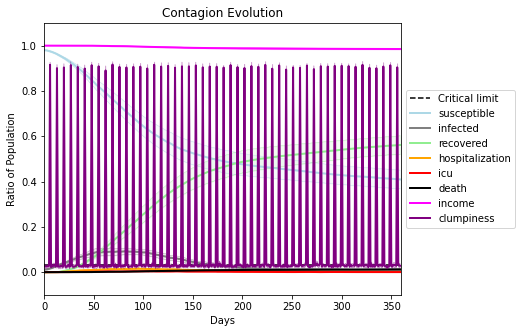

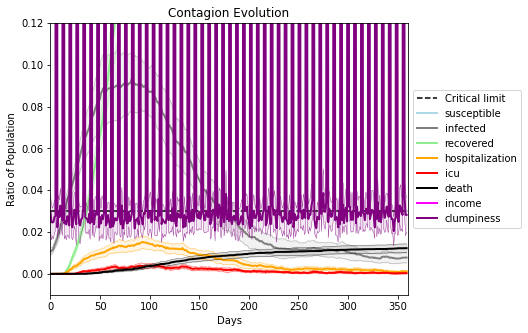

In [38]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.4
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[4104, 8707, 669, 48, 1716, 307, 4309, 1531, 3745, 4459, 97, 885, 7544, 5602, 4609, 8170, 5719, 7422, 6920, 5184]
Average similarity between family members is 0.19179211056983492 at temperature -0.3
Average similarity between family and home is 0.999858126423105 at temperature -1
Average similarity between students and their classroom is 0.15488649471637095 at temperature -0.3
Average classroom occupancy is 4.304347826086956 and number classrooms is 69
Average similarity between workers is 0.14618538783577706 at temperature -0.3
Average office occupancy is 3.202970297029703 and number offices is 202
Average friend similarity for adults: 0.243124739214405 for kids: 0.19522409800867807
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homogeneo

avg restaurant similarity 0.008169523334443846
avg restaurant similarity 0.05381972767759144
avg restaurant similarity -0.1260784707854702
avg restaurant similarity 0.22892012131139117
avg restaurant similarity 0.023147047829466763
avg restaurant similarity -0.06790262143721934
avg restaurant similarity 0.13285881536981659
avg restaurant similarity -0.03992088872287445
avg restaurant similarity 0.04499170086027493
avg restaurant similarity 0.2070646998371331
avg restaurant similarity 0.30884915706193844
avg restaurant similarity 0.027098999246310096
avg restaurant similarity -0.08582792775174128
avg restaurant similarity 0.1720701871664561
avg restaurant similarity 0.30685893893482136
avg restaurant similarity 0.08034529138503105
avg restaurant similarity 0.36090954842732326
avg restaurant similarity -0.1751081486949698
avg restaurant similarity 0.21857663106398717
avg restaurant similarity -0.3243970150980642
avg restaurant similarity -0.08582792775174128
avg restaurant similarity 0.0

avg restaurant similarity 0.11212066269283055
avg restaurant similarity 0.2170843055373705
avg restaurant similarity 0.4826258771840832
avg restaurant similarity 0.08009043770025498
avg restaurant similarity 0.11015015183050914
avg restaurant similarity 0.4037338733193242
avg restaurant similarity 0.17554690771989365
avg restaurant similarity -0.03442542908062059
avg restaurant similarity -0.10622735663964539
avg restaurant similarity 0.06713785969908184
avg restaurant similarity -0.4410563773945533
avg restaurant similarity 0.6326611955955102
avg restaurant similarity -0.02614780349288685
avg restaurant similarity -0.1002813740361831
avg restaurant similarity -0.2726722969945068
avg restaurant similarity -0.12181019407459127
avg restaurant similarity 0.03450321131377116
avg restaurant similarity 0.12205829311906288
avg restaurant similarity -0.07053501492407373
avg restaurant similarity -0.18382071326185054
avg restaurant similarity 0.3361992404885124
avg restaurant similarity 0.38697

avg restaurant similarity -0.1233860563239797
avg restaurant similarity 0.08826137061992749
avg restaurant similarity 0.011631418809771144
avg restaurant similarity -0.1453208422789538
avg restaurant similarity -0.012878802453562155
avg restaurant similarity -0.30619610890783083
avg restaurant similarity -0.1956562440466815
avg restaurant similarity 0.035645242711464395
avg restaurant similarity -0.14922087493855019
avg restaurant similarity -0.469172033707035
avg restaurant similarity 0.4941230774999482
avg restaurant similarity -0.005058299149367784
avg restaurant similarity -0.15219204815381965
avg restaurant similarity 0.06063667985236107
avg restaurant similarity 0.03063378677741667
avg restaurant similarity 0.06437572858300522
avg restaurant similarity -0.06256034456035264
avg restaurant similarity 0.0769302472059605
Average similarity between family members is 0.17994980294801566 at temperature -0.3
Average similarity between family and home is 0.9998647584108998 at temperature 

avg restaurant similarity 0.033992863848225176
avg restaurant similarity 0.9023571965604849
avg restaurant similarity -0.20750054021987502
avg restaurant similarity 0.012728445761146645
avg restaurant similarity -0.01274994294237354
avg restaurant similarity 0.3183443119939664
avg restaurant similarity -0.07043658451602289
avg restaurant similarity -0.06972979032402091
avg restaurant similarity 0.5856341811179668
avg restaurant similarity 0.4602019660858972
avg restaurant similarity -0.09177891085616377
avg restaurant similarity 0.4259805637938478
avg restaurant similarity 0.5677444083192025
avg restaurant similarity 0.011733785612439148
avg restaurant similarity -0.17026824066060262
avg restaurant similarity 0.04810702592673462
avg restaurant similarity 0.252266863205047
avg restaurant similarity -0.060768294814260625
avg restaurant similarity 0.00854992795018946
avg restaurant similarity 0.05963247332018613
avg restaurant similarity -0.02129998162328533
avg restaurant similarity 0.39

avg restaurant similarity 0.08310219735978613
avg restaurant similarity -0.002068865905292549
avg restaurant similarity 0.12859606274586455
avg restaurant similarity 0.010894823327068991
avg restaurant similarity 0.5536034030406113
avg restaurant similarity 0.0028303229028030785
Average similarity between family members is 0.18767480842938444 at temperature -0.3
Average similarity between family and home is 0.9998592351345212 at temperature -1
Average similarity between students and their classroom is 0.18201523244139053 at temperature -0.3
Average classroom occupancy is 4.208333333333333 and number classrooms is 72
Average similarity between workers is 0.1581811930414564 at temperature -0.3
Average office occupancy is 3.1940298507462686 and number offices is 201
Average friend similarity for adults: 0.2322233314175213 for kids: 0.19559028376273294
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units wi

avg restaurant similarity -0.216089939666591
avg restaurant similarity 0.1903143323288775
avg restaurant similarity 0.24583434341854823
avg restaurant similarity 0.6351139015010532
avg restaurant similarity -0.11778937246083117
avg restaurant similarity -0.056205940661823814
avg restaurant similarity 0.27659104360760833
avg restaurant similarity -0.1476851367911825
avg restaurant similarity -0.14804411016244567
avg restaurant similarity -0.07808381860267136
avg restaurant similarity -0.06604420140265463
avg restaurant similarity 0.07395348966706326
avg restaurant similarity -0.2056819629987415
avg restaurant similarity -0.05276453787324259
avg restaurant similarity -0.22779611559704505
avg restaurant similarity -0.013518819806559876
avg restaurant similarity -0.216089939666591
avg restaurant similarity 0.0921816983709744
avg restaurant similarity 0.0037356964956720452
avg restaurant similarity 0.07684247534670478
avg restaurant similarity -0.17945586819733378
avg restaurant similarity 

avg restaurant similarity 0.3303747963852859
avg restaurant similarity 0.27377788501859496
avg restaurant similarity -0.12996760638855287
avg restaurant similarity 0.11746502978234441
avg restaurant similarity 0.2145266297073592
avg restaurant similarity 0.11493917625878303
avg restaurant similarity 0.15686791453747762
avg restaurant similarity 0.10546378105304116
avg restaurant similarity 0.07363175129774532
avg restaurant similarity -0.10187476567079408
avg restaurant similarity 0.09055248314997792
avg restaurant similarity 0.26808319547283627
avg restaurant similarity 0.11848335260729369
avg restaurant similarity -0.2575013928185495
avg restaurant similarity 0.12785060493718378
avg restaurant similarity 0.19540294545384362
avg restaurant similarity -0.13704601115995055
avg restaurant similarity 0.12453540979583724
avg restaurant similarity 0.3819803892145673
avg restaurant similarity -0.012613039116829927
avg restaurant similarity 0.0687217239438882
avg restaurant similarity 0.10057

avg restaurant similarity 0.6197007147015003
avg restaurant similarity 0.4347174212049814
avg restaurant similarity 0.20800497335689655
avg restaurant similarity 0.023525992129805943
avg restaurant similarity 0.27435189957422135
avg restaurant similarity -0.050848255262047705
avg restaurant similarity 0.45991636832069444
avg restaurant similarity -0.19217519656895204
avg restaurant similarity 0.2601813043541892
avg restaurant similarity 0.1285278454834989
avg restaurant similarity 0.3936042543025039
avg restaurant similarity 0.16964642333897006
avg restaurant similarity 0.08998578905067876
avg restaurant similarity 0.21212549520368984
avg restaurant similarity -0.031444606403182106
avg restaurant similarity 0.02821487616711549
avg restaurant similarity 0.0547443367694276
avg restaurant similarity 0.48128641136686806
avg restaurant similarity 0.3237162340793622
avg restaurant similarity 0.19634524461365632
avg restaurant similarity 0.04338636382463233
avg restaurant similarity -0.092857

avg restaurant similarity -0.013048927743768557
avg restaurant similarity 0.411192070997605
avg restaurant similarity -0.13252738474620984
avg restaurant similarity 0.0528620571572872
avg restaurant similarity 0.17978018385752428
avg restaurant similarity 0.42750594435186007
avg restaurant similarity -0.29933770730469456
avg restaurant similarity -0.27524367275962225
avg restaurant similarity -0.2655572345630406
avg restaurant similarity 0.00460240734363096
avg restaurant similarity 0.06097290547122396
avg restaurant similarity 0.05696982232936995
avg restaurant similarity 0.13532351597804484
avg restaurant similarity 0.4958858757027
avg restaurant similarity -0.394324708585416
avg restaurant similarity -0.09082641590950472
avg restaurant similarity 0.19428689745385375
avg restaurant similarity 0.13674503000411703
avg restaurant similarity -0.05143046988315304
avg restaurant similarity -0.20238941605966862
avg restaurant similarity 0.19428689745385375
avg restaurant similarity 0.429318

avg restaurant similarity -0.12366622714318543
avg restaurant similarity -0.2174450926074936
avg restaurant similarity -0.3354391200392557
avg restaurant similarity -0.2647050849126801
avg restaurant similarity 0.3134181006483265
avg restaurant similarity -0.13902989641798533
avg restaurant similarity -0.3586517575215404
avg restaurant similarity -0.025312563445261095
avg restaurant similarity -0.04589674157039492
avg restaurant similarity 0.03425653592158555
avg restaurant similarity -0.17606820067753703
avg restaurant similarity 0.07587953422274482
avg restaurant similarity 0.2870593597426051
avg restaurant similarity 0.12197329660077094
avg restaurant similarity 0.2363030411575875
avg restaurant similarity 0.31309147165399004
avg restaurant similarity -0.049447688804841926
avg restaurant similarity -0.03253321853373362
avg restaurant similarity 0.1412544976630884
avg restaurant similarity 0.0853850784398103
avg restaurant similarity -0.006146769816657148
avg restaurant similarity 0.

avg restaurant similarity -0.03202495846827422
avg restaurant similarity 0.10666058125940969
avg restaurant similarity -0.11696672691989182
avg restaurant similarity 0.0003753976224113026
avg restaurant similarity 0.06121572819086814
avg restaurant similarity 0.1898628741148404
avg restaurant similarity 0.15735780193195703
avg restaurant similarity 0.16755069025635597
avg restaurant similarity 0.25822847293324436
avg restaurant similarity 0.6738236851356003
avg restaurant similarity 0.23292961244503776
avg restaurant similarity 0.15858513116445805
avg restaurant similarity 0.03334917159973646
avg restaurant similarity 0.22220730397071967
avg restaurant similarity 0.36823312302058153
avg restaurant similarity 0.07152416293810415
avg restaurant similarity -0.09604336515757399
avg restaurant similarity 0.07411853983922367
avg restaurant similarity -0.2521445742185517
avg restaurant similarity -0.44879915605007403
avg restaurant similarity 0.08386025605699748
avg restaurant similarity -0.0

avg restaurant similarity -0.08795881421915767
avg restaurant similarity -0.22032724566204442
avg restaurant similarity 0.11160986248884923
avg restaurant similarity 0.17050405750365027
avg restaurant similarity -0.04352140382920358
avg restaurant similarity 0.08249587022270591
avg restaurant similarity 0.15426829071869833
avg restaurant similarity 0.03348399843247611
avg restaurant similarity 0.0457356387935626
avg restaurant similarity 0.441310311422481
avg restaurant similarity 0.30809976514304965
avg restaurant similarity -0.15810742836071484
avg restaurant similarity -0.08190903192528257
avg restaurant similarity 0.1061547847965404
avg restaurant similarity -0.3454933498447568
avg restaurant similarity 0.3074743867582581
avg restaurant similarity -0.09741968498997026
avg restaurant similarity 0.10649606150529059
avg restaurant similarity 0.21168189079121036
avg restaurant similarity 0.20990351325666878
avg restaurant similarity 0.062035379456455944
avg restaurant similarity -0.059

Average friend similarity for adults: 0.23732953725921369 for kids: 0.19159147642642224
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units with a total of 25 people.
Total of 25 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units with a total of 22 people.
Total of 22 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 all

avg restaurant similarity 0.2465905363737775
avg restaurant similarity -0.02962371685518998
avg restaurant similarity -0.28382031094266924
avg restaurant similarity 0.17224673322008577
avg restaurant similarity 0.45720978186123423
avg restaurant similarity 0.34233504783446755
avg restaurant similarity 0.06741627388824342
avg restaurant similarity -0.22106498111235454
avg restaurant similarity 0.22411512913097176
avg restaurant similarity 0.22526425850056203
avg restaurant similarity 0.11289238459320963
avg restaurant similarity 0.09162378904255969
avg restaurant similarity 0.0930807703620591
avg restaurant similarity -0.20242571410341387
avg restaurant similarity -0.025860863160015193
avg restaurant similarity -0.1873607811227146
avg restaurant similarity 0.11575964212416189
avg restaurant similarity 0.13782237537144698
avg restaurant similarity 0.47065439505071915
avg restaurant similarity -0.05960259188824901
avg restaurant similarity 0.018306787816984752
avg restaurant similarity -0

avg restaurant similarity -0.10883382356572177
avg restaurant similarity -0.053281360416419135
avg restaurant similarity -0.14417254981413466
avg restaurant similarity 0.10561828084726574
avg restaurant similarity 0.07709362750105789
avg restaurant similarity -0.02230760664331994
avg restaurant similarity 0.17278720093143668
avg restaurant similarity 0.1585882044057764
avg restaurant similarity 0.13379682384079844
avg restaurant similarity 0.24673788282879675
avg restaurant similarity 0.1372744464269373
avg restaurant similarity 0.163693317047184
avg restaurant similarity -0.23041452486196096
avg restaurant similarity 0.3662430644288264
avg restaurant similarity 0.055339786027246214
avg restaurant similarity 0.1744582664473382
avg restaurant similarity 0.07400352453930709
avg restaurant similarity -0.28833152953443514
avg restaurant similarity 0.23810092139161362
avg restaurant similarity 0.01704508426651226
avg restaurant similarity -0.08112872345542554
avg restaurant similarity -0.03

avg restaurant similarity -0.010752240553560333
avg restaurant similarity 0.41805304556166323
avg restaurant similarity 0.17301486341207695
avg restaurant similarity 0.03355049568952971
avg restaurant similarity -0.12308574748867104
avg restaurant similarity -0.13104247527777374
avg restaurant similarity -0.2227902086745892
avg restaurant similarity -0.0937408945467492
avg restaurant similarity -0.15095047742914977
avg restaurant similarity 0.41957202970014235
avg restaurant similarity -0.377296477324086
avg restaurant similarity -0.09174065809521564
avg restaurant similarity -0.051286058019568176
avg restaurant similarity 0.019986374902933146
avg restaurant similarity 0.3989628448110807
avg restaurant similarity -0.09099420489914041
avg restaurant similarity 0.07935233949217597
avg restaurant similarity 0.25117955126106234
avg restaurant similarity -0.03179985979575831
avg restaurant similarity -0.13045631097562724
avg restaurant similarity 0.47689789854295456
avg restaurant similarit

avg restaurant similarity 0.43204380886560556
avg restaurant similarity -0.08780360032472062
avg restaurant similarity 0.01987864330109368
avg restaurant similarity -0.156684987640141
avg restaurant similarity 0.3864813086193959
avg restaurant similarity -0.08390024460093343
avg restaurant similarity 0.009130615799066377
avg restaurant similarity -0.07119637913272661
avg restaurant similarity -0.1779689944213482
avg restaurant similarity 0.005762730418253578
avg restaurant similarity 0.14806735976310273
avg restaurant similarity 0.219185806227231
avg restaurant similarity -0.09858532828813463
avg restaurant similarity 0.2436716963719915
avg restaurant similarity -0.08164309736052491
avg restaurant similarity -0.18404867463024505
avg restaurant similarity 0.1694654821446305
avg restaurant similarity 0.25974562451657374
avg restaurant similarity -0.0374425640887992
avg restaurant similarity -0.07206796833376052
avg restaurant similarity 0.015804150792157107
avg restaurant similarity 0.25

avg restaurant similarity 0.21078422419232087
avg restaurant similarity 0.03192127299061601
avg restaurant similarity 0.000150203473366535
avg restaurant similarity 0.22301558741821242
avg restaurant similarity -0.09768361694862049
avg restaurant similarity -0.06872199605650907
avg restaurant similarity -0.1591072048323679
avg restaurant similarity 0.032118980782992426
avg restaurant similarity 0.28556038169396414
avg restaurant similarity 0.5391922184766353
avg restaurant similarity -0.11202611246744149
avg restaurant similarity 0.17965226445437352
avg restaurant similarity 0.2838696328437753
avg restaurant similarity 0.20891071840745445
avg restaurant similarity 0.3744876964501712
avg restaurant similarity 0.5287521153979233
avg restaurant similarity 0.27214666195151166
avg restaurant similarity -0.013430108737928572
avg restaurant similarity -0.2831514064800562
avg restaurant similarity 0.24616928284065814
avg restaurant similarity 0.17152347052306044
avg restaurant similarity -0.02

avg restaurant similarity 0.1639380185436269
avg restaurant similarity 0.5196729492176428
avg restaurant similarity 0.12622619152494308
Average similarity between family members is 0.18362866677557368 at temperature -0.3
Average similarity between family and home is 0.9998590920320212 at temperature -1
Average similarity between students and their classroom is 0.1891405041690353 at temperature -0.3
Average classroom occupancy is 4.071428571428571 and number classrooms is 70
Average similarity between workers is 0.14965859531682987 at temperature -0.3
Average office occupancy is 3.299019607843137 and number offices is 204
Average friend similarity for adults: 0.24511925293793335 for kids: 0.20088585427449515
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (eac

avg restaurant similarity 0.3016527218491503
avg restaurant similarity 0.015913376460008677
avg restaurant similarity 0.21036179162809351
avg restaurant similarity -0.198807060223116
avg restaurant similarity 0.27840956636197745
avg restaurant similarity -0.2306650131016984
avg restaurant similarity -0.22559295943311092
avg restaurant similarity 0.30566100006206015
avg restaurant similarity -0.06660122076900363
avg restaurant similarity 0.27051678345601493
avg restaurant similarity 0.43599116966465734
avg restaurant similarity -0.09920952832964348
avg restaurant similarity 0.008102808791150828
avg restaurant similarity 0.05859481695108587
avg restaurant similarity -0.06107033473622434
avg restaurant similarity -0.2306650131016984
avg restaurant similarity -0.1407035688233306
avg restaurant similarity -0.06660122076900363
avg restaurant similarity 0.1479478358627718
avg restaurant similarity 0.09787493659427812
avg restaurant similarity 0.12289203672598638
avg restaurant similarity -0.0

avg restaurant similarity -0.180191837714211
avg restaurant similarity 0.14803351353070987
avg restaurant similarity -0.08071471536820136
avg restaurant similarity 0.35534523648011157
avg restaurant similarity -0.021675948153293517
avg restaurant similarity 0.11626382257337917
avg restaurant similarity 0.2258793618730668
avg restaurant similarity -0.11722589710631424
avg restaurant similarity -0.04389214099478311
avg restaurant similarity 0.17009726912679857
avg restaurant similarity 0.0644926274301697
avg restaurant similarity 0.42519813956180436
avg restaurant similarity -0.024325540358850976
avg restaurant similarity -0.25967204123942006
avg restaurant similarity 0.15615192841837347
avg restaurant similarity -0.24571741332808364
avg restaurant similarity 0.05931259300672574
avg restaurant similarity 0.021537408858984253
avg restaurant similarity 0.01869071444937867
avg restaurant similarity -0.036906920366961526
avg restaurant similarity -0.030200915210860907
avg restaurant similari

avg restaurant similarity 0.23692857908445394
avg restaurant similarity -0.01912869754712955
avg restaurant similarity 0.15272527159946578
avg restaurant similarity 0.297595511976068
avg restaurant similarity -0.24427006821680858
avg restaurant similarity 0.027029885831695976
avg restaurant similarity -0.30461094193332605
avg restaurant similarity -0.17719300204967742
avg restaurant similarity -0.19133208287659118
avg restaurant similarity 0.4940959602849515
avg restaurant similarity 0.34184154512350445
avg restaurant similarity 0.7965322563051803
avg restaurant similarity 0.343480614441224
avg restaurant similarity -0.09608227783697945
avg restaurant similarity -0.21275187854756605
avg restaurant similarity -0.2271250778381916
avg restaurant similarity 0.3926224805284238
avg restaurant similarity -0.1341770533389778
avg restaurant similarity -0.1533955877522689
avg restaurant similarity 0.3926224805284238
avg restaurant similarity 0.32740513332883436
avg restaurant similarity -0.15339

avg restaurant similarity 0.08276274578422166
avg restaurant similarity 0.21699006792171924
avg restaurant similarity -0.004085937373302942
avg restaurant similarity 0.1569148578136183
avg restaurant similarity 0.23621285696939204
avg restaurant similarity 0.27881709492148876
avg restaurant similarity -0.0747127088101075
avg restaurant similarity 0.2167197146946158
avg restaurant similarity 0.18867312351511856
avg restaurant similarity 0.10108042887221648
avg restaurant similarity 0.37454843043502484
avg restaurant similarity 0.053441038140951524
avg restaurant similarity 0.20660336565782067
avg restaurant similarity -0.07649000538381283
avg restaurant similarity 0.114128521925791
avg restaurant similarity 0.3951951261363127
avg restaurant similarity -0.06265176965351599
avg restaurant similarity 0.06729158724611643
avg restaurant similarity -0.05396878842525983
avg restaurant similarity 0.023749759229614576
avg restaurant similarity 0.11966218869302475
avg restaurant similarity 0.3887

avg restaurant similarity 0.5156631010361117
avg restaurant similarity -0.22574751767696846
avg restaurant similarity 0.07160054835027739
avg restaurant similarity 0.013914881634064347
avg restaurant similarity 0.1799599673143897
avg restaurant similarity 0.21424924202446644
avg restaurant similarity -0.006294480686608261
avg restaurant similarity 0.045088945165117314
avg restaurant similarity 0.1362747572259326
avg restaurant similarity -0.07264506505449785
avg restaurant similarity -0.20839405861499777
avg restaurant similarity 0.1801616909535097
avg restaurant similarity -0.01936940291891953
avg restaurant similarity 0.18368425877945016
avg restaurant similarity -0.04751150698622894
avg restaurant similarity 0.3332706167400332
avg restaurant similarity 0.7653107600033442
avg restaurant similarity 0.14309394986524793
avg restaurant similarity 0.03659935179561516
avg restaurant similarity 0.039182878476173
avg restaurant similarity 0.09377938888944659
avg restaurant similarity -0.2306

avg restaurant similarity 0.5092672167927426
avg restaurant similarity 0.57269255808986
avg restaurant similarity 0.06921246924851032
avg restaurant similarity 0.39807732987377153
avg restaurant similarity 0.17278686926580833
avg restaurant similarity 0.1826419951329459
avg restaurant similarity 0.39232782594940874
avg restaurant similarity 0.07165132233431482
avg restaurant similarity -0.2188350060630709
avg restaurant similarity 0.06462384015168848
avg restaurant similarity 0.1154933802648152
avg restaurant similarity 0.18446530224592697
avg restaurant similarity 0.7899239115841961
avg restaurant similarity 0.16008759736455053
avg restaurant similarity 0.527349808871583
avg restaurant similarity 0.4154645608212396
avg restaurant similarity -0.06103861185847075
avg restaurant similarity 0.4912549341531002
avg restaurant similarity 0.06507482191449548
avg restaurant similarity 0.17227591686580315
avg restaurant similarity -0.17398410730568037
avg restaurant similarity 0.468978394579213

(<function dict.items>, <function dict.items>, <function dict.items>)

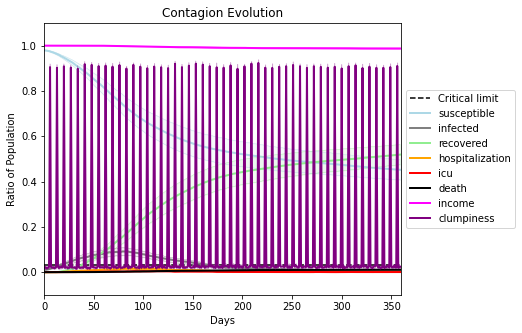

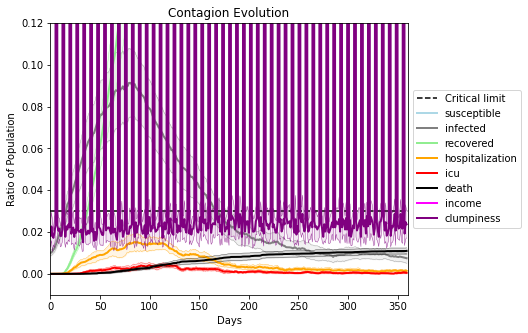

In [39]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.3
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[4396, 6447, 6461, 9639, 4426, 8745, 1259, 8655, 4087, 1656, 7065, 5703, 5924, 6666, 1307, 4713, 8835, 1456, 1811, 5639]
Average similarity between family members is 0.18193683014055678 at temperature -0.2
Average similarity between family and home is 0.999854768873014 at temperature -1
Average similarity between students and their classroom is 0.1518833845424516 at temperature -0.2
Average classroom occupancy is 4.159420289855072 and number classrooms is 69
Average similarity between workers is 0.16794906944305055 at temperature -0.2
Average office occupancy is 3.2118226600985222 and number offices is 203
Average friend similarity for adults: 0.20943835123772828 for kids: 0.20368718549636727
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 2 people.
Total of 2 people allocated in this district.
, 
Home (1,0) district with 1 Buildings


avg restaurant similarity 0.1657066117717173
avg restaurant similarity -0.004628317549547945
avg restaurant similarity -0.2196127728017112
avg restaurant similarity 0.015432100791629585
avg restaurant similarity -0.01329465565597937
avg restaurant similarity 0.06870787873448658
avg restaurant similarity 0.3253353177704644
avg restaurant similarity 0.4232314380576544
avg restaurant similarity 0.32975226555903586
avg restaurant similarity 0.3871342652397086
avg restaurant similarity -0.01329465565597937
avg restaurant similarity 0.058339721427381475
avg restaurant similarity 0.10308023763177826
avg restaurant similarity 0.04312236904467802
avg restaurant similarity 0.13827376553689674
avg restaurant similarity -0.2530220043445571
avg restaurant similarity -0.17999692316997198
avg restaurant similarity 0.19569491531552374
avg restaurant similarity 0.00800119235937579
avg restaurant similarity -0.0015396539056321597
avg restaurant similarity -0.06523997587568288
avg restaurant similarity 0

avg restaurant similarity 0.12472495652771036
avg restaurant similarity -0.2186013328845281
avg restaurant similarity -0.41552385879747766
avg restaurant similarity -0.23326989688470404
avg restaurant similarity 0.4245245712386213
avg restaurant similarity 0.008525932071837272
avg restaurant similarity -0.20761685798883545
avg restaurant similarity 0.25343898330193965
avg restaurant similarity 0.28855187842414887
avg restaurant similarity -0.3563084840812306
avg restaurant similarity 0.5524085109367574
avg restaurant similarity 0.17391046146200081
avg restaurant similarity 0.2141460401343578
avg restaurant similarity 0.20060763237402662
avg restaurant similarity -0.162192484035609
avg restaurant similarity -0.1993927702462116
avg restaurant similarity -0.07447560493636937
avg restaurant similarity -0.2916392771767815
avg restaurant similarity -0.1777334876046277
avg restaurant similarity 0.2629035134124563
avg restaurant similarity 0.10223791092739719
avg restaurant similarity 0.057563

avg restaurant similarity 0.19539149025723115
avg restaurant similarity 0.14478936558688024
avg restaurant similarity 0.03021701953735373
avg restaurant similarity 0.2993488345655383
avg restaurant similarity 0.16949201129445088
avg restaurant similarity 0.0005047897488010128
avg restaurant similarity -0.032671851397839416
avg restaurant similarity 0.007801177381143591
avg restaurant similarity 0.0267213770237794
avg restaurant similarity 0.1915511592664298
avg restaurant similarity 0.056222330754283435
avg restaurant similarity -0.1930080986265707
avg restaurant similarity -0.21513278560868798
avg restaurant similarity -0.27020599232574943
avg restaurant similarity 0.4475481379035863
avg restaurant similarity 0.16696751526895223
avg restaurant similarity 0.5652611127655326
avg restaurant similarity -0.2209717340059468
avg restaurant similarity 0.043404336537860216
avg restaurant similarity -0.0849199765040205
avg restaurant similarity 0.10275583890497894
avg restaurant similarity -0.0

avg restaurant similarity -0.041111537055919134
avg restaurant similarity 0.07672794888846796
avg restaurant similarity -0.07154643388491023
avg restaurant similarity -0.16607182318621
avg restaurant similarity -0.011475473150239427
avg restaurant similarity 0.3303380665058146
avg restaurant similarity 0.3042663115050572
avg restaurant similarity 0.27002839179580795
avg restaurant similarity -0.03554989306725147
avg restaurant similarity 0.2634059286453417
avg restaurant similarity 0.3021317642432546
avg restaurant similarity 0.4360636841894709
avg restaurant similarity -0.02660111575494934
avg restaurant similarity 0.05940405078080066
avg restaurant similarity 0.347353627642466
avg restaurant similarity -0.2514180410583159
avg restaurant similarity -0.12726661827318933
avg restaurant similarity 0.35351146873125866
avg restaurant similarity -0.0948794578261388
avg restaurant similarity 0.2135659595977173
avg restaurant similarity -0.02014315341174157
avg restaurant similarity -0.073005

avg restaurant similarity -0.04275428219099521
avg restaurant similarity 0.011996287148385971
avg restaurant similarity 0.1159557865626693
avg restaurant similarity 0.24284332795861513
avg restaurant similarity 0.5463436637252831
avg restaurant similarity 0.18663445249339983
avg restaurant similarity -0.30254290148301866
avg restaurant similarity 0.24442090739510586
avg restaurant similarity -0.27230076145093335
avg restaurant similarity 0.4366392127047703
avg restaurant similarity -0.15735192990178778
avg restaurant similarity 0.0596081778591129
avg restaurant similarity 0.7056924369265921
avg restaurant similarity 0.0026957646852736675
avg restaurant similarity 0.31387352346042235
avg restaurant similarity 0.11617231543007756
avg restaurant similarity -0.1156034284989807
avg restaurant similarity 0.018478190280556583
avg restaurant similarity 0.1159557865626693
avg restaurant similarity -0.03700596978653953
avg restaurant similarity 0.1575222869241393
avg restaurant similarity 0.1933

avg restaurant similarity 0.02815706480801891
avg restaurant similarity 0.031741876764491625
avg restaurant similarity 0.34651672852215865
avg restaurant similarity -0.2456227062855593
avg restaurant similarity 0.3320833312383197
avg restaurant similarity 0.21315301897679456
avg restaurant similarity -0.08740655535761103
avg restaurant similarity 0.21992941395416424
avg restaurant similarity -0.009449003081232622
avg restaurant similarity 0.0360731786512547
avg restaurant similarity 0.10688765951878461
avg restaurant similarity -0.14384912854637438
avg restaurant similarity 0.30177282222465895
avg restaurant similarity 0.3647060905670621
avg restaurant similarity -0.10053093076980812
avg restaurant similarity -0.013263504042008448
avg restaurant similarity 0.4848162642269785
avg restaurant similarity -0.1721939378384753
avg restaurant similarity 0.033366914198663084
avg restaurant similarity 0.17372621250123335
avg restaurant similarity -0.06947001736640798
avg restaurant similarity 0.

avg restaurant similarity -0.17401269315532492
avg restaurant similarity 0.2316171929748751
avg restaurant similarity 0.23531213093698433
avg restaurant similarity 0.36362711359816025
avg restaurant similarity 0.23906799433109743
avg restaurant similarity 0.0192703770396543
avg restaurant similarity 0.017659985562092397
avg restaurant similarity 0.07301221582549519
avg restaurant similarity 0.4840602325258801
avg restaurant similarity 0.022356112695093754
avg restaurant similarity -0.1810248994730444
avg restaurant similarity 0.2234665124028018
avg restaurant similarity -0.03596117886378685
avg restaurant similarity 0.18457437206528807
avg restaurant similarity -0.07178203842644074
avg restaurant similarity -0.04546615706514667
avg restaurant similarity 0.40477853719439727
avg restaurant similarity 0.0355416945716952
avg restaurant similarity 0.14656677246838942
avg restaurant similarity 0.04917707508571812
avg restaurant similarity 0.056540056824312734
avg restaurant similarity 0.1577

avg restaurant similarity -0.08860240191122026
avg restaurant similarity 0.19129662586666113
avg restaurant similarity 0.19621898265763718
avg restaurant similarity -0.06198954053411448
avg restaurant similarity 0.1487711991506168
avg restaurant similarity 0.6105232873207209
avg restaurant similarity -0.042673685944927625
avg restaurant similarity 0.24267834280219636
avg restaurant similarity 0.3487082230598389
avg restaurant similarity -0.25632032746953415
avg restaurant similarity -0.035013089289655366
avg restaurant similarity 0.1264939991837634
avg restaurant similarity 0.3683396870841234
avg restaurant similarity 0.1519489761648271
avg restaurant similarity -0.22002569253850104
avg restaurant similarity 0.1444726784597545
avg restaurant similarity 0.3225801342307291
avg restaurant similarity 0.01453215732819406
avg restaurant similarity 0.2711522935981156
avg restaurant similarity 0.19470208095620084
avg restaurant similarity -0.11823373727772805
avg restaurant similarity 0.161090

avg restaurant similarity -0.09427802800286027
avg restaurant similarity 0.02310178851273835
avg restaurant similarity -0.033249427480932195
avg restaurant similarity 0.036867013437336796
avg restaurant similarity 0.04957876060669914
avg restaurant similarity 0.47092717651540567
avg restaurant similarity 0.5797984464906647
avg restaurant similarity 0.2916250092541644
avg restaurant similarity -0.20803601558667312
avg restaurant similarity -0.12688418259716777
avg restaurant similarity 0.3629824441725331
avg restaurant similarity 0.06177410879997947
avg restaurant similarity 0.09794078432112162
avg restaurant similarity -0.20125932587976034
avg restaurant similarity 0.3021270370436714
avg restaurant similarity -0.06711468866539567
avg restaurant similarity 0.2757075086103391
avg restaurant similarity 0.12513495289713408
avg restaurant similarity -0.010799407871233277
avg restaurant similarity 0.13512048305220753
avg restaurant similarity 0.11731808493213845
avg restaurant similarity 0.3

Average friend similarity for adults: 0.21466726156138305 for kids: 0.19990069855534565
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocat

avg restaurant similarity 0.10827930119458185
avg restaurant similarity 0.08413255378444251
avg restaurant similarity 0.07594917330335421
avg restaurant similarity 0.021537965729517577
avg restaurant similarity 0.09155813134406526
avg restaurant similarity 0.01719936229772434
avg restaurant similarity 0.15506476892745874
avg restaurant similarity 0.05188680233945934
avg restaurant similarity -0.10086330853157476
avg restaurant similarity 0.4323651089285204
avg restaurant similarity 0.1486401808342259
avg restaurant similarity -0.1648216664141773
avg restaurant similarity 0.2460039666749265
avg restaurant similarity -0.03461565393400713
avg restaurant similarity -0.14753018642492746
avg restaurant similarity -0.4739677584758847
avg restaurant similarity 0.03164167767567671
avg restaurant similarity 0.024365964999100362
avg restaurant similarity 0.10021263367032177
avg restaurant similarity 0.1486401808342259
avg restaurant similarity 0.40535396995728395
avg restaurant similarity 0.07672

avg restaurant similarity 0.13650285993515204
avg restaurant similarity 0.3006990720546659
avg restaurant similarity -0.08546761383122584
avg restaurant similarity -0.13689303711013373
avg restaurant similarity 0.032048396018941286
avg restaurant similarity 0.4804364550129575
avg restaurant similarity 0.2955463351762898
avg restaurant similarity -0.23591551960578555
avg restaurant similarity -0.05048507283081784
avg restaurant similarity -0.1561375813431069
avg restaurant similarity 0.2053198731535411
avg restaurant similarity 0.0033416276703313458
avg restaurant similarity 0.49907052989489303
avg restaurant similarity 0.2053198731535411
avg restaurant similarity -0.08107607127774774
avg restaurant similarity 0.2685933030004757
avg restaurant similarity -0.01313676172241543
avg restaurant similarity 0.19035491717162875
avg restaurant similarity 0.021951372447141085
avg restaurant similarity 0.11721754860887826
avg restaurant similarity 0.2053198731535411
avg restaurant similarity 0.292

avg restaurant similarity 0.39504224150734757
avg restaurant similarity -0.4155199886635209
avg restaurant similarity -0.13428727286788794
avg restaurant similarity 0.18760112662342693
avg restaurant similarity 0.018167696067147708
avg restaurant similarity 0.04080527219367358
avg restaurant similarity 0.4335276951984962
avg restaurant similarity 0.05714023831488254
avg restaurant similarity 0.24462780719930374
avg restaurant similarity 0.21697481783400224
avg restaurant similarity 0.10166842483793183
avg restaurant similarity -0.03410599695269434
avg restaurant similarity 0.2695312041585955
avg restaurant similarity 0.4139449870966003
avg restaurant similarity 0.04831377343362675
avg restaurant similarity 0.10802907241918427
avg restaurant similarity 0.07970253128826028
avg restaurant similarity 0.21917504241132718
avg restaurant similarity -0.06166268625328749
avg restaurant similarity 0.18375831623228514
avg restaurant similarity 0.12195723104270684
avg restaurant similarity 0.29772

avg restaurant similarity 0.5212937003734646
avg restaurant similarity 0.014200254436761567
avg restaurant similarity 0.03250858830047042
avg restaurant similarity 0.18375831623228514
avg restaurant similarity 0.1178617124125636
avg restaurant similarity -0.15765191182151414
avg restaurant similarity -0.1225890857299774
avg restaurant similarity -0.109720367614873
avg restaurant similarity -0.06226746273161732
avg restaurant similarity -0.05704938282455335
avg restaurant similarity -0.12611058771569456
avg restaurant similarity -0.4155199886635209
avg restaurant similarity 0.0440770906819519
avg restaurant similarity -0.06511805150554748
avg restaurant similarity 0.40836153154701893
Average similarity between family members is 0.16872723908154558 at temperature -0.2
Average similarity between family and home is 0.9998477027048186 at temperature -1
Average similarity between students and their classroom is 0.14634603982444494 at temperature -0.2
Average classroom occupancy is 3.87323943

avg restaurant similarity 0.2851409270178229
avg restaurant similarity 0.12352579238154444
avg restaurant similarity -0.10915048295396335
avg restaurant similarity 0.35197030314750233
avg restaurant similarity -0.2727099688509406
avg restaurant similarity -0.007144704652912753
avg restaurant similarity -0.035561049569712316
avg restaurant similarity 0.3301652524509661
avg restaurant similarity 0.24699905779769057
avg restaurant similarity 0.2037514564644679
avg restaurant similarity -0.3356030875540563
avg restaurant similarity 0.1567945055951622
avg restaurant similarity 0.2491627181187939
avg restaurant similarity 0.12940265008627982
avg restaurant similarity 0.4531046717958761
avg restaurant similarity 0.3174551301995595
avg restaurant similarity 0.07020686144742681
avg restaurant similarity 0.4720579901477939
avg restaurant similarity -0.034335260917070856
avg restaurant similarity -0.2867525584437953
avg restaurant similarity 0.2277312058663838
avg restaurant similarity -0.0739904

Average similarity between students and their classroom is 0.1450685975502701 at temperature -0.2
Average classroom occupancy is 3.9722222222222223 and number classrooms is 72
Average similarity between workers is 0.1577957577425263 at temperature -0.2
Average office occupancy is 3.1715686274509802 and number offices is 204
Average friend similarity for adults: 0.20703907413394887 for kids: 0.1858143455512611
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 2 people.
Total of 2 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in

avg restaurant similarity 0.20241935433925373
avg restaurant similarity 0.18685735189652095
avg restaurant similarity 0.5499565805261423
avg restaurant similarity -0.0936178479294451
avg restaurant similarity 0.17654257054026748
avg restaurant similarity 0.05819227470019595
avg restaurant similarity -0.19523995131186173
avg restaurant similarity -0.17728044600397325
avg restaurant similarity -0.11094897425026834
avg restaurant similarity 0.07254263845946894
avg restaurant similarity 0.2245713412991036
avg restaurant similarity 0.26529586638747693
avg restaurant similarity 0.16496052961433585
avg restaurant similarity -0.012341177867053674
avg restaurant similarity 0.6409912272701761
avg restaurant similarity 0.13126625017323076
avg restaurant similarity 0.09099347750401404
avg restaurant similarity -0.20446966168424013
avg restaurant similarity 0.3218497537964435
avg restaurant similarity -0.006243497086172245
avg restaurant similarity 0.49919247507753817
avg restaurant similarity 0.18

avg restaurant similarity -0.063165273726217
avg restaurant similarity 0.1263993341284957
avg restaurant similarity -0.06294508894399525
avg restaurant similarity 0.17577732929680914
avg restaurant similarity 0.11916803167555143
avg restaurant similarity -0.06423630721751351
avg restaurant similarity 0.630460008520167
avg restaurant similarity -0.017409265160636428
avg restaurant similarity 0.04558121684621228
avg restaurant similarity 0.3137709809809725
avg restaurant similarity 0.3763771613796192
avg restaurant similarity 0.35333529242274664
avg restaurant similarity 0.28993482581945207
avg restaurant similarity 0.14523889066781573
avg restaurant similarity 0.1482482313644957
avg restaurant similarity 0.14189756266794776
avg restaurant similarity 0.14174773393842197
avg restaurant similarity 0.5879236265308578
avg restaurant similarity 0.2664596835727065
avg restaurant similarity 0.33265322628892613
avg restaurant similarity 0.0666266201297657
avg restaurant similarity -0.07133684535

avg restaurant similarity 0.26481456497360695
avg restaurant similarity -0.5022410114069379
avg restaurant similarity 0.06454710024128657
avg restaurant similarity -0.05327284747946937
avg restaurant similarity -0.2037949315300207
avg restaurant similarity 0.18855594679667112
avg restaurant similarity 0.36979929287730295
avg restaurant similarity -0.017776010549795856
avg restaurant similarity 0.039747048215866304
avg restaurant similarity -0.22539513222345584
avg restaurant similarity -0.21157126625946363
avg restaurant similarity 0.16271709341016027
avg restaurant similarity 0.031433859165126476
avg restaurant similarity 0.16932577142717695
avg restaurant similarity 0.2630076043394345
avg restaurant similarity 0.10439347049436673
avg restaurant similarity 0.39914431978355813
avg restaurant similarity -0.25730312133287603
avg restaurant similarity 0.3177760823333308
avg restaurant similarity 0.12644149865213758
avg restaurant similarity -0.1116360785430605
avg restaurant similarity 0.

avg restaurant similarity 0.33155270781392127
avg restaurant similarity 0.25353869262855816
avg restaurant similarity -0.06377515875990872
avg restaurant similarity -0.15800088408526605
avg restaurant similarity 0.1259374304916333
avg restaurant similarity 0.04124039537228856
avg restaurant similarity -0.08704123151227927
avg restaurant similarity -0.13587700264558542
avg restaurant similarity 0.6980231690666956
avg restaurant similarity 0.02207844861678613
avg restaurant similarity 0.3176604766760843
avg restaurant similarity 0.3046611167545287
avg restaurant similarity 0.2140405583933812
avg restaurant similarity -0.02093915901508453
avg restaurant similarity -0.06377515875990872
avg restaurant similarity 0.470809161788078
avg restaurant similarity 0.11391439748382662
avg restaurant similarity -0.11499980072466684
avg restaurant similarity 0.17691346568031008
avg restaurant similarity 0.04124039537228856
avg restaurant similarity 0.17691346568031008
avg restaurant similarity -0.01221

avg restaurant similarity 0.24155412725934416
avg restaurant similarity 0.10777216748651461
avg restaurant similarity 0.37537347323891285
avg restaurant similarity -0.019269994157790377
avg restaurant similarity -0.11187136876840986
avg restaurant similarity -0.0009363882275479352
avg restaurant similarity 0.2808414693472815
avg restaurant similarity 0.037130592506461974
avg restaurant similarity 0.1152650688143542
avg restaurant similarity 0.12995252349340577
avg restaurant similarity -0.14244597097822373
avg restaurant similarity 0.14524158754757113
avg restaurant similarity -0.11177226819018787
avg restaurant similarity 0.13686082637796393
avg restaurant similarity 0.1987570315078348
avg restaurant similarity 0.2354454145600478
avg restaurant similarity 0.45298956839336735
avg restaurant similarity -0.24818624453474641
avg restaurant similarity 0.230850738531569
avg restaurant similarity -0.09490686472160709
avg restaurant similarity 0.09836996801454613
avg restaurant similarity -0.

avg restaurant similarity 0.15259533791452962
avg restaurant similarity 0.18732336914825476
avg restaurant similarity 0.02094570999212903
avg restaurant similarity -0.008477130391279356
avg restaurant similarity 0.13116424084746114
avg restaurant similarity 0.11565073724226217
avg restaurant similarity -0.22674893681696512
avg restaurant similarity -0.09891893923011483
avg restaurant similarity 0.0469477279384567
avg restaurant similarity -0.035461282312798145
avg restaurant similarity 0.6475517206111256
avg restaurant similarity -0.024421030969343005
avg restaurant similarity 0.21950682299272292
avg restaurant similarity 0.19137553935470542
avg restaurant similarity 0.39777515981067046
avg restaurant similarity 0.19067538980920762
avg restaurant similarity -0.26399419132530283
avg restaurant similarity -0.08126099777668429
avg restaurant similarity 0.03847616035514394
avg restaurant similarity -0.1674502341520914
avg restaurant similarity 0.318719840622835
avg restaurant similarity -0

avg restaurant similarity 0.10331034015935502
avg restaurant similarity -0.08882126927736708
avg restaurant similarity 0.0765266863029925
avg restaurant similarity -0.11364271740026993
avg restaurant similarity -0.1470377648903234
avg restaurant similarity -0.3567887989359837
avg restaurant similarity -0.171963017341405
avg restaurant similarity 0.4241582712947914
avg restaurant similarity 0.1883729226787338
avg restaurant similarity -0.4836957019578775
avg restaurant similarity -0.36385891786192087
avg restaurant similarity -0.12118435469426764
avg restaurant similarity 0.22409444262020695
avg restaurant similarity 0.2503954779640297
avg restaurant similarity 0.26390787988463904
avg restaurant similarity 0.42282535135233823
Average similarity between family members is 0.17928866269914265 at temperature -0.2
Average similarity between family and home is 0.9998543049010246 at temperature -1
Average similarity between students and their classroom is 0.13653312975066303 at temperature -0.

avg restaurant similarity -0.05059004592301041
avg restaurant similarity 0.24537626334156348
avg restaurant similarity -0.04357531996290577
avg restaurant similarity 0.5886433539713087
avg restaurant similarity 0.15515437084805833
avg restaurant similarity -0.23806767103224188
avg restaurant similarity -0.4869045444978908
avg restaurant similarity 0.26027216310907975
avg restaurant similarity 0.15245931994649928
avg restaurant similarity -0.3482873071828352
avg restaurant similarity -0.33585374331765183
avg restaurant similarity 0.13548511492060825
avg restaurant similarity 0.35735866235199193
avg restaurant similarity 0.27373840610715106
avg restaurant similarity 0.4620717558255562
avg restaurant similarity 0.36178162719581586
avg restaurant similarity -0.4983311109677992
avg restaurant similarity 0.0019339927164282178
avg restaurant similarity 0.3916162725321935
avg restaurant similarity -0.2562452264567683
avg restaurant similarity -0.18354129220575152
avg restaurant similarity 0.01

(<function dict.items>, <function dict.items>, <function dict.items>)

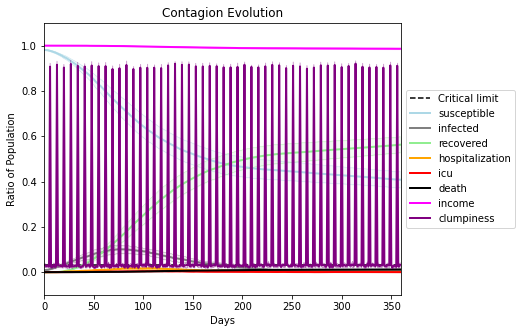

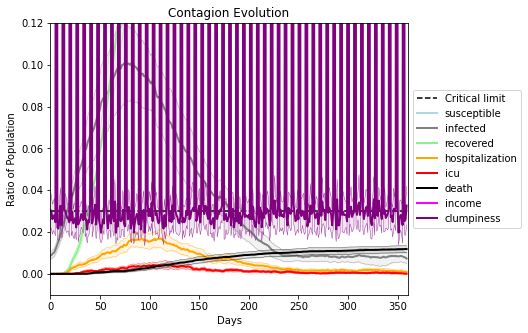

In [40]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.2
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[804, 6325, 4076, 261, 4979, 2299, 2364, 1052, 7824, 6431, 6807, 7027, 6263, 1912, 518, 2718, 3023, 2136, 8667, 4567]
Average similarity between family members is 0.1488104564844373 at temperature -0.1
Average similarity between family and home is 0.9998489008656756 at temperature -1
Average similarity between students and their classroom is 0.1133055957987412 at temperature -0.1
Average classroom occupancy is 3.9166666666666665 and number classrooms is 72
Average similarity between workers is 0.15093873822694856 at temperature -0.1
Average office occupancy is 3.2585365853658534 and number offices is 205
Average friend similarity for adults: 0.207765158410824 for kids: 0.19501142207722258
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units with a total of 20 people.
Total of 20 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Ho

avg restaurant similarity 0.12186480881432624
avg restaurant similarity -0.00744848193024597
avg restaurant similarity -0.3585971319489174
avg restaurant similarity -0.1414170455194539
avg restaurant similarity -0.07460981805333385
avg restaurant similarity -0.22905288434524934
avg restaurant similarity -0.01581787335752302
avg restaurant similarity 0.12857241981824247
avg restaurant similarity -0.25712148347016367
avg restaurant similarity -0.09213843098182947
avg restaurant similarity -0.09311172075108556
avg restaurant similarity 0.07764608641642126
avg restaurant similarity 0.12324133774804258
avg restaurant similarity -0.11313105293199588
avg restaurant similarity -0.09311172075108556
avg restaurant similarity 0.03692235366589993
avg restaurant similarity 0.6165344472993326
avg restaurant similarity 0.44756277445248743
avg restaurant similarity 0.30505292400722384
avg restaurant similarity -0.05690427308494703
avg restaurant similarity 0.1346946810488927
avg restaurant similarity 

avg restaurant similarity 0.5640225721572598
avg restaurant similarity 0.02093167318705627
avg restaurant similarity -0.06967097037696805
avg restaurant similarity 0.23396874514169613
avg restaurant similarity 0.4389921974341707
avg restaurant similarity 0.058370623457777465
avg restaurant similarity 0.30836316005784786
avg restaurant similarity 0.19920505263032942
avg restaurant similarity 0.14830797809975393
avg restaurant similarity -0.058702135932988744
avg restaurant similarity -0.33430416694222875
avg restaurant similarity 0.011827928669911433
avg restaurant similarity 0.18220076906226576
avg restaurant similarity 0.3734894774699302
avg restaurant similarity -0.04218467135861652
avg restaurant similarity 0.6900410006572211
avg restaurant similarity -0.09281421156267851
avg restaurant similarity -0.14717917216136236
avg restaurant similarity 0.08780906963253944
avg restaurant similarity 0.1842985848790679
avg restaurant similarity 0.059566688454576945
avg restaurant similarity 0.0

avg restaurant similarity 0.2838857072189011
avg restaurant similarity 0.12032886878458554
avg restaurant similarity 0.24595709402772736
avg restaurant similarity -0.05520475957066191
avg restaurant similarity 0.0036676388152626985
avg restaurant similarity -0.008625369730280164
avg restaurant similarity -0.038875181450080704
avg restaurant similarity 0.25690426830510293
avg restaurant similarity 0.3173401218917438
avg restaurant similarity -0.1039707932817349
avg restaurant similarity -0.34198628462912994
avg restaurant similarity 0.226068220738676
avg restaurant similarity 0.11974036675704022
avg restaurant similarity -0.044107085222428816
avg restaurant similarity 0.040297215819423915
avg restaurant similarity -0.12040636626215982
avg restaurant similarity 0.2239750141284969
avg restaurant similarity 0.5187195782778942
avg restaurant similarity 0.5152592439751881
avg restaurant similarity -0.5892128385639246
avg restaurant similarity 0.10873313432108075
avg restaurant similarity -0.

avg restaurant similarity 0.32853453532068083
avg restaurant similarity 0.08635062623684056
avg restaurant similarity -0.157823464935602
avg restaurant similarity -0.11237201475770218
avg restaurant similarity -0.05978175837860812
avg restaurant similarity 0.028300763296447463
avg restaurant similarity -0.05688863313476927
avg restaurant similarity 0.6358452533624752
avg restaurant similarity 0.2627125771156754
avg restaurant similarity -0.17199360725750773
avg restaurant similarity 0.1704637747108642
avg restaurant similarity -0.1926339414368829
avg restaurant similarity -0.21224184869359355
avg restaurant similarity 0.15705384379648102
avg restaurant similarity -0.07898409242892725
avg restaurant similarity 0.23596279910215281
avg restaurant similarity -0.006608938185851624
avg restaurant similarity -0.00024651003006827266
avg restaurant similarity -0.07087922185874071
avg restaurant similarity 0.028123939291318595
avg restaurant similarity 0.2636578541951616
avg restaurant similarit

avg restaurant similarity 0.037965984199713906
avg restaurant similarity 0.27259784489894884
avg restaurant similarity 0.24507270501385475
avg restaurant similarity 0.3270496368261999
avg restaurant similarity 0.09015344237818815
avg restaurant similarity 0.1802532081109397
avg restaurant similarity 0.3818162595117087
avg restaurant similarity 0.07783665575010948
avg restaurant similarity 0.23535646009340577
avg restaurant similarity 0.49192961589095974
avg restaurant similarity -0.0190510790231479
avg restaurant similarity 0.12488781183641832
avg restaurant similarity 0.16668192253368339
avg restaurant similarity 0.4738796021066133
avg restaurant similarity 0.38105046613840554
avg restaurant similarity -0.12500429813377448
avg restaurant similarity 0.02826265505683385
avg restaurant similarity 0.3200894904429104
avg restaurant similarity 0.1956162669727713
avg restaurant similarity -0.020608013837049792
avg restaurant similarity -0.09744989027676212
avg restaurant similarity 0.1676626

avg restaurant similarity 0.39606526801991554
avg restaurant similarity -0.06020525750451704
avg restaurant similarity -0.12325404781712596
avg restaurant similarity -0.293222462649036
avg restaurant similarity 0.272079674722935
avg restaurant similarity -0.2050980810433275
avg restaurant similarity 0.06592072468883504
avg restaurant similarity 0.3266377079847983
avg restaurant similarity 0.09514445192388324
avg restaurant similarity -0.09347972580213994
avg restaurant similarity -0.15579920912831635
avg restaurant similarity 0.2226550874316926
avg restaurant similarity 0.359923992161618
avg restaurant similarity 0.20682491401431324
avg restaurant similarity 0.6315309647700282
avg restaurant similarity 0.18138116033719517
avg restaurant similarity 0.009487840905531467
avg restaurant similarity -0.0035317547426250706
avg restaurant similarity -0.28396487207545634
avg restaurant similarity -0.09561404710736163
avg restaurant similarity 0.06519720312942609
avg restaurant similarity 0.3441

avg restaurant similarity -0.06314935995514116
avg restaurant similarity -0.25677210950049767
avg restaurant similarity -0.059953885984099814
avg restaurant similarity 0.18714027873476813
avg restaurant similarity 0.2223744606136239
avg restaurant similarity -0.1043329819833849
avg restaurant similarity 0.48236457005620226
avg restaurant similarity 0.18972826247020397
avg restaurant similarity -0.06241894825843422
avg restaurant similarity -0.23837696180287646
avg restaurant similarity 0.20355024760594798
avg restaurant similarity 0.18714027873476813
avg restaurant similarity -0.03624226745802074
avg restaurant similarity 0.15932102090777034
avg restaurant similarity -0.06687354089285011
avg restaurant similarity 0.024686640311926286
avg restaurant similarity 0.11876274210073394
avg restaurant similarity -0.07955653690448725
avg restaurant similarity 0.10478503157263727
avg restaurant similarity 0.31386644273997
avg restaurant similarity -0.10619673932312915
avg restaurant similarity -

avg restaurant similarity -0.06694361280605665
avg restaurant similarity 0.17147706353678926
avg restaurant similarity -0.023839608197531545
avg restaurant similarity 0.1337995586853936
avg restaurant similarity -0.13849727067196485
avg restaurant similarity -0.34262117450625784
avg restaurant similarity -0.015423356371007607
avg restaurant similarity -0.2656600548122464
avg restaurant similarity 0.03405518325524145
avg restaurant similarity 0.06786135649374311
avg restaurant similarity 0.02829899776468269
avg restaurant similarity 0.22706202204063572
avg restaurant similarity 0.011960646792125572
avg restaurant similarity -0.015538395197981655
avg restaurant similarity 0.38518484824063587
avg restaurant similarity -0.10598397905816297
avg restaurant similarity 0.038857426211438895
avg restaurant similarity 0.04029453258157644
avg restaurant similarity 0.13096662383905228
avg restaurant similarity -0.30122534268944745
avg restaurant similarity 0.03222682336777841
avg restaurant similar

avg restaurant similarity -0.07674115756180953
avg restaurant similarity 0.244248621097001
avg restaurant similarity 0.02979906729129482
avg restaurant similarity -0.3087723760343538
avg restaurant similarity -0.25993941266265047
avg restaurant similarity 0.18450377097571222
avg restaurant similarity 0.3986298452916762
avg restaurant similarity -0.2835513244598093
avg restaurant similarity -0.16106583688055853
avg restaurant similarity 0.03274454641744115
avg restaurant similarity 0.086091999470409
avg restaurant similarity 0.35658565197356035
avg restaurant similarity 0.1341452546413792
avg restaurant similarity 0.12021405498357166
avg restaurant similarity 0.24562153126532876
avg restaurant similarity -0.015142029407517243
avg restaurant similarity 0.10291300289559883
avg restaurant similarity 0.11624622888123243
avg restaurant similarity -0.1050229130933486
avg restaurant similarity 0.10291300289559883
avg restaurant similarity -0.18830697745989378
avg restaurant similarity 0.071407

avg restaurant similarity -0.04636286242550293
avg restaurant similarity 0.07212475320120079
avg restaurant similarity -0.14292511074428482
avg restaurant similarity 0.15595321126160658
avg restaurant similarity -0.13150511367669349
avg restaurant similarity -0.0008624632744755532
avg restaurant similarity -0.26864279557024295
avg restaurant similarity 0.24504699624977017
avg restaurant similarity -0.015663591406537503
avg restaurant similarity -0.27296915859021825
avg restaurant similarity -0.0817697612057532
avg restaurant similarity 0.028738655883651182
avg restaurant similarity 0.0689831332210097
avg restaurant similarity 0.02420505378921553
avg restaurant similarity -0.2427722434487303
avg restaurant similarity -0.07743340501223071
avg restaurant similarity -0.2833793685852341
avg restaurant similarity 0.2461840292423277
avg restaurant similarity 0.5246331475582386
avg restaurant similarity 0.04475518226455689
avg restaurant similarity 0.225414251569191
avg restaurant similarity -

avg restaurant similarity 0.08494063304116346
avg restaurant similarity 0.16788478047532968
avg restaurant similarity 0.11253616372339399
avg restaurant similarity 0.4899430883262773
avg restaurant similarity 0.08474317993325532
avg restaurant similarity 0.14105107585782367
avg restaurant similarity -0.032264948061857784
avg restaurant similarity -0.036169654447457206
avg restaurant similarity 0.14916808667125864
avg restaurant similarity 0.19477187290849335
avg restaurant similarity -0.15155875099640548
avg restaurant similarity 0.12402100350965552
avg restaurant similarity 0.3113525658587906
avg restaurant similarity 0.030573996220171765
avg restaurant similarity 0.6759721278483133
avg restaurant similarity 0.22694444235286138
avg restaurant similarity 0.16465603441268498
avg restaurant similarity 0.18097687957344186
avg restaurant similarity 0.3106647526500223
avg restaurant similarity -0.04034291594520445
avg restaurant similarity 0.08731171823096018
avg restaurant similarity 0.105

avg restaurant similarity 0.0313613200078359
avg restaurant similarity 0.16221665270981375
avg restaurant similarity 0.16710579724380425
avg restaurant similarity 0.04745282169088769
avg restaurant similarity -0.3677279903070604
avg restaurant similarity -0.1254362840150935
avg restaurant similarity -0.2793138737586137
avg restaurant similarity 0.15671431741194025
avg restaurant similarity -0.1470217390461335
avg restaurant similarity 0.414872380735934
avg restaurant similarity 0.06350313766611679
avg restaurant similarity 0.1502609178103166
avg restaurant similarity -0.046835759139828126
avg restaurant similarity 0.42170914325368114
avg restaurant similarity 0.09667657733191105
avg restaurant similarity 0.22396739859328424
avg restaurant similarity 0.15932008215579083
avg restaurant similarity 0.15932008215579083
avg restaurant similarity 0.05539452423118214
Average similarity between family members is 0.1692224304652 at temperature -0.1
Average similarity between family and home is 0

avg restaurant similarity -0.16713305716243598
avg restaurant similarity 0.0783301911901183
avg restaurant similarity 0.1995053453737795
avg restaurant similarity 0.15833841721296582
avg restaurant similarity 0.002503494595521627
avg restaurant similarity -0.18212157756054803
avg restaurant similarity -0.18630508101919005
avg restaurant similarity 0.10513898247511409
avg restaurant similarity -0.1947502933535956
avg restaurant similarity 0.27791502342555713
avg restaurant similarity -0.11264067735250345
avg restaurant similarity 0.1980203501218271
avg restaurant similarity 0.07456234897087094
avg restaurant similarity -0.22177405202100753
avg restaurant similarity -0.2730346434240243
avg restaurant similarity -0.0590463602941404
avg restaurant similarity 0.05755280888859493
avg restaurant similarity -0.36672278643808154
avg restaurant similarity -0.03807187779732686
avg restaurant similarity -0.01790963778949538
avg restaurant similarity 0.17797005142814987
avg restaurant similarity 0.

Average friend similarity for adults: 0.20873121480876144 for kids: 0.188742631734296
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocat

avg restaurant similarity -0.2851120042054171
avg restaurant similarity 0.26892917285411705
avg restaurant similarity -0.15235688930331728
avg restaurant similarity 0.5648983309934039
avg restaurant similarity -0.08301457449024759
avg restaurant similarity 0.11826757503415854
avg restaurant similarity -0.1786899918853622
avg restaurant similarity 0.14733806756588114
avg restaurant similarity 0.09460257319565774
avg restaurant similarity -0.34566366318333286
avg restaurant similarity 0.17154858735231196
avg restaurant similarity -0.08903386952406492
avg restaurant similarity 0.14985785113005543
avg restaurant similarity -0.2714972869508574
avg restaurant similarity 0.18038200755409226
avg restaurant similarity 0.1394658238079912
avg restaurant similarity -0.03894350024678522
avg restaurant similarity 0.516503881949962
avg restaurant similarity 0.7089175692386749
avg restaurant similarity 0.07251742966409135
avg restaurant similarity 0.4364660072473381
avg restaurant similarity 0.0056030

avg restaurant similarity -0.3078297893105286
avg restaurant similarity 0.44665925948563195
avg restaurant similarity -0.14474491759675995
avg restaurant similarity 0.18902859517278087
avg restaurant similarity 0.14213444775377562
avg restaurant similarity -0.17151932731060693
avg restaurant similarity -0.15435064429567455
avg restaurant similarity -0.28849540711939947
avg restaurant similarity 0.011871745349807408
avg restaurant similarity -0.17039262308644118
avg restaurant similarity 0.23548417586798642
avg restaurant similarity 0.10855579645195376
avg restaurant similarity 0.30143575151036045
avg restaurant similarity -0.28673516745121014
avg restaurant similarity -0.005200368146477829
avg restaurant similarity 0.281745298596206
avg restaurant similarity -0.2182374356099962
avg restaurant similarity 0.4681302364943202
avg restaurant similarity 0.11014053991889008
avg restaurant similarity 0.44499458681738036
avg restaurant similarity 0.16498506317466344
avg restaurant similarity -0

Average friend similarity for adults: 0.20709296071079875 for kids: 0.19825479533314902
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocat

avg restaurant similarity 0.13943095848008935
avg restaurant similarity 0.29480564882635785
avg restaurant similarity -0.005127699331024194
avg restaurant similarity 0.29480564882635785
avg restaurant similarity 0.060348608391035556
avg restaurant similarity 0.20027356086068215
avg restaurant similarity 0.0894053338379758
avg restaurant similarity 0.022334321195742843
avg restaurant similarity 0.2419827268182988
avg restaurant similarity 0.3459591712189166
avg restaurant similarity -0.021545432752959018
avg restaurant similarity 0.2181738573130397
avg restaurant similarity -0.06159107523442717
avg restaurant similarity 0.15674441737467862
avg restaurant similarity -0.03886027701829943
avg restaurant similarity -0.12012517752636898
avg restaurant similarity 0.24052093806869473
avg restaurant similarity 0.2922038503067617
avg restaurant similarity 0.8768380869356329
avg restaurant similarity 0.41570731663238064
avg restaurant similarity -0.0056180235706052295
avg restaurant similarity 0.

avg restaurant similarity 0.08114566128879536
avg restaurant similarity -0.20112766780049926
avg restaurant similarity 0.22023450322078145
avg restaurant similarity 0.20172998104554812
avg restaurant similarity 0.02448105971076109
avg restaurant similarity 0.5346202242408182
avg restaurant similarity 0.22176029546026155
avg restaurant similarity 0.17498147317996549
avg restaurant similarity -0.036480026267417406
avg restaurant similarity 0.3657075100817584
avg restaurant similarity 0.4210553261498131
avg restaurant similarity 0.45193429219731773
avg restaurant similarity 0.2500176185693773
avg restaurant similarity 0.5685144483057363
avg restaurant similarity -0.1314807187607202
avg restaurant similarity 0.06501027865586358
avg restaurant similarity 0.32695958148808346
avg restaurant similarity -0.26165181676590665
avg restaurant similarity -0.05112590863121715
avg restaurant similarity -0.04815649687905195
avg restaurant similarity 0.23841656276001597
avg restaurant similarity 0.44362

avg restaurant similarity -0.05845232881194784
avg restaurant similarity 0.23733367166704047
avg restaurant similarity 0.22883232056801348
avg restaurant similarity -0.2104279891701176
avg restaurant similarity 0.16327186526658932
avg restaurant similarity -0.1811421098572897
avg restaurant similarity 0.5275896264963709
avg restaurant similarity -0.4029099568013078
avg restaurant similarity -0.0030623760266691113
avg restaurant similarity 0.24225941352381014
avg restaurant similarity -0.03419450595259585
avg restaurant similarity -0.26579895247056934
avg restaurant similarity 0.14131387582363536
avg restaurant similarity 0.6543381329780199
avg restaurant similarity -0.1579849150152105
avg restaurant similarity -0.13553560753838478
avg restaurant similarity -0.061922031666656385
avg restaurant similarity -0.3476034508486706
avg restaurant similarity 0.1578414987481265
avg restaurant similarity 0.09779109702724245
avg restaurant similarity -0.004237165165576207
avg restaurant similarity 

Average similarity between family and home is 0.9998606858399843 at temperature -1
Average similarity between students and their classroom is 0.13025457135009488 at temperature -0.1
Average classroom occupancy is 4.1 and number classrooms is 70
Average similarity between workers is 0.12895900645870048 at temperature -0.1
Average office occupancy is 3.3333333333333335 and number offices is 198
Average friend similarity for adults: 0.20216337000955314 for kids: 0.20306909007517265
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 alloc

avg restaurant similarity 0.18101140226339657
avg restaurant similarity 0.3764250859445339
avg restaurant similarity 0.019923060423835008
avg restaurant similarity 0.1870287788375607
avg restaurant similarity 0.349101947155069
avg restaurant similarity -0.01643515062934875
avg restaurant similarity 0.2994056141399997
avg restaurant similarity -0.07149002331772268
avg restaurant similarity 0.20138375004449877
avg restaurant similarity -0.0034206518038478514
avg restaurant similarity -0.2427120349864644
avg restaurant similarity 0.031002755641278947
avg restaurant similarity -0.05754624715806669
avg restaurant similarity 0.3716262085589953
avg restaurant similarity 0.0014333545283305438
avg restaurant similarity 0.2994056141399997
avg restaurant similarity 0.265177999129019
avg restaurant similarity 0.11194612274209348
avg restaurant similarity 0.04332417532749945
avg restaurant similarity -0.18427476502531084
avg restaurant similarity 0.5792020438798198
avg restaurant similarity -0.0855

avg restaurant similarity 0.05778069595593886
avg restaurant similarity -0.014827615869246427
avg restaurant similarity 0.2466523892402284
avg restaurant similarity 0.20618926967633222
avg restaurant similarity 0.12153514230092465
avg restaurant similarity 0.2577012825800685
avg restaurant similarity -0.24859855710375467
avg restaurant similarity 0.031141256189896466
avg restaurant similarity 0.3761019134884813
avg restaurant similarity 0.017818245063652566
avg restaurant similarity -0.020159211976998166
avg restaurant similarity -0.061411883197933385
avg restaurant similarity 0.1747796177044259
avg restaurant similarity -0.027392768740551177
avg restaurant similarity -0.2428226583811347
avg restaurant similarity 0.37233682383092
avg restaurant similarity -0.1631495667838801
avg restaurant similarity 0.08860273885774081
avg restaurant similarity 0.0019294545519675105
avg restaurant similarity 0.022852887492745833
avg restaurant similarity 0.27901426870957674
avg restaurant similarity 0

avg restaurant similarity -0.14195632718143897
avg restaurant similarity 0.17091125568139093
avg restaurant similarity 0.3645767354744078
avg restaurant similarity -0.10068969238504485
avg restaurant similarity -0.04212212281938715
avg restaurant similarity 0.3286291817239537
avg restaurant similarity -0.23301210983208828
avg restaurant similarity 0.08958460576435329
avg restaurant similarity -0.42240857039563146
avg restaurant similarity 0.472137429823389
avg restaurant similarity 0.3194704845625249
avg restaurant similarity -0.05638671599905966
avg restaurant similarity 0.3645229336087432
avg restaurant similarity 0.06867397855233501
avg restaurant similarity -0.10981707433914809
avg restaurant similarity -0.22627514728567868
avg restaurant similarity -0.30777322772025495
avg restaurant similarity 0.06217179580112037
avg restaurant similarity -0.17682082935563387
avg restaurant similarity 0.23251608105770413
avg restaurant similarity 0.2912562040471685
avg restaurant similarity -0.04

(<function dict.items>, <function dict.items>, <function dict.items>)

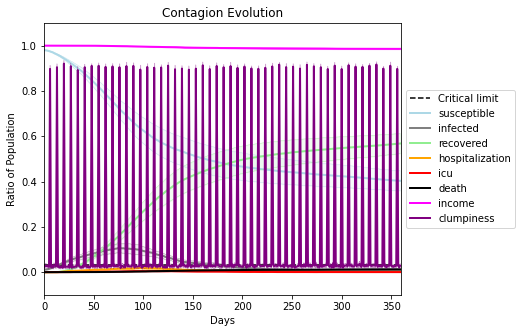

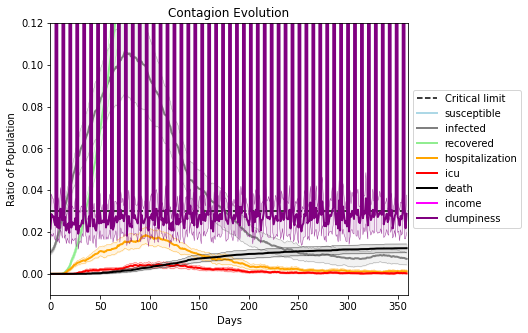

In [41]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.1
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[9057, 5089, 8584, 8815, 2693, 5717, 8140, 3717, 7946, 112, 6053, 7576, 5703, 396, 4460, 9204, 6113, 2607, 7608, 3546]
Average similarity between family members is 0.1526965523965019 at temperature 0
Average similarity between family and home is 0.9998565680111726 at temperature -1
Average similarity between students and their classroom is 0.18063401595841377 at temperature 0
Average classroom occupancy is 4.152777777777778 and number classrooms is 72
Average similarity between workers is 0.14907153331357442 at temperature 0
Average office occupancy is 3.287878787878788 and number offices is 198
Average friend similarity for adults: 0.20703540328444797 for kids: 0.20686887732958975
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homogeneo

avg restaurant similarity -0.25058083114821394
avg restaurant similarity -0.006353651453322756
avg restaurant similarity -0.17668777965272603
avg restaurant similarity 0.09521921966498663
avg restaurant similarity -0.24268278135661214
avg restaurant similarity 0.16888912890652463
avg restaurant similarity 0.002864904747872689
avg restaurant similarity 0.2579304325833285
avg restaurant similarity 0.032171323771244154
avg restaurant similarity -0.25058083114821394
avg restaurant similarity 0.49321279719899114
avg restaurant similarity 0.11795681253203799
avg restaurant similarity 0.5495227705300602
avg restaurant similarity 0.6518248619510878
avg restaurant similarity 0.0729867937844842
avg restaurant similarity 0.8905453636975691
avg restaurant similarity 0.2357548537939521
avg restaurant similarity -0.07725531360661986
avg restaurant similarity -0.09805116171540432
avg restaurant similarity 0.17423849536051156
avg restaurant similarity -0.07725531360661986
avg restaurant similarity 0.0

avg restaurant similarity 0.20931282850526697
avg restaurant similarity 0.23771326759182348
avg restaurant similarity -0.11231435566823311
avg restaurant similarity 0.11802144883993508
avg restaurant similarity 0.3040049320343704
avg restaurant similarity 0.2545785631859362
avg restaurant similarity -0.004390944104104719
avg restaurant similarity 0.4291665181359766
avg restaurant similarity 0.041813876303060604
avg restaurant similarity -0.1503259130499282
avg restaurant similarity 0.7136997865082949
avg restaurant similarity 0.10537917954362998
avg restaurant similarity 0.3555802412150263
avg restaurant similarity 0.09147891892473517
avg restaurant similarity -0.11191933997420786
avg restaurant similarity 0.2606984995249186
avg restaurant similarity 0.314650122763157
avg restaurant similarity 0.01316784218275497
avg restaurant similarity -0.14971553367621326
avg restaurant similarity 0.12145664457629876
avg restaurant similarity 0.308338653901689
avg restaurant similarity -0.006588595

avg restaurant similarity 0.16726904807087586
avg restaurant similarity -0.14313983356349755
avg restaurant similarity 0.20691458242484692
avg restaurant similarity 0.7050002095038681
avg restaurant similarity -0.0672921912142048
avg restaurant similarity 0.3275487797400619
avg restaurant similarity 0.6100371346106834
avg restaurant similarity 0.02231696180384246
avg restaurant similarity -0.1178304914916723
avg restaurant similarity 0.0007032557172064469
avg restaurant similarity 0.227685442793883
avg restaurant similarity -0.10516468027989358
avg restaurant similarity -0.21884855885166082
avg restaurant similarity 0.35118797451098893
avg restaurant similarity 0.16726904807087586
avg restaurant similarity 0.6810819858767523
avg restaurant similarity 0.2143529124862505
avg restaurant similarity 0.1431929310110574
avg restaurant similarity -0.11333307868275157
avg restaurant similarity -0.10698715007166909
avg restaurant similarity 0.3772979618479926
avg restaurant similarity 0.11831210

avg restaurant similarity 0.2882589913569431
avg restaurant similarity 0.04800002745323939
avg restaurant similarity 0.13226080417923117
avg restaurant similarity -0.40041849587838546
avg restaurant similarity 0.0830057363619249
avg restaurant similarity 0.2953351802243085
avg restaurant similarity 0.1574781832795911
avg restaurant similarity 0.1779900584983034
avg restaurant similarity 0.191231754686489
avg restaurant similarity 0.2725822190802837
avg restaurant similarity -0.07938827995039684
avg restaurant similarity -0.05514741249796812
avg restaurant similarity -0.3492231551662323
avg restaurant similarity 0.16334097100486514
avg restaurant similarity 0.13132336311114118
avg restaurant similarity -0.0028797412509995787
avg restaurant similarity 0.16614786087645328
avg restaurant similarity -0.18190969246242839
avg restaurant similarity 0.39306431380008583
avg restaurant similarity -0.0706467519714363
avg restaurant similarity 0.1581558372153935
avg restaurant similarity 0.37112549

avg restaurant similarity 0.278069520826424
avg restaurant similarity -0.12987853507748232
avg restaurant similarity -0.027099868212183256
avg restaurant similarity 0.383841486361802
avg restaurant similarity 0.21349469118433215
avg restaurant similarity 0.024242822390593402
avg restaurant similarity 0.14313741335846727
avg restaurant similarity 0.09406352682735075
avg restaurant similarity 0.09816773513492803
avg restaurant similarity 0.013141014936330346
avg restaurant similarity 0.20326267479703733
avg restaurant similarity 0.278069520826424
avg restaurant similarity 0.19550960649283144
avg restaurant similarity 0.13297207274913161
avg restaurant similarity -0.1717036762850191
avg restaurant similarity -0.12684752014795697
avg restaurant similarity 0.3368837547626637
avg restaurant similarity -0.21923110722486747
avg restaurant similarity 0.32025173590764905
avg restaurant similarity -0.15808178785167928
avg restaurant similarity 0.05572623119836994
avg restaurant similarity 0.21457

avg restaurant similarity 0.22982940642982902
avg restaurant similarity -0.028400819410074885
avg restaurant similarity 0.11219544529530917
avg restaurant similarity 0.22953846400865302
avg restaurant similarity 0.1156666037228416
avg restaurant similarity 0.04780470525612339
avg restaurant similarity 0.14313741335846727
avg restaurant similarity 0.004490308232734215
avg restaurant similarity -0.009435100089250404
avg restaurant similarity -0.20066161773345523
avg restaurant similarity 0.16587566639542434
avg restaurant similarity -0.07426805519595409
avg restaurant similarity 0.35009000930480905
avg restaurant similarity 0.2453561434185746
avg restaurant similarity 0.278069520826424
avg restaurant similarity 0.3775663805599609
avg restaurant similarity 0.030179473406517644
avg restaurant similarity -0.06781976635731686
avg restaurant similarity -0.008247650679214139
avg restaurant similarity 0.061715129182801996
avg restaurant similarity 0.15491479022805446
avg restaurant similarity -

avg restaurant similarity 0.022892771238485293
avg restaurant similarity -0.23779090278607387
avg restaurant similarity 0.16019160482359984
avg restaurant similarity -0.14546082971212962
avg restaurant similarity 0.14038100579702106
avg restaurant similarity 0.18724138042980132
avg restaurant similarity 0.29388325817220773
avg restaurant similarity -0.06887110856205639
avg restaurant similarity -0.014850283917729946
avg restaurant similarity 0.21376832044246286
avg restaurant similarity 0.11881427355970735
avg restaurant similarity -0.45941956494176694
avg restaurant similarity 0.0724562269878124
avg restaurant similarity 0.665741909749285
avg restaurant similarity 0.15198591636945272
avg restaurant similarity 0.08947623772397587
avg restaurant similarity 0.5359815818102689
avg restaurant similarity -0.17669519217228172
avg restaurant similarity 0.09398864033514501
avg restaurant similarity 0.1339580101878618
avg restaurant similarity 0.41191684509439164
avg restaurant similarity 0.143

avg restaurant similarity 0.2830223518103716
avg restaurant similarity 0.01248109524825694
avg restaurant similarity 0.0016985339668502356
avg restaurant similarity -0.021341377658606685
avg restaurant similarity 0.03176150011496921
avg restaurant similarity 0.32529541315907484
avg restaurant similarity -0.10562711830620242
avg restaurant similarity 0.24639944786333234
avg restaurant similarity 0.009474511839989673
avg restaurant similarity 0.17574366038819952
avg restaurant similarity 0.23698417950089437
avg restaurant similarity 0.08806951599137686
avg restaurant similarity 0.2524540787942141
avg restaurant similarity 0.36612010168197806
avg restaurant similarity -0.29070759393396867
avg restaurant similarity -0.15949265001383617
avg restaurant similarity 0.1761748901097574
avg restaurant similarity 0.2982350088180647
avg restaurant similarity 0.29781748900790533
avg restaurant similarity -0.24539426141674706
avg restaurant similarity 0.17308469542838137
avg restaurant similarity -0.

avg restaurant similarity 0.06093650428889935
avg restaurant similarity 0.18035316980435978
avg restaurant similarity 0.050100625065404615
avg restaurant similarity 0.05665503173852642
avg restaurant similarity 0.2406570526258867
avg restaurant similarity -0.3367810602895101
avg restaurant similarity 0.31948796534242
avg restaurant similarity 0.16071288529575914
avg restaurant similarity 0.29455622768584744
avg restaurant similarity 0.35071904265763965
avg restaurant similarity 0.22080357305484094
avg restaurant similarity 0.03192161858184332
avg restaurant similarity 0.4084545619642641
avg restaurant similarity -0.4066960237686684
avg restaurant similarity -0.0032898047578595324
avg restaurant similarity -0.5127016221613271
avg restaurant similarity 0.4583614025103393
avg restaurant similarity 0.15032519157094437
avg restaurant similarity 0.05702169293204011
avg restaurant similarity -0.425654524392025
avg restaurant similarity -0.03337110173879097
avg restaurant similarity 0.69216875

Average similarity between family and home is 0.999839100210333 at temperature -1
Average similarity between students and their classroom is 0.16392494421757078 at temperature 0
Average classroom occupancy is 3.9166666666666665 and number classrooms is 72
Average similarity between workers is 0.15987661319939317 at temperature 0
Average office occupancy is 3.265 and number offices is 200
Average friend similarity for adults: 0.2022241336334813 for kids: 0.2073288168466816
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated 

avg restaurant similarity 0.14092366517421523
avg restaurant similarity -0.15082477657050436
avg restaurant similarity 0.008228361045824119
avg restaurant similarity -0.03097410392113109
avg restaurant similarity 0.08619760065931259
avg restaurant similarity 0.18265757802028565
avg restaurant similarity 0.22071059238837087
avg restaurant similarity 0.3927566699193781
avg restaurant similarity -0.09861445905028896
avg restaurant similarity -0.19538503751267763
avg restaurant similarity 0.36367981244521475
avg restaurant similarity 0.04603311084852836
avg restaurant similarity -0.3606194170133238
avg restaurant similarity 0.4137030803942726
avg restaurant similarity 0.0016403653861131046
avg restaurant similarity 0.34267830758335194
avg restaurant similarity -0.14402460575524392
avg restaurant similarity 0.1698677305126168
avg restaurant similarity 0.211446965497103
avg restaurant similarity -0.03097410392113109
avg restaurant similarity 0.31600596169841977
avg restaurant similarity -0.0

avg restaurant similarity 0.0783176869456829
avg restaurant similarity 0.010194131475953508
avg restaurant similarity -0.036234380814246465
avg restaurant similarity -0.045280384785037125
avg restaurant similarity 0.03504786610769899
avg restaurant similarity 0.07217889035316326
avg restaurant similarity 0.1449776332175044
avg restaurant similarity 0.20873800453290692
avg restaurant similarity 0.10098558241835437
avg restaurant similarity 0.03579844546194535
avg restaurant similarity 0.33601893967206387
avg restaurant similarity 0.11744557362984395
avg restaurant similarity -0.15194626758715551
avg restaurant similarity -0.36055652643766684
avg restaurant similarity -0.22019391174116826
avg restaurant similarity 0.1366643018928419
avg restaurant similarity -0.17625101087331257
avg restaurant similarity -0.1074314067607273
avg restaurant similarity -0.16768163051557972
avg restaurant similarity 0.2235215443660375
avg restaurant similarity -0.025240614913711205
avg restaurant similarity 

avg restaurant similarity 0.10128722040352141
avg restaurant similarity 0.24926348721949765
avg restaurant similarity 0.315324083025858
avg restaurant similarity 0.061459956250694774
avg restaurant similarity -0.01760652066928911
avg restaurant similarity -0.0952809877864427
avg restaurant similarity -0.2285356548357652
avg restaurant similarity 0.041319207653274126
avg restaurant similarity -0.08415650406866715
avg restaurant similarity -0.017805427468412433
avg restaurant similarity -0.15462999751102288
avg restaurant similarity -0.37832345272171564
avg restaurant similarity -0.18748997872399217
avg restaurant similarity -0.11949674041267466
avg restaurant similarity 0.19304870541580343
avg restaurant similarity -0.28936610088163545
avg restaurant similarity -0.19473221463621945
avg restaurant similarity -0.006983623270153037
avg restaurant similarity 0.2151706374325092
avg restaurant similarity -0.4215913767984416
avg restaurant similarity 0.15079400976783675
avg restaurant similari

avg restaurant similarity 0.21968958396219324
avg restaurant similarity 0.2355479060861497
avg restaurant similarity 0.23309230435516934
avg restaurant similarity -0.029540254057820105
avg restaurant similarity -0.011083712838098461
avg restaurant similarity -0.07156208732293182
avg restaurant similarity 0.23369133116129953
avg restaurant similarity -0.14557801540122373
avg restaurant similarity -0.1962148916590876
avg restaurant similarity 0.11707730137546374
avg restaurant similarity -0.15241876782051378
avg restaurant similarity -0.28475343579761986
avg restaurant similarity 0.024537705659836997
avg restaurant similarity 0.16452518954572748
avg restaurant similarity 0.04030758640324925
avg restaurant similarity -0.09055707967880615
avg restaurant similarity 0.04399302916252699
avg restaurant similarity 0.0733757408193526
avg restaurant similarity -0.10531558057331766
avg restaurant similarity -0.20133990617951625
avg restaurant similarity -0.029540254057820105
avg restaurant similar

avg restaurant similarity 0.12542732846556012
avg restaurant similarity 0.06126905695208154
avg restaurant similarity 0.007491879103626515
avg restaurant similarity 0.20702976818964866
avg restaurant similarity -0.026071820308319366
avg restaurant similarity -0.14943981816517696
avg restaurant similarity 0.40800315071006976
avg restaurant similarity 0.043462439174612996
avg restaurant similarity 0.17278738787415987
avg restaurant similarity -0.24421764494915732
avg restaurant similarity -0.10707204148179121
avg restaurant similarity 0.3572908155897504
avg restaurant similarity 0.0719812833208738
avg restaurant similarity 0.44400135011657743
avg restaurant similarity 0.24986725063793463
avg restaurant similarity 0.028201208197970236
avg restaurant similarity 0.15922405535347964
avg restaurant similarity 0.28107110167846555
avg restaurant similarity 0.14158981449311348
avg restaurant similarity 0.021925168854128957
avg restaurant similarity -0.11014843489386059
avg restaurant similarity 

avg restaurant similarity 0.11514549799789203
avg restaurant similarity -0.0965448222298945
avg restaurant similarity 0.08838431612123648
avg restaurant similarity -0.22658697137626718
avg restaurant similarity 0.0981450186722993
avg restaurant similarity 0.39413932605821045
avg restaurant similarity 0.0981450186722993
avg restaurant similarity -0.23331769125337998
avg restaurant similarity -0.06703226985049754
avg restaurant similarity -0.10180600070521159
avg restaurant similarity -0.21545139086099427
avg restaurant similarity 0.0824685178294438
avg restaurant similarity 0.2115233233775624
avg restaurant similarity -0.03747783546502767
avg restaurant similarity 0.07971790453741015
avg restaurant similarity 0.13634576583115637
avg restaurant similarity 0.01051181116102487
avg restaurant similarity 0.01632668597768169
avg restaurant similarity 0.10693820560013816
avg restaurant similarity 0.08674984147625008
avg restaurant similarity 0.09502725373051703
avg restaurant similarity 0.1610

avg restaurant similarity 0.09237676131424899
avg restaurant similarity -0.1124075751124167
avg restaurant similarity -0.028506031749367472
avg restaurant similarity 0.08125645194173463
avg restaurant similarity 6.972650102368694e-05
avg restaurant similarity 0.06056465306725581
avg restaurant similarity 0.19750296087129993
avg restaurant similarity 0.14188767507288313
avg restaurant similarity 0.5355466834642264
avg restaurant similarity 0.028421728720845946
avg restaurant similarity 0.09546501298965308
avg restaurant similarity 0.06235408550953756
avg restaurant similarity 0.15833664890275956
avg restaurant similarity 0.22555613478140432
avg restaurant similarity 0.17591785776383323
avg restaurant similarity -0.014512650459407306
avg restaurant similarity -0.04707309896321033
avg restaurant similarity 0.21418618404723172
avg restaurant similarity -0.16842230515716386
avg restaurant similarity 0.299758059907115
avg restaurant similarity -0.05120655856640141
avg restaurant similarity 0

avg restaurant similarity -0.18157400518274985
avg restaurant similarity -0.21369519441988358
avg restaurant similarity -0.45342478507739725
avg restaurant similarity 0.017208183815890947
avg restaurant similarity 0.35424711240135337
avg restaurant similarity 0.1497859258043149
avg restaurant similarity 0.19931777844496948
avg restaurant similarity 0.06931253440278354
avg restaurant similarity -0.022415160006270092
avg restaurant similarity 0.12969783013407704
avg restaurant similarity -0.0783852470791877
avg restaurant similarity 0.04846775979383504
avg restaurant similarity 0.28949202411751385
avg restaurant similarity 0.13127760313855705
avg restaurant similarity 0.45445052485595405
avg restaurant similarity 0.3704562093768891
avg restaurant similarity 0.22441734383828793
avg restaurant similarity 0.12895158930483894
avg restaurant similarity 0.5919174730588873
avg restaurant similarity 0.23115464661254273
avg restaurant similarity 0.582156517030557
avg restaurant similarity 0.31878

avg restaurant similarity 0.1252670394065073
avg restaurant similarity 0.06303580378218226
avg restaurant similarity 0.07821861279071869
avg restaurant similarity -0.014765130265606463
avg restaurant similarity -0.0912987508071598
avg restaurant similarity 0.005882755371277769
avg restaurant similarity 0.10293993686090849
avg restaurant similarity 0.06268363288513502
avg restaurant similarity -0.25360782189843767
avg restaurant similarity -0.03322260031659237
avg restaurant similarity 0.06582553216412797
avg restaurant similarity 0.129677231929578
avg restaurant similarity 0.11812540444828352
avg restaurant similarity 0.12677138819564954
avg restaurant similarity -0.033689186519842755
avg restaurant similarity 0.20929490200537104
avg restaurant similarity 0.14622609468997477
avg restaurant similarity 0.23935624504130973
avg restaurant similarity 0.3515041830496076
avg restaurant similarity 0.08142157285664459
avg restaurant similarity 0.3105714485759839
avg restaurant similarity 0.2580

avg restaurant similarity -0.1258378048193221
avg restaurant similarity 0.05303251511021182
avg restaurant similarity 0.1980898103826205
avg restaurant similarity 0.4729245909324505
avg restaurant similarity 0.031057313072141546
avg restaurant similarity -0.034423157751195047
avg restaurant similarity 0.40627827226218327
avg restaurant similarity -0.1275936631190135
avg restaurant similarity -0.00046083729534412976
avg restaurant similarity -0.32370453516922837
avg restaurant similarity 0.22929803679807914
avg restaurant similarity -0.07275887207108021
avg restaurant similarity 0.23691461892244509
avg restaurant similarity 0.20312177823532415
avg restaurant similarity 0.03432621682591539
avg restaurant similarity -0.017862294577372928
avg restaurant similarity -0.045410900682366265
avg restaurant similarity 0.08317228372198517
avg restaurant similarity 0.11623081896457448
avg restaurant similarity 0.3081886855996355
avg restaurant similarity 0.206211074849294
avg restaurant similarity 

avg restaurant similarity 0.09877873144247686
avg restaurant similarity 0.021348261816407584
avg restaurant similarity 0.36362615719654345
avg restaurant similarity 0.3300479673695771
avg restaurant similarity 0.04239000087433207
avg restaurant similarity 0.08790518638374825
avg restaurant similarity -0.15270006734626906
avg restaurant similarity -0.03720104933519636
avg restaurant similarity 0.07059741167669134
avg restaurant similarity -0.11077893055280147
avg restaurant similarity 0.22002612182483539
avg restaurant similarity 0.06723585098519066
avg restaurant similarity 0.54711809379479
avg restaurant similarity 0.43506264291334573
avg restaurant similarity -0.17479199386619437
avg restaurant similarity -0.09774809451198868
avg restaurant similarity 0.4135802761651781
avg restaurant similarity 0.14577898675794884
avg restaurant similarity -0.13067400211517544
avg restaurant similarity -0.07511582464031409
avg restaurant similarity 0.10604954499342158
avg restaurant similarity -0.15

avg restaurant similarity 0.04846281535141654
avg restaurant similarity 0.22686731609609675
avg restaurant similarity 0.350978117832427
avg restaurant similarity 0.2393035134631578
avg restaurant similarity -0.17828752829954844
avg restaurant similarity 0.27508751404502635
avg restaurant similarity -0.20831808335085777
avg restaurant similarity 0.05566158145504258
avg restaurant similarity -0.29004005300785335
avg restaurant similarity 0.21415083306773544
avg restaurant similarity 0.2438978551582562
avg restaurant similarity -0.22303017399352623
avg restaurant similarity -0.09819939694637964
avg restaurant similarity -0.18388969153988927
avg restaurant similarity -0.15515466791394736
avg restaurant similarity 0.06426422322887096
avg restaurant similarity -0.11153676364454275
avg restaurant similarity -0.3641288281156517
avg restaurant similarity -0.20898316044261925
avg restaurant similarity 0.08809983375675809
avg restaurant similarity 0.3908117441598762
avg restaurant similarity 0.18

avg restaurant similarity 0.3358932162561571
avg restaurant similarity 0.09759320151098276
avg restaurant similarity 0.4400892572843511
avg restaurant similarity -0.057012571056237825
avg restaurant similarity 0.10964825691208971
avg restaurant similarity 0.2506996108218346
avg restaurant similarity 0.21880136581016532
avg restaurant similarity 0.2894975802297511
avg restaurant similarity 0.041310379727498306
avg restaurant similarity 0.4489072067929255
avg restaurant similarity -0.01413240410280741
avg restaurant similarity 0.004035042790129405
avg restaurant similarity 0.006649996158330132
avg restaurant similarity 0.40297949977350533
avg restaurant similarity 0.036338440706079535
avg restaurant similarity 0.5101027139430875
avg restaurant similarity -0.05000108689318944
avg restaurant similarity 0.3198570718641312
avg restaurant similarity 0.19841372427538465
avg restaurant similarity 0.4547804903568413
avg restaurant similarity -0.15988731645351903
avg restaurant similarity 0.24622

(<function dict.items>, <function dict.items>, <function dict.items>)

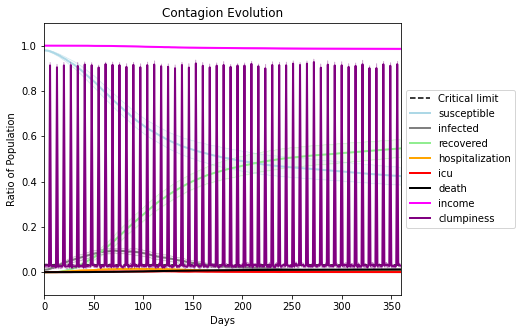

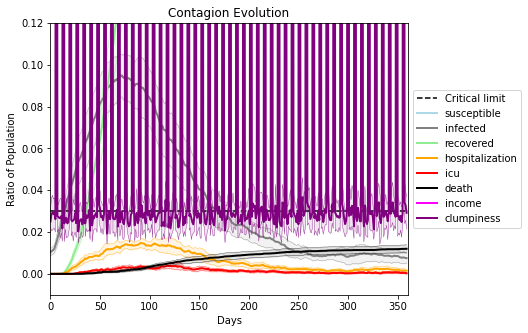

In [42]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 0
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[1040, 8710, 1425, 3209, 2101, 4383, 6223, 3508, 7777, 2376, 1951, 4150, 5822, 5858, 2669, 1099, 2343, 7857, 7124, 4188]
Average similarity between family members is 0.09279405927845708 at temperature 0.33
Average similarity between family and home is 0.9998558002699185 at temperature -1
Average similarity between students and their classroom is 0.0927638308596181 at temperature 0.33
Average classroom occupancy is 3.942857142857143 and number classrooms is 70
Average similarity between workers is 0.09963652611158771 at temperature 0.33
Average office occupancy is 3.3737373737373737 and number offices is 198
Average friend similarity for adults: 0.16250087032524504 for kids: 0.16228196556001218
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units with a total of 20 people.
Total of 20 people allocated in this district.
, 
Home (1,0) district with 1 Buildin

avg restaurant similarity 0.011283509120830468
avg restaurant similarity 0.0492398038003935
avg restaurant similarity 0.01571908580823704
avg restaurant similarity 0.07839083439148119
avg restaurant similarity -0.07906662018415922
avg restaurant similarity -0.1019421616998524
avg restaurant similarity -0.04180754061331572
avg restaurant similarity 0.005756916010407981
avg restaurant similarity 0.29102837213568433
avg restaurant similarity 0.10572864571560227
avg restaurant similarity 0.06872702291114818
avg restaurant similarity 0.2358840023500377
avg restaurant similarity -0.1213512367354168
avg restaurant similarity 0.1787619122480589
avg restaurant similarity 0.04267907592911567
avg restaurant similarity 0.07012886416766563
avg restaurant similarity 0.16143944930188267
avg restaurant similarity 0.05984441552800482
avg restaurant similarity 0.11112197658353687
avg restaurant similarity 0.05794141537694049
avg restaurant similarity -0.05476332548389486
avg restaurant similarity -0.041

avg restaurant similarity -0.010384264495824469
avg restaurant similarity -0.1480424942797274
avg restaurant similarity 0.08931447918090778
avg restaurant similarity -0.22512797209934635
avg restaurant similarity 0.30381992755216125
avg restaurant similarity -0.07770881984828762
avg restaurant similarity 0.11618877342164145
avg restaurant similarity -0.44105250224174863
avg restaurant similarity 0.17217813420782696
avg restaurant similarity -0.14237733748601697
avg restaurant similarity 0.0556994014941469
avg restaurant similarity 0.11829680649093692
avg restaurant similarity -0.13595469225563406
avg restaurant similarity 0.007604831716838834
avg restaurant similarity 0.027885848005596597
avg restaurant similarity -0.3227125596437805
avg restaurant similarity 0.07187931518616408
avg restaurant similarity -0.1716087656301817
avg restaurant similarity 0.2231290925258593
avg restaurant similarity 0.030497837088414095
avg restaurant similarity 0.0772670569366498
avg restaurant similarity -

avg restaurant similarity 0.3190136210956372
avg restaurant similarity 0.012498264542578269
avg restaurant similarity -0.04294856743615599
avg restaurant similarity 0.1735084910228844
avg restaurant similarity 0.09141927190309321
avg restaurant similarity 0.0517891684192035
avg restaurant similarity 0.36138787740878686
avg restaurant similarity 0.008394589683771455
avg restaurant similarity -0.04183462610601841
avg restaurant similarity 0.6240845856424705
avg restaurant similarity 0.23636039333743447
avg restaurant similarity 0.16956533099978163
avg restaurant similarity 0.17501308876683452
avg restaurant similarity 0.09488176274024712
avg restaurant similarity -0.195673920502518
avg restaurant similarity 0.32275163219451203
avg restaurant similarity 0.20144163338624627
avg restaurant similarity 0.3196529022388551
avg restaurant similarity 0.222506794700948
avg restaurant similarity -0.03146153347020139
avg restaurant similarity 0.6428203141657625
avg restaurant similarity 0.0501116194

avg restaurant similarity 0.013090294482323985
avg restaurant similarity 0.5485612466042893
avg restaurant similarity 0.08484269369360525
avg restaurant similarity -0.4875552617687595
avg restaurant similarity -0.01121797422141603
avg restaurant similarity 0.10863701808180412
avg restaurant similarity -0.3130657520811926
avg restaurant similarity 0.09327633977943411
avg restaurant similarity -0.1260898452170518
avg restaurant similarity -0.06769308662413351
avg restaurant similarity 0.31823431218143344
avg restaurant similarity -0.034853486501273484
avg restaurant similarity 0.3681414741450168
avg restaurant similarity -0.19320597738490516
avg restaurant similarity 0.5610513940426618
avg restaurant similarity 0.09429390580371258
avg restaurant similarity 0.0464564064578192
avg restaurant similarity 0.19278889126997625
avg restaurant similarity 0.4745143440224209
avg restaurant similarity -0.1320017721593509
avg restaurant similarity 0.3540964228001869
avg restaurant similarity 0.474514

avg restaurant similarity -0.16437608709995655
avg restaurant similarity 0.366313992984319
avg restaurant similarity -0.058484002923425746
avg restaurant similarity -0.011982637232920304
avg restaurant similarity 0.053337609196828006
avg restaurant similarity 0.2162777786778423
avg restaurant similarity 0.30567470624794
avg restaurant similarity 0.1624186627670215
avg restaurant similarity 0.2913174643744637
avg restaurant similarity 0.2521115268700894
avg restaurant similarity -0.167590659178535
avg restaurant similarity -0.1292733337279947
avg restaurant similarity -0.03030905216578388
avg restaurant similarity -0.2906169287030823
avg restaurant similarity 0.4072073905092276
avg restaurant similarity 0.03734450280383958
avg restaurant similarity 0.36637661885909045
avg restaurant similarity 0.013905555825523802
avg restaurant similarity -0.02695697679816436
avg restaurant similarity 0.0926764494274954
avg restaurant similarity 0.04917434692699679
avg restaurant similarity -0.12297142

avg restaurant similarity 0.24218721615558475
avg restaurant similarity -0.1849088317815427
avg restaurant similarity 0.030777385723684846
avg restaurant similarity 0.03567854227370852
avg restaurant similarity 0.050253177381475674
avg restaurant similarity 0.12903118199540659
avg restaurant similarity -0.19113179541011865
avg restaurant similarity -0.014945409584351418
avg restaurant similarity 0.10202930257171718
avg restaurant similarity 0.11114105294178715
avg restaurant similarity 0.051045513018637585
avg restaurant similarity -0.02053510840845535
avg restaurant similarity 0.38032814182730706
avg restaurant similarity -0.011770809727516152
avg restaurant similarity -0.09946892194070722
avg restaurant similarity -0.2725041460405955
avg restaurant similarity 0.015871666640492277
avg restaurant similarity -0.09321996532321167
avg restaurant similarity -0.5439142198474489
avg restaurant similarity 0.1310109059212725
avg restaurant similarity 0.1381907094945652
avg restaurant similarit

Average similarity between workers is 0.09397911152353472 at temperature 0.33
Average office occupancy is 3.27 and number offices is 200
Average friend similarity for adults: 0.15865059623170386 for kids: 0.13763662794335177
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 19 people.
Total of 19 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 15 people.
Total of 15 people alloc

avg restaurant similarity 0.31163192200738515
avg restaurant similarity -0.016830328101993225
avg restaurant similarity -0.30434378467426026
avg restaurant similarity 0.04677600256160048
avg restaurant similarity 0.17063808957304546
avg restaurant similarity 0.1665241363787875
avg restaurant similarity -0.08861270817073197
avg restaurant similarity -0.35201915392683436
avg restaurant similarity -0.3482853342006101
avg restaurant similarity 0.14539258944470487
avg restaurant similarity 0.08710175821953131
avg restaurant similarity -0.03405789933102062
avg restaurant similarity -0.41755110990566385
avg restaurant similarity 0.30790545622520105
avg restaurant similarity 0.0378001952096825
avg restaurant similarity 0.13764887763997324
avg restaurant similarity 0.3620437926160662
avg restaurant similarity 0.36042689649044113
avg restaurant similarity 0.41132142538540695
avg restaurant similarity 0.2443472837425789
avg restaurant similarity -0.07550664246701977
avg restaurant similarity 0.21

avg restaurant similarity -0.11622503520807011
avg restaurant similarity -0.009896109377233397
avg restaurant similarity 0.07196804917816196
avg restaurant similarity -0.33267229420358
avg restaurant similarity 0.20974477234248948
avg restaurant similarity 0.2754113761028265
avg restaurant similarity 0.19539517377030152
avg restaurant similarity 0.054972708620117924
avg restaurant similarity 0.2468825068529179
avg restaurant similarity 0.033243971506885975
avg restaurant similarity 0.3401857204627177
avg restaurant similarity 0.4092623954409337
avg restaurant similarity 0.2788001005980142
avg restaurant similarity -0.09255591725348401
avg restaurant similarity -0.10116411028724297
avg restaurant similarity -0.10803943060180268
avg restaurant similarity 0.08867550829761128
avg restaurant similarity 0.11471359669907417
avg restaurant similarity 0.012436503542420804
avg restaurant similarity 0.04980639998452524
avg restaurant similarity 0.19473623097226944
avg restaurant similarity -0.164

avg restaurant similarity 0.053777529950847
avg restaurant similarity 0.2990854413860626
avg restaurant similarity -0.2786666566197377
avg restaurant similarity 0.15839671646683257
avg restaurant similarity 0.07727229843170663
avg restaurant similarity 0.019867044997280137
avg restaurant similarity 0.2357603235325172
avg restaurant similarity 0.19414505342044405
avg restaurant similarity 0.4090412248893539
avg restaurant similarity 0.5723392636504975
avg restaurant similarity 0.15679536945203137
avg restaurant similarity 0.20968630138143238
avg restaurant similarity -0.29344734905640485
avg restaurant similarity -0.048820740102581306
avg restaurant similarity 0.20133839053679053
avg restaurant similarity 0.3311126847825118
avg restaurant similarity 0.06421639472934065
avg restaurant similarity 0.3637590450100721
avg restaurant similarity 0.26745703940572796
avg restaurant similarity -0.14385172533099397
avg restaurant similarity -0.31183226756609594
avg restaurant similarity -0.0578564

avg restaurant similarity 0.21080723122982167
avg restaurant similarity 0.6158698907097844
avg restaurant similarity 0.09236129916618749
avg restaurant similarity 0.03170481466358757
avg restaurant similarity -0.06464028560876017
avg restaurant similarity -0.03832448777689848
avg restaurant similarity -0.35981137143262326
avg restaurant similarity -0.3779700379269497
avg restaurant similarity 0.11303398166082632
avg restaurant similarity 0.19514341061045448
avg restaurant similarity 0.1565536710119133
avg restaurant similarity -0.31317517888585034
avg restaurant similarity -0.3969557149130745
avg restaurant similarity -0.37647923651032894
avg restaurant similarity 0.04834480062111049
avg restaurant similarity 0.13705774794997036
avg restaurant similarity -0.0137521459837604
avg restaurant similarity -0.2406286196754326
avg restaurant similarity 0.15817086110898043
avg restaurant similarity -0.4516203018274528
avg restaurant similarity 0.030471542916888836
avg restaurant similarity 0.17

avg restaurant similarity -0.1830445344772828
avg restaurant similarity -0.013652930964344348
avg restaurant similarity 0.17690551994183834
avg restaurant similarity 0.19294092048338113
Average similarity between family members is 0.10363590961264654 at temperature 0.33
Average similarity between family and home is 0.9998742226274829 at temperature -1
Average similarity between students and their classroom is 0.14420622719757656 at temperature 0.33
Average classroom occupancy is 4.385714285714286 and number classrooms is 70
Average similarity between workers is 0.1218127126363136 at temperature 0.33
Average office occupancy is 3.242424242424242 and number offices is 198
Average friend similarity for adults: 0.16282295352359918 for kids: 0.1582493576115585
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district 

avg restaurant similarity 0.14596234957941512
avg restaurant similarity -0.15234708032105862
avg restaurant similarity -0.2521258014867778
avg restaurant similarity -0.12512571723063537
avg restaurant similarity 0.41246604834843953
avg restaurant similarity -0.15234708032105862
avg restaurant similarity -0.009368987823667865
avg restaurant similarity 0.10232435002126536
avg restaurant similarity -0.015378374647772301
avg restaurant similarity 0.046596296683251576
avg restaurant similarity 0.18250245995950237
avg restaurant similarity 0.2289310046103017
avg restaurant similarity 0.09417372057686697
avg restaurant similarity -0.07173949643704249
avg restaurant similarity -0.05770754109624626
avg restaurant similarity -0.15234708032105862
avg restaurant similarity -0.1899570225558569
avg restaurant similarity 0.07942143544464149
avg restaurant similarity 0.387037341450629
avg restaurant similarity 0.3207464339194709
avg restaurant similarity 0.00486029567768973
avg restaurant similarity 0

avg restaurant similarity 0.0046791280707242505
avg restaurant similarity 0.08715644118039842
avg restaurant similarity 0.05833825828992312
avg restaurant similarity 0.13996512267729938
avg restaurant similarity 0.11071269430226506
avg restaurant similarity 0.10931139990800132
avg restaurant similarity 0.3954517231955249
avg restaurant similarity -0.09627815163753897
avg restaurant similarity -0.04226820421030708
avg restaurant similarity 0.08059164873352764
avg restaurant similarity 0.2682064521430786
avg restaurant similarity 0.10031607494463651
avg restaurant similarity 0.32955308221934326
avg restaurant similarity 0.3699720342153905
avg restaurant similarity 0.05757390794915801
avg restaurant similarity 0.06476053409489699
avg restaurant similarity 0.157613349766887
avg restaurant similarity -0.1373569086485211
avg restaurant similarity -0.03565976753717064
avg restaurant similarity -0.041104817457812026
avg restaurant similarity 0.534377680780125
avg restaurant similarity 0.141644

avg restaurant similarity -0.18741566678624677
avg restaurant similarity 0.3217246379593597
avg restaurant similarity 0.18976036604324015
avg restaurant similarity -0.2720401201536131
avg restaurant similarity 0.20057855191656254
avg restaurant similarity 0.3398857478848163
avg restaurant similarity 0.03921421009263891
avg restaurant similarity -0.45824999986870124
avg restaurant similarity -0.3993201381550626
avg restaurant similarity -0.26011836360373
avg restaurant similarity 0.20077936328594193
avg restaurant similarity 0.008830802692964214
avg restaurant similarity 0.03594964794384166
avg restaurant similarity 0.3615435844482462
avg restaurant similarity 0.03767179670619736
avg restaurant similarity 0.07766625934430005
avg restaurant similarity 0.05422513995836031
avg restaurant similarity 0.09769451042352206
avg restaurant similarity 0.2975015299550476
avg restaurant similarity 0.016559625292011538
avg restaurant similarity 0.3022721376207689
avg restaurant similarity 0.566277295

avg restaurant similarity 0.17438673892210943
avg restaurant similarity 0.11261499892332666
avg restaurant similarity 0.18793057231882948
avg restaurant similarity -0.1404538769085144
avg restaurant similarity 0.23681069336068572
avg restaurant similarity 0.11123705090950746
avg restaurant similarity -0.3974491585469814
avg restaurant similarity 0.2587508413247979
avg restaurant similarity 0.07022685065935402
avg restaurant similarity -0.286311143087049
avg restaurant similarity 0.1317639834261351
avg restaurant similarity 0.4178386280309595
avg restaurant similarity 0.04720029805623879
avg restaurant similarity 0.2180968412326964
avg restaurant similarity -0.1291258394063983
avg restaurant similarity -0.020159737689286833
avg restaurant similarity 0.17712060979430078
avg restaurant similarity -0.2616874350199203
avg restaurant similarity 0.3349801330196712
avg restaurant similarity 0.17465934986359258
avg restaurant similarity -0.1428328332203565
avg restaurant similarity 0.0199210483

avg restaurant similarity 0.15535110310850864
avg restaurant similarity 0.23137874998804647
avg restaurant similarity -0.09258871618501145
avg restaurant similarity 0.10522698308497799
avg restaurant similarity 0.09075745091463534
avg restaurant similarity 0.009798137633739068
avg restaurant similarity -0.061970277755542355
avg restaurant similarity -0.2582087582426363
avg restaurant similarity -0.24780016727550416
avg restaurant similarity -0.16202544981682152
avg restaurant similarity 0.02486652121116832
avg restaurant similarity 0.39709463034473763
avg restaurant similarity -0.14330500950168856
avg restaurant similarity 0.00098629555820956
avg restaurant similarity -0.34139346729430603
avg restaurant similarity 0.11872956675902678
avg restaurant similarity -0.04816370158457359
avg restaurant similarity 0.24695759992958966
avg restaurant similarity -0.14876077740311622
avg restaurant similarity 0.08776968419302053
avg restaurant similarity -0.19235971307471544
avg restaurant similari

avg restaurant similarity -0.252115117744275
avg restaurant similarity 0.2730094993113027
avg restaurant similarity 0.257657651557845
avg restaurant similarity 0.18571132038528085
avg restaurant similarity 0.09105212879073654
avg restaurant similarity 0.1100676336015609
avg restaurant similarity -0.02015874359155502
avg restaurant similarity 0.35585476659022347
avg restaurant similarity 0.487853207191257
avg restaurant similarity 0.1203668317653328
avg restaurant similarity 0.045370089543924096
avg restaurant similarity 0.16730120361308423
avg restaurant similarity 0.013490397774111873
avg restaurant similarity 0.1891628992341654
avg restaurant similarity 0.29053113249094364
avg restaurant similarity 0.2315032244883749
avg restaurant similarity 0.3518813951566808
avg restaurant similarity 0.3420157899602788
avg restaurant similarity -0.08847892068546692
avg restaurant similarity 0.06762490031220789
avg restaurant similarity 0.20452469600305487
avg restaurant similarity 0.24346991003469

avg restaurant similarity 0.2279420259097905
avg restaurant similarity 0.193945550372598
avg restaurant similarity 0.037712395063779935
avg restaurant similarity -0.31863081513722014
avg restaurant similarity 0.3266918035677099
avg restaurant similarity 0.31751077948478723
avg restaurant similarity 0.27025321921751094
avg restaurant similarity -0.5410533737288068
avg restaurant similarity 0.0032450528275244778
avg restaurant similarity 0.43265290243466853
avg restaurant similarity 0.11915419636111857
avg restaurant similarity -0.21351367481379924
avg restaurant similarity -0.27333123684998284
avg restaurant similarity -0.2708387447297117
avg restaurant similarity -0.021732233660668607
avg restaurant similarity -0.03586220958331973
avg restaurant similarity -0.09132464345424
avg restaurant similarity 0.030355875400933652
avg restaurant similarity 0.433945438547964
avg restaurant similarity -0.05195093536095784
avg restaurant similarity 0.15580585671168723
avg restaurant similarity 0.060

avg restaurant similarity -0.3363452762314369
avg restaurant similarity 0.07835318677323884
avg restaurant similarity -0.15356618493377477
avg restaurant similarity 0.09274953420279554
avg restaurant similarity 0.31226287941194003
avg restaurant similarity -0.16151515251153492
avg restaurant similarity 0.2998907593108413
avg restaurant similarity -0.3351909750971859
avg restaurant similarity 0.18944917449602666
avg restaurant similarity -0.4099179923707002
avg restaurant similarity -0.051320931108764165
avg restaurant similarity 0.25640691623236656
avg restaurant similarity 0.35347484976061094
avg restaurant similarity 0.038850654134031326
avg restaurant similarity -0.2337121615262744
avg restaurant similarity -0.07174201518310286
avg restaurant similarity 0.20014573834055713
avg restaurant similarity 0.09457288574327709
avg restaurant similarity -0.06898331651803838
avg restaurant similarity 0.3807699905926984
avg restaurant similarity -0.1858157863398237
avg restaurant similarity 0.1

avg restaurant similarity 0.1255517037612564
avg restaurant similarity 0.1796537348133831
avg restaurant similarity -0.07646546645994517
avg restaurant similarity 0.3441366984808145
avg restaurant similarity 0.2763912315074475
avg restaurant similarity 0.3353252572775334
avg restaurant similarity 0.10067178506161895
avg restaurant similarity -0.28267775927788963
avg restaurant similarity 0.47789064038231865
avg restaurant similarity 0.16132167227326238
avg restaurant similarity 0.11970803536478122
avg restaurant similarity -0.09379827776980443
avg restaurant similarity 0.11970803536478122
avg restaurant similarity -0.06958118652125304
avg restaurant similarity 0.24355112448043242
avg restaurant similarity -0.09726409230897835
avg restaurant similarity 0.37358719372895854
avg restaurant similarity -0.150945569263768
avg restaurant similarity -0.07042231218998336
avg restaurant similarity 0.2585099264893193
avg restaurant similarity 0.2638596541671413
avg restaurant similarity -0.1177599

avg restaurant similarity 0.35667622656792614
avg restaurant similarity 0.507516589961258
avg restaurant similarity -0.19008412402217034
avg restaurant similarity 0.10433149711074063
avg restaurant similarity 0.04766911353393502
avg restaurant similarity -0.49802207633130496
avg restaurant similarity 0.4040611125912144
avg restaurant similarity 0.030627773723273063
avg restaurant similarity 0.3958659319843637
avg restaurant similarity 0.10433149711074063
avg restaurant similarity -0.041320344339142626
avg restaurant similarity -0.1632057034923692
avg restaurant similarity -0.10076184360953651
avg restaurant similarity 0.14584002937124627
avg restaurant similarity -0.1632057034923692
avg restaurant similarity 0.12050794845478534
avg restaurant similarity -0.4036020706470001
avg restaurant similarity 0.1924936421764659
avg restaurant similarity 0.2946470656908733
avg restaurant similarity 0.05786051509894735
avg restaurant similarity -0.3734201224203719
avg restaurant similarity -0.22058

(<function dict.items>, <function dict.items>, <function dict.items>)

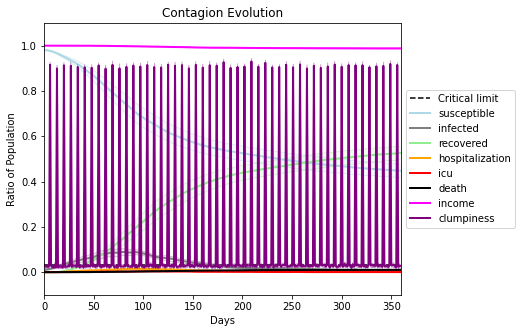

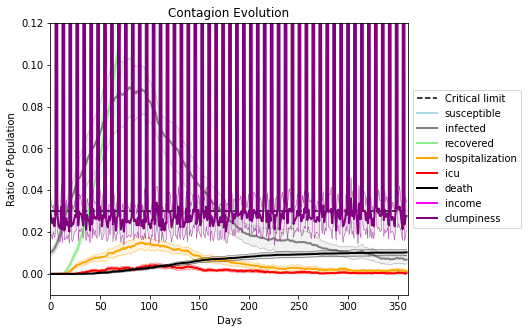

In [43]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 0.33
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[3564, 4527, 1126, 7361, 7306, 6775, 8644, 1542, 186, 7224, 639, 2091, 7489, 256, 1831, 8693, 5843, 2669, 8465, 805]
Average similarity between family members is 0.06411056802131558 at temperature 0.66
Average similarity between family and home is 0.9998593994902683 at temperature -1
Average similarity between students and their classroom is 0.06093548586987967 at temperature 0.66
Average classroom occupancy is 3.9014084507042255 and number classrooms is 71
Average similarity between workers is 0.04540999509734116 at temperature 0.66
Average office occupancy is 3.3399014778325125 and number offices is 203
Average friend similarity for adults: 0.12170647229532607 for kids: 0.11574648810356562
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
H

avg restaurant similarity 0.10090329643201063
avg restaurant similarity 0.19194127867687052
avg restaurant similarity 0.19587436193998986
avg restaurant similarity -0.081862285517313
avg restaurant similarity -0.06639279406171159
avg restaurant similarity -0.39296066330238844
avg restaurant similarity 0.25203278478134794
avg restaurant similarity 0.034103960952213
avg restaurant similarity -0.47041107959149
avg restaurant similarity -0.07888346125079418
avg restaurant similarity 0.2155870433753964
avg restaurant similarity -0.24526868420521553
avg restaurant similarity 0.0045718559023313066
avg restaurant similarity 0.08134381372314879
avg restaurant similarity -0.02976985388884798
avg restaurant similarity -0.05975808696727407
avg restaurant similarity 0.1850449927780079
avg restaurant similarity -0.021510188539405777
avg restaurant similarity -0.07952516963314601
avg restaurant similarity 0.031009602664728738
avg restaurant similarity -0.019595122111122312
avg restaurant similarity -

avg restaurant similarity 0.11947348345692446
avg restaurant similarity -0.35678788927402166
avg restaurant similarity 0.3867187770307457
avg restaurant similarity -0.07862980064090365
avg restaurant similarity 0.08896996621153205
Average similarity between family members is 0.042866432718264666 at temperature 0.66
Average similarity between family and home is 0.9998568334422095 at temperature -1
Average similarity between students and their classroom is 0.08623102213813798 at temperature 0.66
Average classroom occupancy is 4.159420289855072 and number classrooms is 69
Average similarity between workers is 0.042594216322062596 at temperature 0.66
Average office occupancy is 3.2364532019704435 and number offices is 203
Average friend similarity for adults: 0.12294791523410802 for kids: 0.12069037534854496
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people all

avg restaurant similarity 0.3370810699135123
avg restaurant similarity 0.07079354755982209
avg restaurant similarity 0.004690833075237322
avg restaurant similarity 0.22481699487744855
avg restaurant similarity -0.07357263034556646
avg restaurant similarity 0.02571198269871246
avg restaurant similarity 0.07036453052682726
avg restaurant similarity -0.0743728151191681
avg restaurant similarity -0.05281557130442635
avg restaurant similarity 0.13721095450240808
avg restaurant similarity 0.21260498357303534
avg restaurant similarity 0.17151850673140148
avg restaurant similarity 0.10585398958805906
avg restaurant similarity -0.4476608875608671
avg restaurant similarity -0.04401635616824348
avg restaurant similarity 0.24229324203970126
avg restaurant similarity 0.05215518668297088
avg restaurant similarity -0.18288875143833708
avg restaurant similarity 0.17151850673140148
avg restaurant similarity 0.07131712403426138
avg restaurant similarity 0.07020842677036059
avg restaurant similarity 0.33

avg restaurant similarity 0.21468656825170956
avg restaurant similarity -0.13934767428905312
avg restaurant similarity -0.08233372389694703
avg restaurant similarity 0.16275278738906201
avg restaurant similarity -0.03049809737221575
avg restaurant similarity -0.08522553712597847
avg restaurant similarity -0.1447626820381995
avg restaurant similarity -0.08864193973709573
avg restaurant similarity 0.2327994004461562
avg restaurant similarity -0.036015581665555074
avg restaurant similarity 0.1067163959023139
avg restaurant similarity -0.23254448577771425
avg restaurant similarity 0.537999005564627
avg restaurant similarity 0.3122234955890466
avg restaurant similarity 0.08180986296919401
avg restaurant similarity -0.49731202477719016
avg restaurant similarity 0.11719886939682116
avg restaurant similarity -0.1494212675422187
avg restaurant similarity 0.06581907715399347
avg restaurant similarity 0.23515152230654113
avg restaurant similarity -0.3033761459878384
avg restaurant similarity 0.64

avg restaurant similarity 0.5443779520270818
avg restaurant similarity 0.23166074827392555
avg restaurant similarity -0.03911862715237757
avg restaurant similarity -0.3034776475045111
avg restaurant similarity -0.09751080591851799
avg restaurant similarity 0.11872342464886877
avg restaurant similarity 0.19968638912450354
avg restaurant similarity -0.06977602899099627
avg restaurant similarity 0.2514271698857876
avg restaurant similarity 0.18460119468724306
avg restaurant similarity 0.000838937580856701
avg restaurant similarity -0.30784900618599764
avg restaurant similarity -0.07446495440865666
avg restaurant similarity -0.3646106640106975
avg restaurant similarity -0.3646106640106975
avg restaurant similarity -0.12872266552000267
avg restaurant similarity -0.17475711399728236
avg restaurant similarity 0.3655039536740952
avg restaurant similarity 0.2932408878385685
avg restaurant similarity -0.21617000254633062
avg restaurant similarity 0.050582180877484804
avg restaurant similarity -0

avg restaurant similarity -0.060673432341866285
avg restaurant similarity 0.04375160708707859
avg restaurant similarity 0.1371864964938172
avg restaurant similarity 0.039353270100915064
avg restaurant similarity -0.20783378013250764
avg restaurant similarity -0.1292250250210253
avg restaurant similarity 0.16963319038722352
avg restaurant similarity -0.18837806626555959
avg restaurant similarity 0.12135342911188521
avg restaurant similarity -0.30813804876274753
avg restaurant similarity -0.2195798601092647
avg restaurant similarity -0.08816813897492187
avg restaurant similarity 0.21005590059349
avg restaurant similarity 0.03740257339446133
avg restaurant similarity 0.10211063259146348
avg restaurant similarity -0.10967240048360845
avg restaurant similarity 0.1931002542037476
avg restaurant similarity -0.13143840235134263
avg restaurant similarity -0.04738428292769842
avg restaurant similarity 0.2722328345249616
avg restaurant similarity 0.05624790987522897
avg restaurant similarity 0.33

avg restaurant similarity -0.4136673442554621
avg restaurant similarity -0.14875155280691194
avg restaurant similarity -0.19593420914360316
avg restaurant similarity 0.42817718833592616
avg restaurant similarity -0.24400675236555877
avg restaurant similarity 0.03171795226670905
avg restaurant similarity -0.0067931561478928905
avg restaurant similarity 0.10464522136936294
avg restaurant similarity 0.11934690487233633
avg restaurant similarity -0.05251312487552777
avg restaurant similarity 0.1919665373158317
avg restaurant similarity -0.15233890490457916
avg restaurant similarity 0.03929707202018262
avg restaurant similarity 0.29008539653230514
avg restaurant similarity 0.20301603513444408
avg restaurant similarity -0.11236156438640937
avg restaurant similarity -0.036614633562916415
avg restaurant similarity 0.1990501082048658
avg restaurant similarity 0.03406725342169385
avg restaurant similarity 0.2459131593192631
avg restaurant similarity 0.09433939497150798
avg restaurant similarity 

avg restaurant similarity -0.11730386408875398
avg restaurant similarity 0.2706568071753604
avg restaurant similarity 0.07801190828132154
avg restaurant similarity 0.09377473290831823
avg restaurant similarity -0.02048617656712204
avg restaurant similarity 0.03625194979670365
avg restaurant similarity -0.2944714781423495
avg restaurant similarity 0.14550663406087727
avg restaurant similarity -0.04411491568638704
avg restaurant similarity 0.08397689162258117
avg restaurant similarity -0.17248876337289426
avg restaurant similarity 0.3279800281119707
avg restaurant similarity -0.06455509425170984
avg restaurant similarity -0.26412028364433066
avg restaurant similarity 0.03625194979670365
avg restaurant similarity -0.0034005924416463107
avg restaurant similarity -0.1667976154256968
avg restaurant similarity -0.09805262483186397
avg restaurant similarity -0.1166277253726742
avg restaurant similarity -0.07011370859454755
avg restaurant similarity -0.26583201628881864
avg restaurant similarit

avg restaurant similarity -0.3673594744738979
avg restaurant similarity -0.23723477282721486
avg restaurant similarity 0.28497003839667684
avg restaurant similarity -0.3673594744738979
avg restaurant similarity -0.06480910426562633
avg restaurant similarity -0.1918450270118794
avg restaurant similarity 0.143033960541092
avg restaurant similarity -0.25057572628840036
avg restaurant similarity -0.33554826125774695
avg restaurant similarity -0.21530998946401098
avg restaurant similarity -0.14878357878952717
avg restaurant similarity 0.19159733019075062
avg restaurant similarity -0.13503268256099052
avg restaurant similarity 0.04034569607274621
avg restaurant similarity 0.05371254583946204
avg restaurant similarity 0.2774798011449904
avg restaurant similarity 0.08811084520843174
avg restaurant similarity 0.2681840484380716
avg restaurant similarity -0.35230473124141326
avg restaurant similarity -0.006137770019274285
avg restaurant similarity -0.302350334827064
avg restaurant similarity 0.0

avg restaurant similarity -0.056821610378071506
avg restaurant similarity -0.014202596201039322
avg restaurant similarity 0.17638923151679844
avg restaurant similarity -0.13984590691314067
avg restaurant similarity 0.486609488484247
avg restaurant similarity -0.35460181895807596
avg restaurant similarity -0.16273910279957954
avg restaurant similarity 0.1566880279614009
avg restaurant similarity 0.09840733375852194
avg restaurant similarity -0.2021298397183444
avg restaurant similarity -0.21958460373865296
avg restaurant similarity -0.08377721647917546
avg restaurant similarity -0.040231635238247215
avg restaurant similarity -0.16273910279957954
avg restaurant similarity 0.02135910913344288
avg restaurant similarity -0.31708004701580683
avg restaurant similarity -0.00047239408292985564
avg restaurant similarity 0.27657723964174297
avg restaurant similarity 0.015117047922737978
avg restaurant similarity 0.00803483315259913
avg restaurant similarity -0.3053997754240164
avg restaurant simi

avg restaurant similarity -0.12235359249517286
avg restaurant similarity 0.04091552938826967
avg restaurant similarity -0.24665090586711552
avg restaurant similarity -0.040360702092895995
avg restaurant similarity 0.2556937488504892
avg restaurant similarity -0.18356481469012093
avg restaurant similarity -0.27687173452850145
avg restaurant similarity -0.3817674499732944
avg restaurant similarity 0.26974428066948775
avg restaurant similarity -0.19304705088840607
avg restaurant similarity 0.0743646789851353
avg restaurant similarity -0.12409215228980625
avg restaurant similarity 0.16126631098617827
avg restaurant similarity 0.03712922256890272
avg restaurant similarity 0.17032316121959232
avg restaurant similarity 0.5967682043561704
avg restaurant similarity 0.21710279709596478
avg restaurant similarity 0.584387548087095
avg restaurant similarity 0.04454312567363651
avg restaurant similarity -0.0631381756714228
avg restaurant similarity -0.012511263412385384
avg restaurant similarity -0.

avg restaurant similarity -0.42115573384282723
avg restaurant similarity -0.30085635580941666
avg restaurant similarity 0.2893646034425612
avg restaurant similarity 0.0693760816493818
avg restaurant similarity -0.1748724335517524
avg restaurant similarity 0.21676059389367763
avg restaurant similarity 0.2159556960457802
avg restaurant similarity 0.5782087807817211
avg restaurant similarity 0.2169390184965321
avg restaurant similarity 0.03456811192605322
avg restaurant similarity -0.21425573209982005
avg restaurant similarity 0.45984409658473047
avg restaurant similarity 0.1213799290190174
avg restaurant similarity 0.09982882420303407
avg restaurant similarity 0.1209550183897369
avg restaurant similarity 0.15385025672328542
avg restaurant similarity -0.00014746986625175165
avg restaurant similarity 0.2856402629279067
avg restaurant similarity -0.21712159185534488
avg restaurant similarity -0.6539020583604338
avg restaurant similarity 0.1521135863034613
avg restaurant similarity 0.2000260

avg restaurant similarity -0.0018033671827807768
avg restaurant similarity 0.002706353908391551
avg restaurant similarity 0.20099656413020006
avg restaurant similarity -0.3642205271662498
avg restaurant similarity -0.018728116852003762
avg restaurant similarity 0.05960952535256822
avg restaurant similarity 0.12549459773144367
avg restaurant similarity 0.30945386791770263
avg restaurant similarity -0.23479987209371112
avg restaurant similarity 0.1236621493655897
avg restaurant similarity -0.35618576391434204
avg restaurant similarity 0.2366525827665446
avg restaurant similarity -0.05893406231294224
avg restaurant similarity 0.44763037159353986
avg restaurant similarity 0.09629713787540686
avg restaurant similarity 0.13433060654986595
avg restaurant similarity 0.04817431826604418
avg restaurant similarity -0.027205478658615015
avg restaurant similarity -0.3497124209409541
avg restaurant similarity -0.09764416744276055
avg restaurant similarity -0.31158830283578853
avg restaurant similari

avg restaurant similarity 0.0038731516100997815
avg restaurant similarity 0.1947260103499264
avg restaurant similarity 0.015087565149482594
avg restaurant similarity 0.19562552860785842
avg restaurant similarity 0.016797646933666893
avg restaurant similarity 0.1973949582831616
avg restaurant similarity 0.1659354826350114
avg restaurant similarity 0.026429221603993483
avg restaurant similarity 0.01371628901130481
avg restaurant similarity -0.0982979526899717
avg restaurant similarity 0.11631262736895354
avg restaurant similarity -0.12640884339400643
avg restaurant similarity -0.020397001975568582
avg restaurant similarity 0.221174804674072
avg restaurant similarity 0.5197897536584035
avg restaurant similarity 0.1636070787439503
avg restaurant similarity -0.12640884339400643
avg restaurant similarity -0.19306229597574334
avg restaurant similarity 0.07925647175351856
avg restaurant similarity 0.04365465008164664
avg restaurant similarity -0.03024998998414334
avg restaurant similarity -0.0

avg restaurant similarity -0.21709326931794776
avg restaurant similarity 0.08962593060301348
avg restaurant similarity -0.14545400225728372
avg restaurant similarity 0.27197070251379696
avg restaurant similarity -0.17656086828314393
avg restaurant similarity 0.3577976971325216
avg restaurant similarity 0.06259067995222059
avg restaurant similarity 0.11914890209497066
avg restaurant similarity -0.3351004675817002
avg restaurant similarity 0.06460066086473168
avg restaurant similarity 0.08788070739201859
avg restaurant similarity 0.22843762259302097
avg restaurant similarity -0.015321381109437445
avg restaurant similarity 0.33511149783993843
avg restaurant similarity 0.082678405498473
avg restaurant similarity -0.01938052356216377
avg restaurant similarity 0.261594794776575
avg restaurant similarity 0.0943375306955501
avg restaurant similarity 0.008907413446055112
avg restaurant similarity 0.33511149783993843
avg restaurant similarity 0.009294867294414116
avg restaurant similarity 0.1250

avg restaurant similarity 0.006871077786933633
avg restaurant similarity 0.12191654019475862
avg restaurant similarity -0.0031500292697048127
avg restaurant similarity 0.11988959448292998
avg restaurant similarity -0.1537891108882302
avg restaurant similarity 0.001988310356205594
avg restaurant similarity 0.3767097480477882
avg restaurant similarity 0.07672459337891163
avg restaurant similarity 0.09422442612236662
avg restaurant similarity -0.2612265796106725
avg restaurant similarity -0.19494874757589506
avg restaurant similarity -0.21689488622902656
avg restaurant similarity -0.33903688411431043
avg restaurant similarity -0.006760217087330593
avg restaurant similarity -0.06862948216897295
avg restaurant similarity -0.018182936414772505
avg restaurant similarity -0.06922322597822098
avg restaurant similarity 0.0494662383946973
avg restaurant similarity 0.01786146593973187
avg restaurant similarity -0.04146565844197925
avg restaurant similarity -0.36166692516466337
avg restaurant simil

avg restaurant similarity 0.2972197084084037
avg restaurant similarity 0.19760678446713842
avg restaurant similarity 0.03394317575213146
avg restaurant similarity 0.0013815703937337907
avg restaurant similarity -0.08563600057296056
avg restaurant similarity 0.20383686682270166
avg restaurant similarity -0.14422734488651745
avg restaurant similarity 0.05378589907497994
avg restaurant similarity -0.06418053717175601
avg restaurant similarity 0.11137052948264492
avg restaurant similarity -0.5170543079573402
avg restaurant similarity 0.33647009335228295
avg restaurant similarity 0.4604787238224927
avg restaurant similarity 0.22809943032124536
avg restaurant similarity -0.22383237616583068
avg restaurant similarity 0.08667599068802688
avg restaurant similarity -0.05593474231004691
avg restaurant similarity -0.055609856050480376
avg restaurant similarity 0.21896507669961193
avg restaurant similarity 0.0828102486811808
avg restaurant similarity -0.008470326108123524
avg restaurant similarity 

avg restaurant similarity -0.16090288501023703
avg restaurant similarity -0.07446671132772796
avg restaurant similarity 0.1063204706467275
avg restaurant similarity 0.13380678265820198
avg restaurant similarity 0.4202704549471313
avg restaurant similarity -0.04979449642813365
avg restaurant similarity -0.28588664065749414
avg restaurant similarity 0.2722426489571496
avg restaurant similarity 0.09796542648823169
avg restaurant similarity 0.07921112988261964
avg restaurant similarity 0.3012522490750274
avg restaurant similarity -0.268345670058737
avg restaurant similarity 0.1482048023980921
avg restaurant similarity -0.06990007788530783
avg restaurant similarity 0.013262601482673317
avg restaurant similarity 0.22745133492551006
avg restaurant similarity 0.08682489721524048
avg restaurant similarity -0.49156186693189136
avg restaurant similarity 0.22357023735131315
avg restaurant similarity -0.16020057323324913
avg restaurant similarity -0.08554857038328652
avg restaurant similarity 0.196

avg restaurant similarity 0.03296024136625592
avg restaurant similarity 0.30754023499681077
avg restaurant similarity 0.2681368779683056
avg restaurant similarity -0.2603561974286779
avg restaurant similarity -0.19009836756473275
avg restaurant similarity 0.17998635007303979
avg restaurant similarity -0.06600039705093491
avg restaurant similarity 0.06731354787542809
avg restaurant similarity 0.3738915841107804
avg restaurant similarity -0.009704014259258452
avg restaurant similarity -0.007733821714308475
avg restaurant similarity 0.056338508112109775
avg restaurant similarity -0.17910348241044854
avg restaurant similarity 0.2751267218657754
avg restaurant similarity 0.04143849354086286
avg restaurant similarity 0.6396835124142645
avg restaurant similarity -0.2579380948703851
avg restaurant similarity -0.0311876573539646
avg restaurant similarity -0.13295729306451398
avg restaurant similarity 0.06628334503250456
avg restaurant similarity 0.2749826825131895
avg restaurant similarity 0.25

avg restaurant similarity -0.3214560182844975
avg restaurant similarity 0.14920837776637172
avg restaurant similarity 0.4361514872138959
avg restaurant similarity -0.19913943085218355
avg restaurant similarity 0.2755732184180983
avg restaurant similarity 0.06324671207778405
avg restaurant similarity -0.2043866963644717
avg restaurant similarity 0.18163622827849146
avg restaurant similarity -0.34453699274412075
avg restaurant similarity 0.38349459283152976
avg restaurant similarity 0.06152801737593552
avg restaurant similarity 0.30710522475179725
avg restaurant similarity -0.2975634369387082
avg restaurant similarity -0.056245927854621625
avg restaurant similarity 0.0657503259710388
avg restaurant similarity -0.2225748753206902
avg restaurant similarity -0.12026609237636918
avg restaurant similarity 0.029090689627444398
avg restaurant similarity 0.07099044220836491
avg restaurant similarity -0.23693139621642886
avg restaurant similarity 0.17723005879699202
avg restaurant similarity -0.3

avg restaurant similarity 0.10476732247409884
avg restaurant similarity -0.03071094614080082
avg restaurant similarity 0.15866845406553237
avg restaurant similarity 0.015276635691112095
avg restaurant similarity 0.3848387288994749
avg restaurant similarity 0.3848387288994749
avg restaurant similarity 0.16303689974986368
avg restaurant similarity -0.4075900702329963
avg restaurant similarity 0.054667971994317416
avg restaurant similarity 0.13380757667170654
avg restaurant similarity -0.21061840703679507
avg restaurant similarity -0.05389750888911565
avg restaurant similarity 0.39478982383427336
avg restaurant similarity 0.2452575033316064
avg restaurant similarity -0.03594931476577059
avg restaurant similarity 0.3705561063020379
avg restaurant similarity -0.15114359543450626
avg restaurant similarity -0.2713766705032243
avg restaurant similarity -0.3365856085011015
avg restaurant similarity -0.30649020753285666
avg restaurant similarity -0.3465367912590497
avg restaurant similarity 0.17

(<function dict.items>, <function dict.items>, <function dict.items>)

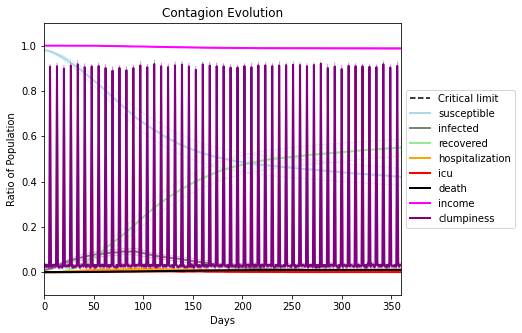

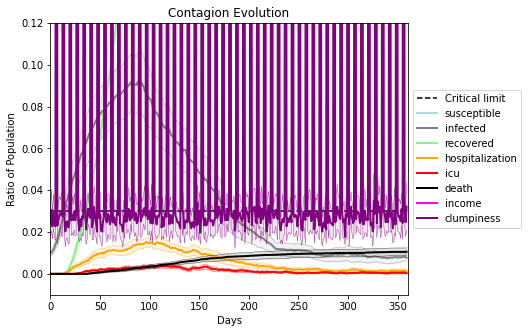

In [44]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 0.66
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[2692, 3498, 2358, 4765, 1084, 4568, 300, 5237, 2427, 2367, 6485, 2076, 8688, 6582, 3449, 4416, 6972, 7069, 6727, 7264]
Average similarity between family members is 0.02666317605802556 at temperature 1
Average similarity between family and home is 0.9998589600675506 at temperature -1
Average similarity between students and their classroom is 0.05217189166323477 at temperature 1
Average classroom occupancy is 3.75 and number classrooms is 72
Average similarity between workers is 0.02715555358673423 at temperature 1
Average office occupancy is 3.334975369458128 and number offices is 203
Average friend similarity for adults: 0.09054915200038807 for kids: 0.08520399548238061
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding:

avg restaurant similarity -0.11896142544882615
avg restaurant similarity 0.1211902628421723
avg restaurant similarity -0.3011706147591729
avg restaurant similarity -0.2861992942797912
avg restaurant similarity -0.17342638443610292
avg restaurant similarity -0.052593088159750584
avg restaurant similarity 0.4413354415515392
avg restaurant similarity -0.02062149246208428
avg restaurant similarity 0.003633053073362258
avg restaurant similarity 0.12202671125061572
avg restaurant similarity -0.02344547171989621
avg restaurant similarity 0.38104963583867213
avg restaurant similarity -0.05883598195340276
avg restaurant similarity 0.07064447532853457
avg restaurant similarity -0.17342638443610292
avg restaurant similarity 0.009917839129373607
avg restaurant similarity -0.09768434227593137
avg restaurant similarity -0.3234960061206924
avg restaurant similarity -0.02164794119657725
avg restaurant similarity 0.0724618106134618
avg restaurant similarity 0.11717037305329947
avg restaurant similarity

avg restaurant similarity 0.25426643257176085
avg restaurant similarity -0.12911471969045177
avg restaurant similarity -0.2385967629578628
avg restaurant similarity 0.24094378703792946
avg restaurant similarity -0.11937660684988965
avg restaurant similarity -0.03914032962811731
avg restaurant similarity -0.06269137531980445
avg restaurant similarity -0.12130857435690086
avg restaurant similarity -0.3757457451978654
avg restaurant similarity 0.1361531075895301
avg restaurant similarity -0.03868321361622311
avg restaurant similarity -0.07381230225136841
avg restaurant similarity -0.2385967629578628
avg restaurant similarity -0.14500598199650144
avg restaurant similarity -0.06482413005361877
avg restaurant similarity -0.026020227866433474
avg restaurant similarity 0.09064101439849007
avg restaurant similarity 0.19666786781785056
avg restaurant similarity 0.07808266341704746
avg restaurant similarity -0.11935775332051847
avg restaurant similarity 0.30757930827177704
avg restaurant similari

avg restaurant similarity 0.23278897900514864
avg restaurant similarity -0.11648892645684931
avg restaurant similarity -0.11671579335067209
avg restaurant similarity 0.1888132202557418
avg restaurant similarity -0.08599611779408628
avg restaurant similarity 0.02362227324785468
avg restaurant similarity -0.02092703631865961
avg restaurant similarity 0.12190329353063811
avg restaurant similarity 0.3197478946458267
avg restaurant similarity 0.12488178152276579
avg restaurant similarity -0.27777932863814453
avg restaurant similarity -0.2602667763982395
avg restaurant similarity 0.12037284949294366
avg restaurant similarity -0.27591677137044435
avg restaurant similarity -0.27591677137044435
avg restaurant similarity -0.4481896131929257
avg restaurant similarity -0.25279955780336916
avg restaurant similarity -0.2648909019366029
avg restaurant similarity 0.20333143164178474
avg restaurant similarity 0.09280753283526817
avg restaurant similarity -0.26124278265986256
avg restaurant similarity 0

avg restaurant similarity -0.0012442717035146753
avg restaurant similarity -0.12313218475911307
avg restaurant similarity 0.16946578081379884
avg restaurant similarity -0.16244907302429418
avg restaurant similarity -0.020648736701904022
avg restaurant similarity 0.0520331205872716
avg restaurant similarity 0.32590790024367944
avg restaurant similarity 0.3971544609660488
avg restaurant similarity 0.13644097841520622
avg restaurant similarity -0.2349314483213929
avg restaurant similarity -0.12385833366673829
avg restaurant similarity 0.19547847611558294
avg restaurant similarity 0.007524054762940802
avg restaurant similarity -0.08241563927869021
avg restaurant similarity 0.08179601120370844
avg restaurant similarity -0.15055139605014273
avg restaurant similarity -0.1360642677354402
avg restaurant similarity 0.0524824063163351
avg restaurant similarity 0.26086455412006604
avg restaurant similarity -0.009171976521221899
avg restaurant similarity 0.011316085398927533
avg restaurant similari

avg restaurant similarity -0.2663297540843306
avg restaurant similarity 0.049028185101407704
avg restaurant similarity 0.39884803280557324
avg restaurant similarity 0.19331182943323444
avg restaurant similarity 0.12529606380345887
Average similarity between family members is 0.009409719750876734 at temperature 1
Average similarity between family and home is 0.9998638969356397 at temperature -1
Average similarity between students and their classroom is 0.04114970420914565 at temperature 1
Average classroom occupancy is 4.138888888888889 and number classrooms is 72
Average similarity between workers is 0.0214235799473349 at temperature 1
Average office occupancy is 3.2893401015228427 and number offices is 197
Average friend similarity for adults: 0.08016511548913888 for kids: 0.08624734367153632
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in t

avg restaurant similarity -0.1330502831357691
avg restaurant similarity -0.25250110905705625
avg restaurant similarity -0.12016440986853069
avg restaurant similarity 0.1365473231235711
avg restaurant similarity 0.31258818195340055
avg restaurant similarity 0.07093529059105856
avg restaurant similarity -0.18948103710450942
avg restaurant similarity -0.010274966852919799
avg restaurant similarity -0.0304462699823081
avg restaurant similarity 0.1082313554850054
avg restaurant similarity -0.18108330475646414
avg restaurant similarity -0.02479276908160475
avg restaurant similarity -0.163691074466832
avg restaurant similarity -0.29267504950361733
avg restaurant similarity -0.1487726267255034
avg restaurant similarity 0.007131811229278962
avg restaurant similarity 0.08254882253607083
avg restaurant similarity -0.14439783736978562
avg restaurant similarity 0.06307696124376891
avg restaurant similarity -0.015972572463593883
avg restaurant similarity -0.21189689901909978
avg restaurant similarit

avg restaurant similarity -0.013924504739375343
avg restaurant similarity 0.014369634792777067
avg restaurant similarity -0.15025647798583658
avg restaurant similarity -0.24214145600713702
avg restaurant similarity -0.5460067286096004
avg restaurant similarity -0.007415003955292737
avg restaurant similarity 0.070836013246521
avg restaurant similarity 0.03652799550976967
avg restaurant similarity -0.03220854757282837
avg restaurant similarity 0.24819216520369441
avg restaurant similarity -0.2838399067045646
avg restaurant similarity 0.041646639324884716
avg restaurant similarity 0.02857453406097792
avg restaurant similarity -0.03045138894534033
avg restaurant similarity 0.015819063203621794
avg restaurant similarity 0.27716595487042794
avg restaurant similarity -0.10388977577162564
avg restaurant similarity -0.09896238393116569
avg restaurant similarity -0.2838399067045646
avg restaurant similarity -0.0741283434419692
avg restaurant similarity -0.33796309352469744
avg restaurant similar

avg restaurant similarity -0.16898960490592047
avg restaurant similarity -0.13004340841119208
avg restaurant similarity 0.030500673284496283
avg restaurant similarity 0.13944609885124518
avg restaurant similarity -0.07040527491535435
avg restaurant similarity 0.04758917946994931
avg restaurant similarity -0.07040527491535435
avg restaurant similarity 0.41862496772120433
avg restaurant similarity -0.06567213391399239
avg restaurant similarity -0.05053169238315107
avg restaurant similarity -0.23407792587836124
avg restaurant similarity -0.3051828104551221
avg restaurant similarity -0.25232792997532516
avg restaurant similarity 0.18057323766406505
avg restaurant similarity -0.13785295272464795
avg restaurant similarity 0.1424989445886395
avg restaurant similarity 0.29837633465951924
avg restaurant similarity 0.07683840750332349
avg restaurant similarity -0.17245970649498438
avg restaurant similarity 0.10986596657370842
avg restaurant similarity 0.2813602475219561
avg restaurant similarity

Average similarity between family members is -0.008065394885254281 at temperature 1
Average similarity between family and home is 0.9998571773533432 at temperature -1
Average similarity between students and their classroom is 0.015316378815001789 at temperature 1
Average classroom occupancy is 4.125 and number classrooms is 72
Average similarity between workers is 0.014746575674024206 at temperature 1
Average office occupancy is 3.1707317073170733 and number offices is 205
Average friend similarity for adults: 0.08663242479440826 for kids: 0.0922851089792509
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (2,0) district with

avg restaurant similarity -0.30783803177247726
avg restaurant similarity 0.08819735741656393
avg restaurant similarity -0.20903434713973565
avg restaurant similarity -0.06932171057782226
avg restaurant similarity 0.07913777177125332
avg restaurant similarity 0.13454924700688953
avg restaurant similarity -0.060782151000015626
avg restaurant similarity -0.034392153548168526
avg restaurant similarity -0.26918806845220944
avg restaurant similarity -0.19917961505277088
avg restaurant similarity 0.18079559960278965
avg restaurant similarity 0.26926462257336753
avg restaurant similarity 0.10262156673061557
avg restaurant similarity 0.28153389843591436
avg restaurant similarity 0.13276774960600862
avg restaurant similarity 0.12208921907849712
avg restaurant similarity 0.25089333190707247
avg restaurant similarity 0.2779383253801263
avg restaurant similarity 0.32659299732622904
avg restaurant similarity 0.08159112349942331
avg restaurant similarity -0.13188937441907397
avg restaurant similarity

Average friend similarity for adults: 0.08021175218013725 for kids: 0.08531985799847673
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocat

avg restaurant similarity -0.03571773314228946
avg restaurant similarity 0.07373547948759557
avg restaurant similarity -0.524877737876558
avg restaurant similarity 0.14250222513838573
avg restaurant similarity -0.1426802848964587
avg restaurant similarity -0.020806981558258768
avg restaurant similarity 0.2049647629907761
avg restaurant similarity 0.19178771842103057
avg restaurant similarity -0.17731567392708844
avg restaurant similarity 0.427263004753727
avg restaurant similarity 0.10792723990787274
avg restaurant similarity -0.3356018704493957
avg restaurant similarity 0.07684657329011685
avg restaurant similarity -0.13903156463350372
avg restaurant similarity -0.10565564691901776
avg restaurant similarity 0.18560862587001378
avg restaurant similarity 0.48582074824096166
avg restaurant similarity 0.08141283659177494
avg restaurant similarity -0.15169311328898263
avg restaurant similarity 0.06273872853759682
avg restaurant similarity -0.026577996856067022
avg restaurant similarity -0.

avg restaurant similarity 0.03236560703116362
avg restaurant similarity -0.10160114540780832
avg restaurant similarity -0.1701963584825614
avg restaurant similarity 0.09448197742025512
avg restaurant similarity 0.2645752514592772
avg restaurant similarity -0.037627301469447656
avg restaurant similarity 0.009423699730863842
avg restaurant similarity -0.23096174988206708
avg restaurant similarity -0.1517803893794255
avg restaurant similarity -0.10431699567775135
avg restaurant similarity -0.08092134873190268
avg restaurant similarity 0.29251598847715105
avg restaurant similarity 0.11752405332511437
avg restaurant similarity -0.08221099535575756
avg restaurant similarity 0.14230725239656353
avg restaurant similarity 0.03633642496966501
avg restaurant similarity 0.3683579268079425
avg restaurant similarity -0.3146572022795537
avg restaurant similarity 0.09511902792684442
avg restaurant similarity 0.09558718615253001
avg restaurant similarity -0.04833017608334406
avg restaurant similarity 0

Average similarity between family and home is 0.9998589228107875 at temperature -1
Average similarity between students and their classroom is 0.03592828180929272 at temperature 1
Average classroom occupancy is 3.8840579710144927 and number classrooms is 69
Average similarity between workers is 0.030837985213653375 at temperature 1
Average office occupancy is 3.3233830845771144 and number offices is 201
Average friend similarity for adults: 0.08201014874561821 for kids: 0.07046666633113796
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 peop

avg restaurant similarity -0.09241656119769817
avg restaurant similarity 0.09361944730686363
avg restaurant similarity 0.0871030773105548
avg restaurant similarity 0.09706700936748175
avg restaurant similarity -0.13514098451604661
avg restaurant similarity -0.02641940209392428
avg restaurant similarity -0.20186794980925574
avg restaurant similarity 0.03054252091505935
avg restaurant similarity 0.3561513226783178
avg restaurant similarity -0.08047773861494101
avg restaurant similarity -0.43258029164072476
avg restaurant similarity -0.16628965479341534
avg restaurant similarity 0.02791613809441973
avg restaurant similarity -0.4615768618859434
avg restaurant similarity 0.5967297287857609
avg restaurant similarity -0.09653799214086356
avg restaurant similarity 0.15626182237639089
avg restaurant similarity -0.06522605378118049
avg restaurant similarity -0.22443343502558455
avg restaurant similarity 0.2506865196428185
avg restaurant similarity -0.1020252806506692
avg restaurant similarity 0.

avg restaurant similarity 0.2573248858104824
avg restaurant similarity 0.31225682354339385
avg restaurant similarity -0.2284315914589723
avg restaurant similarity -0.42748277519868794
avg restaurant similarity -0.10826857309243021
avg restaurant similarity 0.044863063069914895
avg restaurant similarity 0.0838574121038969
avg restaurant similarity -0.25718821125639585
avg restaurant similarity 0.016518784726724363
avg restaurant similarity 0.10005202550021199
avg restaurant similarity 0.30193209237687524
avg restaurant similarity 0.17131806526457263
avg restaurant similarity 0.11077675184425019
avg restaurant similarity -0.13798191015569206
avg restaurant similarity -0.11521789134159624
avg restaurant similarity 0.39377007834602723
avg restaurant similarity -0.20147391537017834
avg restaurant similarity 0.30193209237687524
avg restaurant similarity -0.01024294279617266
avg restaurant similarity 0.19705364006645848
avg restaurant similarity -0.10799013952772744
avg restaurant similarity 

avg restaurant similarity -0.16928314056267055
avg restaurant similarity 0.2507154114256607
avg restaurant similarity 0.02146134278756777
avg restaurant similarity -0.20044311614166557
avg restaurant similarity -0.17186258335394825
avg restaurant similarity 0.2717516501360382
avg restaurant similarity 0.08775724634735745
avg restaurant similarity 0.07143756891422183
avg restaurant similarity 0.3603993347085137
avg restaurant similarity 0.14215004364085942
avg restaurant similarity -0.2585682223384382
avg restaurant similarity 0.14215004364085942
avg restaurant similarity 0.07414915378797354
avg restaurant similarity -0.10601543484466264
avg restaurant similarity 0.09948580922129935
avg restaurant similarity 0.24148151272000953
avg restaurant similarity -0.014356745393958328
avg restaurant similarity 0.2829399766625767
avg restaurant similarity 0.031221717667441595
avg restaurant similarity 0.23116030418627795
avg restaurant similarity -0.032228733382558314
avg restaurant similarity 0.0

Average friend similarity for adults: 0.08162804173249552 for kids: 0.0801567173496949
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units with a total of 19 people.
Total of 19 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated 

avg restaurant similarity -0.11257913250534568
avg restaurant similarity -0.12673893265741779
avg restaurant similarity 0.5112539853303616
avg restaurant similarity 0.4263592021207682
avg restaurant similarity -0.28233153118896065
avg restaurant similarity -0.024116223087701116
avg restaurant similarity 0.04652858873387134
avg restaurant similarity 0.17218376378771016
avg restaurant similarity 0.17218376378771016
avg restaurant similarity 0.4263592021207682
avg restaurant similarity -0.23334813069665233
avg restaurant similarity 0.3484405983498189
avg restaurant similarity 0.2227458578541705
avg restaurant similarity 0.03320588174614713
avg restaurant similarity -0.29591968031127996
avg restaurant similarity -0.13094424358012288
avg restaurant similarity 0.23271395869347583
avg restaurant similarity 0.23140871388851678
avg restaurant similarity 0.021043656225675708
avg restaurant similarity -0.28721064555998393
avg restaurant similarity 0.18487861389585283
avg restaurant similarity 0.1

avg restaurant similarity -0.13560739356549711
avg restaurant similarity -0.0843814699976146
avg restaurant similarity 0.14034669441480618
avg restaurant similarity 0.5920716605014975
avg restaurant similarity -0.00455128365669652
avg restaurant similarity 0.18224349485714927
avg restaurant similarity 0.18859252140438654
avg restaurant similarity -0.24716250775798204
avg restaurant similarity 0.11596811836774475
avg restaurant similarity -0.023804749418364385
avg restaurant similarity 0.002928232379094328
avg restaurant similarity -0.09274081174587781
avg restaurant similarity -0.1766331391032195
avg restaurant similarity 0.05741078168678903
avg restaurant similarity 0.20173185552056463
avg restaurant similarity -0.12216548133558407
avg restaurant similarity 0.7056649009889022
avg restaurant similarity 0.2883318875087334
avg restaurant similarity 0.21552481748614896
avg restaurant similarity 0.40962002579373313
avg restaurant similarity 0.5920716605014975
avg restaurant similarity -0.1

avg restaurant similarity -0.03538739694110162
avg restaurant similarity -0.0047697982995189014
avg restaurant similarity 0.008196166877356581
avg restaurant similarity -0.2572227994730258
avg restaurant similarity -0.09970912102348597
avg restaurant similarity 0.31197467117336786
avg restaurant similarity 0.13909480154470535
avg restaurant similarity -0.18820599656089676
avg restaurant similarity 0.038567889657670454
avg restaurant similarity 0.18578298872771618
avg restaurant similarity 0.07169354817691428
avg restaurant similarity 0.008196166877356581
avg restaurant similarity -0.1980135839640908
avg restaurant similarity -0.20134478381793017
avg restaurant similarity -0.1310648495093065
avg restaurant similarity -0.00912423111435886
avg restaurant similarity -0.13260629496498633
avg restaurant similarity 0.23500035493765473
avg restaurant similarity 0.17960299041544076
avg restaurant similarity -0.27178360819545544
avg restaurant similarity -0.00890734085058927
avg restaurant simil

avg restaurant similarity 0.2799732659003591
avg restaurant similarity -0.19350159269791004
avg restaurant similarity 0.13012971226308045
avg restaurant similarity -0.08133311736203418
avg restaurant similarity 0.2066376720238751
Average similarity between family members is 0.02012231024712251 at temperature 1
Average similarity between family and home is 0.9998588265308025 at temperature -1
Average similarity between students and their classroom is 0.027199579323060132 at temperature 1
Average classroom occupancy is 4.114285714285714 and number classrooms is 70
Average similarity between workers is -0.003464700395535746 at temperature 1
Average office occupancy is 3.295 and number offices is 200
Average friend similarity for adults: 0.07840316022128002 for kids: 0.09131648834982076
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this distric

avg restaurant similarity -0.1863599062070759
avg restaurant similarity 0.2721416383558219
avg restaurant similarity 0.10097208992151085
avg restaurant similarity -0.006969426301394868
avg restaurant similarity 0.08762483599532005
avg restaurant similarity -0.026864398478107926
avg restaurant similarity -0.30695682136319735
avg restaurant similarity -0.23722764503295435
avg restaurant similarity 0.03567871713872115
avg restaurant similarity 0.002126050933187032
avg restaurant similarity 0.267900436352726
avg restaurant similarity -0.12493385234003487
avg restaurant similarity 0.15654939530349432
avg restaurant similarity -0.08048984424444476
avg restaurant similarity 0.20669327506067223
avg restaurant similarity 0.3019770201451651
avg restaurant similarity 0.1970854558275012
avg restaurant similarity -0.1790813937440553
avg restaurant similarity 0.014496095675198446
avg restaurant similarity 0.01554650245878054
avg restaurant similarity 0.3242707729348417
avg restaurant similarity 0.09

avg restaurant similarity 0.11431934384770168
avg restaurant similarity 0.2120326637633469
avg restaurant similarity -0.1333692139046507
avg restaurant similarity 0.39381539888072914
avg restaurant similarity 0.021765390989395936
avg restaurant similarity 0.05273908420533783
avg restaurant similarity -0.15426147176920693
avg restaurant similarity -0.05290027211463115
avg restaurant similarity 0.5565751232702226
avg restaurant similarity -0.03135612536057805
avg restaurant similarity 0.2128667959929454
avg restaurant similarity 0.2128667959929454
avg restaurant similarity 0.0498024102036748
avg restaurant similarity -0.008894534457220611
Average similarity between family members is 0.01604650606732633 at temperature 1
Average similarity between family and home is 0.9998578945440006 at temperature -1
Average similarity between students and their classroom is -0.0018961958020265765 at temperature 1
Average classroom occupancy is 4.450704225352113 and number classrooms is 71
Average simila

avg restaurant similarity -0.6130198572180972
avg restaurant similarity -0.4615989835914016
avg restaurant similarity -0.016072033933490992
avg restaurant similarity -0.19520364459089123
avg restaurant similarity 0.33024132060503153
avg restaurant similarity 0.31753448703741133
avg restaurant similarity 0.10430894254110579
avg restaurant similarity -0.05001425166934935
avg restaurant similarity 0.049253025378459436
avg restaurant similarity -0.05030187009309271
avg restaurant similarity 0.2012967552136256
avg restaurant similarity -0.24289159909583877
avg restaurant similarity 0.012303415151325426
avg restaurant similarity 0.11104223928824342
avg restaurant similarity 0.15861334120311726
avg restaurant similarity 0.1253753004316455
avg restaurant similarity -0.12889611149250152
avg restaurant similarity 0.07363732491475439
avg restaurant similarity -0.177469268829771
avg restaurant similarity 0.01566011773611775
avg restaurant similarity 0.00941379804283557
avg restaurant similarity -0

avg restaurant similarity 0.036560426009164426
avg restaurant similarity -0.3997830727609123
avg restaurant similarity -0.060731538930309414
avg restaurant similarity -0.02818244220520541
avg restaurant similarity -0.09714903891959448
avg restaurant similarity -0.06642068870011848
avg restaurant similarity 0.06833669855944718
avg restaurant similarity -0.05805488038384272
avg restaurant similarity -0.13478291803575132
avg restaurant similarity -0.3356415503909327
avg restaurant similarity -0.053716116454631035
avg restaurant similarity 0.28710659222336654
avg restaurant similarity -0.05805488038384272
avg restaurant similarity 0.039581598878657975
avg restaurant similarity -0.007216430021107348
avg restaurant similarity -0.39806588745051846
avg restaurant similarity 0.16742197483592042
avg restaurant similarity -0.48238981485370347
avg restaurant similarity -0.19366917734997602
avg restaurant similarity -0.15919454579407383
avg restaurant similarity 0.1759629016494441
avg restaurant si

avg restaurant similarity 0.16162347618275064
avg restaurant similarity 0.047269804490225685
avg restaurant similarity -0.07404927470049275
avg restaurant similarity -0.18128558509264545
avg restaurant similarity 0.0005354724078476536
avg restaurant similarity 0.0011823695626925132
avg restaurant similarity 0.04381584656598146
avg restaurant similarity 0.10472528150881444
avg restaurant similarity -0.0015411058602535221
avg restaurant similarity 0.30170864506418665
avg restaurant similarity -0.17881278543157816
avg restaurant similarity 0.2261215067327647
avg restaurant similarity 0.1683855671506462
avg restaurant similarity 0.48456608810316665
avg restaurant similarity 0.1620877815448186
avg restaurant similarity -0.3446422174873822
avg restaurant similarity 0.053960155768043555
avg restaurant similarity 0.44406937270330166
avg restaurant similarity 0.06395681905985107
avg restaurant similarity -0.3173459359535905
avg restaurant similarity -0.14326330818674105
avg restaurant similarit

(<function dict.items>, <function dict.items>, <function dict.items>)

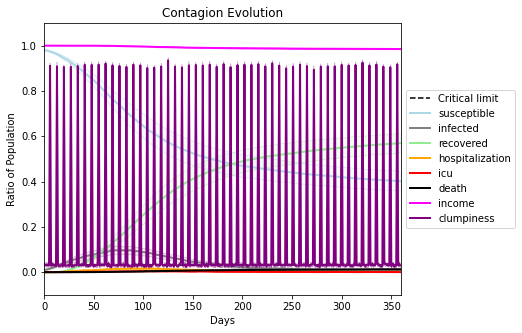

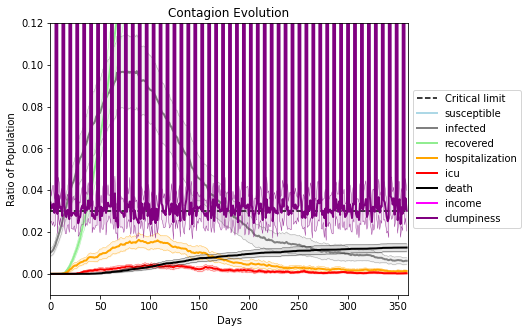

In [45]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 1
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)